In [1]:
import os
import sys
import math
import numpy as np

from scipy    import stats
from datetime import datetime

import matplotlib.pyplot as plt

from scipy.optimize import curve_fit

In [2]:
### Import functions from peak_functions

repository_path = os.path.abspath('/Users/romoluque_c/Repositories/BACON_romo/')
sys.path.append(repository_path)

import peak_functions as pf
import fit_functions  as fitf

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
plt.rcParams["figure.figsize"] = 9, 6
plt.rcParams["font.size"]      = 13

In [5]:
evts_path = '/Users/romoluque_c/LEGEND/BACON/data_npz/'

all_channels = 9

peak_height_all_channels_dict  = {}
peak_area_all_channels_dict    = {}
peak_area_zs_all_channels_dict = {}

pos_date1 = 46
pos_date2 = 56

def get_date(filename):
    date_str = filename[pos_date1:pos_date2]
    date = datetime.strptime(date_str, '%m_%d_%Y')
    return date

files        = os.listdir(evts_path)
filt_files   = [file for file in files if file.startswith("BACoN_sig_processing_peak_height_and_area")]
sorted_files = sorted(filt_files, key=get_date)

for filename in sorted_files:
    my_file = evts_path+filename
    d = np.load(my_file, allow_pickle=True)
    
    date = filename[pos_date1:pos_date2]
    
    if date not in peak_height_all_channels_dict:
        peak_height_all_channels  = [np.array([]) for _ in range(all_channels)]
        peak_area_all_channels    = [np.array([]) for _ in range(all_channels)]
        peak_area_zs_all_channels = [np.array([]) for _ in range(all_channels)]

    for channel in range(all_channels):
        if channel==3:
            continue
        peak_height_all_channels [channel] = np.append(peak_height_all_channels [channel], d['peak_height_all_channels'] [channel])
        peak_area_all_channels   [channel] = np.append(peak_area_all_channels   [channel], d['peak_area_all_channels']   [channel])
        peak_area_zs_all_channels[channel] = np.append(peak_area_zs_all_channels[channel], d['peak_area_zs_all_channels'][channel])

    peak_height_all_channels_dict [date] = np.array(peak_height_all_channels , dtype=object)
    peak_area_all_channels_dict   [date] = np.array(peak_area_all_channels   , dtype=object)
    peak_area_zs_all_channels_dict[date] = np.array(peak_area_zs_all_channels, dtype=object)

### Using the height of the pulses

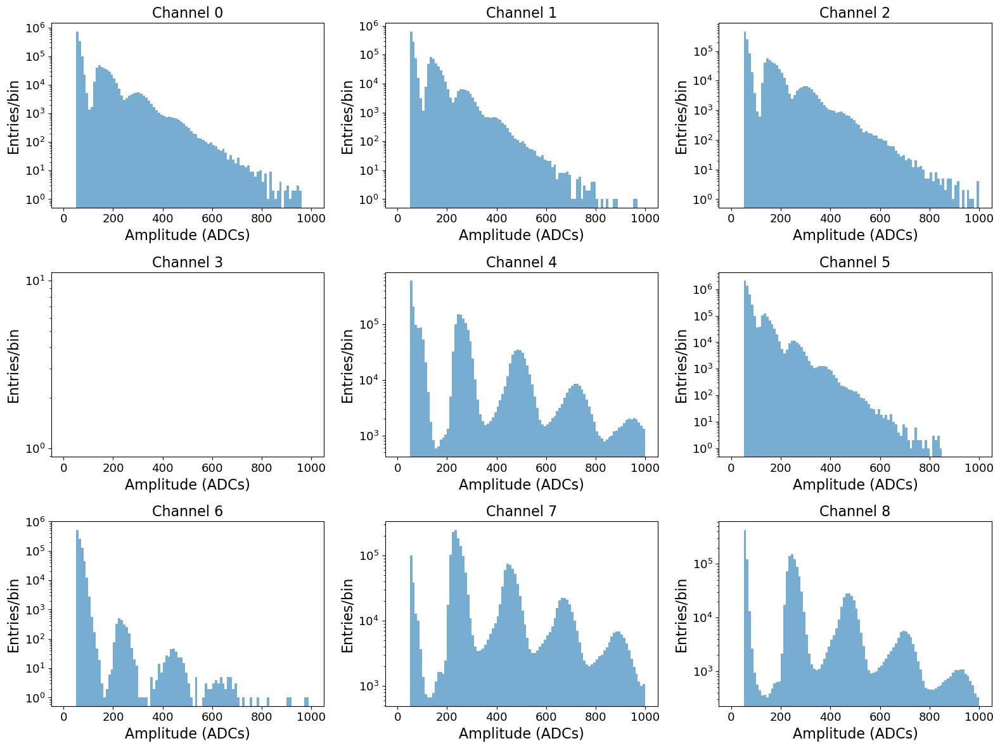

In [6]:
select_date = '05_30_2023'

fig, axs = plt.subplots(3, 3, figsize=(16, 12))
for k in range(9):
    i = int(k/3)
    j = k%3
    axs[i][j].hist(peak_height_all_channels_dict[select_date][k], bins=100, range=(0,1000), log=True, label=f'{select_date}', alpha=0.6)
    axs[i][j].set_xlabel('Amplitude (ADCs)', fontsize=16)
    axs[i][j].set_ylabel('Entries/bin',      fontsize=16)
    axs[i][j].set_title(f"Channel {k}",      fontsize=16)
    #axs[i][j].legend(fontsize=15)
plt.tight_layout()
plt.show()

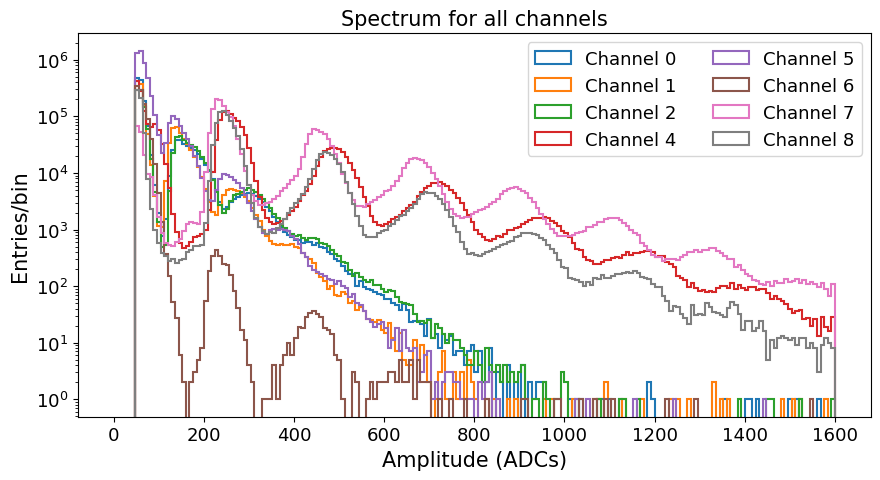

In [7]:
select_date = '05_30_2023'

plt.figure(figsize=(9, 5))
for channel in range(9):
    if channel == 3: continue
    plt.hist(peak_height_all_channels_dict[select_date][channel], bins=200, range=(0,1600), log=True, histtype='step', linewidth=1.5, label=f'Channel {channel}')
plt.xlabel('Amplitude (ADCs)',          fontsize=15)
plt.ylabel('Entries/bin',               fontsize=15)
plt.title(f"Spectrum for all channels", fontsize=15)
plt.tight_layout()
plt.legend(ncol=2)
plt.show()

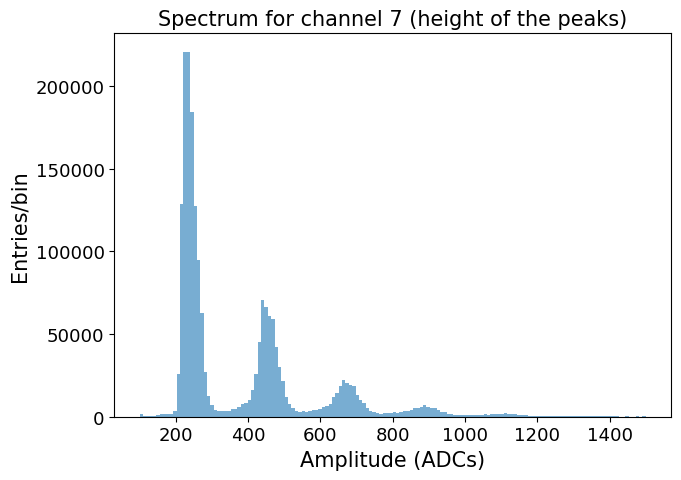

In [8]:
sel_channel = 7
select_date = '05_30_2023'

plt.figure(figsize=(7, 5))
y, x, _ = plt.hist(peak_height_all_channels_dict[select_date][sel_channel], bins=150, range=(100,1500), log=False, alpha=0.6)
plt.xlabel('Amplitude (ADCs)',      fontsize=15)
plt.ylabel('Entries/bin',           fontsize=15)
plt.title(f"Spectrum for channel {sel_channel} (height of the peaks)", fontsize=15)
plt.tight_layout()
plt.show()

In [9]:
# Define the function for a single Gaussian peak
def gaussian(x, amplitude, mean, stddev):
    return amplitude * np.exp(-(x - mean)**2 / (2 * stddev**2))

# Define the function for multiple Gaussian peaks
def multi_gaussian(x, *params):
    n_peaks = len(params) // 3
    y = np.zeros_like(x)
    for i in range(n_peaks):
        amplitude = params[i * 3]
        mean = params[i * 3 + 1]
        stddev = params[i * 3 + 2]
        y += gaussian(x, amplitude, mean, stddev)
    return y

def shift_to_bin_centers(x):
    """
    Return bin centers, given bin lower edges.
    """
    return x[:-1] + np.diff(x) * 0.5

def truncate(number, decimals=0):
    """
    Returns a value truncated to a specific number of decimal places.
    """
    if not isinstance(decimals, int):
        raise TypeError("decimal places must be an integer.")
    elif decimals < 0:
        raise ValueError("decimal places has to be 0 or more.")
    elif decimals == 0:
        return math.trunc(number)

    factor = 10.0 ** decimals
    return math.trunc(number * factor) / factor

def plot_linear_fit(y, yerr):
    x    = np.arange(len(y))+1
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    line = slope*x + intercept
    
    fig = plt.figure(figsize=(8,5))
    plt.errorbar(x, y, yerr=yerr, marker='_', markersize=5, linestyle='', c='k', label=f'Measured gain values')
    plt.plot(x, line, color='r', alpha=0.7, label=f'Fit: y = x*{round(slope, 2)} - {round(np.abs(intercept), 2)}, \n     R$^2$ = {truncate(r_value, 2)}')
    
    plt.xlabel('Peak number')
    plt.ylabel('Mu from fit (ADCs)')
    plt.legend(fontsize=14, loc='upper left')
    plt.show()
    return slope

def extract_gain_and_mean(data, channel, bins, prange, initial_guess):
    
    print()
    print('------------------------------------------------------------------------------------------')
    print(f'-------    Channel {channel}    ---------------------------------------------------------')
    print('------------------------------------------------------------------------------------------')
    print()

    plt.figure(figsize=(7, 5))
    y, x, _ = plt.hist(data, bins=bins, range=prange, alpha=0.6, label=f'Channel{channel}')
    #plt.axvline(x=740, color='r')
    plt.xlabel('Amplitude (ADCs)', fontsize=15)
    plt.ylabel('Entries/bin',      fontsize=15)
    plt.title(f"Spectrum for channel {channel} (height of the peaks)", fontsize=15)
    plt.show()
    
    popt, pcov = curve_fit(multi_gaussian, shift_to_bin_centers(x), y, p0=initial_guess)
    
    plt.figure(figsize=(7, 5))
    plt.step(shift_to_bin_centers(x), y, label='Spectrum')
    plt.plot(x, multi_gaussian(x, *popt), 'r--', label='Fit')
    plt.xlabel('Amplitude (ADCs)', fontsize=15)
    plt.ylabel('Entries/bin',      fontsize=15)
    plt.title(f"Channel {channel}",     fontsize=15)
    plt.legend()
    plt.show()
    
    perr         = np.sqrt(np.diag(pcov))    
    means_ch     = np.array([popt[i*3+1] for i in range(len(popt)//3)])
    means_ch_err = np.array([perr[i*3+1] for i in range(len(perr)//3)])
    
    gain_ch = plot_linear_fit(means_ch[:4], means_ch_err[:4])
    
    return gain_ch, means_ch


------------------------------------------------------------------------------------------
-------    Channel 0    ---------------------------------------------------------
------------------------------------------------------------------------------------------



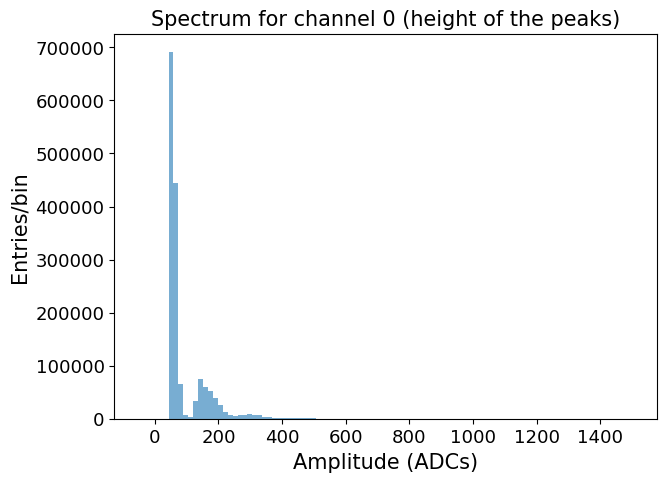

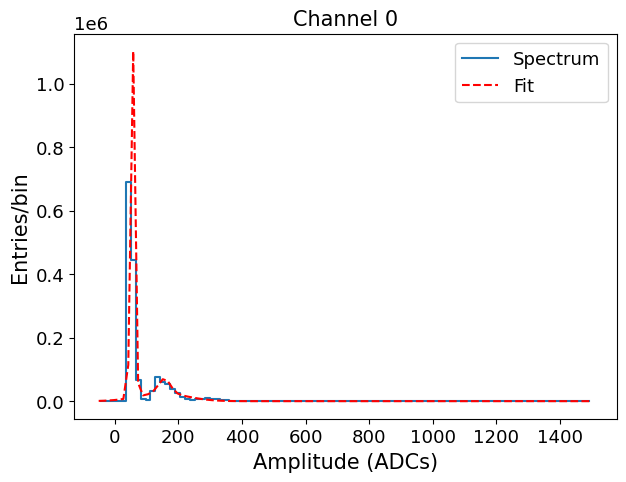

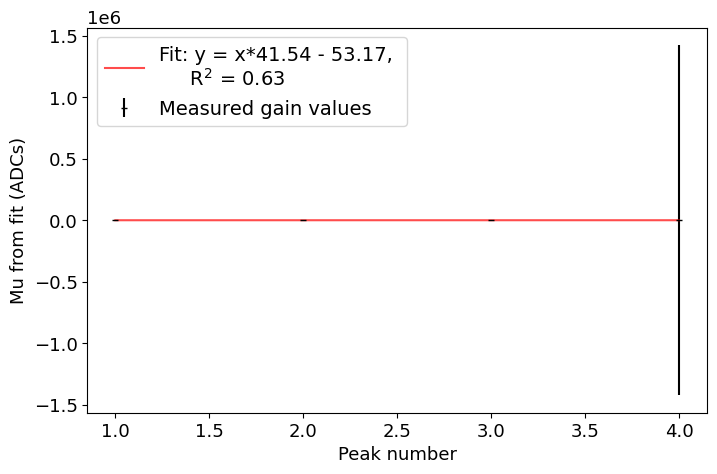


------------------------------------------------------------------------------------------
-------    Channel 1    ---------------------------------------------------------
------------------------------------------------------------------------------------------



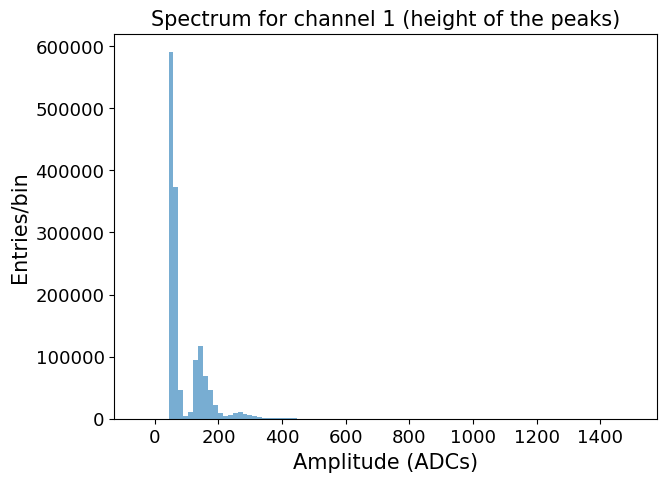

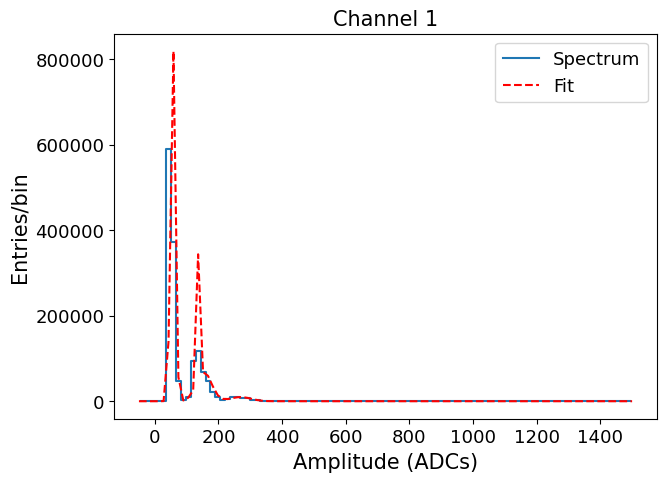

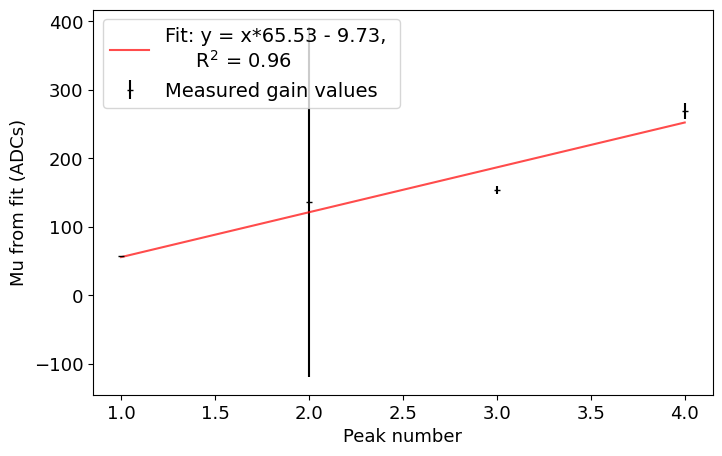


------------------------------------------------------------------------------------------
-------    Channel 2    ---------------------------------------------------------
------------------------------------------------------------------------------------------



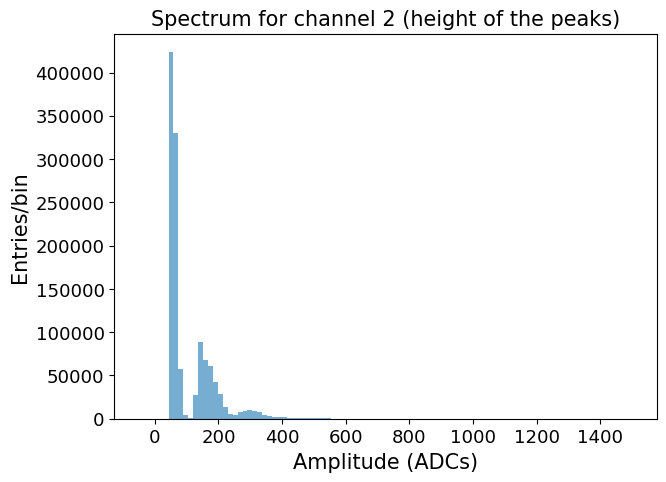

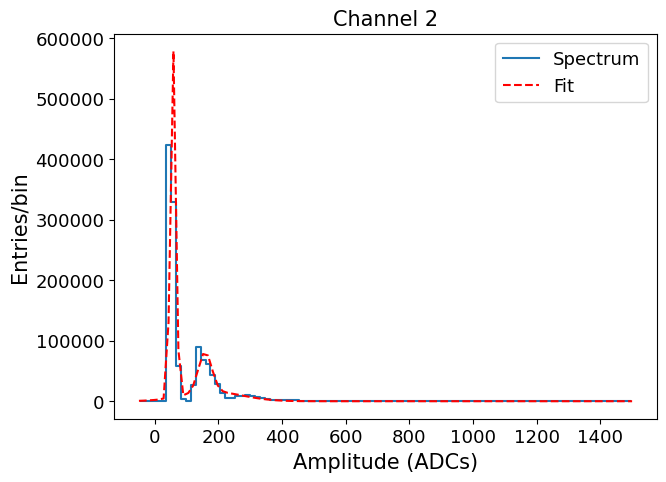

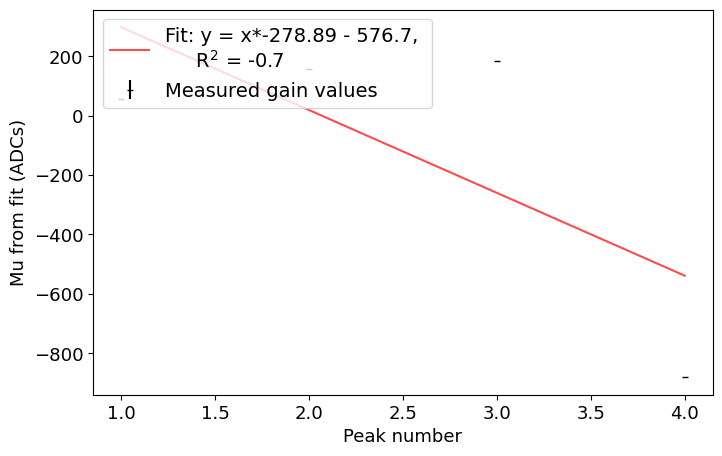


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



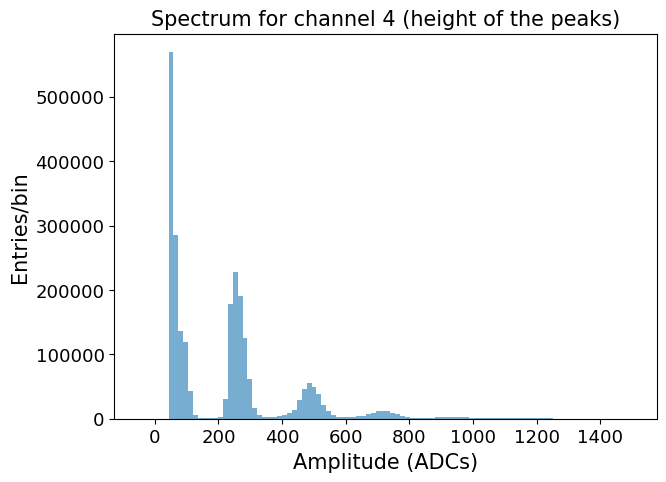

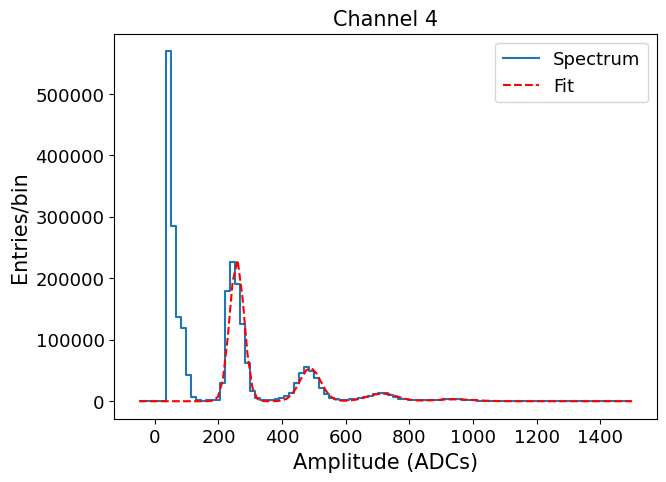

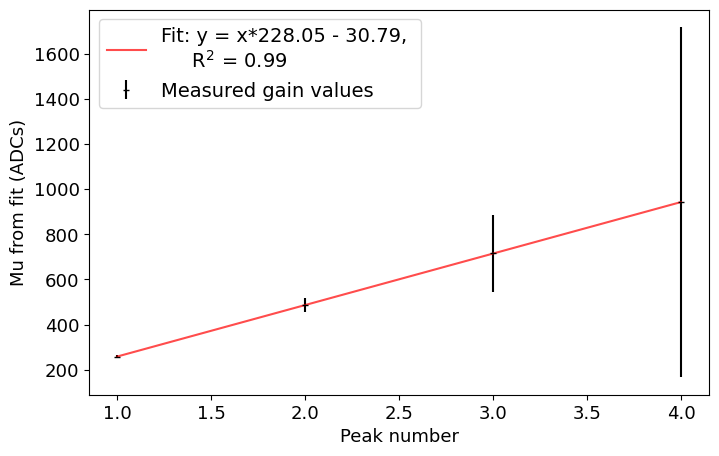


------------------------------------------------------------------------------------------
-------    Channel 5    ---------------------------------------------------------
------------------------------------------------------------------------------------------



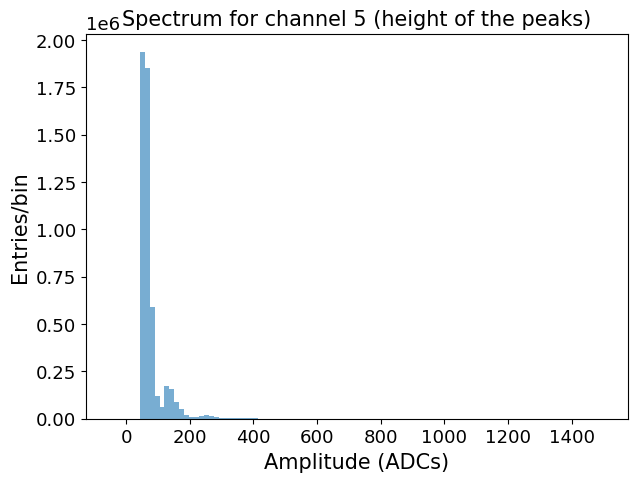

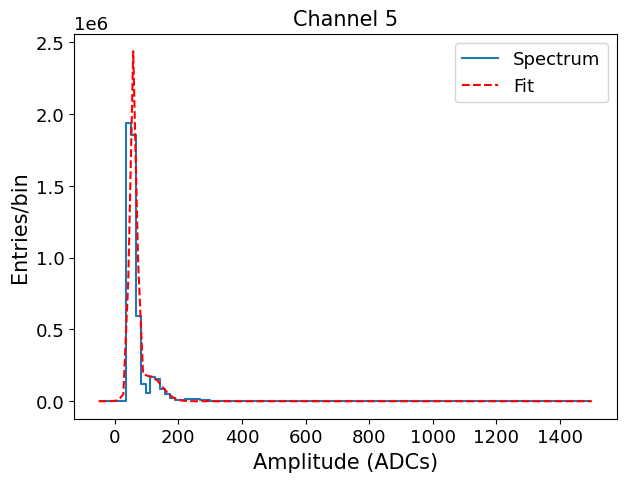

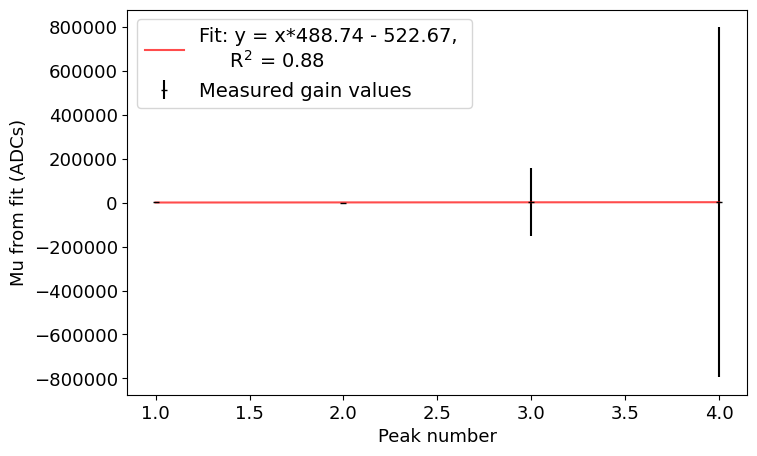


------------------------------------------------------------------------------------------
-------    Channel 6    ---------------------------------------------------------
------------------------------------------------------------------------------------------



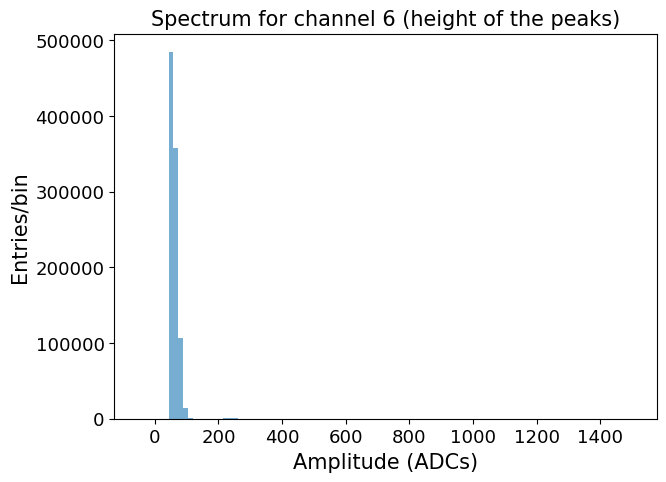


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



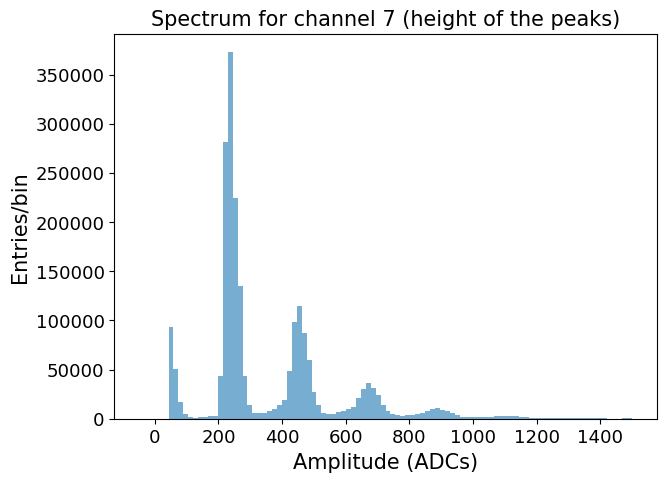

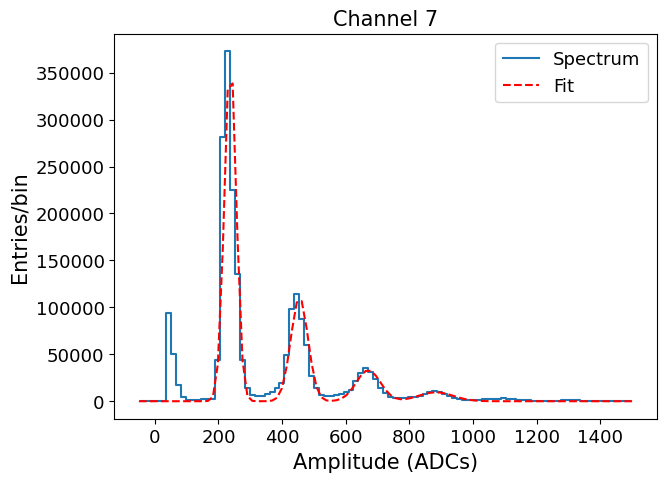

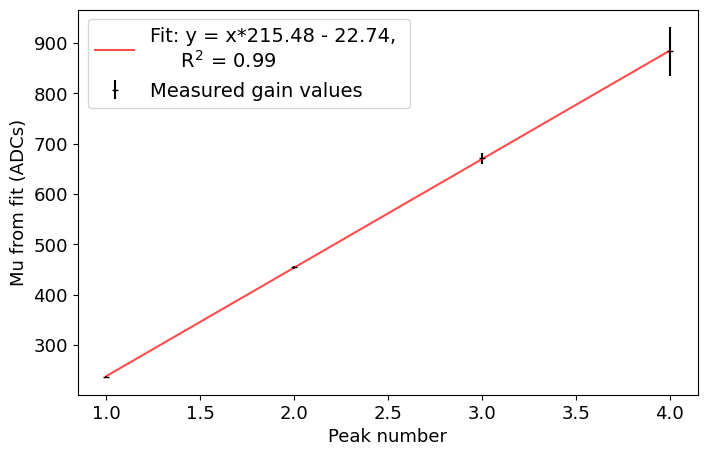


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



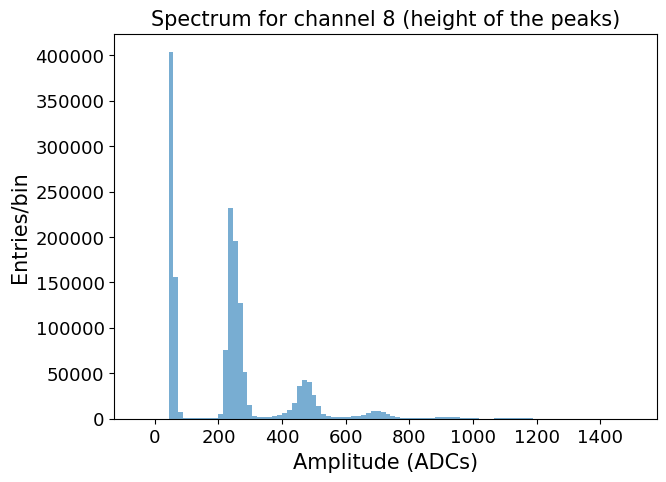

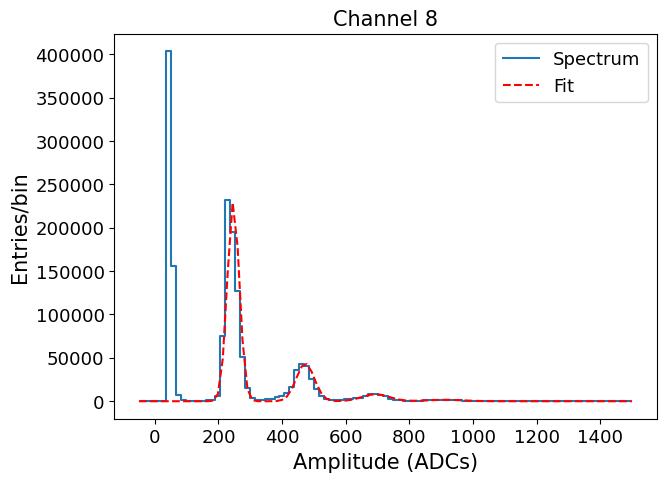

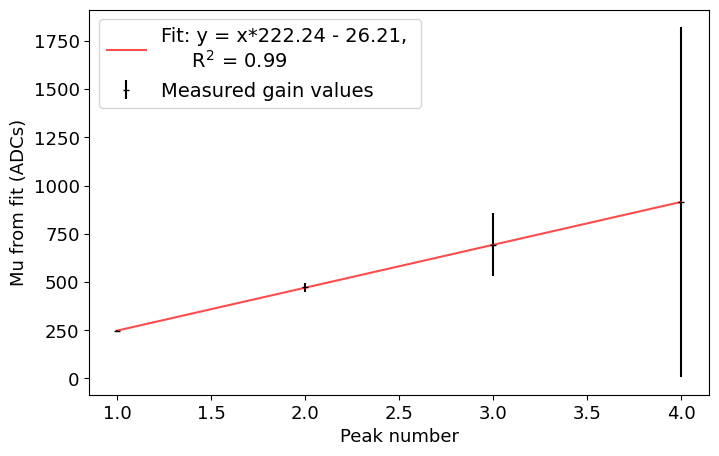

In [10]:
for channel in range(9):
    if channel==3:
        continue
    select_date1   = '05_30_2023'
    initial_guess  = [300000, 240, 10, 100000, 450, 15, 20000, 670, 15, 10000, 880, 15]
    try:
        gain, ch_means = extract_gain_and_mean(peak_height_all_channels_dict[select_date1][channel],
                                                   channel       = channel,
                                                   bins          = 100,
                                                   prange        = (-50, 1500),
                                                   initial_guess = initial_guess)
    except:
        continue

## Problematic channels


------------------------------------------------------------------------------------------
-------    Channel 0    ---------------------------------------------------------
------------------------------------------------------------------------------------------



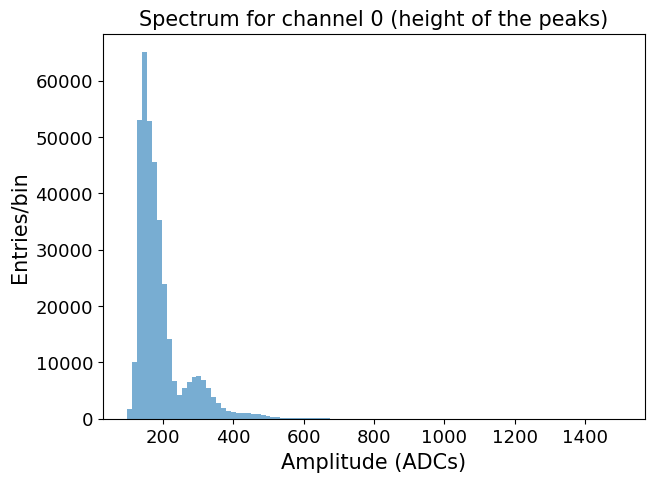

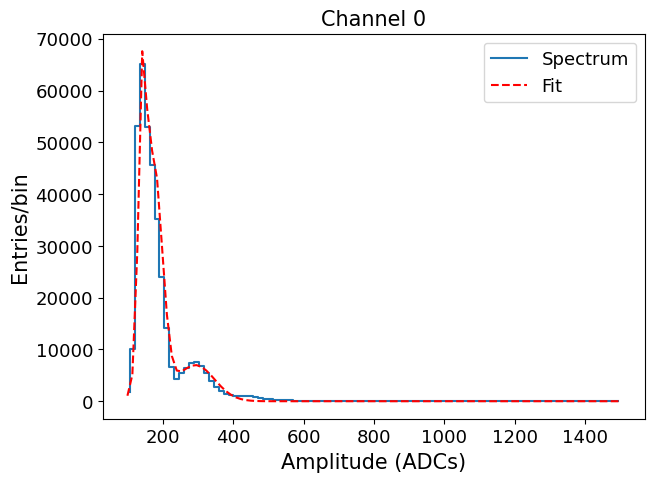

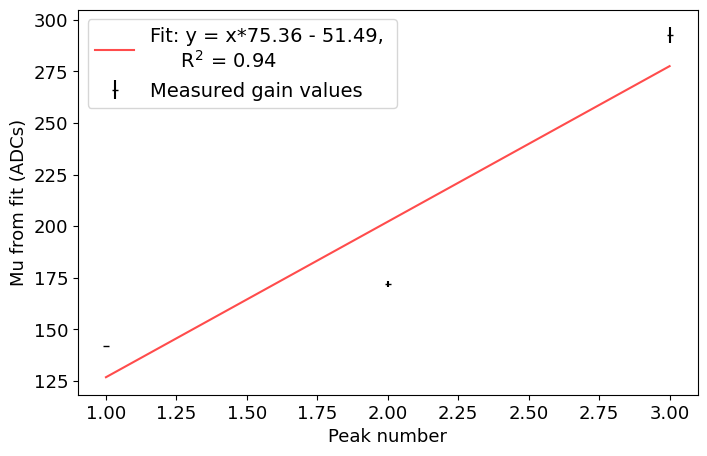

In [11]:
channel        = 0
select_date1   = '05_30_2023'
initial_guess  = [300000, 165, 10, 100000, 300, 15, 20000, 450, 15]
gain, ch_means = extract_gain_and_mean(peak_height_all_channels_dict[select_date1][channel],
                                       channel       = channel,
                                       bins          = 100,
                                       prange        = (100, 1500),
                                       initial_guess = initial_guess)

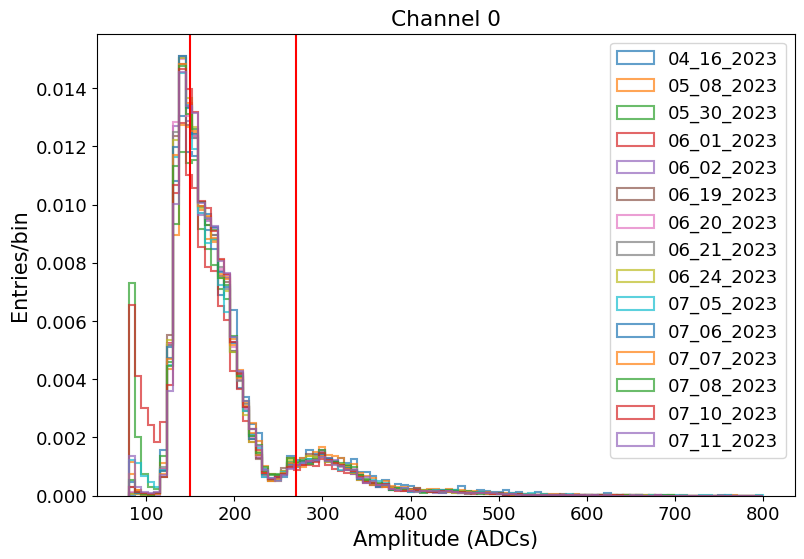

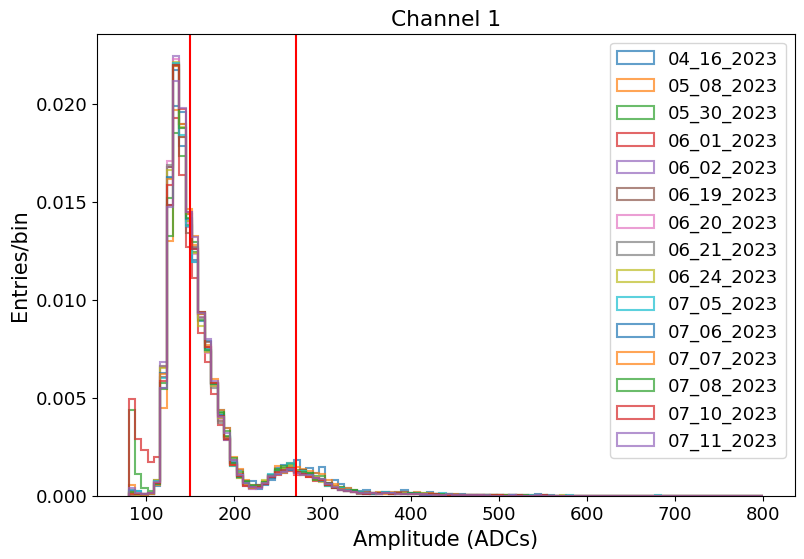

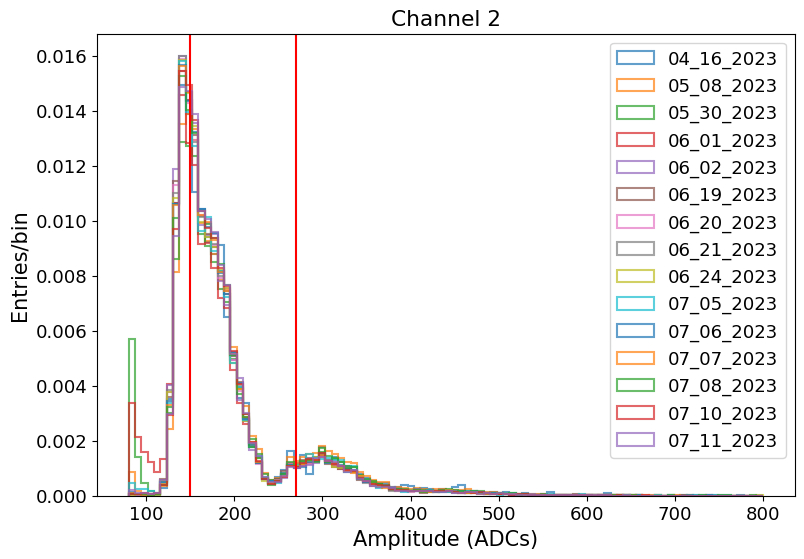

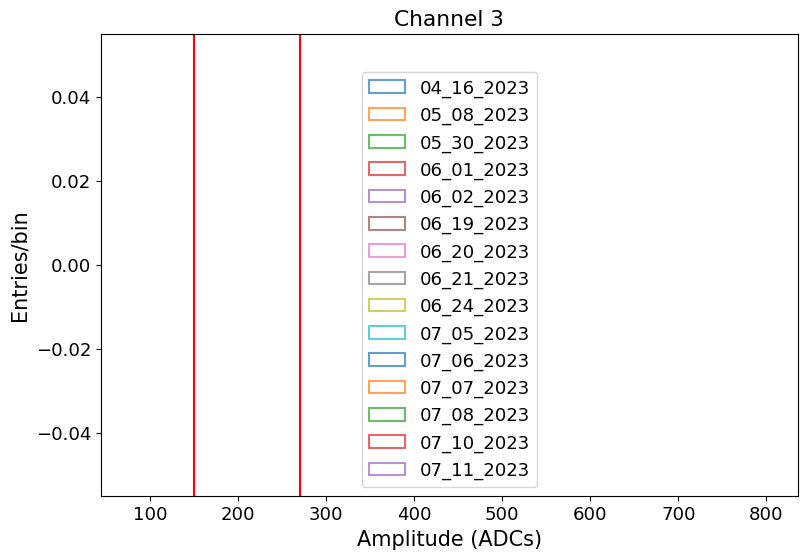

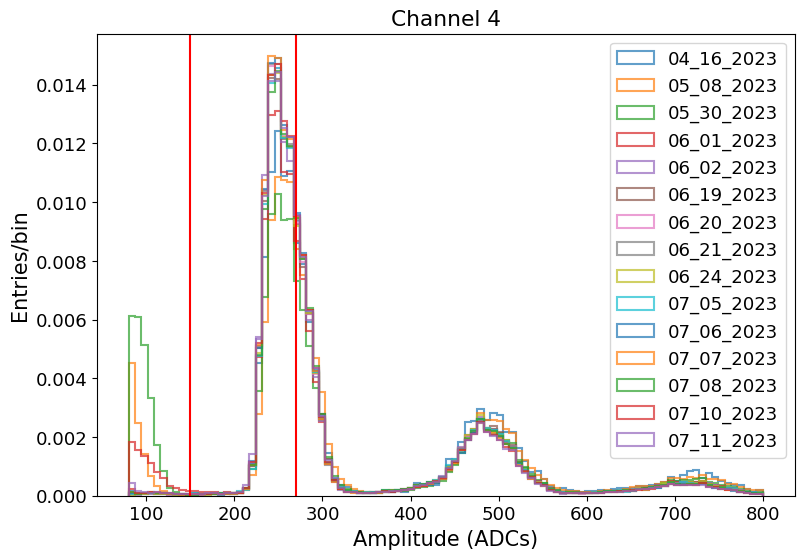

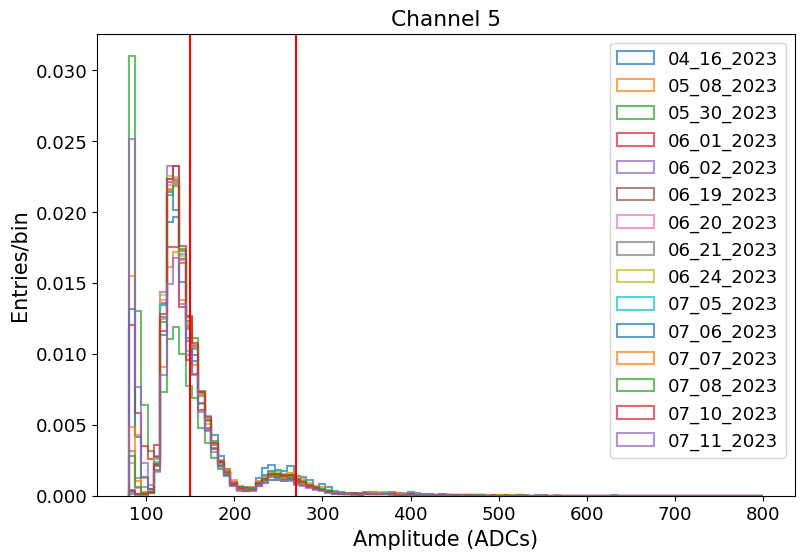

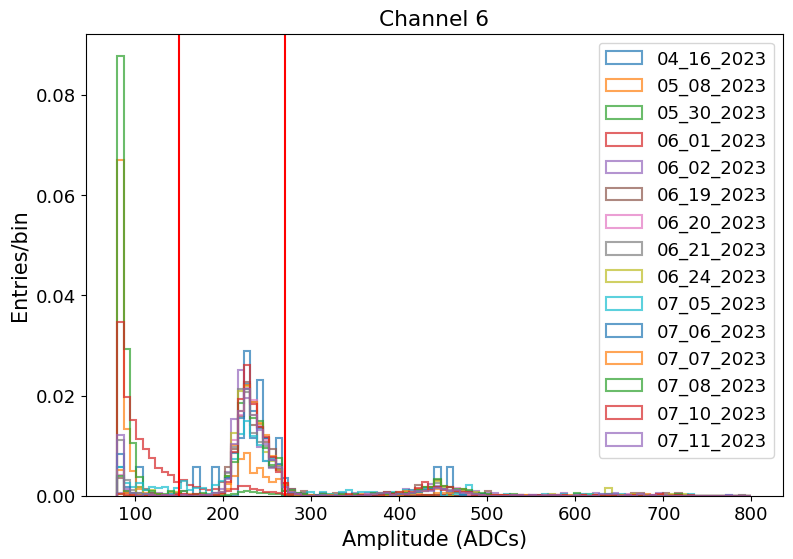

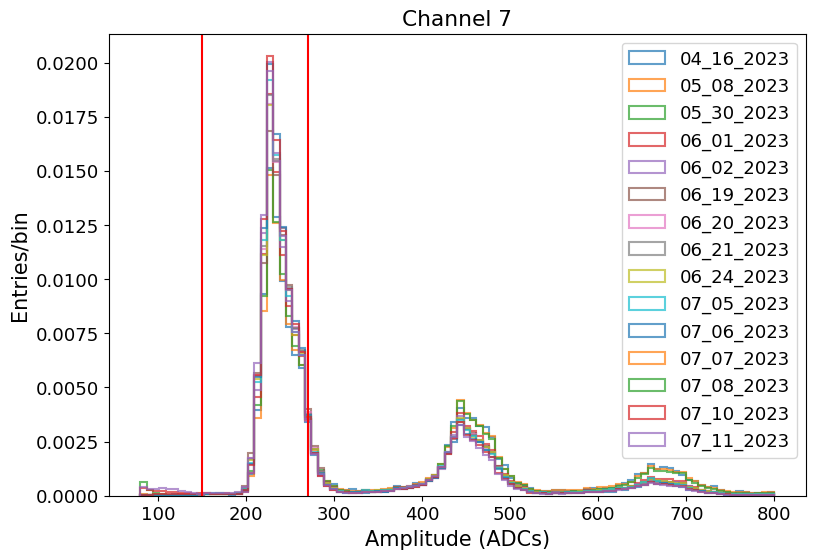

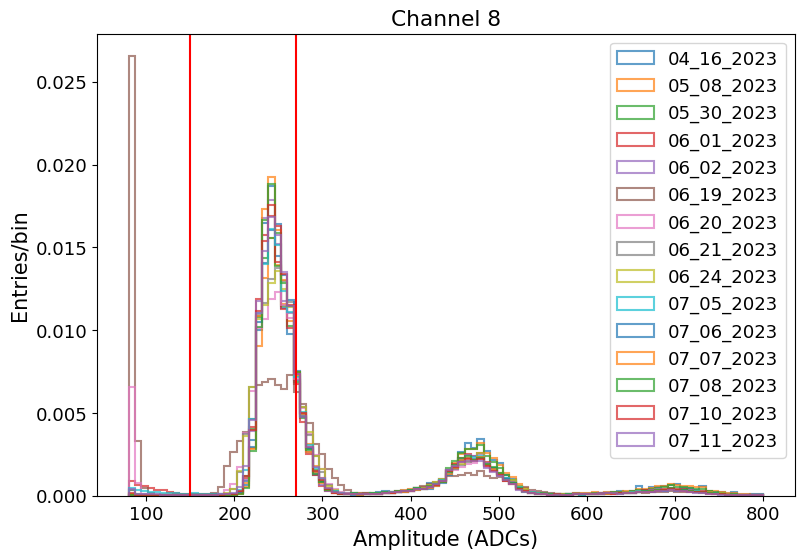

In [12]:
#channel = 0
for channel in range(9):
    for sel_date in peak_height_all_channels_dict.keys():
        if sel_date == '05_22_2023': continue
        histogram = peak_height_all_channels_dict[sel_date][channel]
        plt.hist(histogram, bins=100, range=(80,800), alpha=0.7, histtype='step', linewidth=1.5, density=True, label=f'{sel_date}')
    plt.axvline(x=150, color='r')
    plt.axvline(x=270, color='r')
    plt.title(f'Channel {channel}')
    plt.xlabel('Amplitude (ADCs)', fontsize=15)
    plt.ylabel('Entries/bin',      fontsize=15)
    plt.legend()
    plt.show()

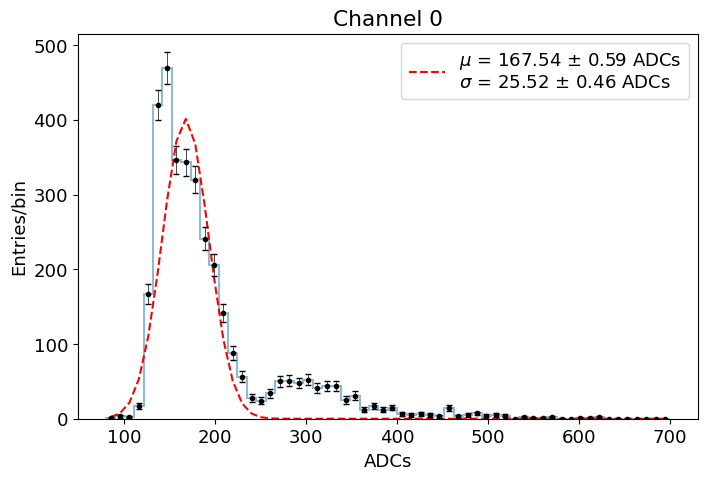

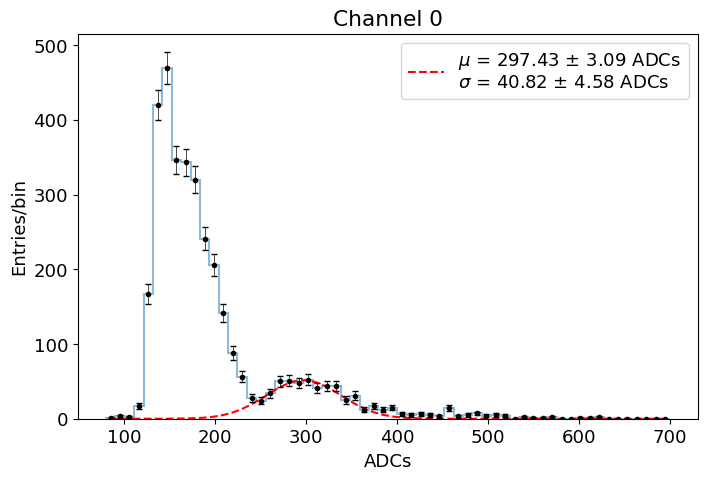

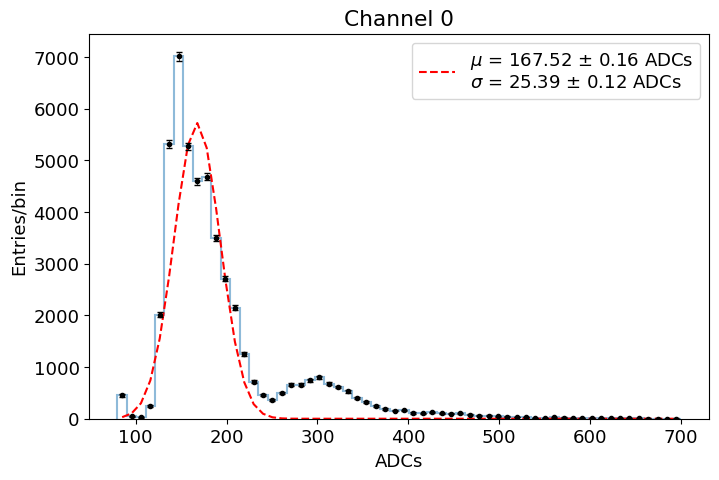

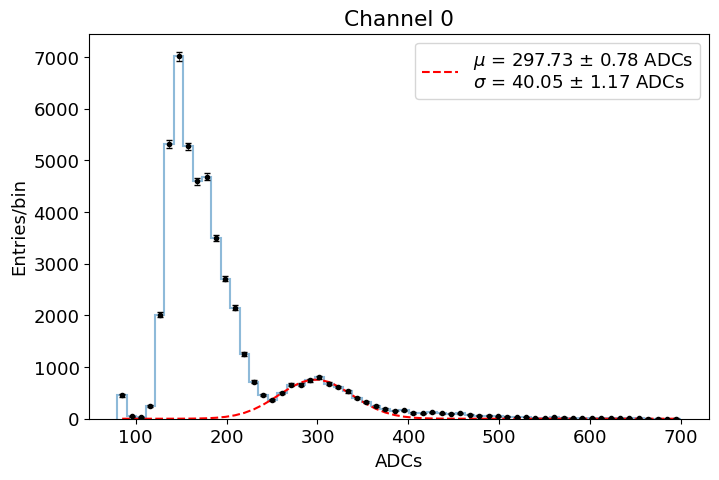

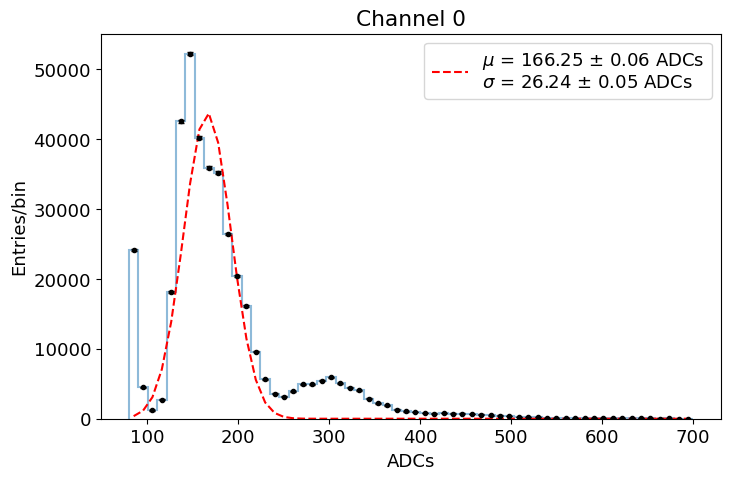

...

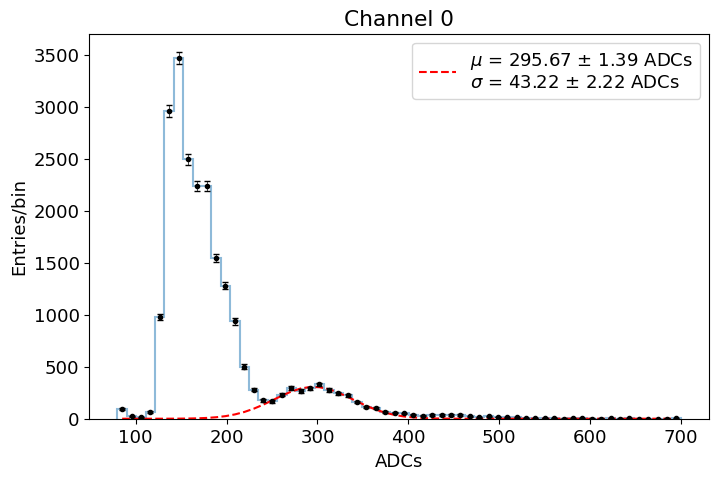

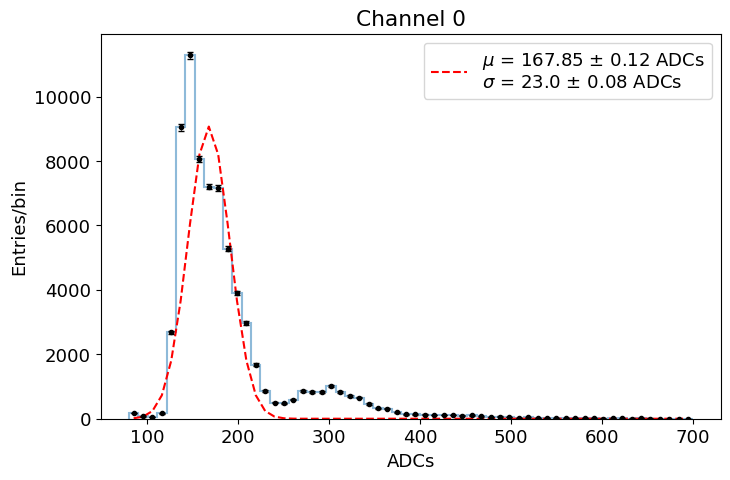

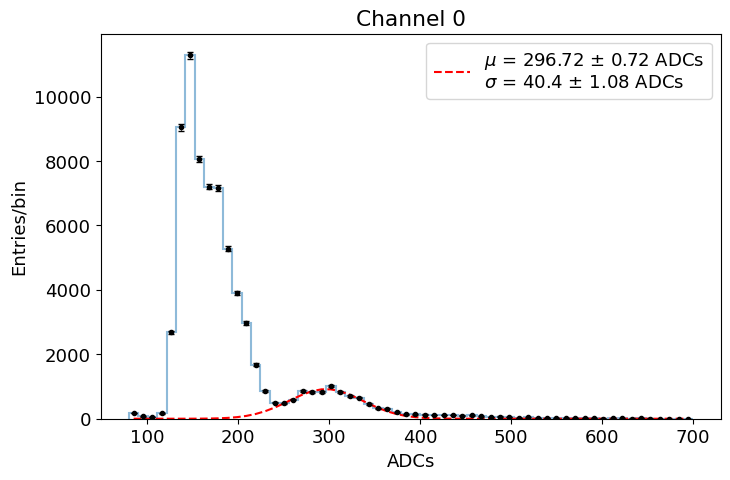

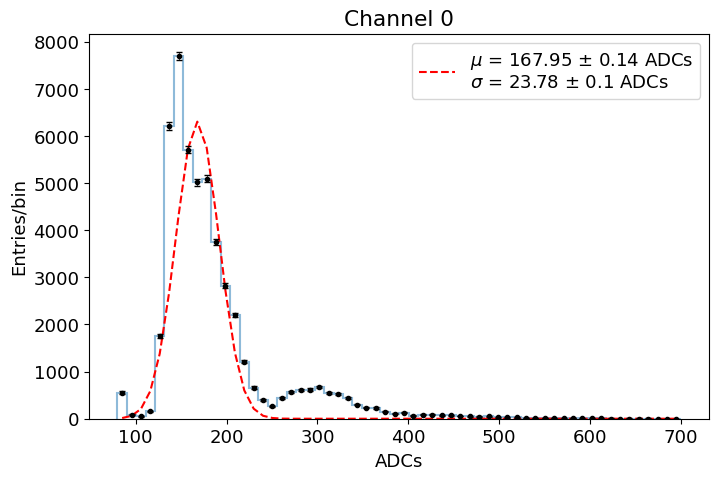

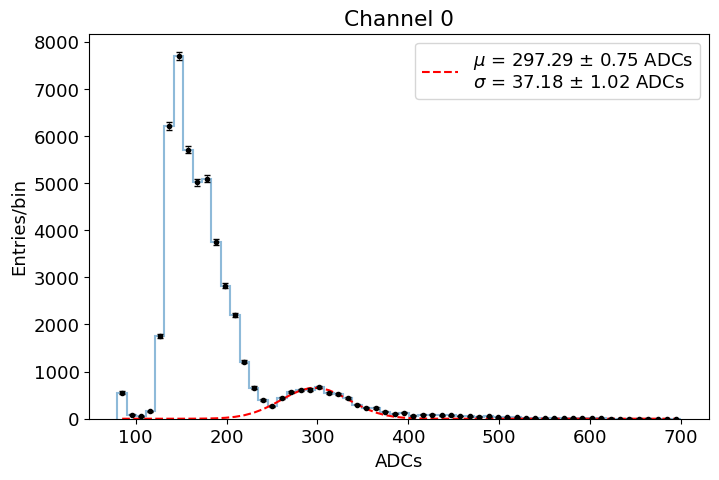

[129.89439649 130.21421561 129.96349558 132.05705378 128.62404024
 128.27294147 129.34903392 129.48520932 128.74229587 129.52813366
 129.21209725 129.28667115 128.39342466 128.86899952 129.34079635]


In [13]:
channel     = 0
gain_chann0 = []
for sel_date in peak_height_all_channels_dict.keys():
    if sel_date == '05_22_2023': continue 
    vals1 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=60, prange=(80, 700), ampl=10000, mean=170, sigma=20, frange=(110, 220), title=f'Channel {channel}', print_chi2=False)
    vals2 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=60, prange=(80, 700), ampl=10000, mean=300, sigma=20, frange=(250, 350), title=f'Channel {channel}', print_chi2=False)
    gain_chann0.append(vals2[0] - vals1[0])
gain_chann0 = np.array(gain_chann0)
print(gain_chann0)

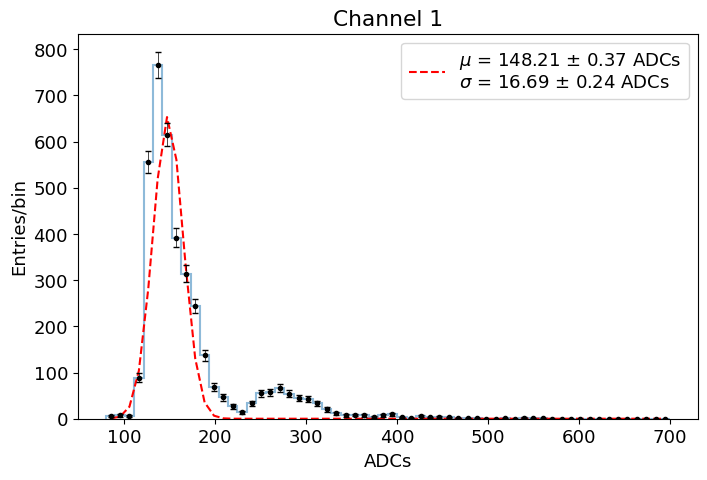

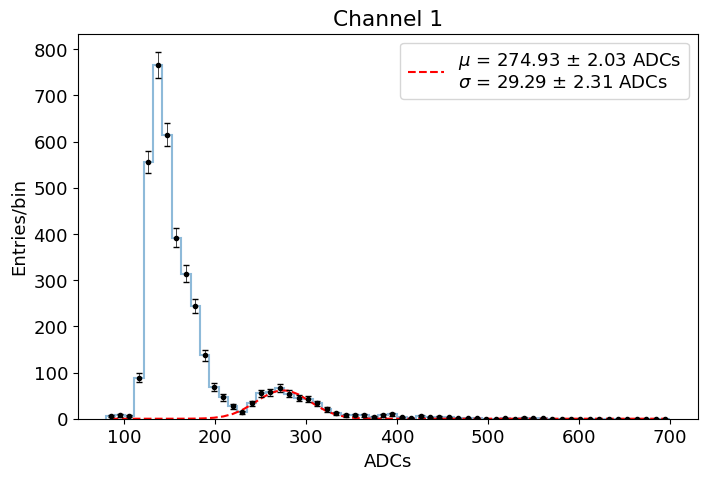

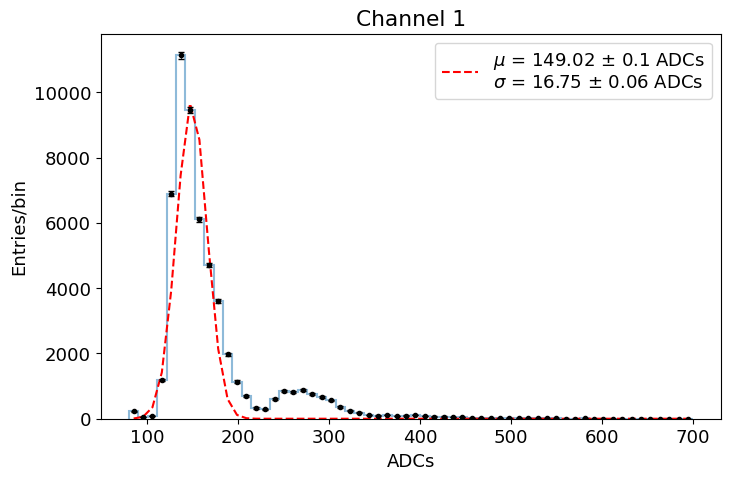

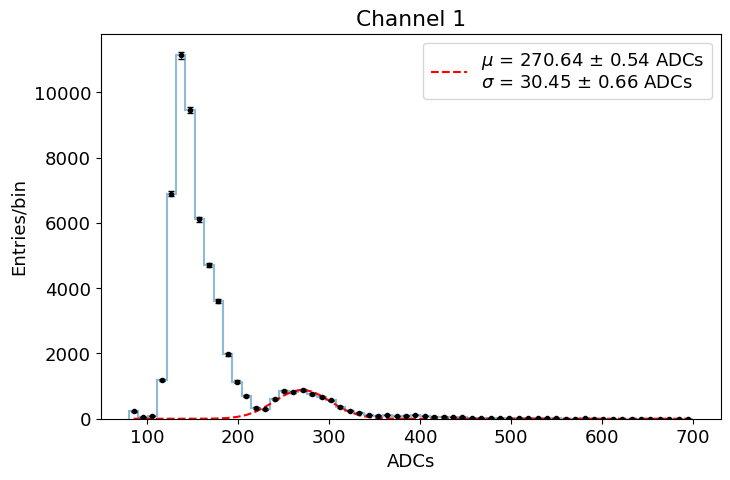

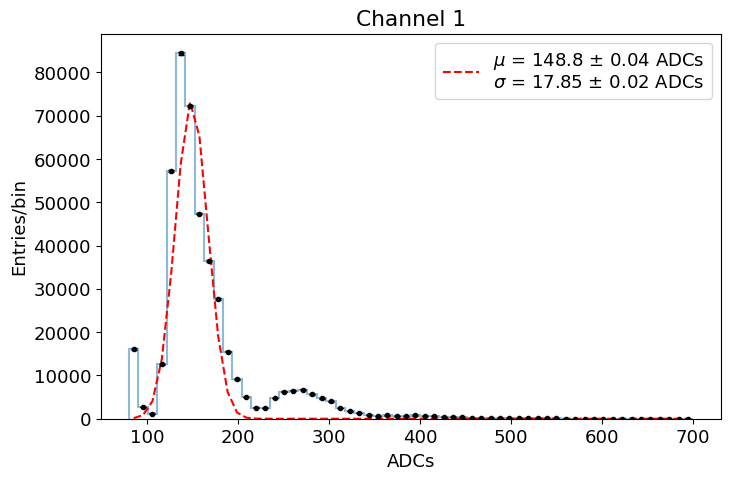

...

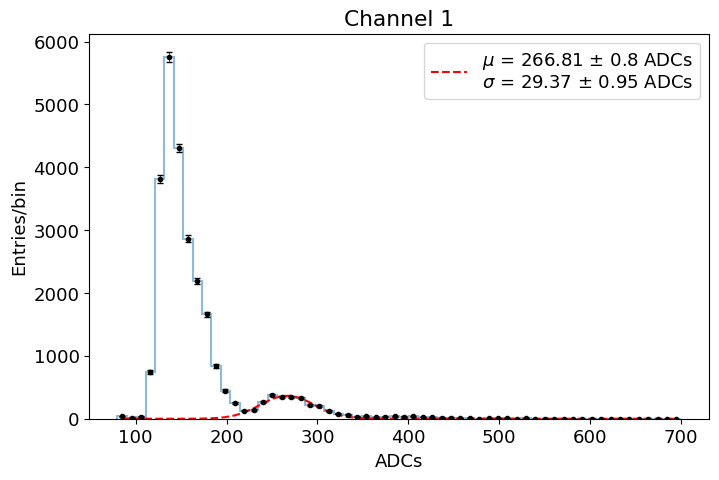

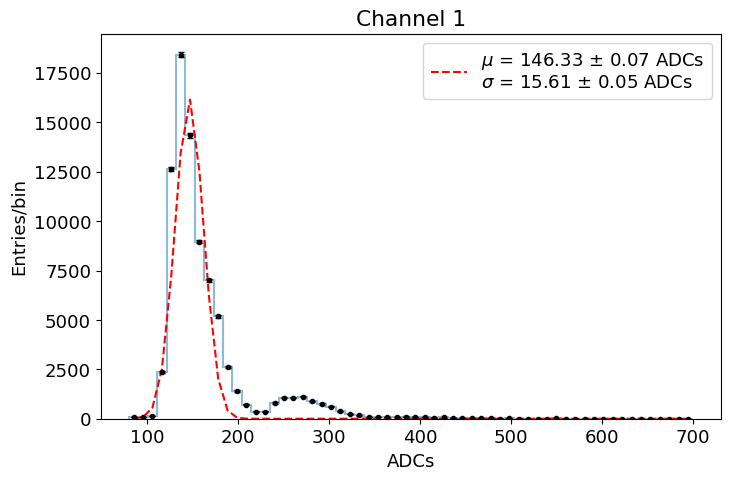

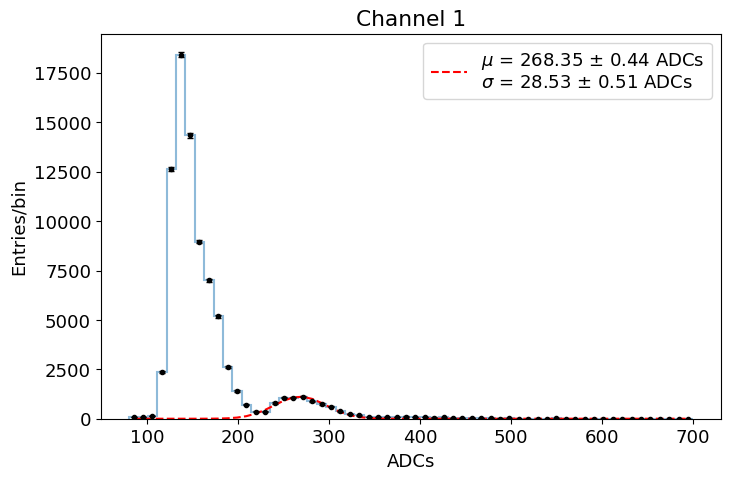

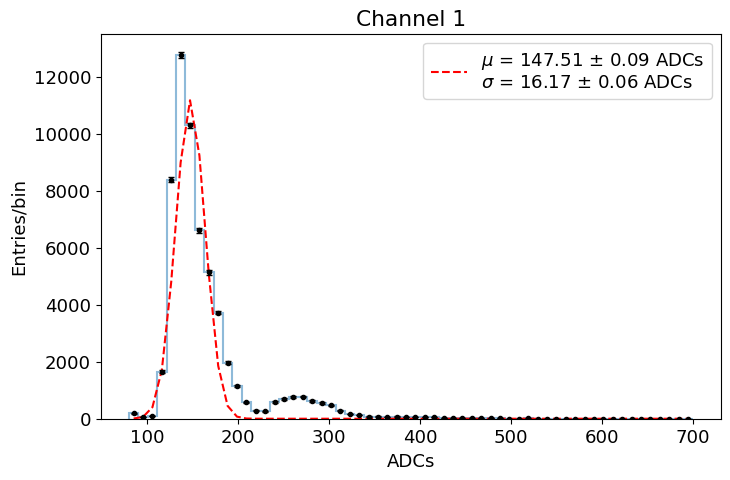

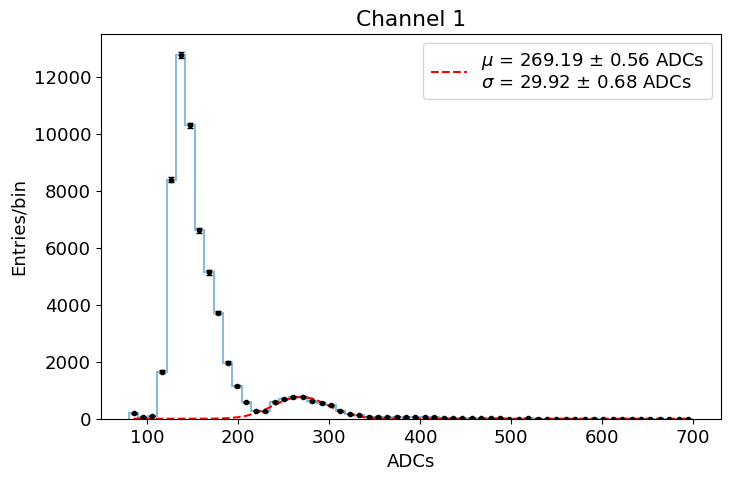

[126.71360445 121.62168585 120.05511476 121.82687954 123.53985219
 121.40485459 122.57665935 121.91645582 122.0904414  120.63006523
 123.33098669 121.40431828 119.75138489 122.02178908 121.67991511]


In [14]:
channel     = 1
gain_chann1 = []
for sel_date in peak_height_all_channels_dict.keys():
    if sel_date == '05_22_2023': continue 
    vals1 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=60, prange=(80, 700), ampl=10000, mean=150, sigma=20, frange=(100, 200), title=f'Channel {channel}', print_chi2=False)
    vals2 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=60, prange=(80, 700), ampl=10000, mean=270, sigma=20, frange=(220, 320), title=f'Channel {channel}', print_chi2=False)
    gain_chann1.append(vals2[0] - vals1[0])
gain_chann1 = np.array(gain_chann1)
print(gain_chann1)

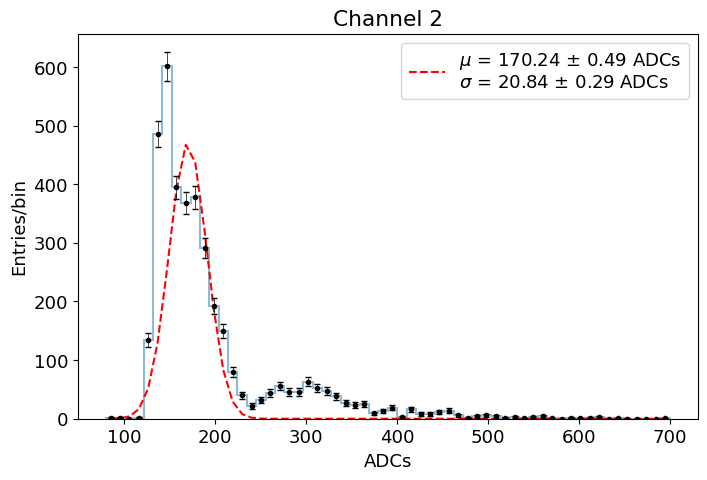

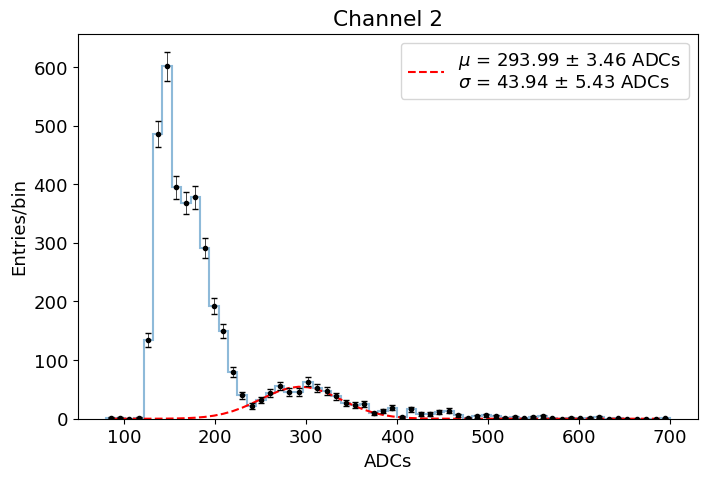

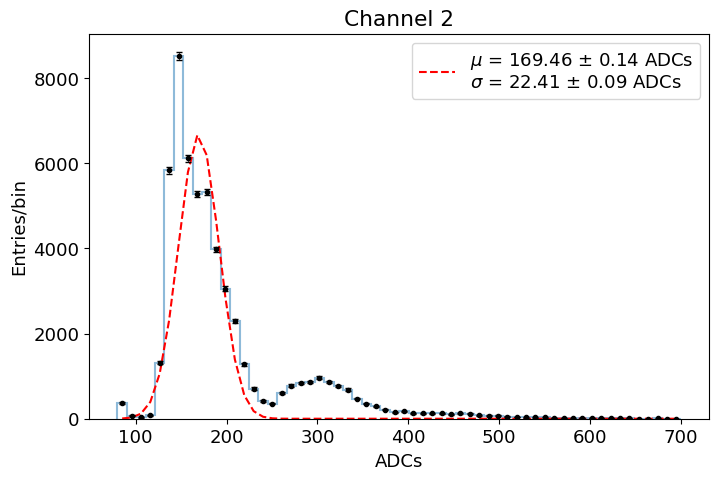

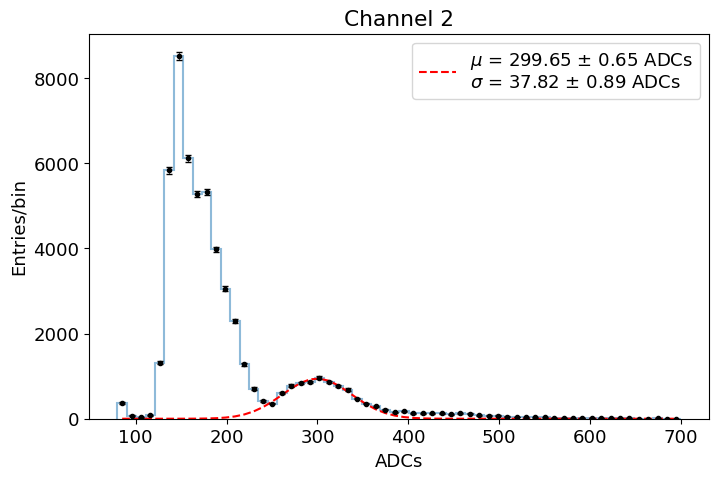

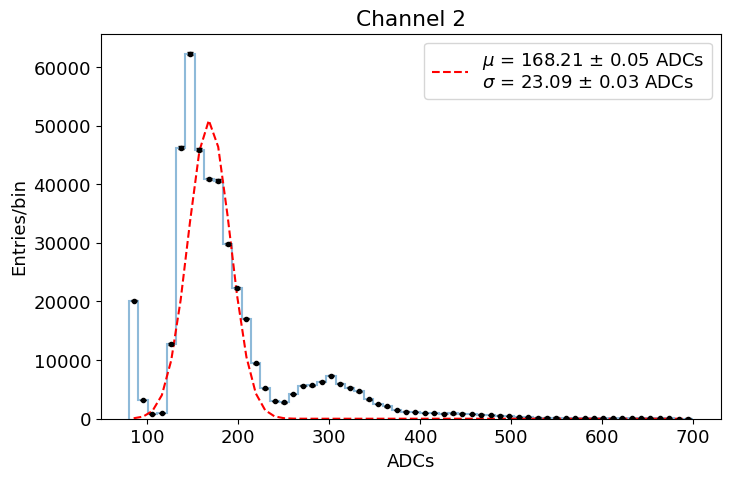

...

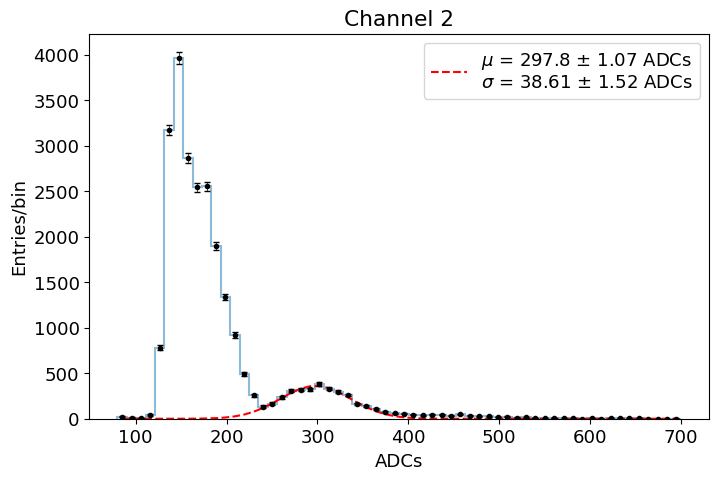

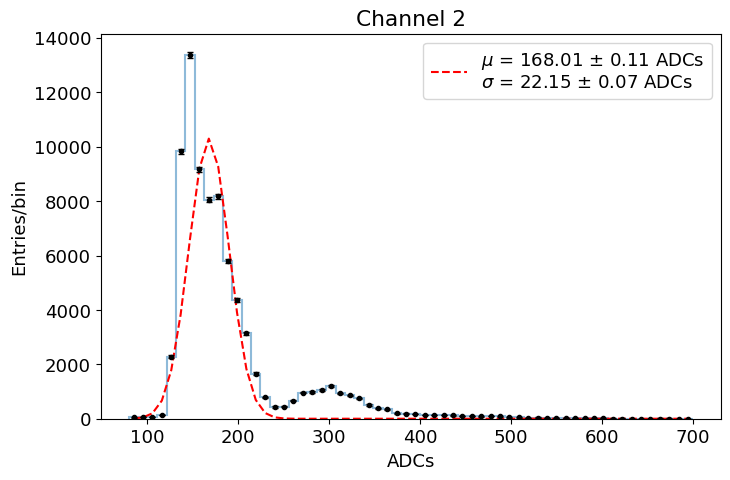

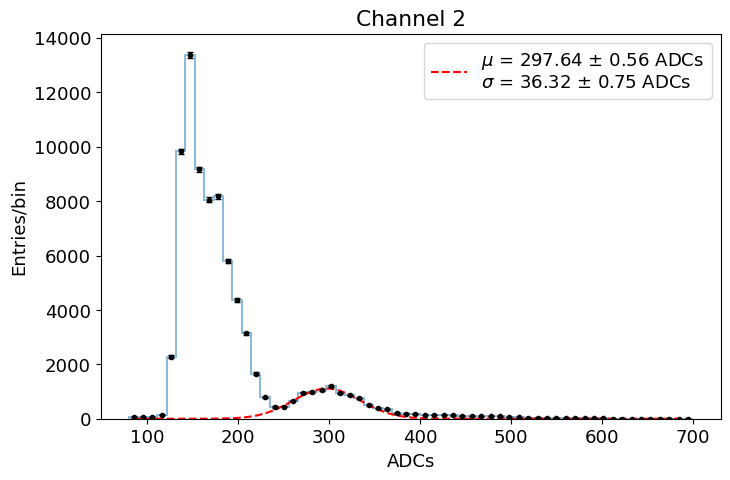

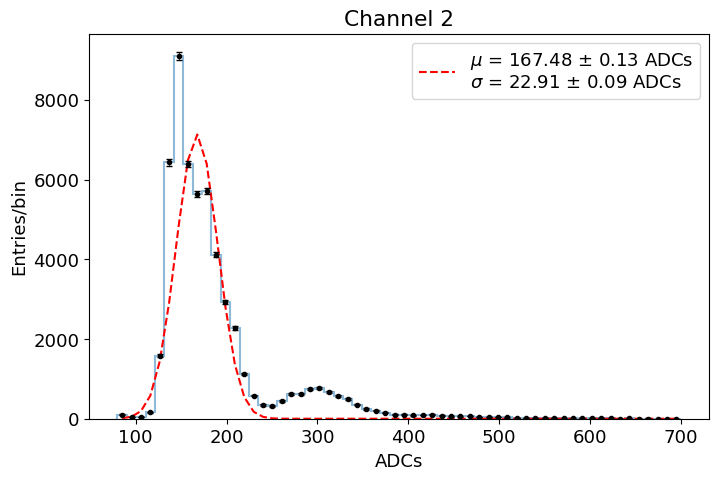

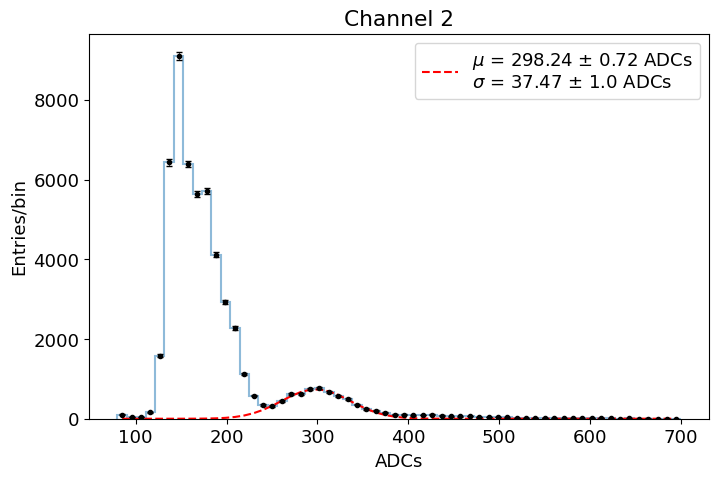

[123.74755414 130.19212985 130.48051615 133.56062589 131.50655131
 126.67178811 129.7742991  128.77301283 128.79597403 131.3614814
 129.94410251 129.69023372 129.80010267 129.63033913 130.75840773]


In [15]:
channel     = 2
gain_chann2 = []
for sel_date in peak_height_all_channels_dict.keys():
    if sel_date == '05_22_2023': continue 
    vals1 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=60, prange=(80, 700), ampl=10000, mean=170, sigma=20, frange=(110, 220), title=f'Channel {channel}', print_chi2=False)
    vals2 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=60, prange=(80, 700), ampl=10000, mean=300, sigma=20, frange=(250, 350), title=f'Channel {channel}', print_chi2=False)
    gain_chann2.append(vals2[0] - vals1[0])
gain_chann2 = np.array(gain_chann2)
print(gain_chann2)

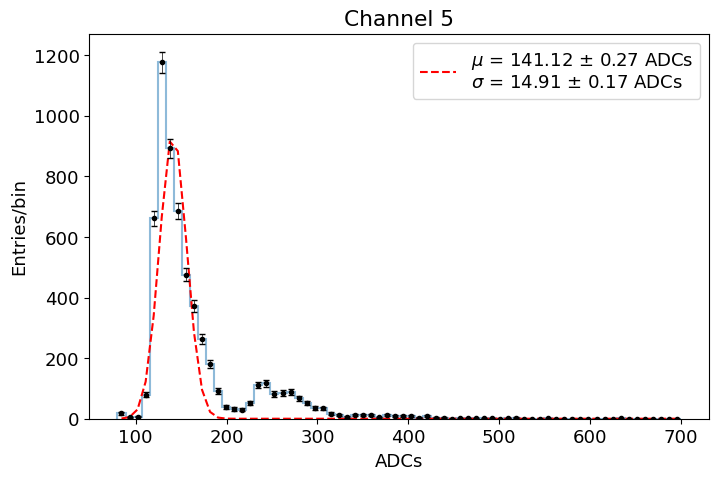

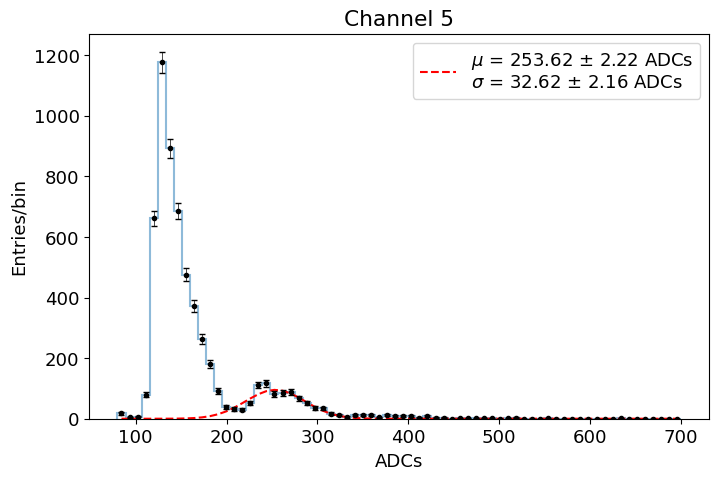

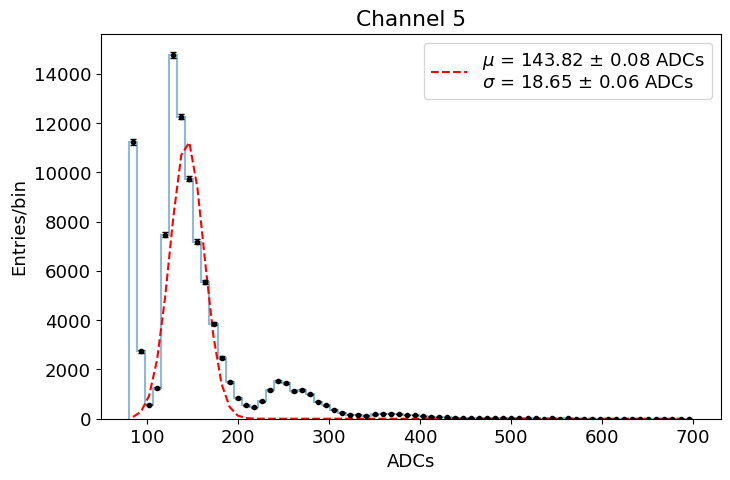

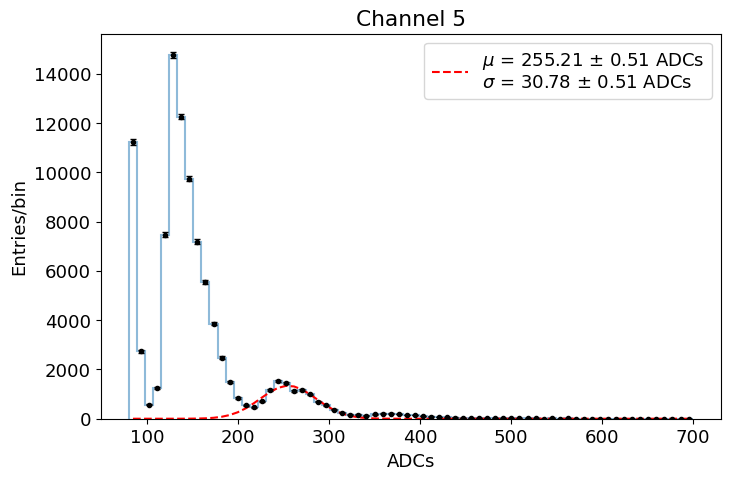

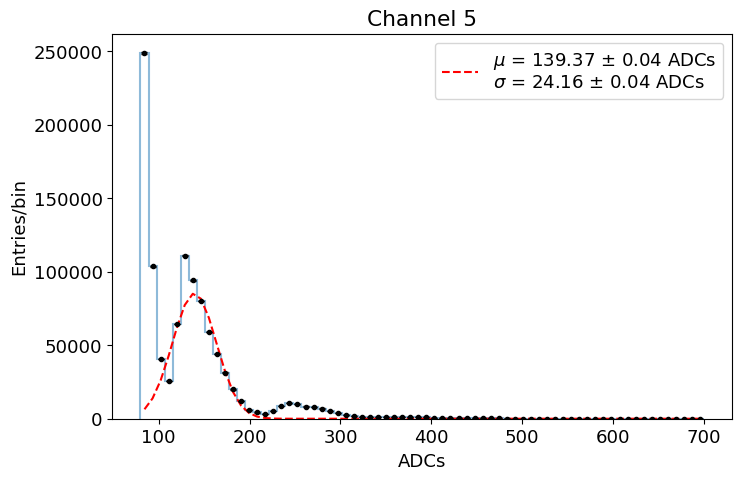

...

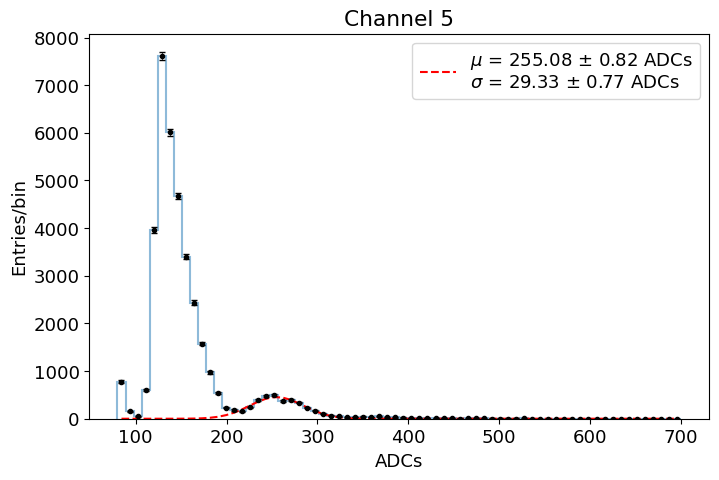

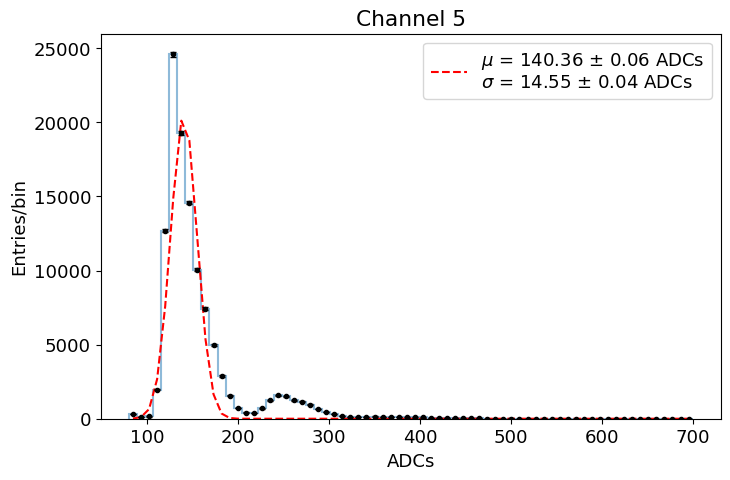

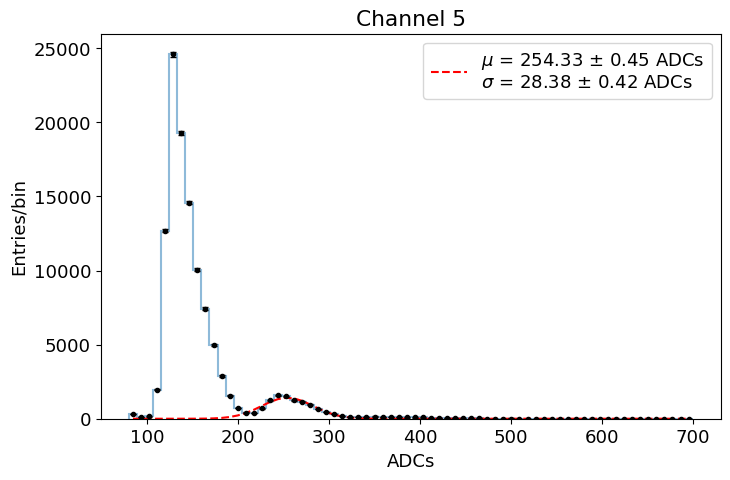

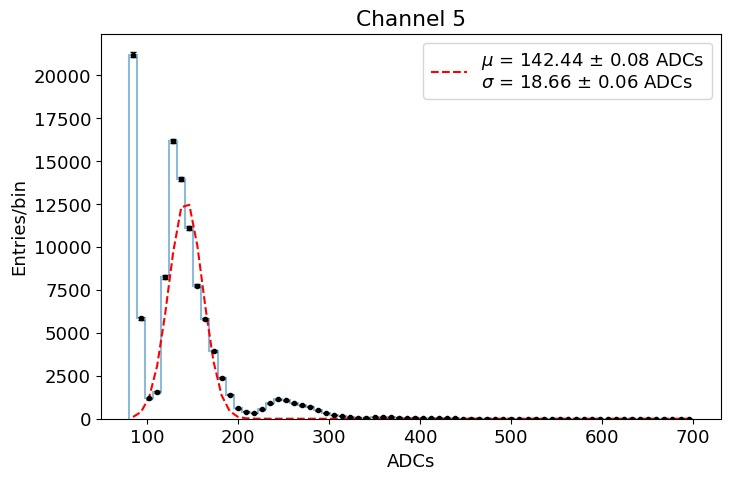

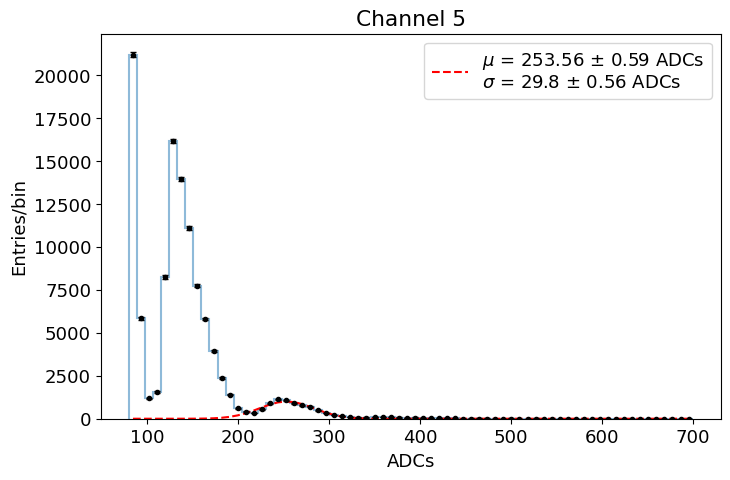

[112.50063424 111.38878309 115.46697055 112.57183483 114.42732915
 112.25697369 112.96957812 113.12406481 114.15869794 111.43592192
 112.25711261 113.47147992 113.58539931 113.97853282 111.11507442]


In [16]:
channel     = 5
gain_chann5 = []
for sel_date in peak_height_all_channels_dict.keys():
    if sel_date == '05_22_2023': continue 
    vals1 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=70, prange=(80, 700), ampl=10000, mean=150, sigma=20, frange=(100, 200), title=f'Channel {channel}', print_chi2=False)
    vals2 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=70, prange=(80, 700), ampl=10000, mean=260, sigma=20, frange=(220, 320), title=f'Channel {channel}', print_chi2=False)
    gain_chann5.append(vals2[0] - vals1[0])
gain_chann5 = np.array(gain_chann5)
print(gain_chann5)

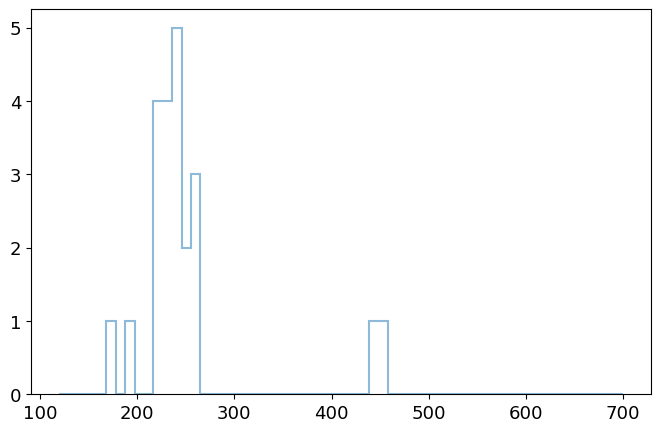

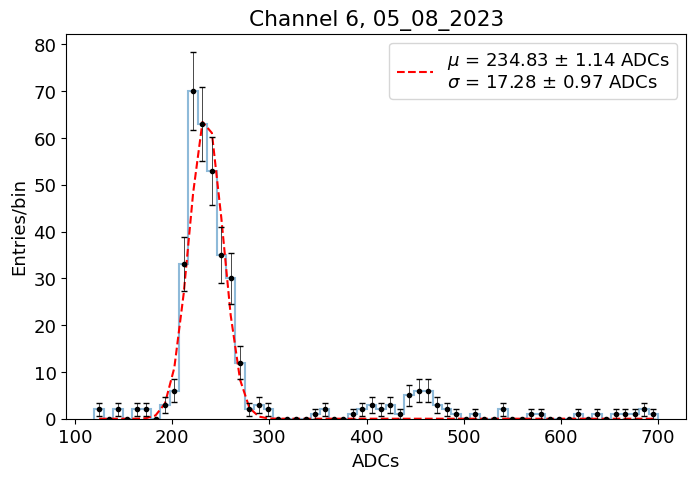

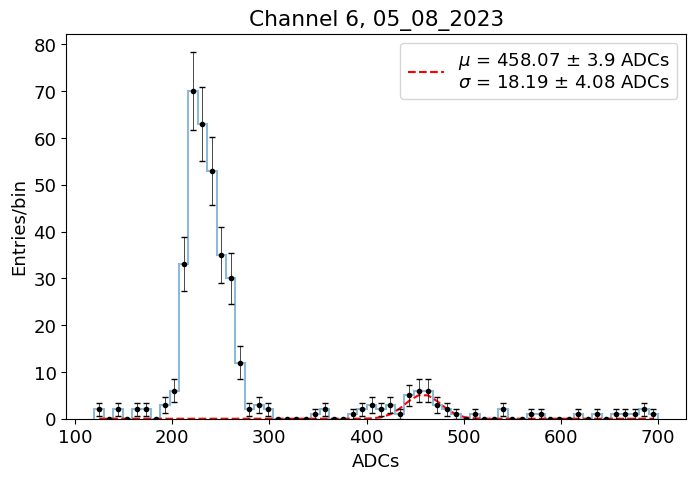

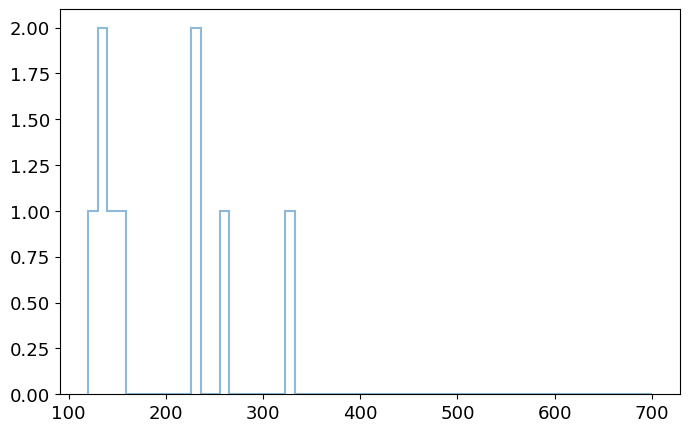

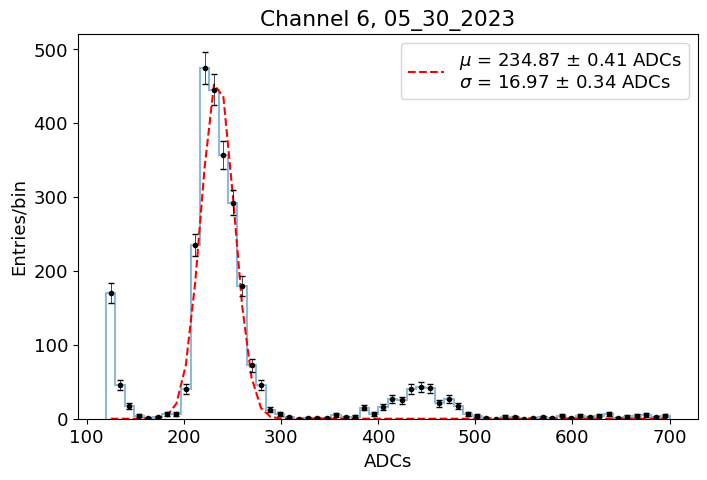

...

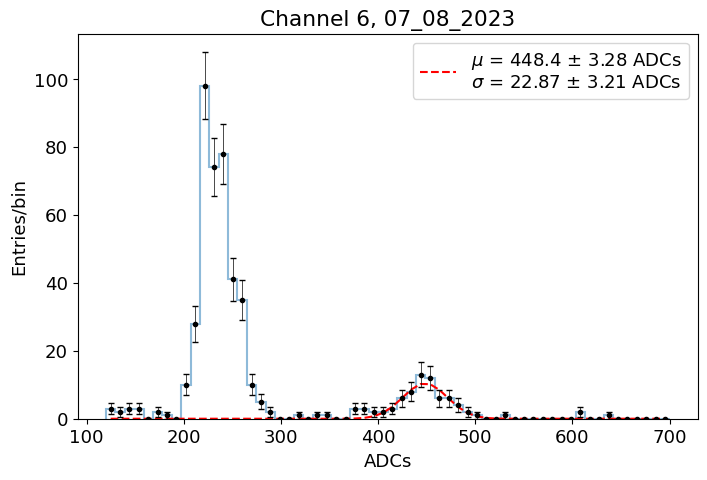

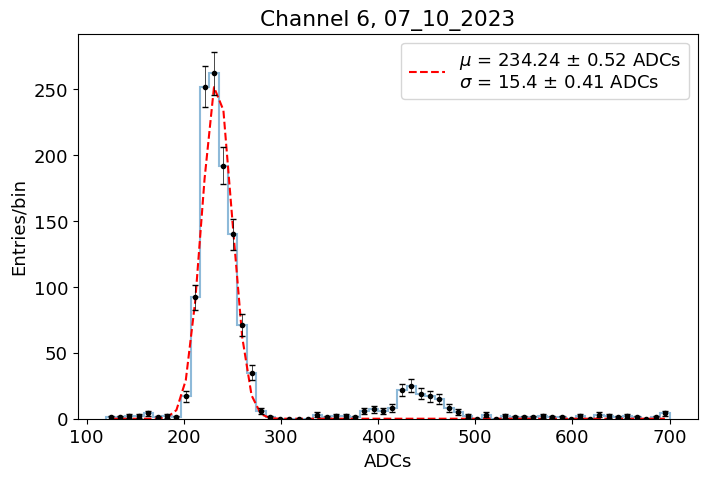

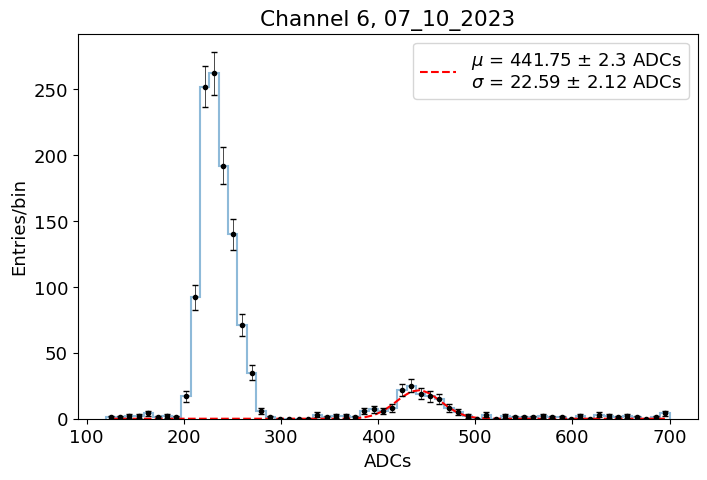

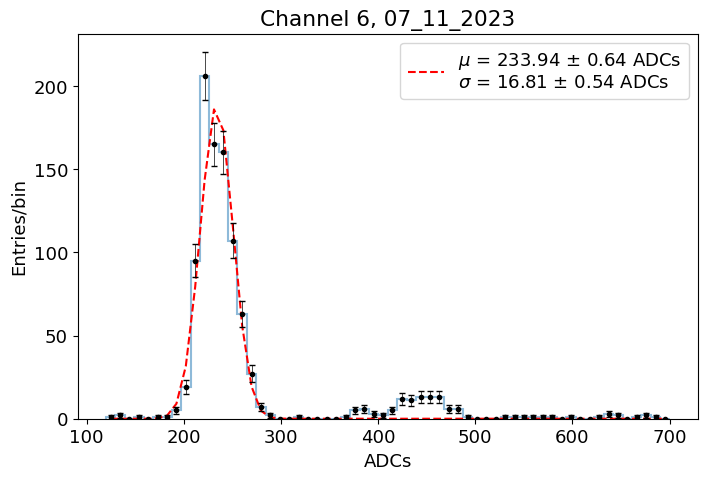

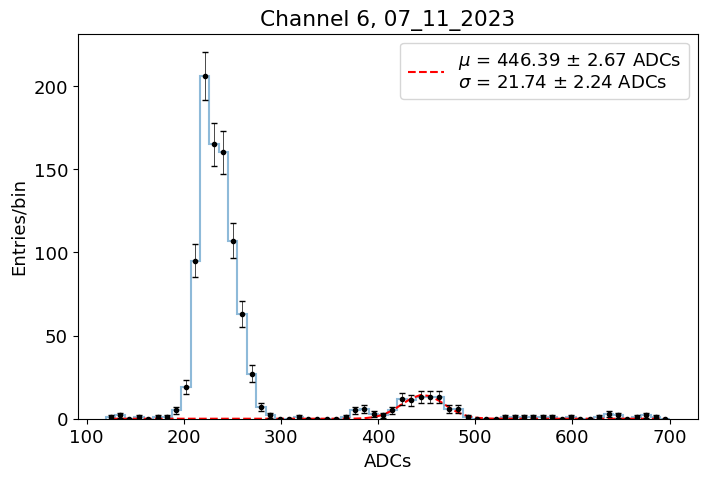

[223.2435203  207.75290767 211.28266374 207.7922976  211.26101227
 210.88727608 208.51305076 210.43929132 214.06926517 207.51137454
 212.44516175]


In [17]:
channel     = 6
gain_chann6 = []
for sel_date in peak_height_all_channels_dict.keys():
    #if sel_date == '05_22_2023': continue 
    try:
        vals1 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=60, prange=(120, 700), ampl=10000, mean=220, sigma=20, frange=(200, 270), title=f'Channel {channel}, {sel_date}', print_chi2=False)
        vals2 = fitf.gaussian_fit_IC(peak_height_all_channels_dict[sel_date][channel], bins=60, prange=(120, 700), ampl=10000, mean=440, sigma=20, frange=(400, 500), title=f'Channel {channel}, {sel_date}', print_chi2=False)
        gain_chann6.append(vals2[0] - vals1[0])
    except:
        continue
gain_chann6 = np.array(gain_chann6)
gain_chann6 = gain_chann6[gain_chann6<1000]
print(gain_chann6)

## Good channels

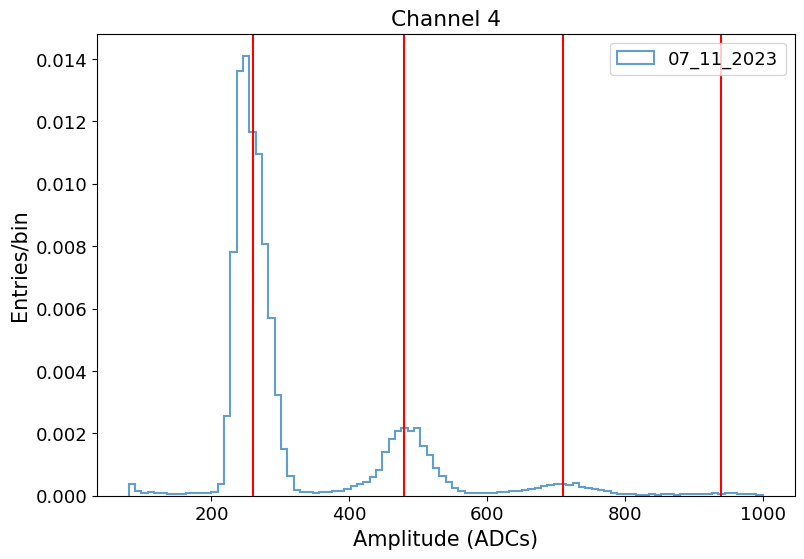

In [18]:
channel = 4
histogram = peak_height_all_channels_dict['07_11_2023'][channel]
plt.hist(histogram, bins=100, range=(80,1000), alpha=0.7, histtype='step', linewidth=1.5, density=True, label=f'{sel_date}')
plt.axvline(x=260, color='r')
plt.axvline(x=480, color='r')
plt.axvline(x=710, color='r')
plt.axvline(x=940, color='r')
plt.title(f'Channel {channel}')
plt.xlabel('Amplitude (ADCs)', fontsize=15)
plt.ylabel('Entries/bin',      fontsize=15)
plt.legend()
plt.show()


Date 04_16_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



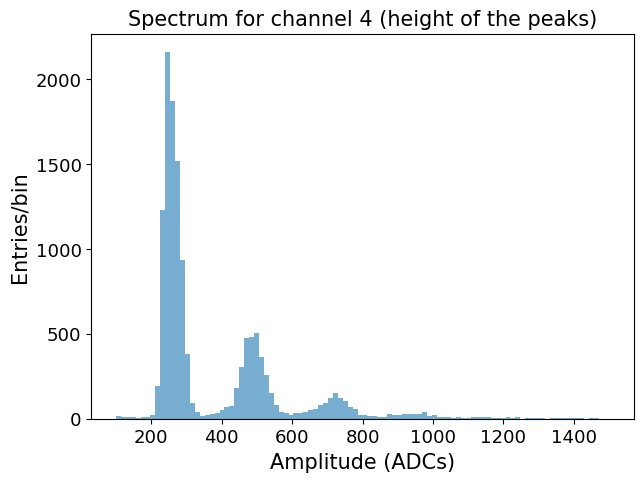

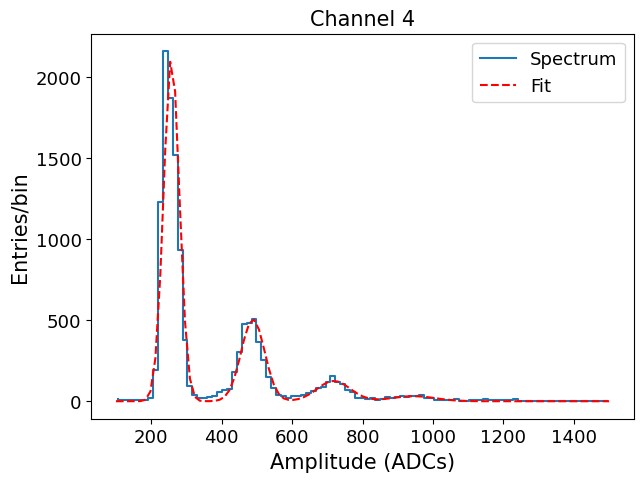

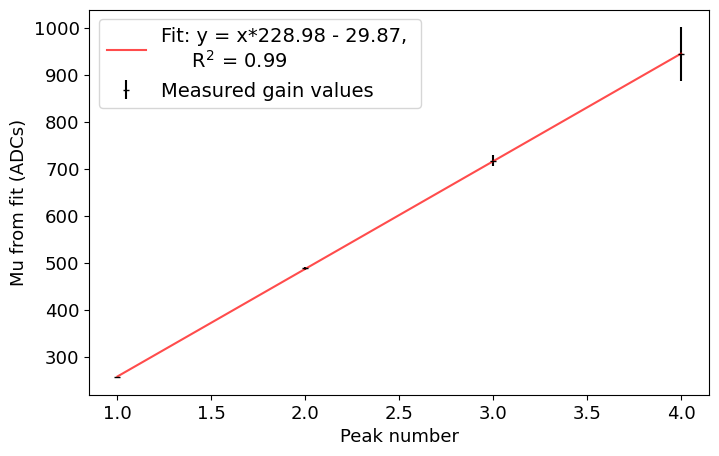


Date 05_08_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



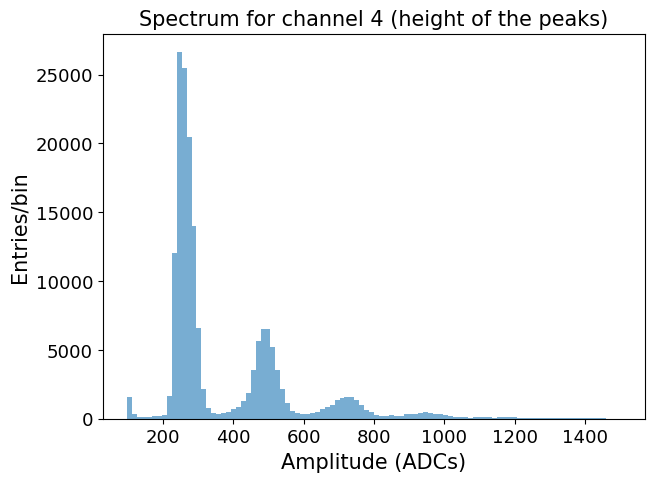

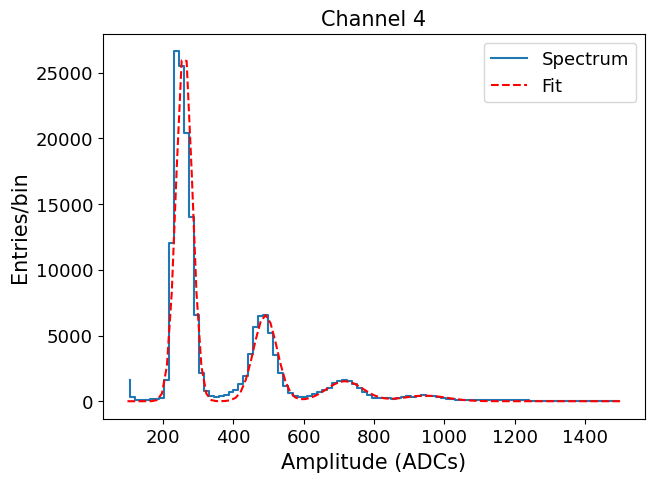

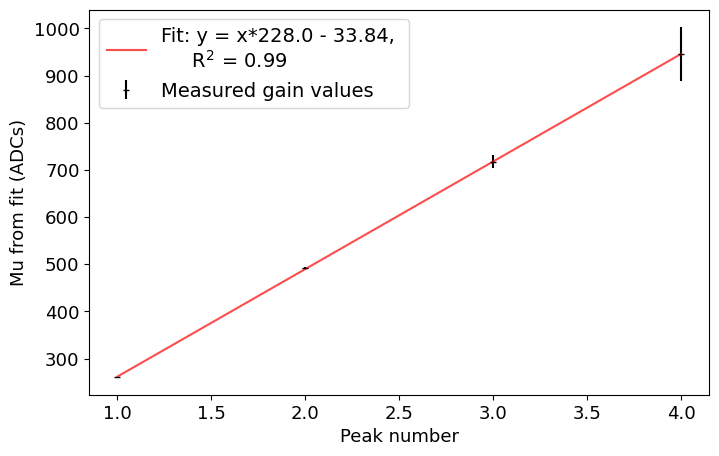


Date 05_30_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



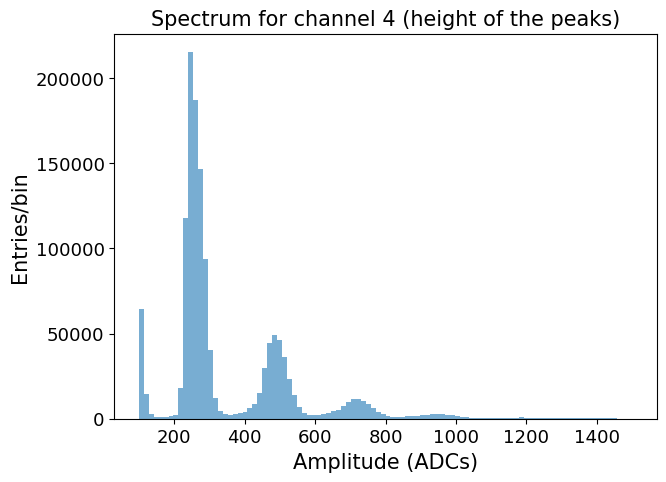

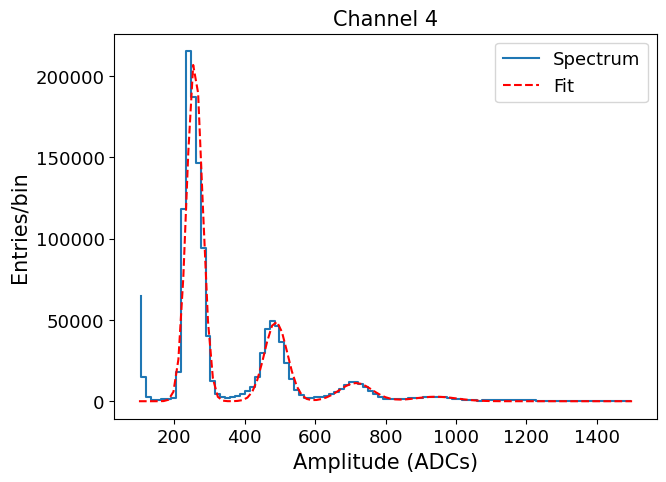

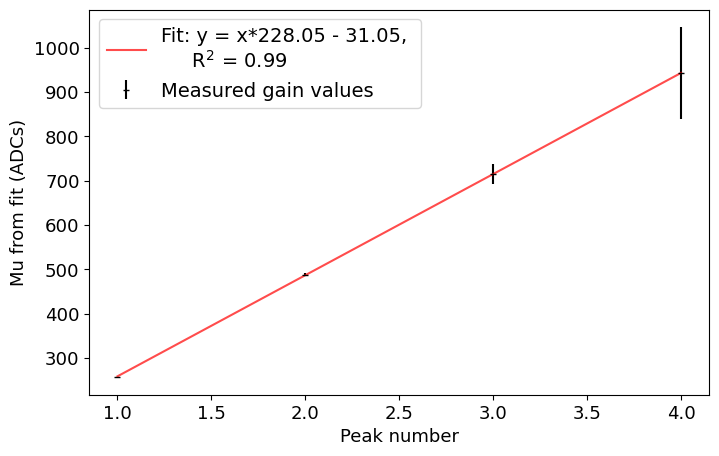


Date 06_01_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



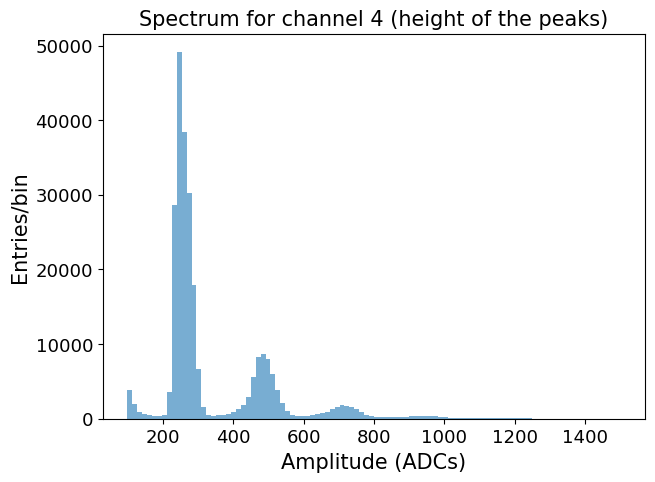

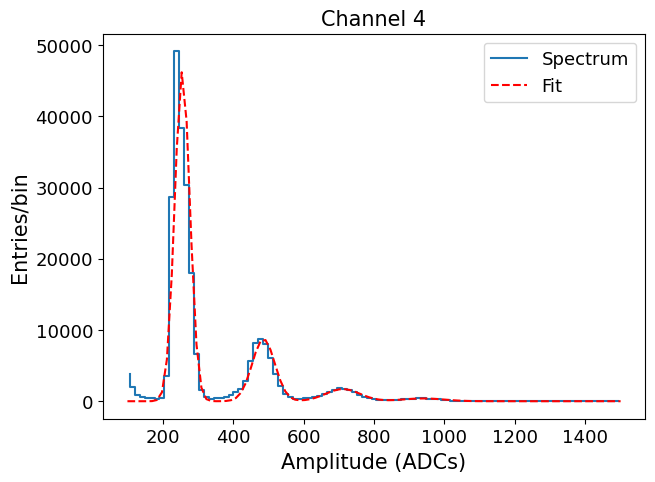

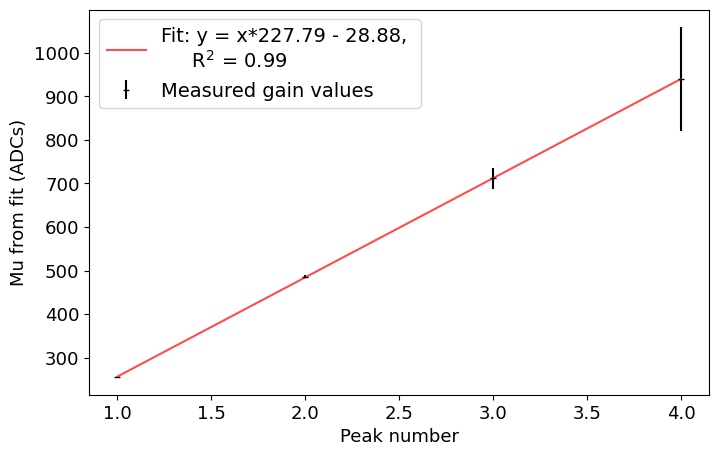


Date 06_02_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



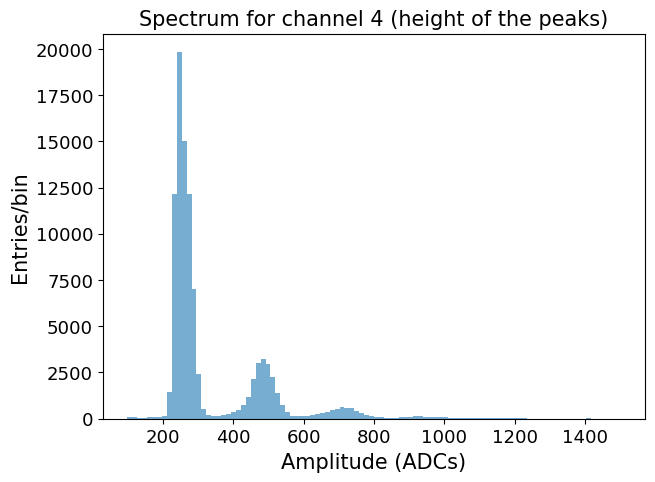

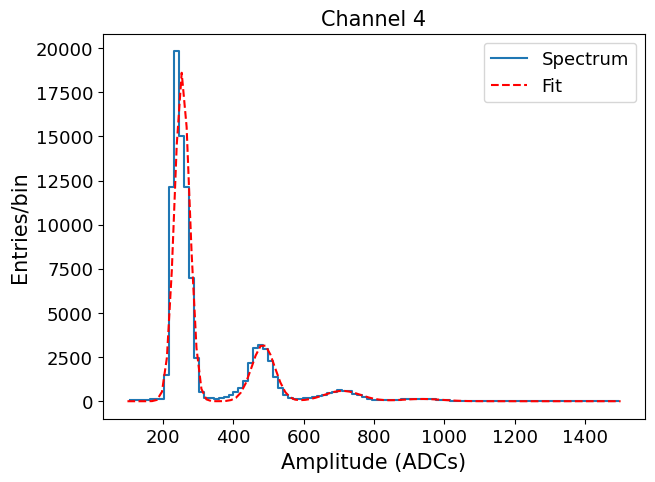

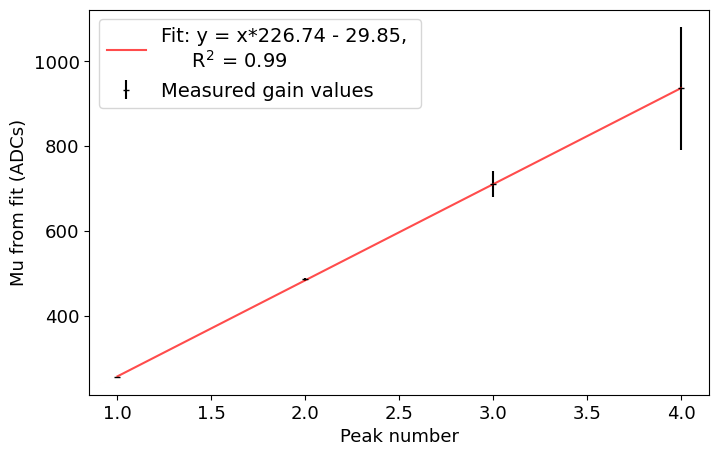


Date 06_19_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



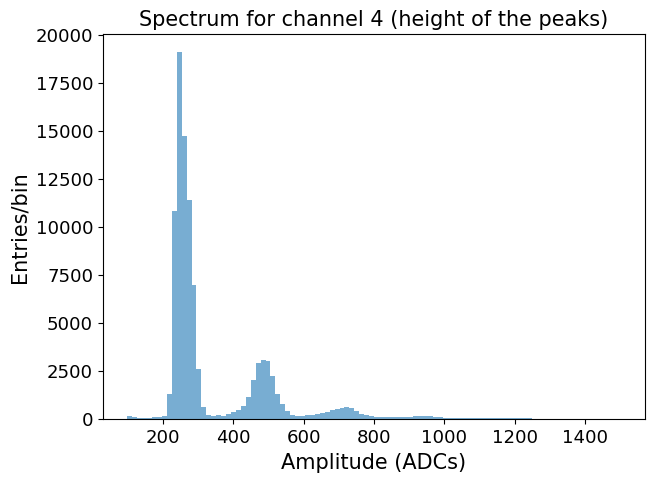

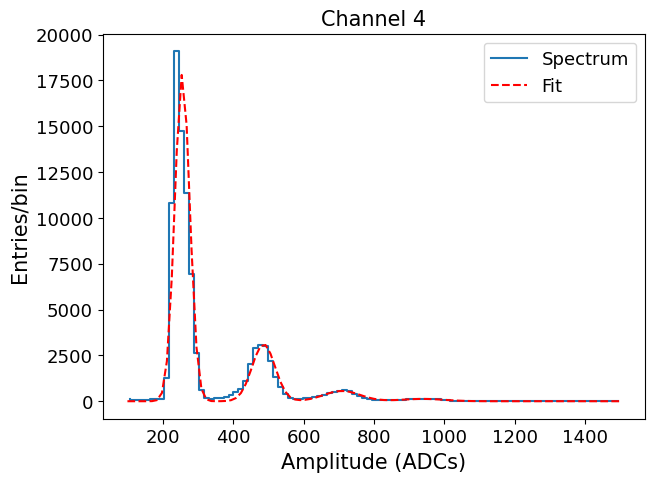

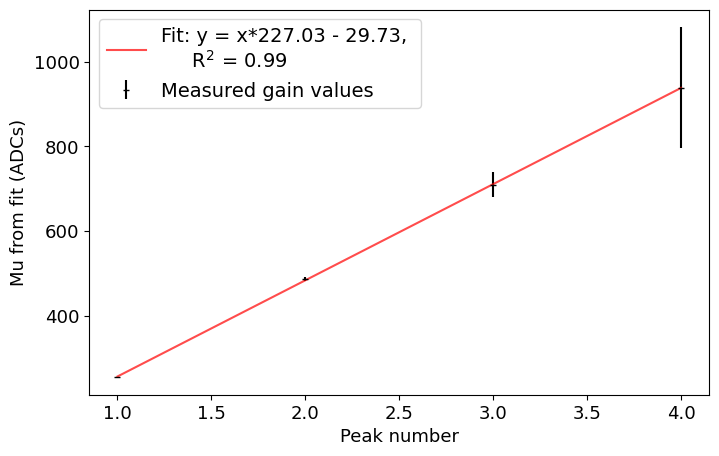


Date 06_20_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



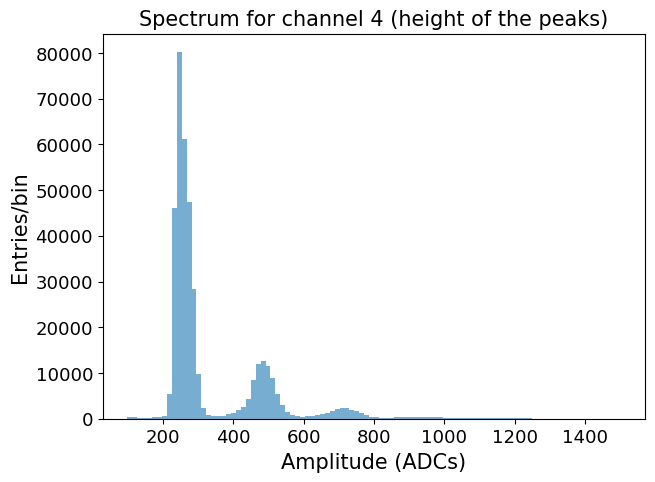

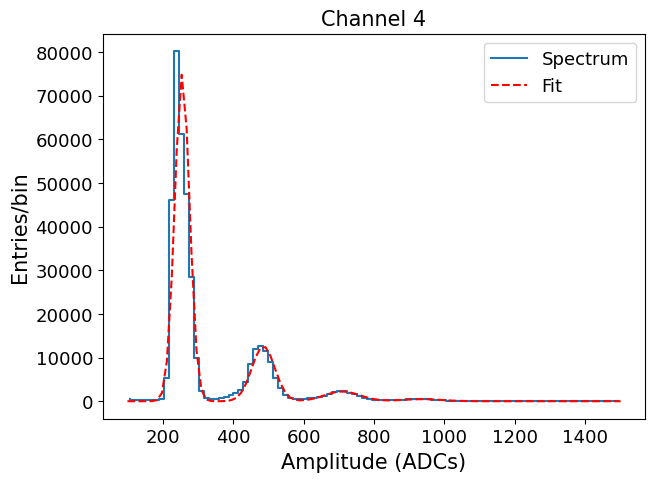

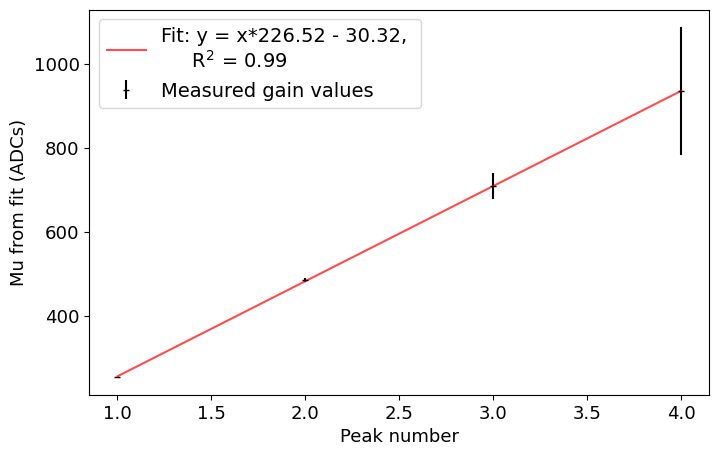


Date 06_21_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



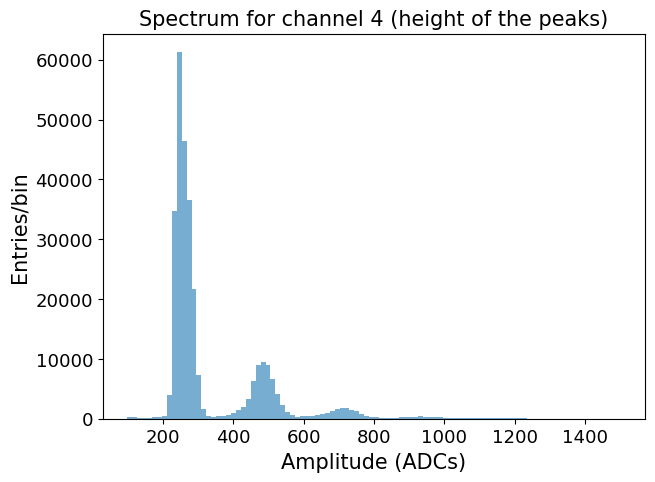

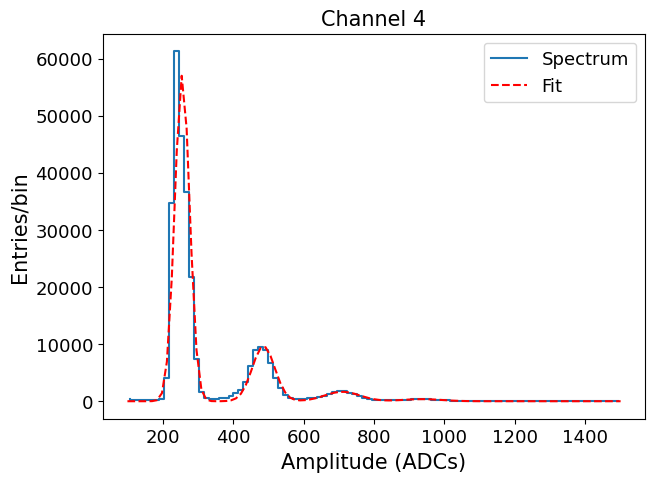

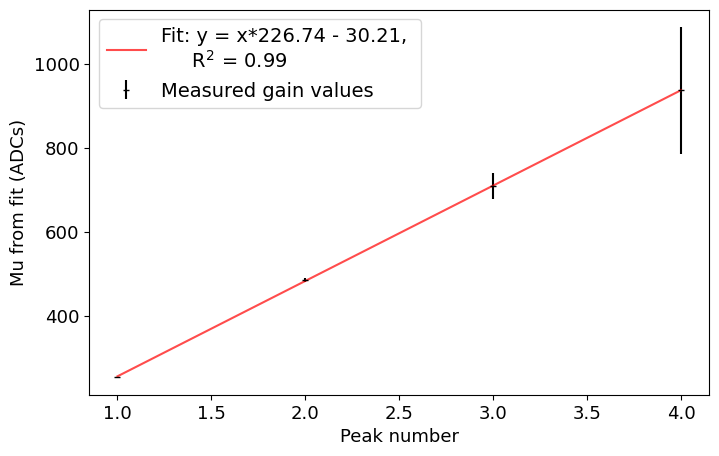


Date 06_24_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



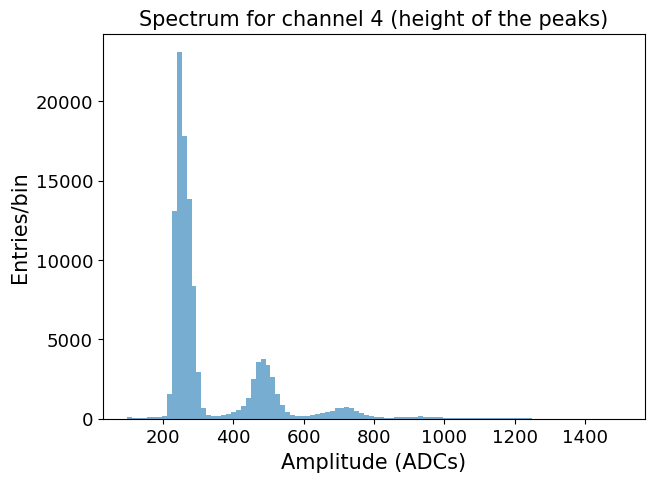

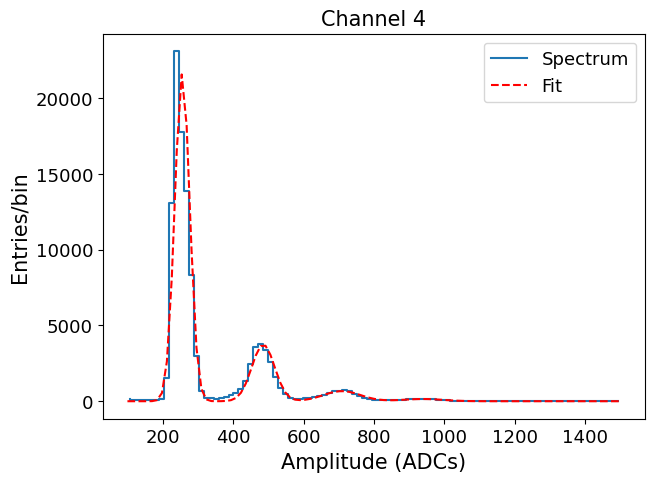

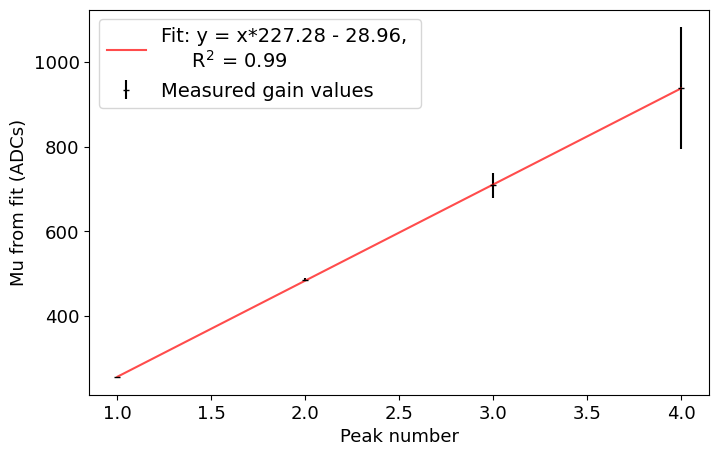


Date 07_05_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



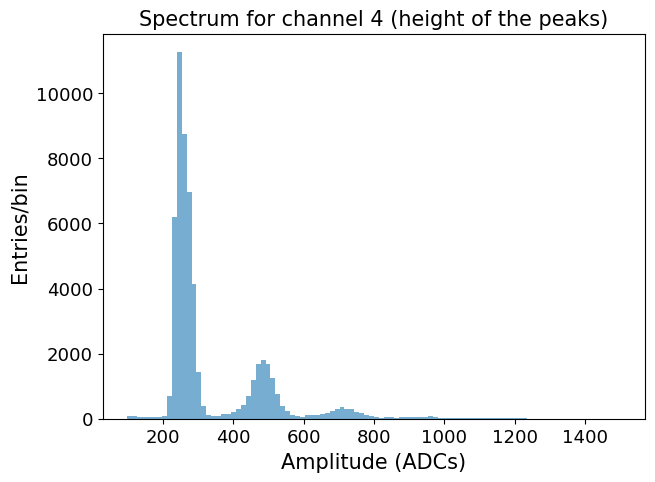

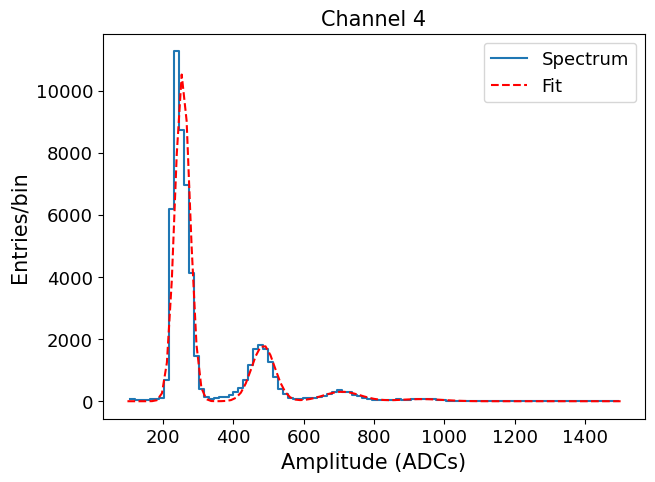

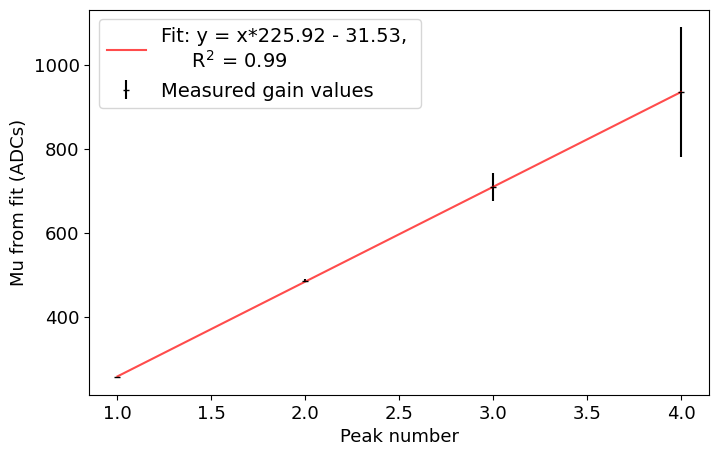


Date 07_06_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



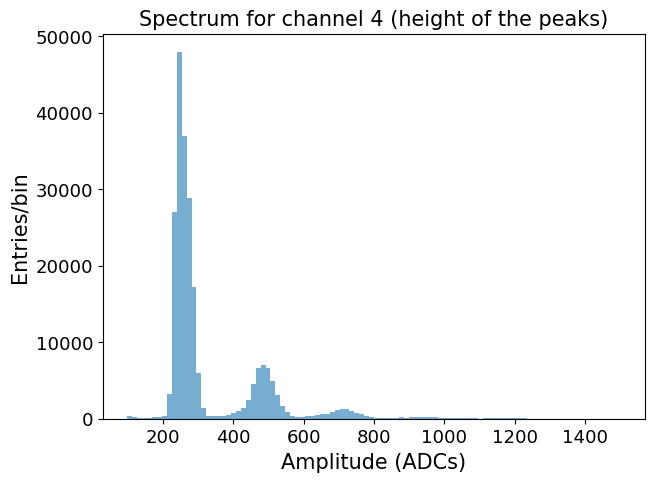

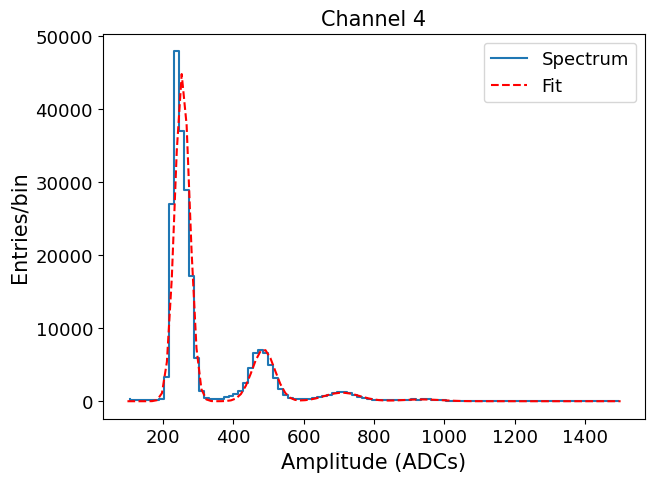

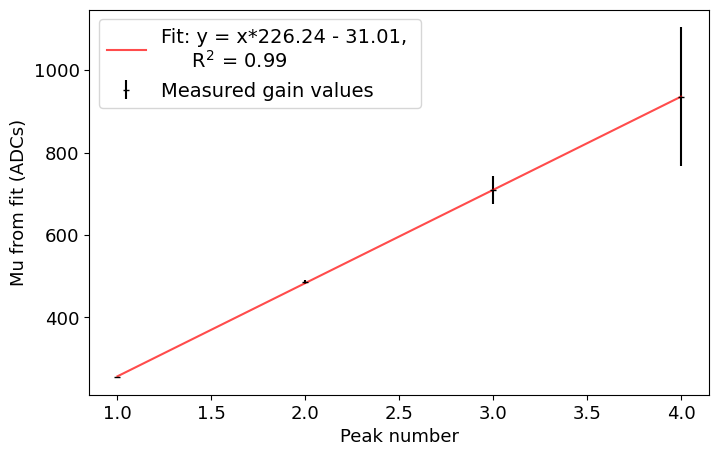


Date 07_07_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



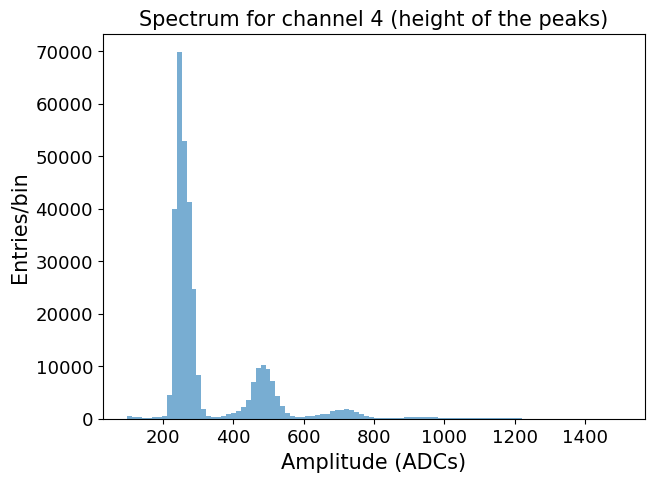

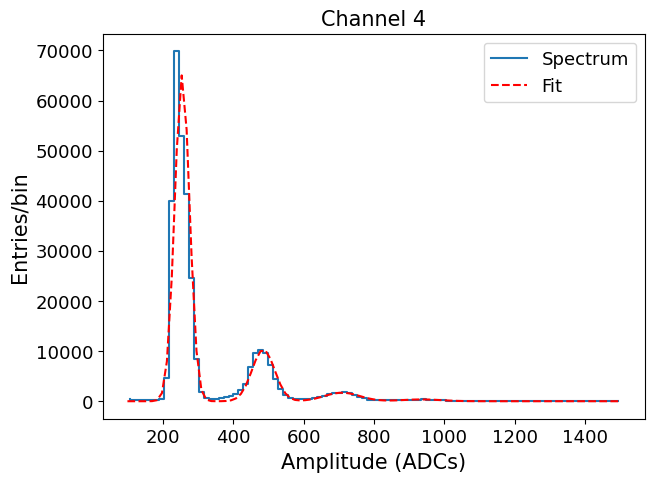

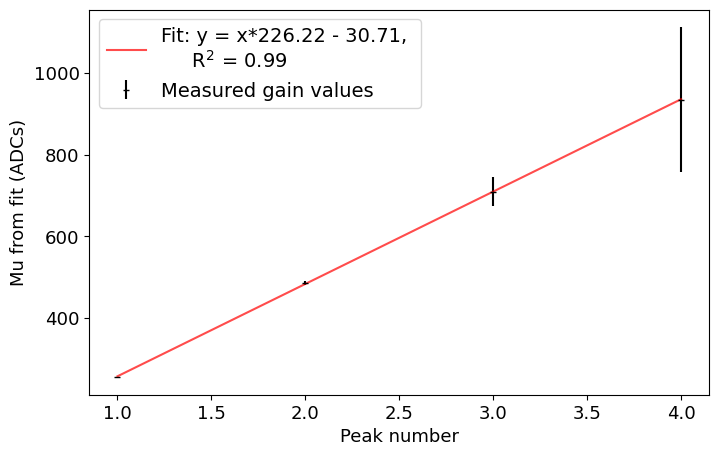


Date 07_08_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



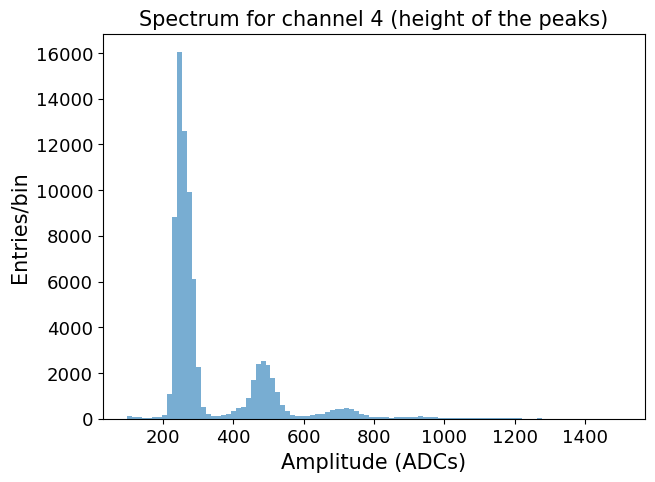

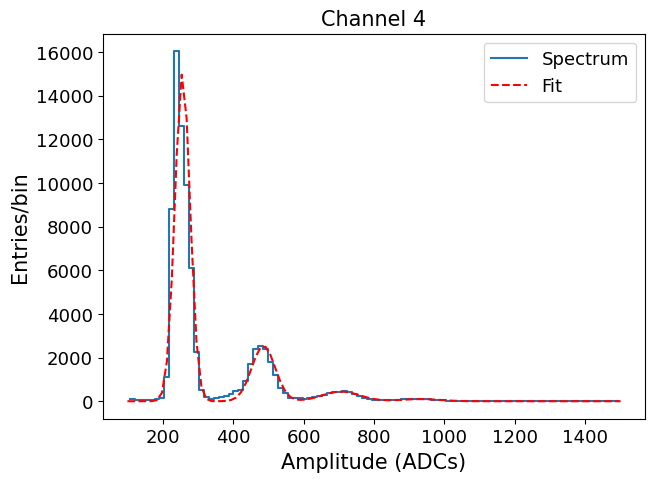

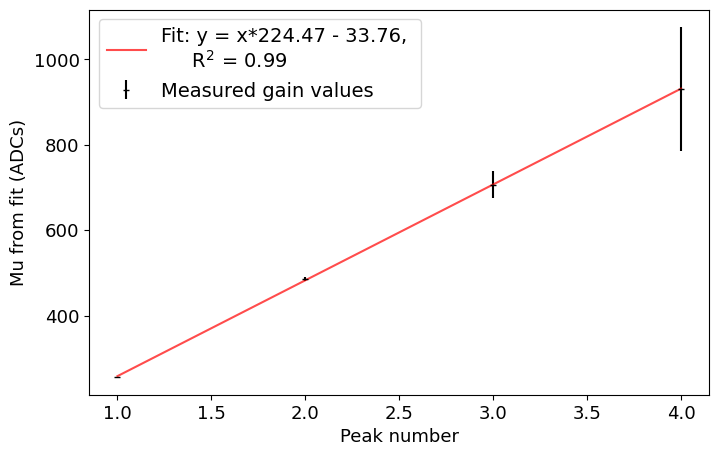


Date 07_10_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



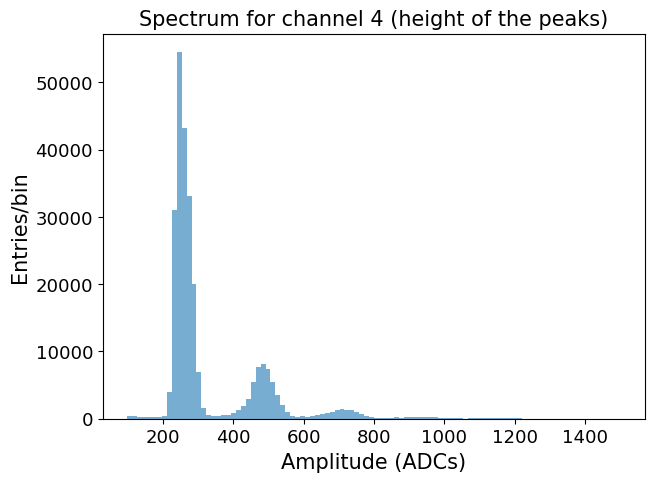

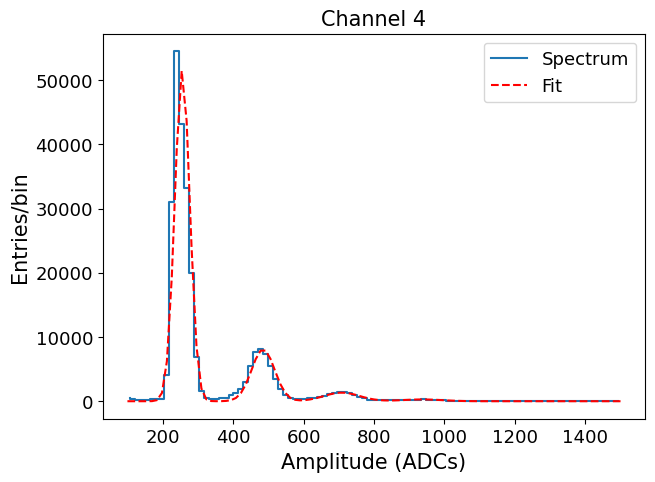

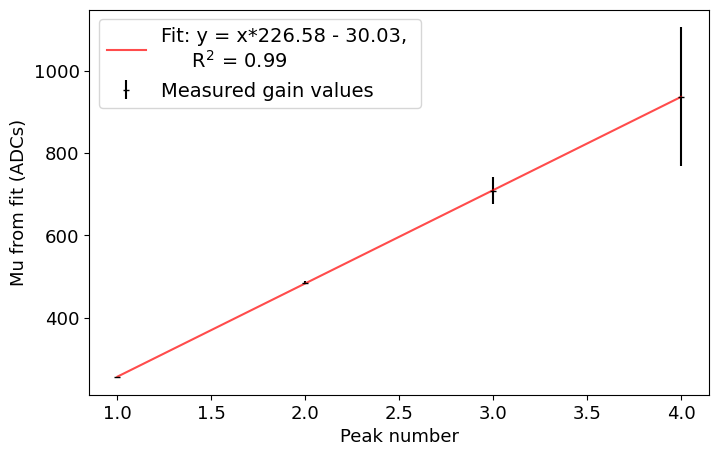


Date 07_11_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



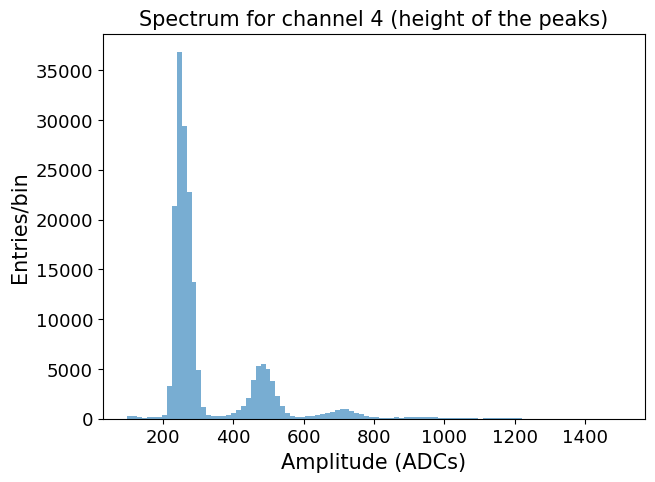

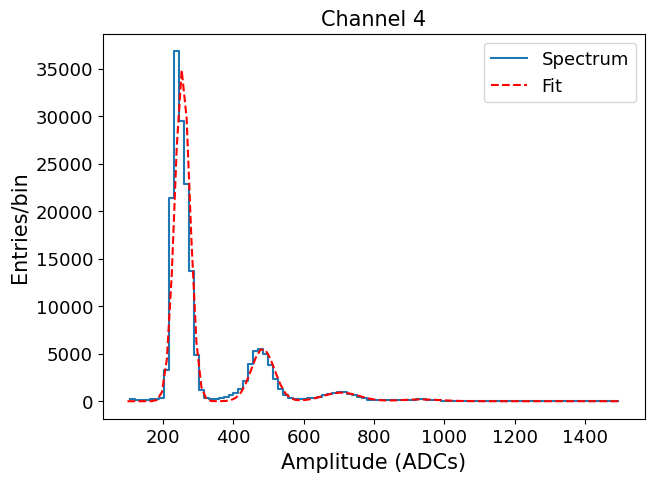

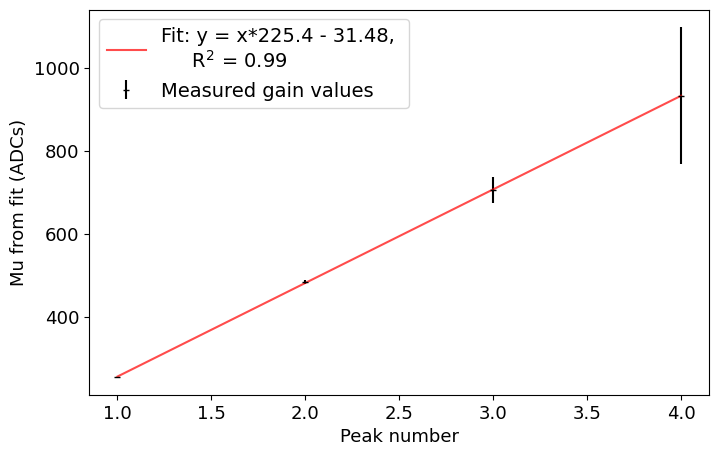

In [19]:
channel     = 4
gain_chann4 = []
for i, sel_date in enumerate(peak_height_all_channels_dict.keys()):
    #if i>1: break
    if sel_date == '05_22_2023': continue
    initial_guess  = [300000, 260, 10, 100000, 480, 15, 20000, 710, 15, 10000, 960, 15]
    try:
        print()
        print(f'Date {sel_date}')
        print()
        gain, ch_means = extract_gain_and_mean(peak_height_all_channels_dict[sel_date][channel],
                                               channel       = channel,
                                               bins          = 100,
                                               prange        = (100, 1500),
                                               initial_guess = initial_guess)
        gain_chann4.append(gain)
    except:
        continue

gain_chann4 = np.array(gain_chann4)

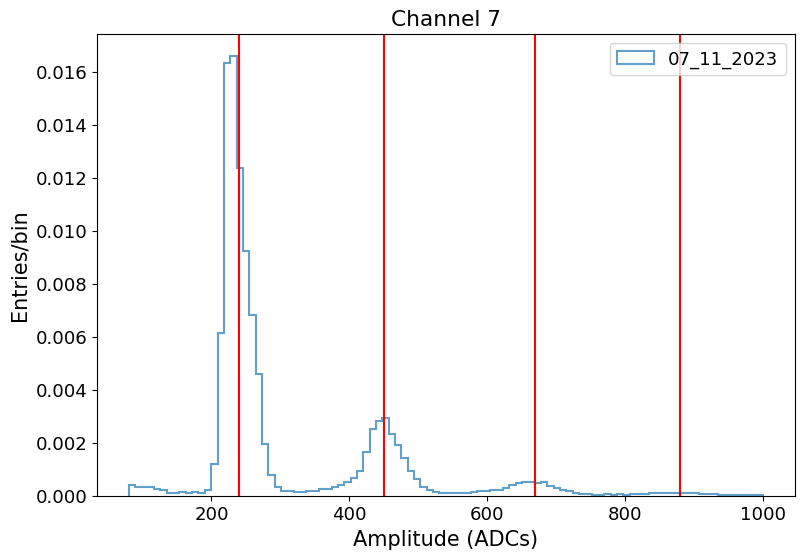

In [20]:
channel   = 7
histogram = peak_height_all_channels_dict['07_11_2023'][channel]
plt.hist(histogram, bins=100, range=(80,1000), alpha=0.7, histtype='step', linewidth=1.5, density=True, label=f'{sel_date}')
plt.axvline(x=240, color='r')
plt.axvline(x=450, color='r')
plt.axvline(x=670, color='r')
plt.axvline(x=880, color='r')
plt.title(f'Channel {channel}')
plt.xlabel('Amplitude (ADCs)', fontsize=15)
plt.ylabel('Entries/bin',      fontsize=15)
plt.legend()
plt.show()


Date 04_16_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



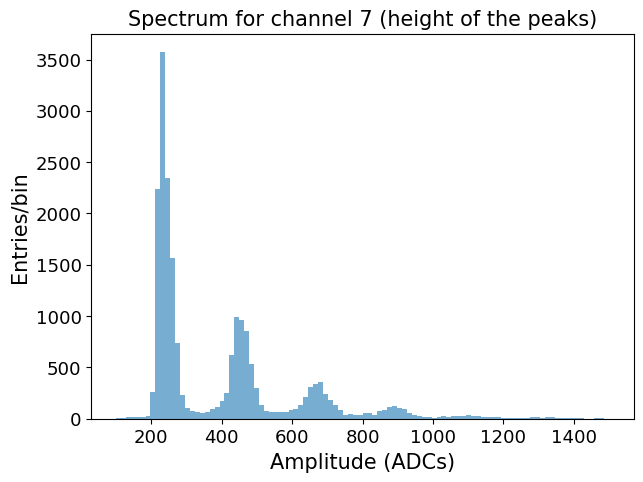

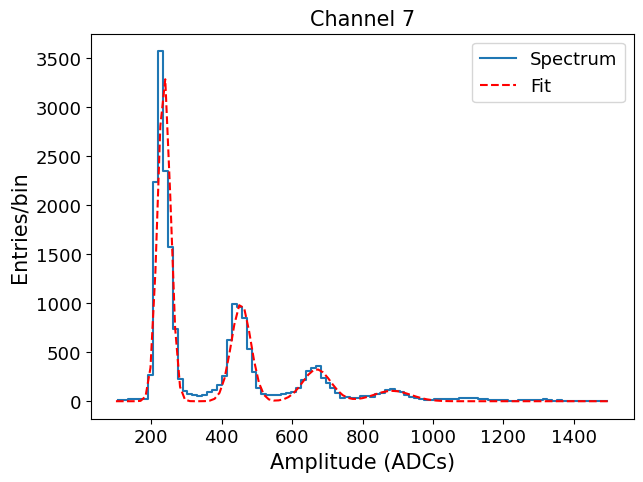

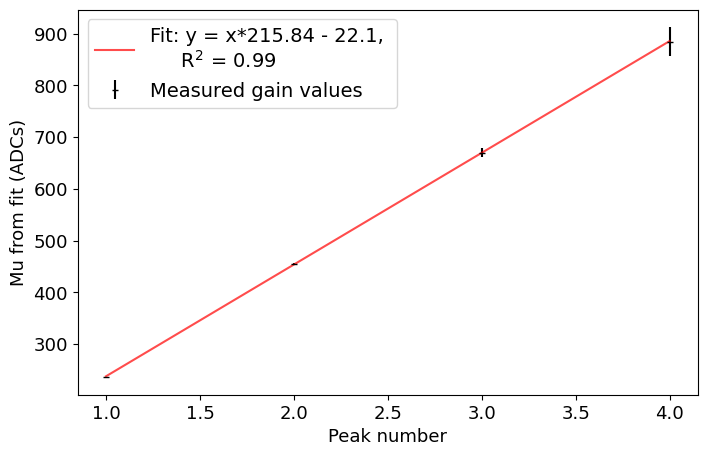


Date 05_08_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



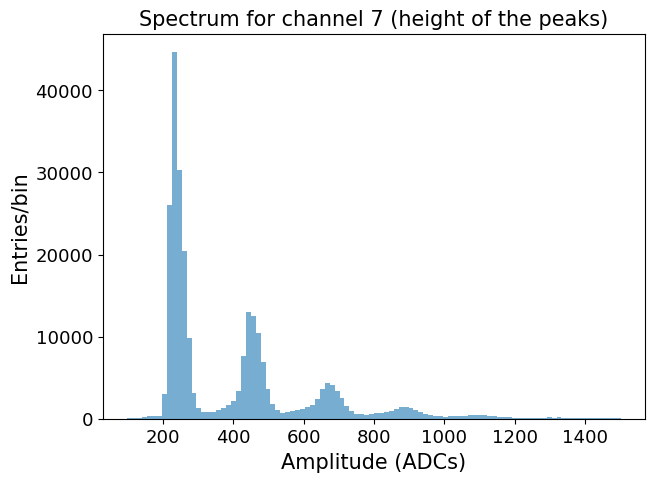

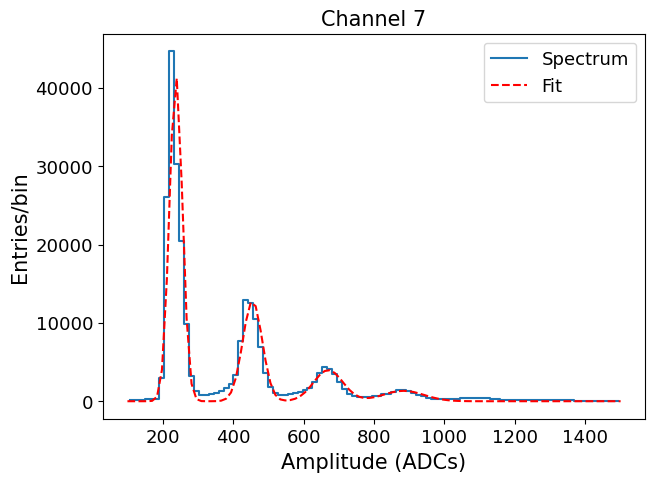

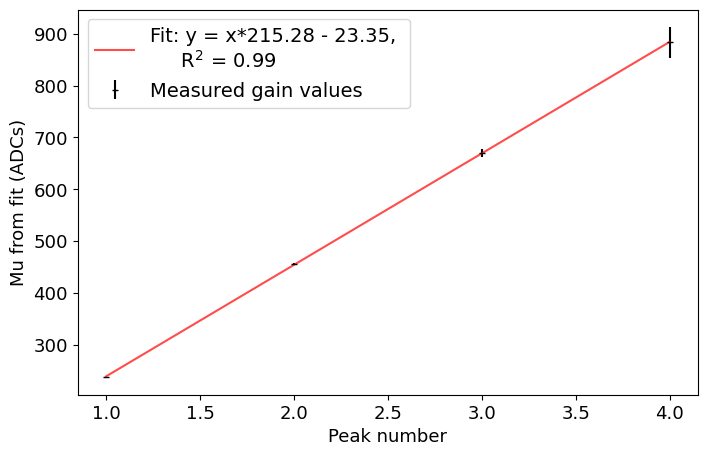


Date 05_30_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



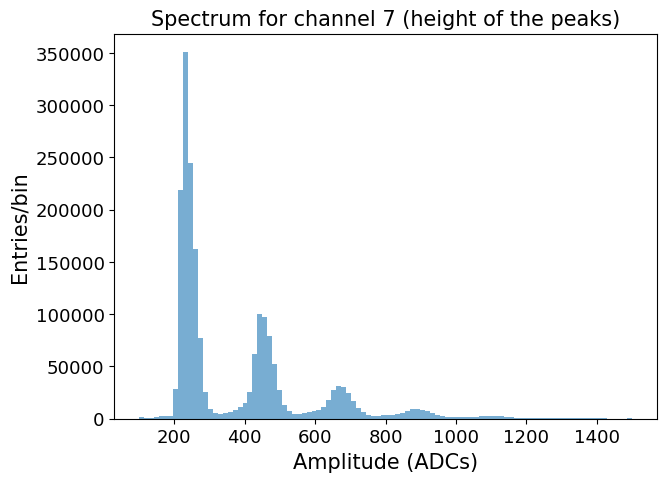

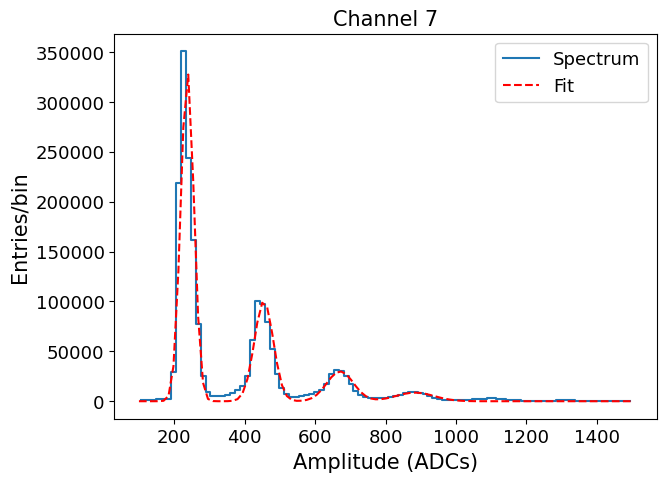

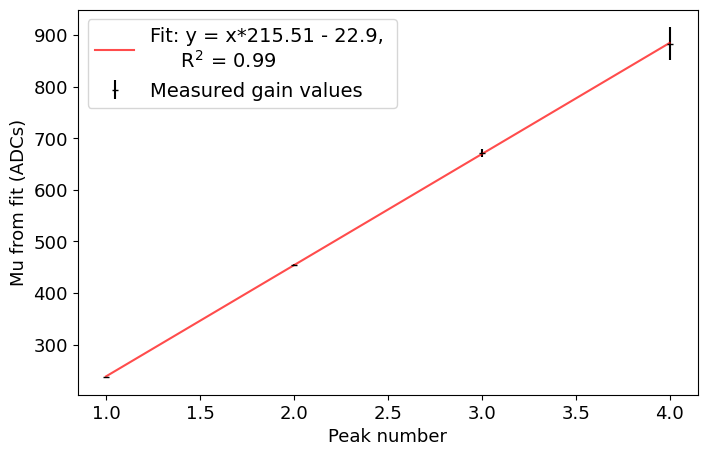


Date 06_01_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



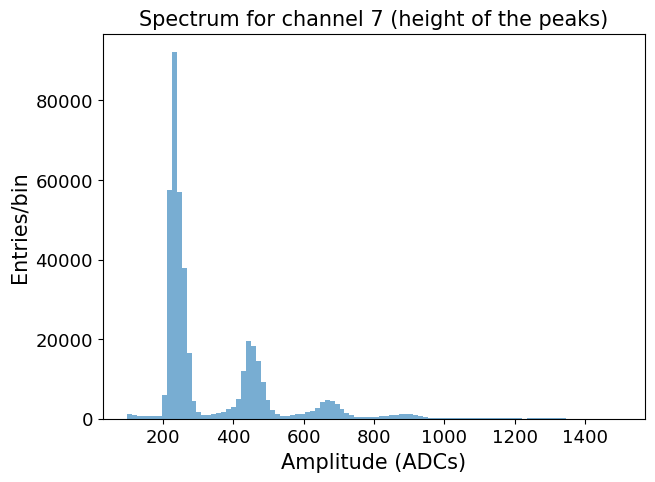

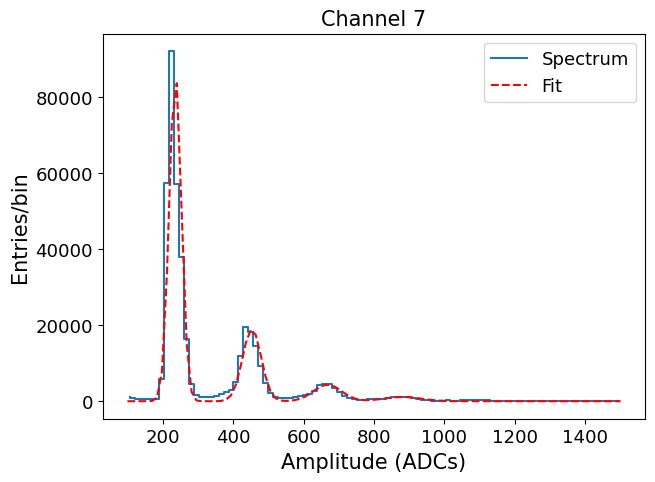

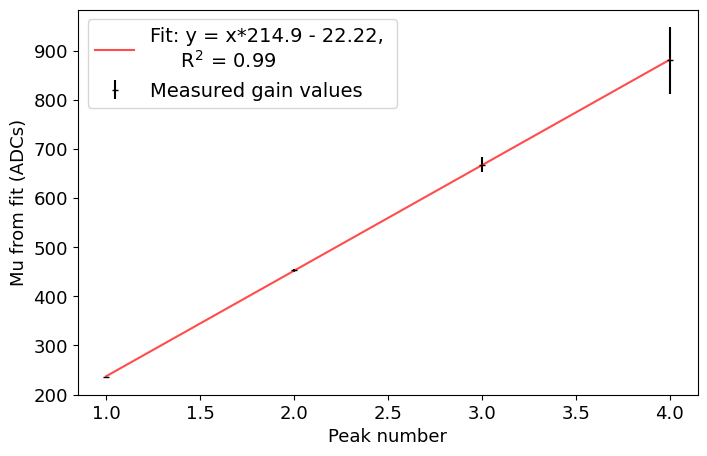


Date 06_02_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



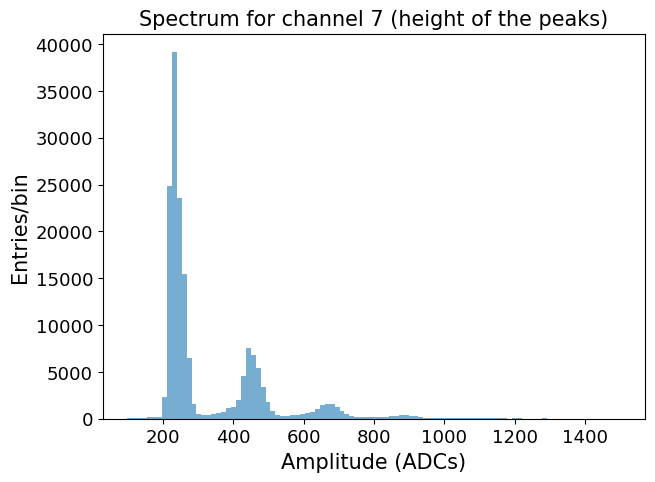

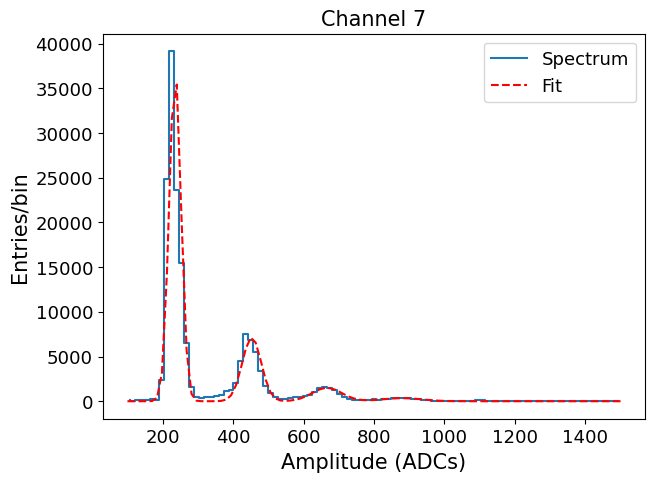

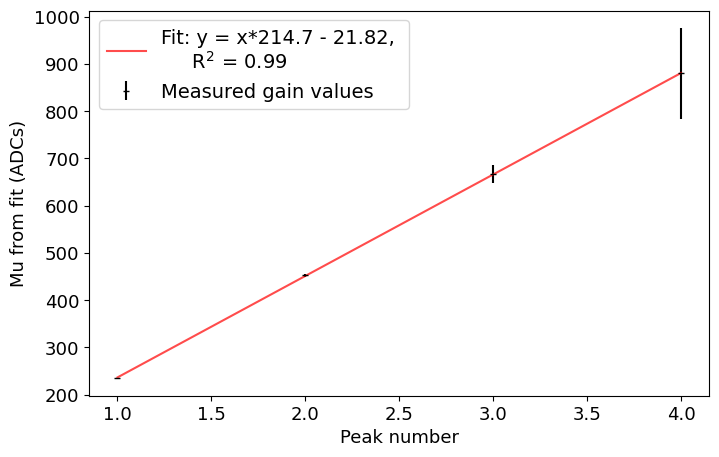


Date 06_19_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



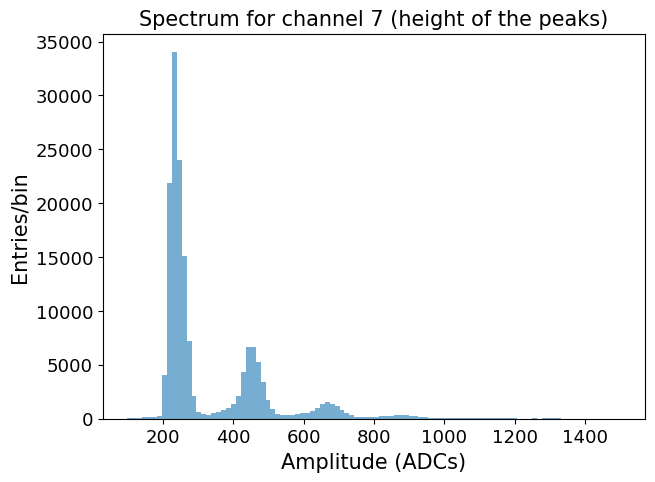

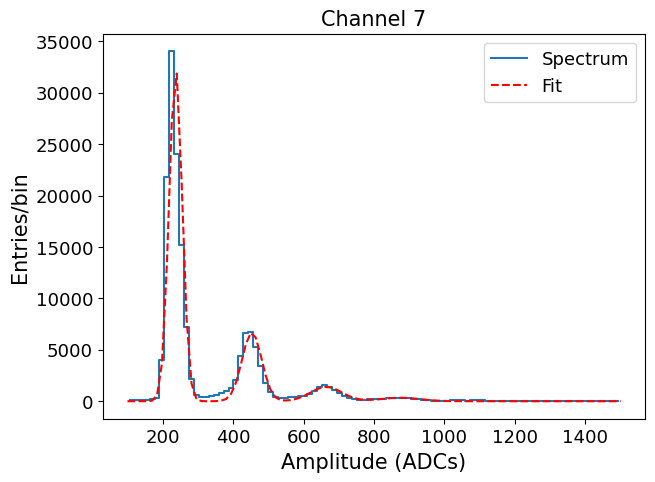

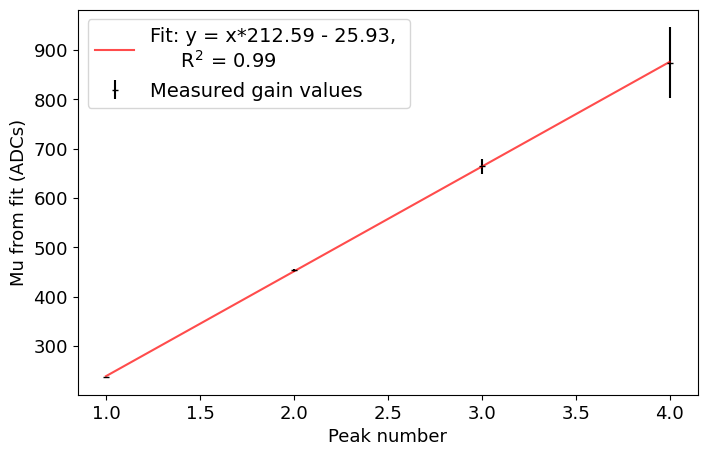


Date 06_20_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



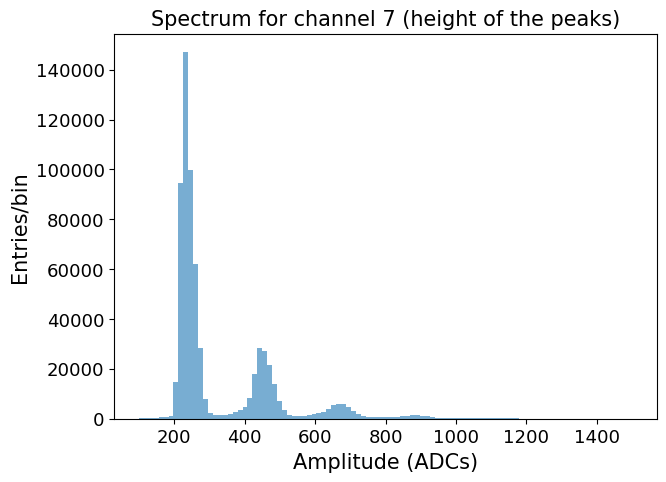

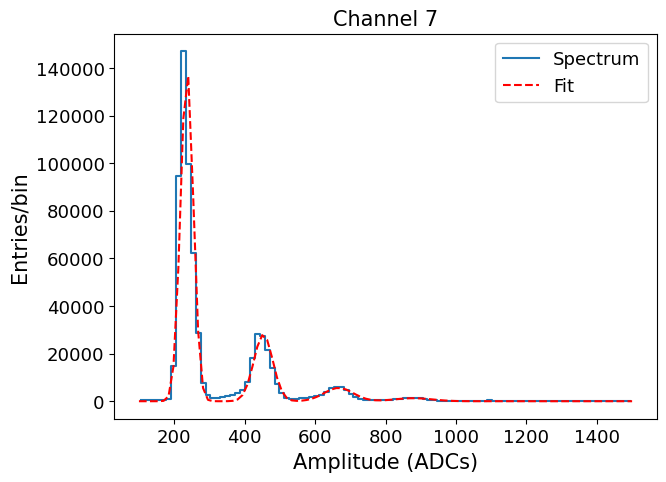

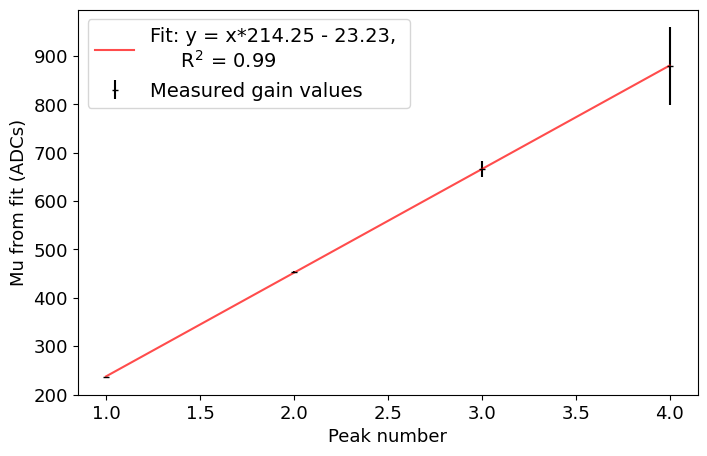


Date 06_21_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



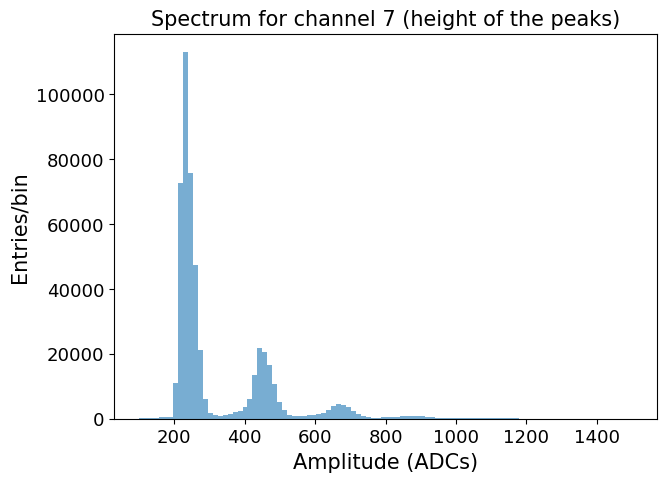

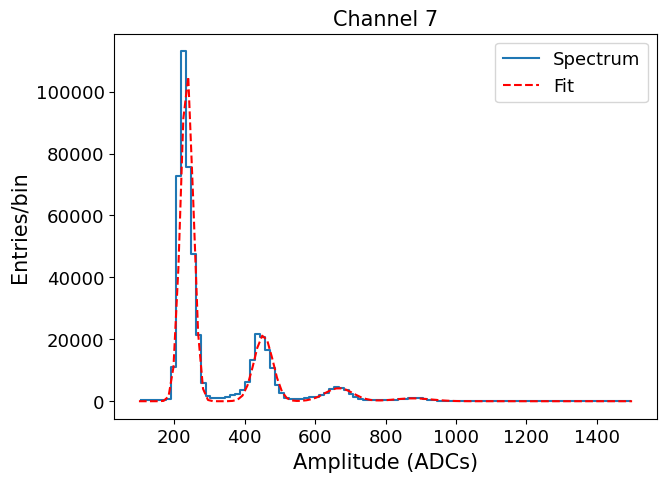

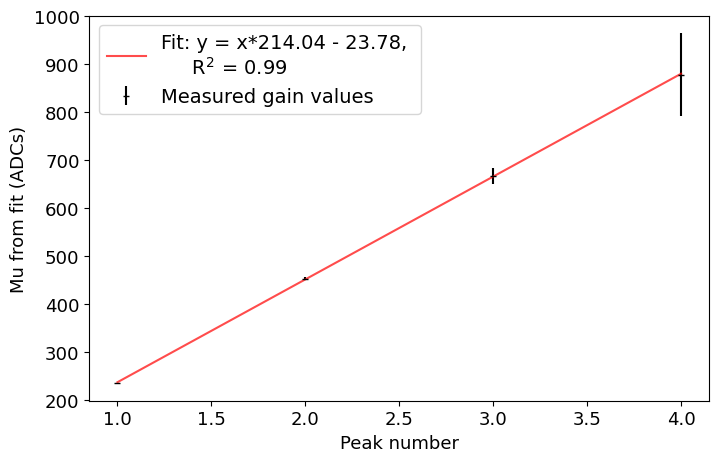


Date 06_24_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



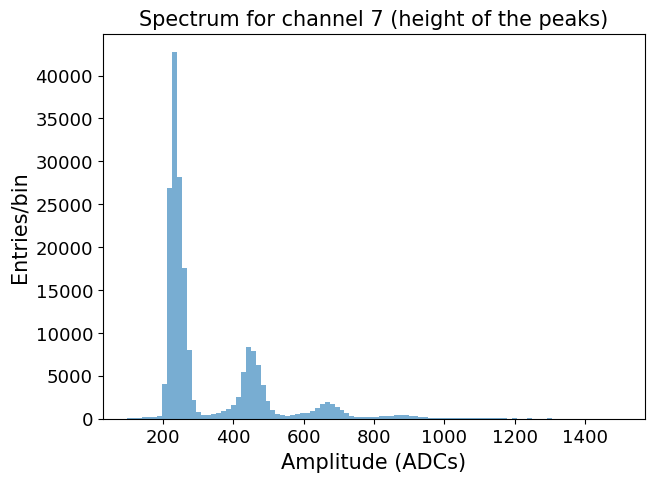

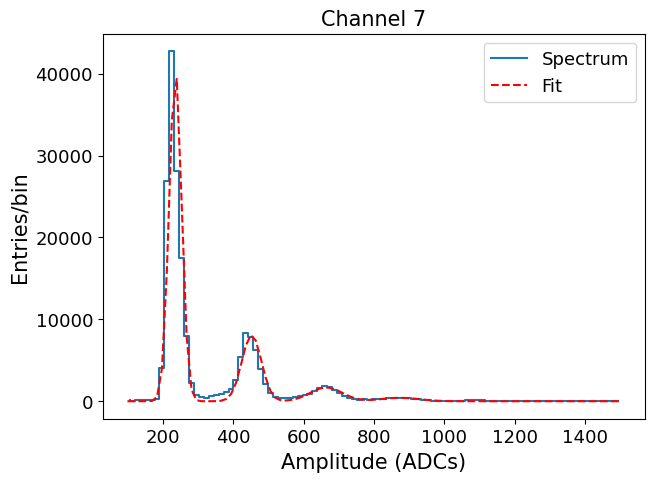

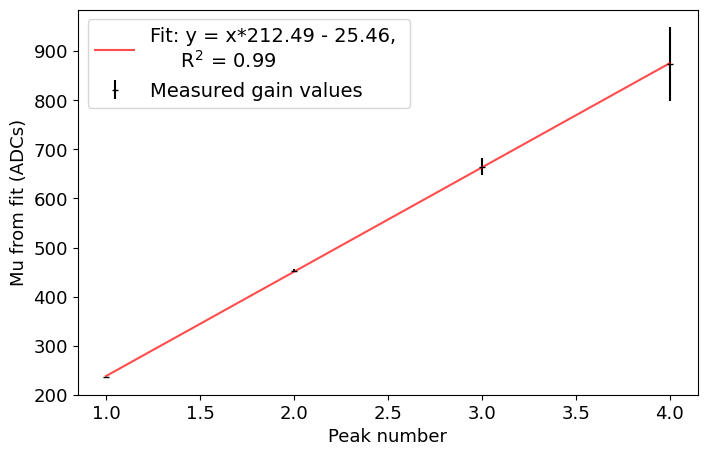


Date 07_05_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



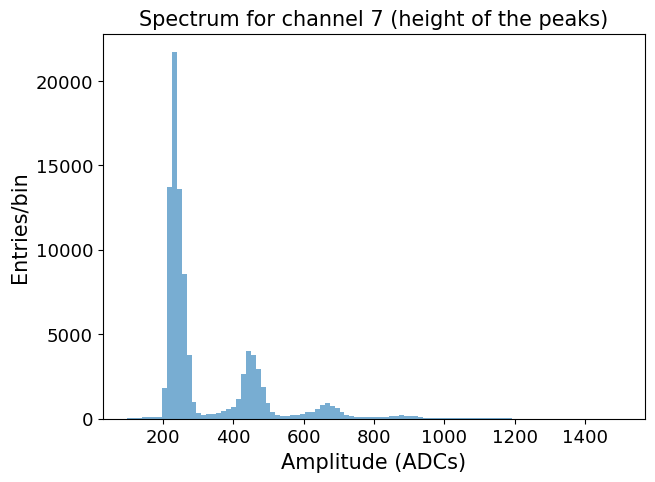

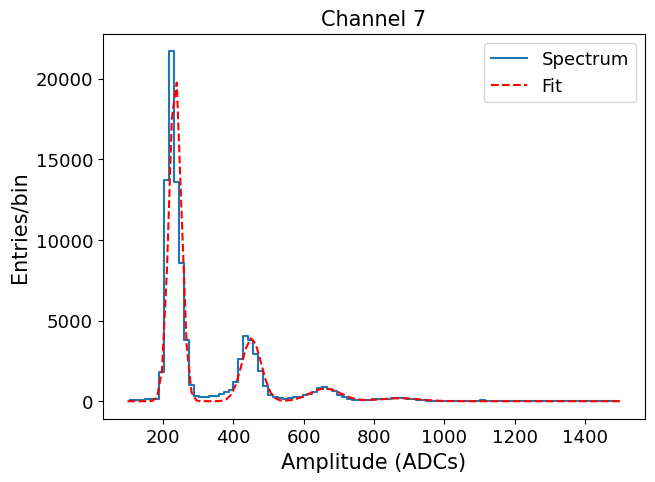

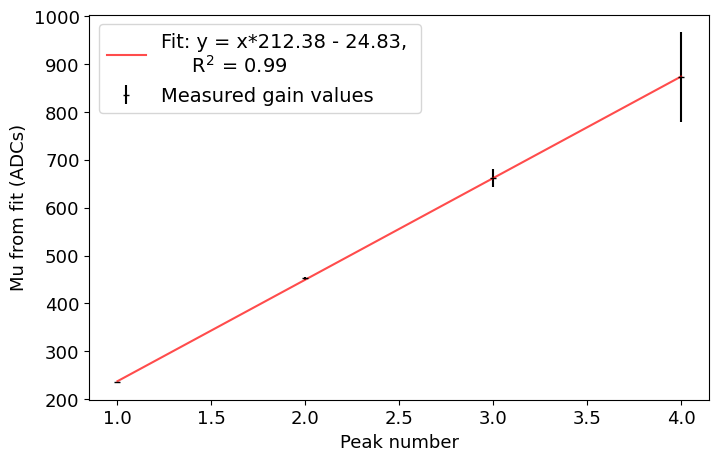


Date 07_06_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



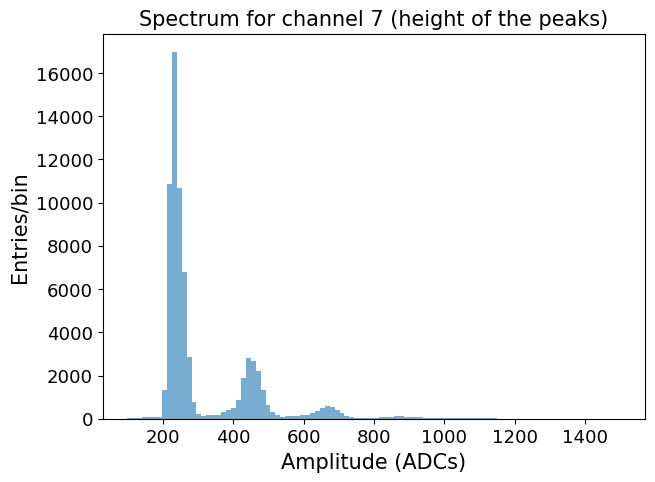

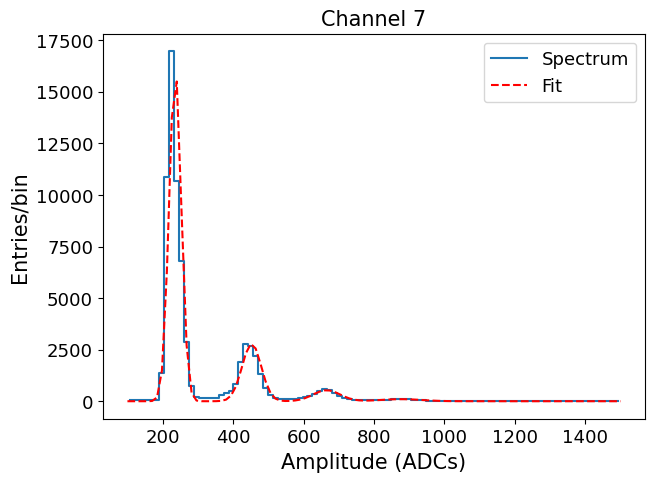

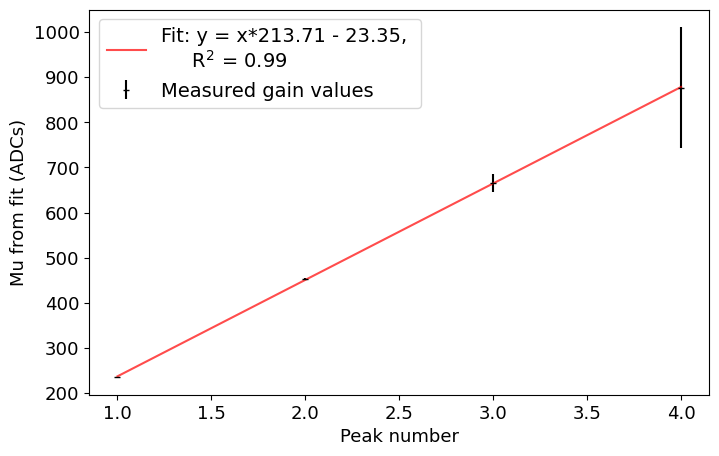


Date 07_07_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



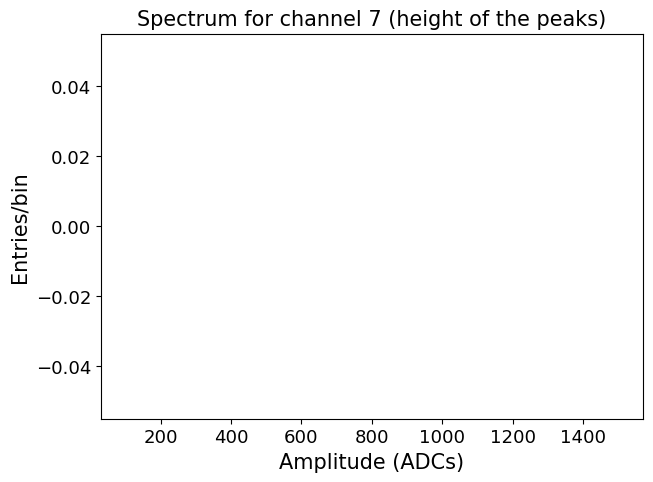

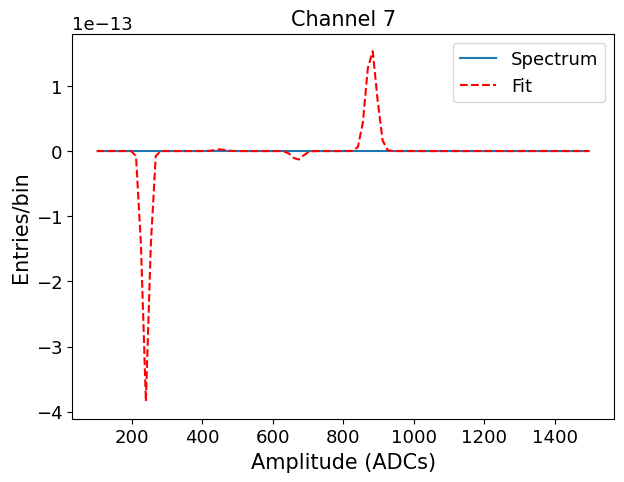

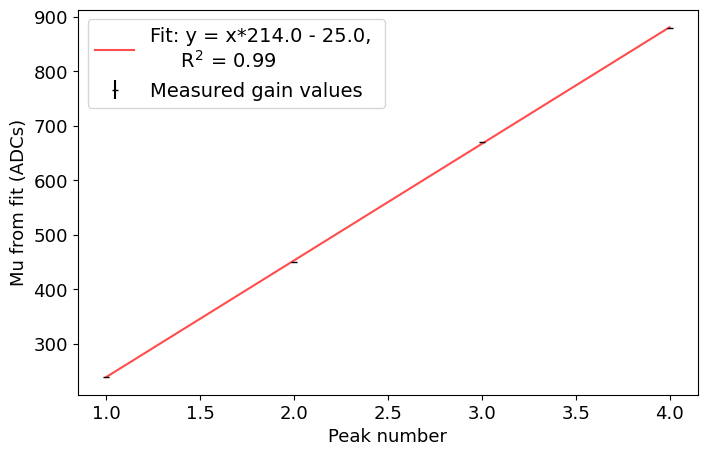


Date 07_08_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



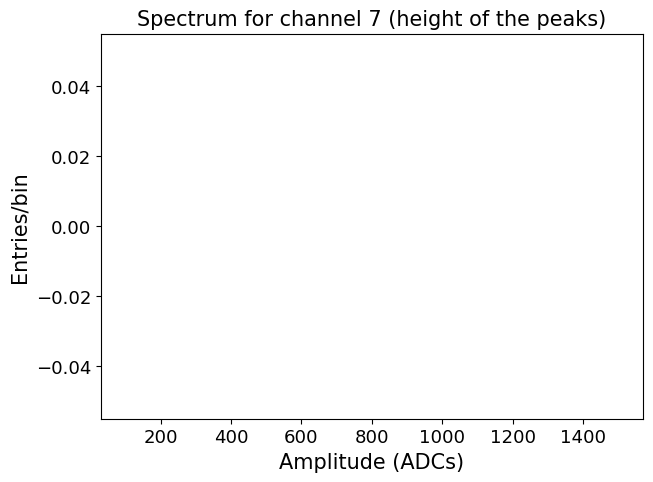

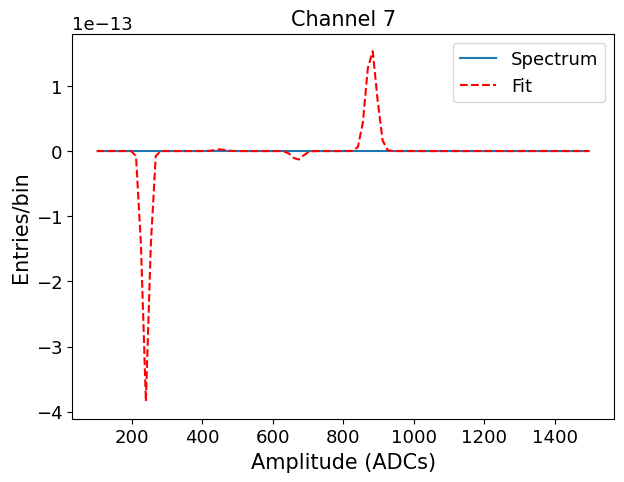

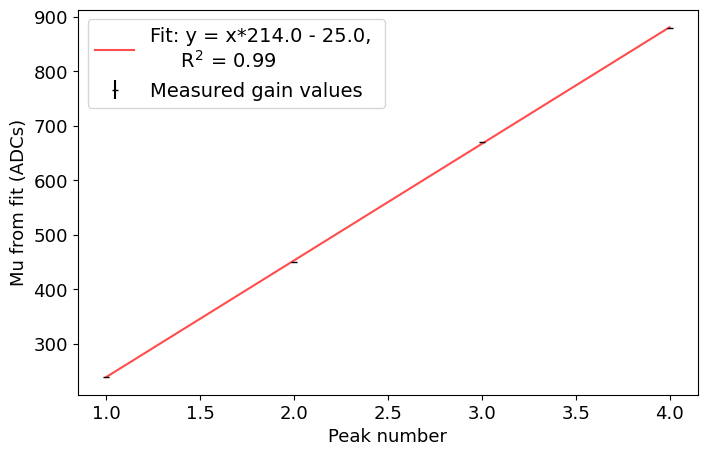


Date 07_10_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



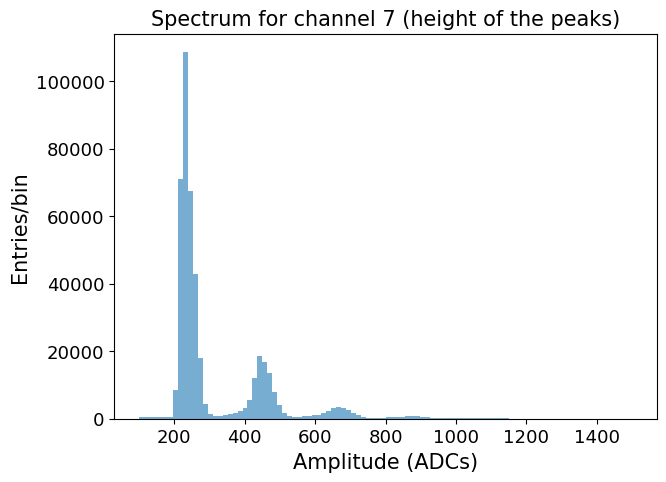

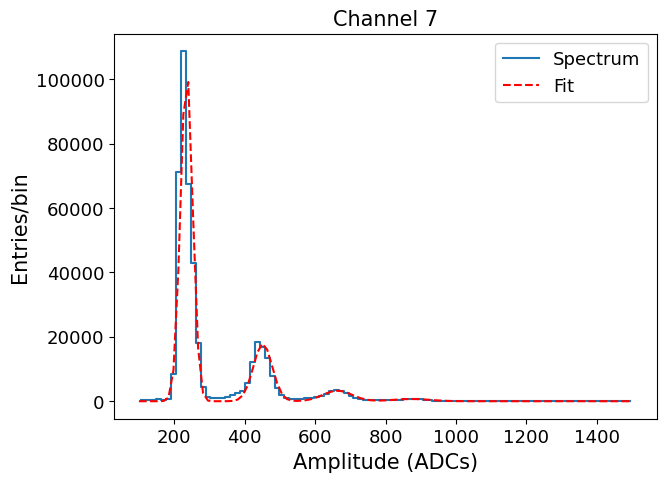

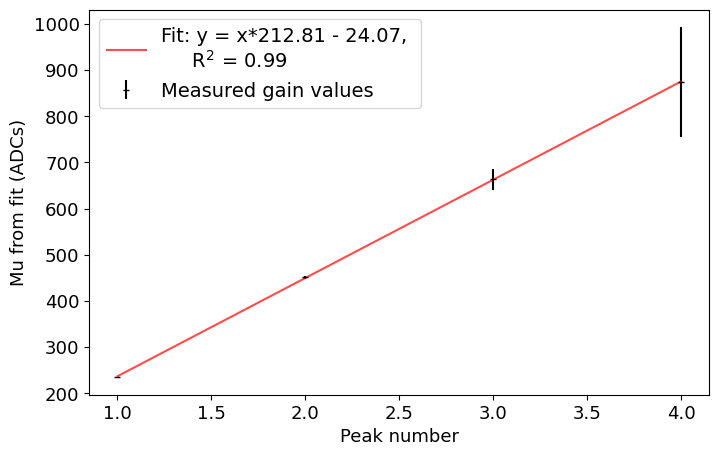


Date 07_11_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



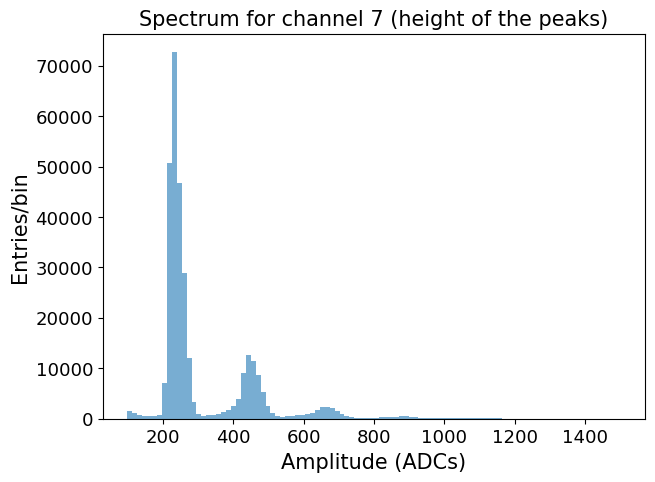

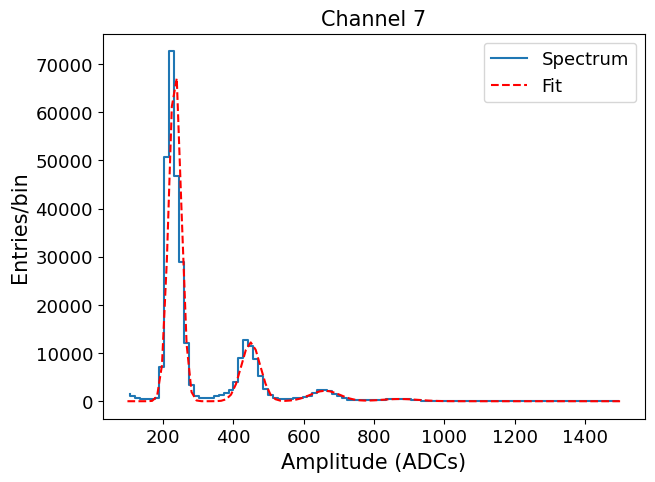

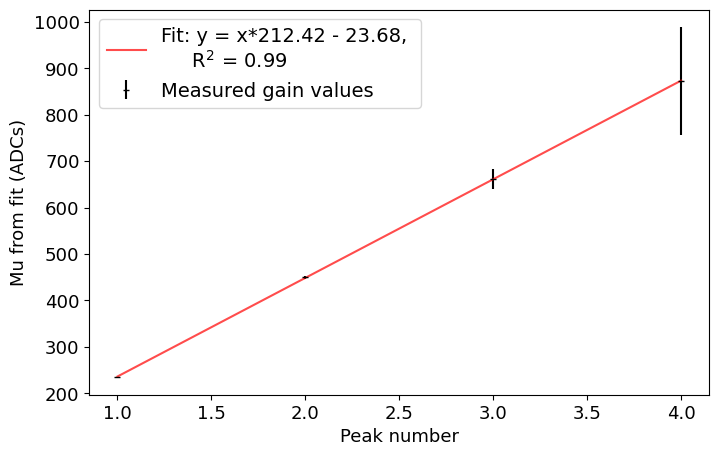

In [21]:
channel     = 7
gain_chann7 = []
for sel_date in peak_height_all_channels_dict.keys():
    if sel_date == '05_22_2023': continue
    initial_guess  = [300000, 240, 10, 100000, 450, 15, 20000, 670, 15, 10000, 880, 15]
    try:
        print()
        print(f'Date {sel_date}')
        print()
        gain, ch_means = extract_gain_and_mean(peak_height_all_channels_dict[sel_date][channel],
                                               channel       = channel,
                                               bins          = 100,
                                               prange        = (100, 1500),
                                               initial_guess = initial_guess)
        gain_chann7.append(gain)
    except:
        continue
gain_chann7 = np.array(gain_chann7)

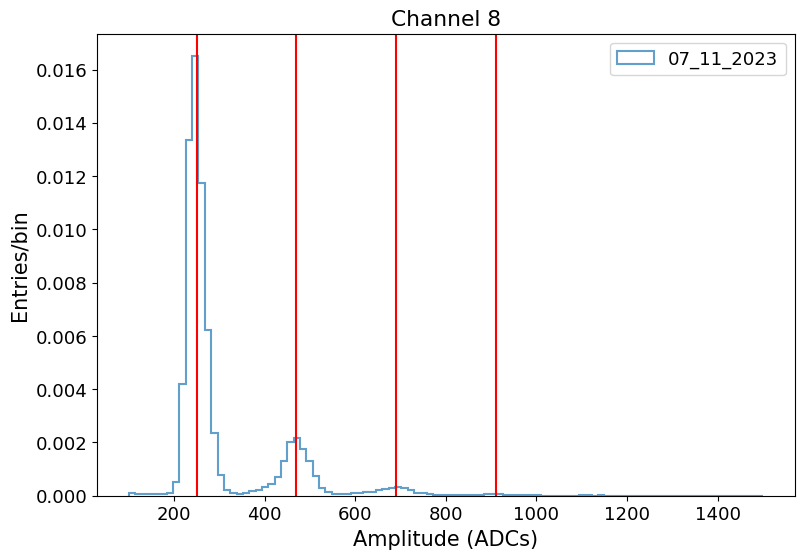

In [22]:
channel   = 8
histogram = peak_height_all_channels_dict['07_11_2023'][channel]
plt.hist(histogram, bins=100, range=(100,1500), alpha=0.7, histtype='step', linewidth=1.5, density=True, label=f'{sel_date}')
plt.axvline(x=250, color='r')
plt.axvline(x=470, color='r')
plt.axvline(x=690, color='r')
plt.axvline(x=910, color='r')
plt.title(f'Channel {channel}')
plt.xlabel('Amplitude (ADCs)', fontsize=15)
plt.ylabel('Entries/bin',      fontsize=15)
plt.legend()
plt.show()


Date 04_16_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



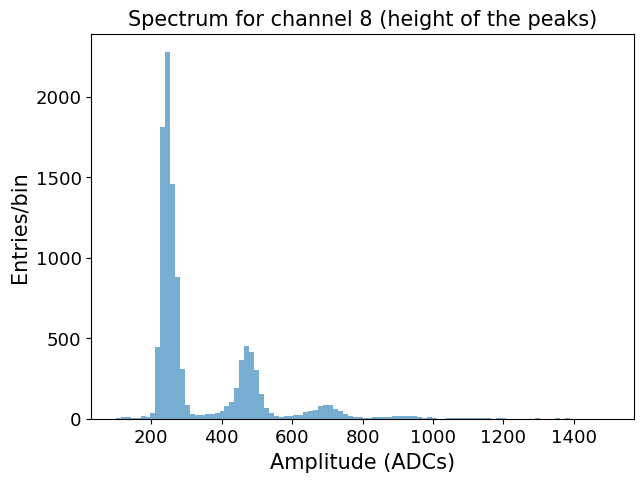

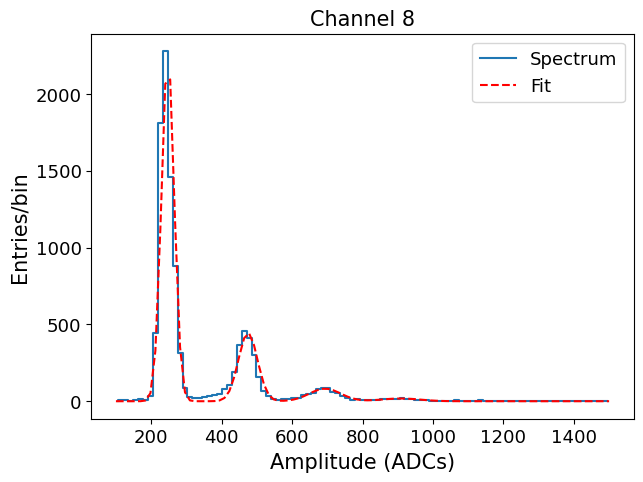

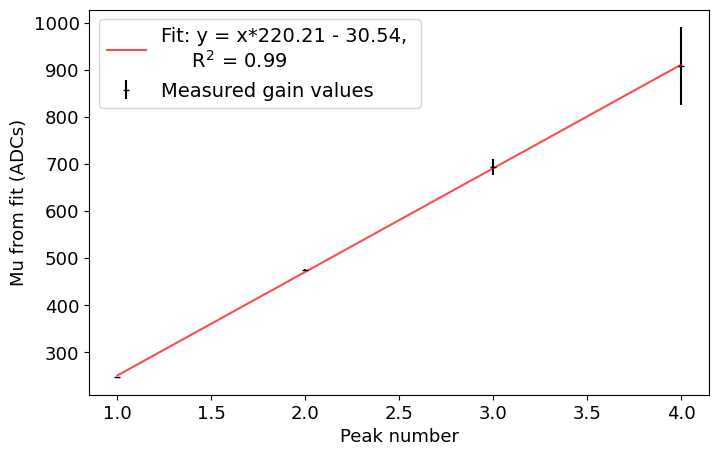


Date 05_08_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



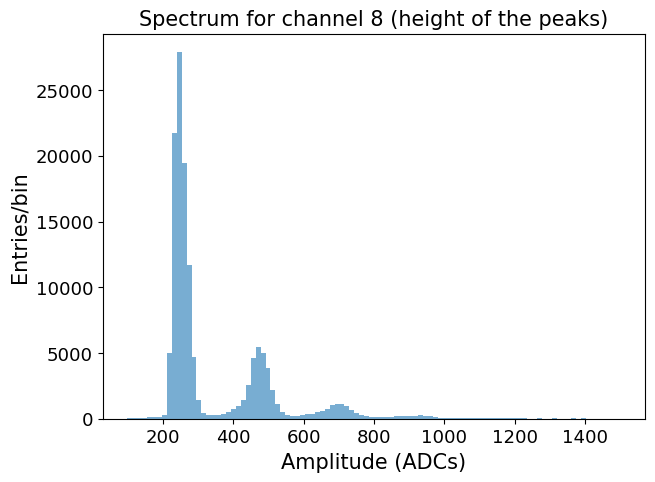

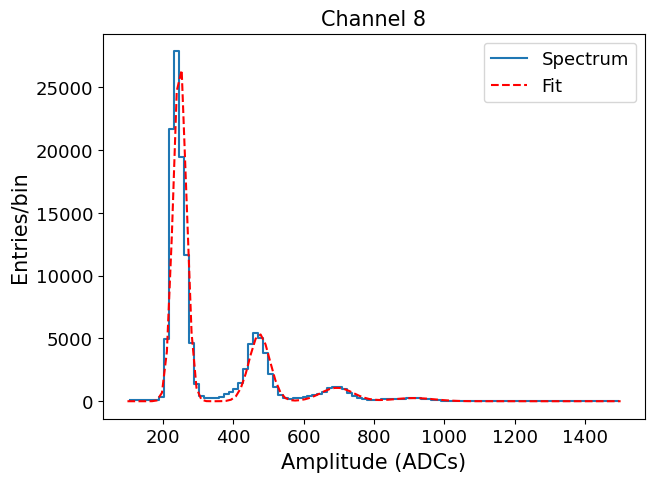

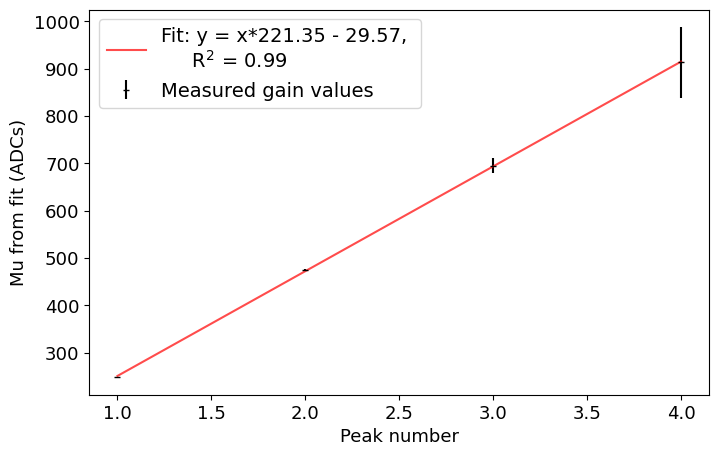


Date 05_30_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



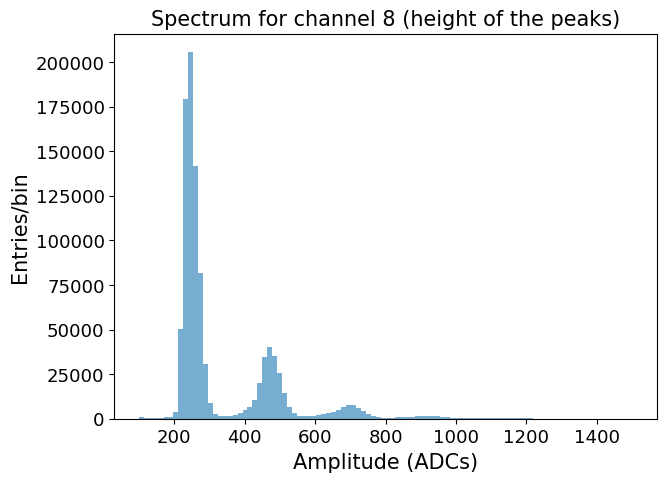

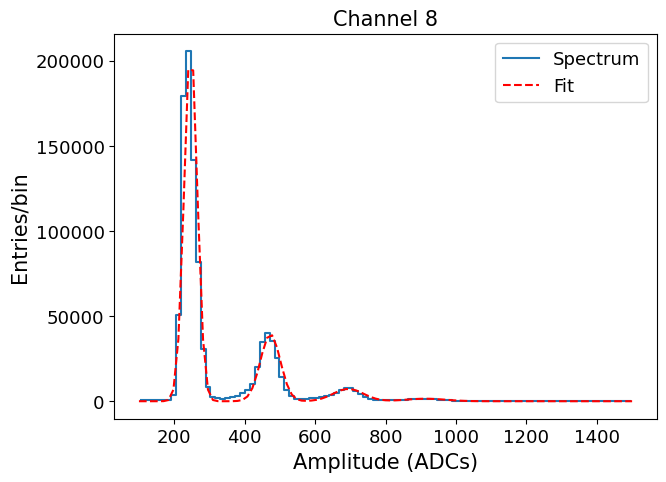

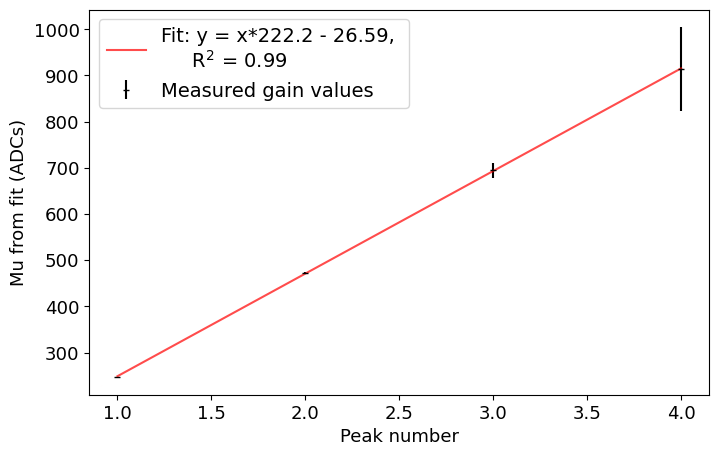


Date 06_01_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



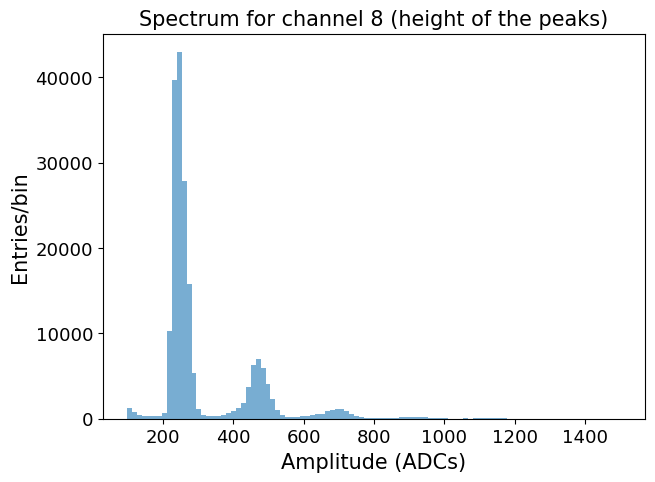

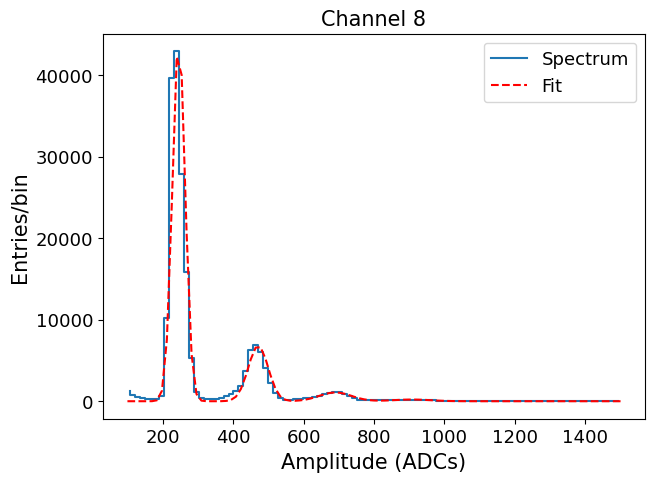

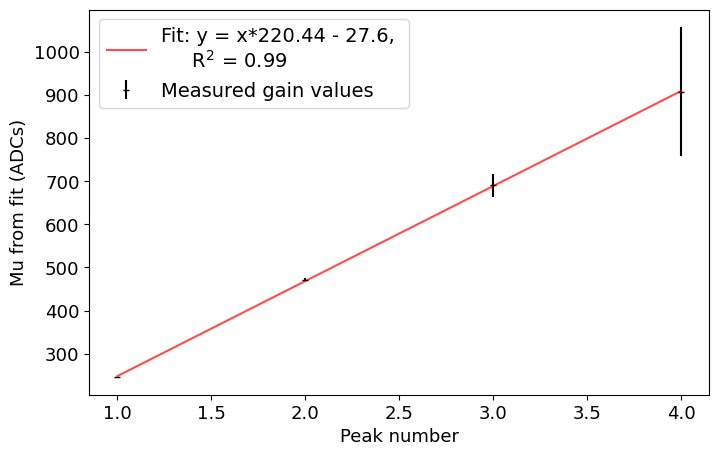


Date 06_02_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



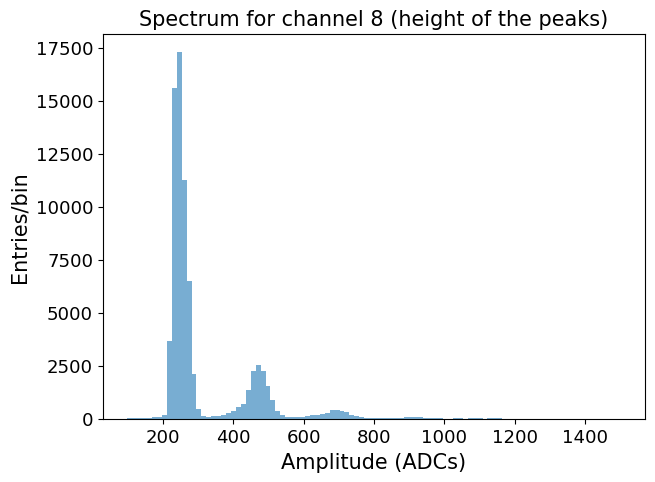

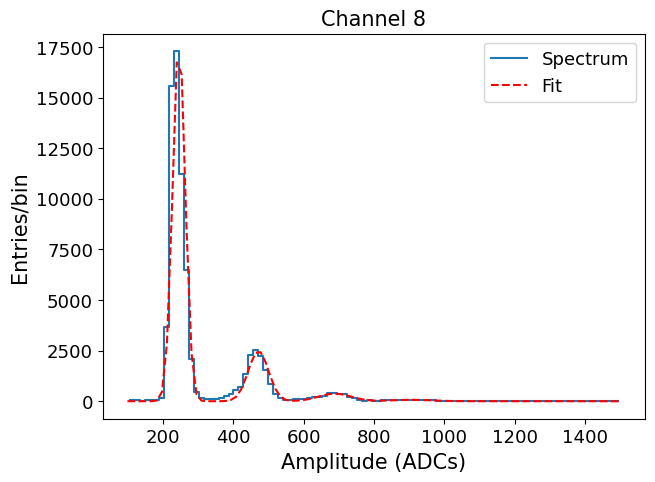

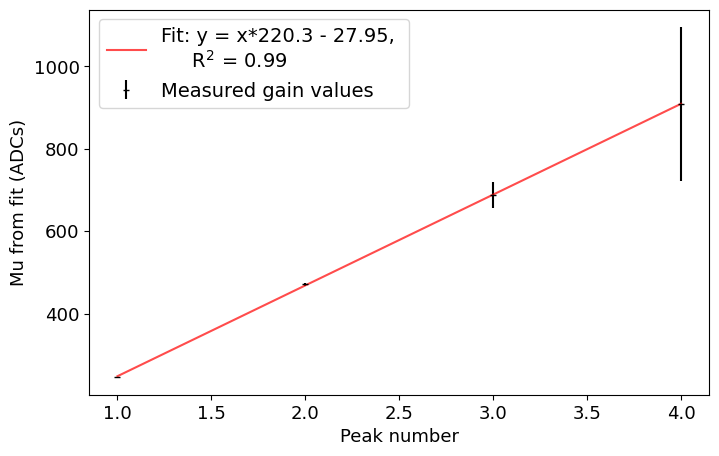


Date 06_19_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



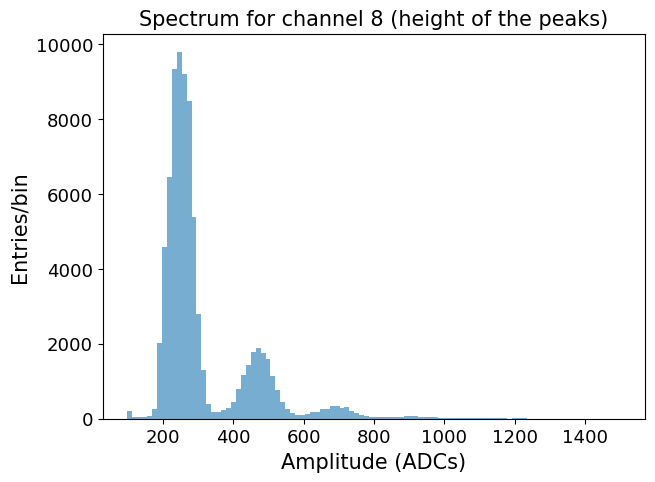

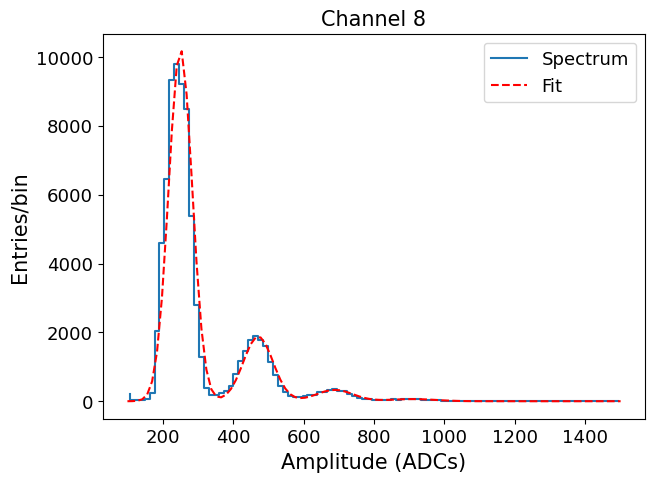

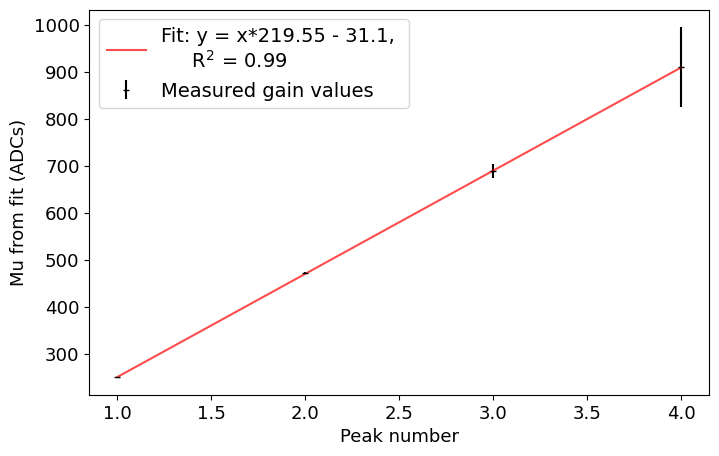


Date 06_20_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



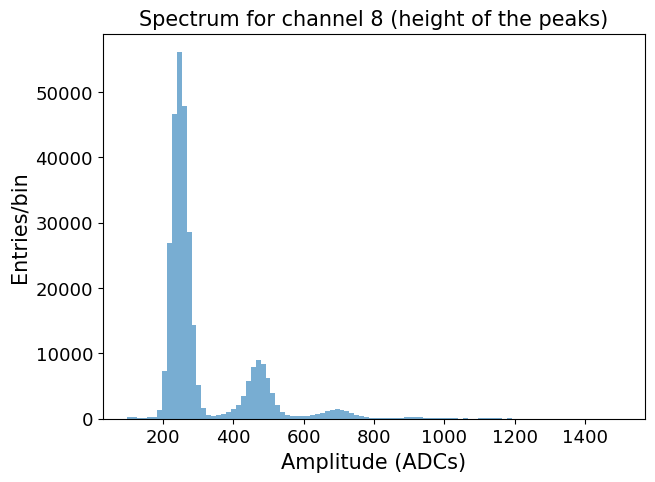

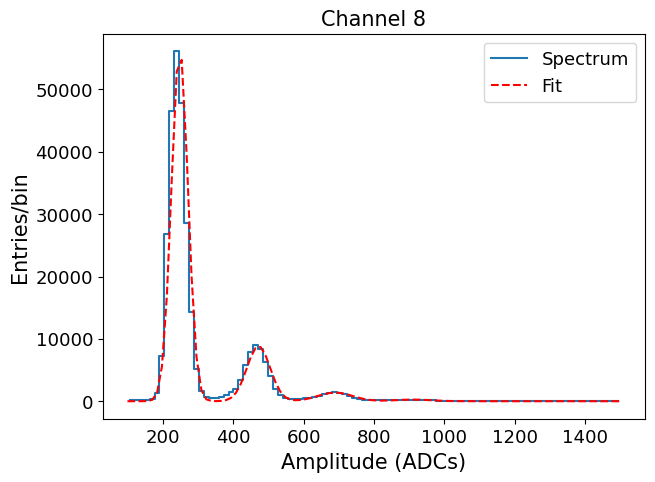

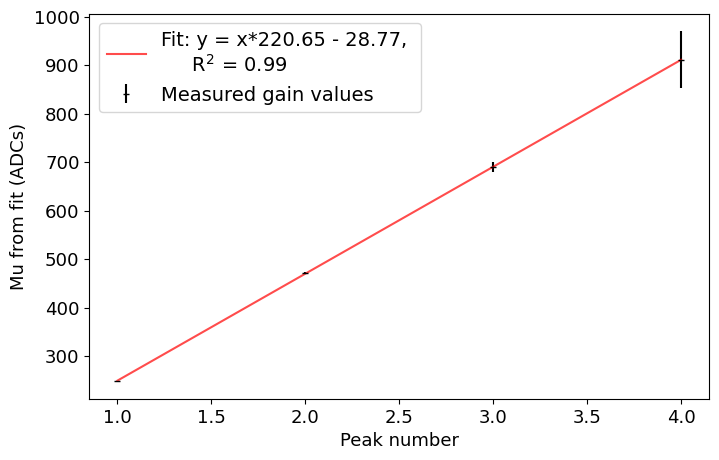


Date 06_21_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



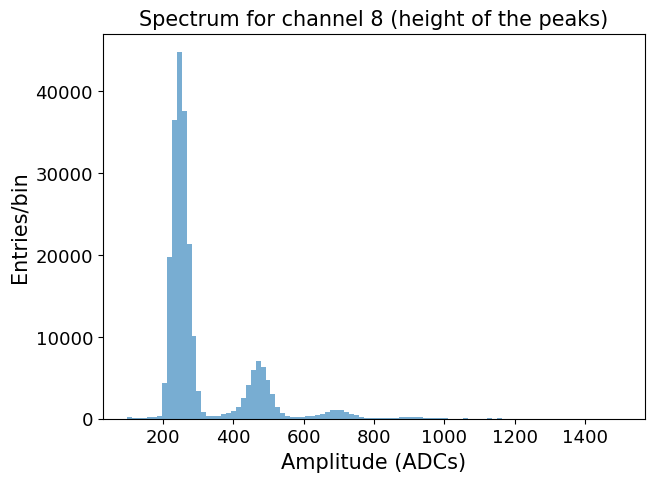

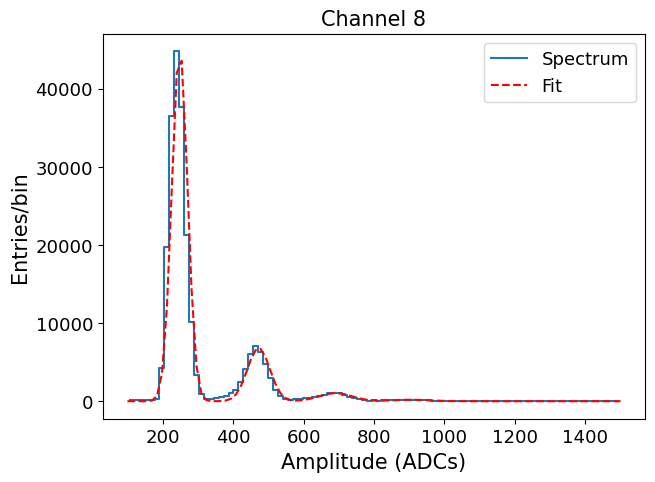

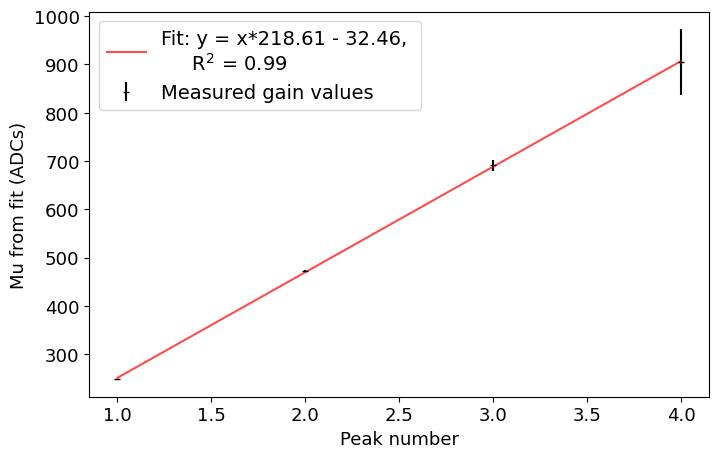


Date 06_24_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



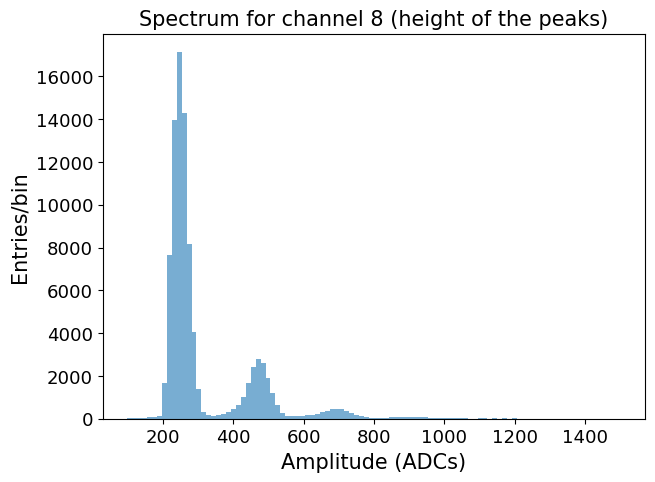

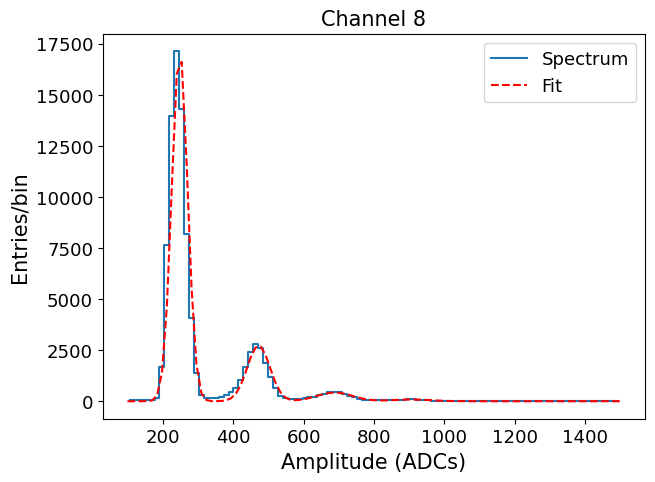

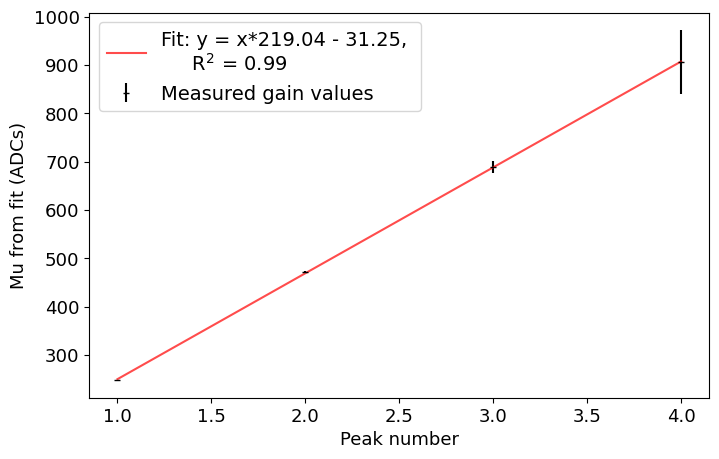


Date 07_05_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



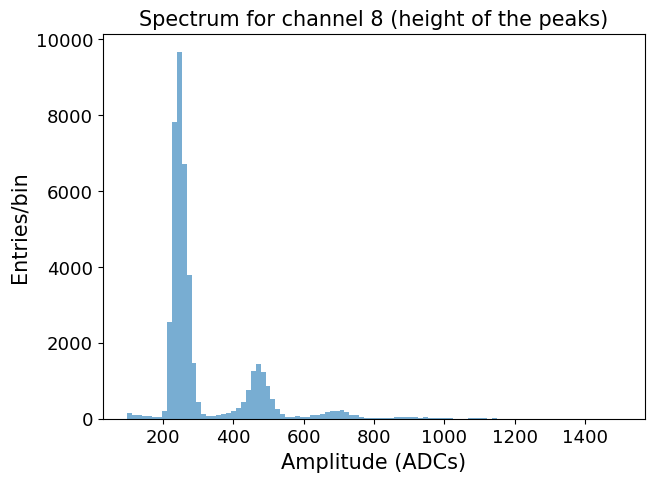

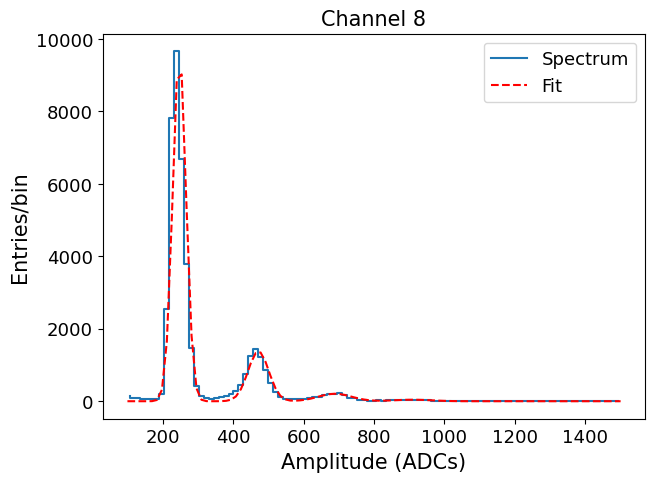

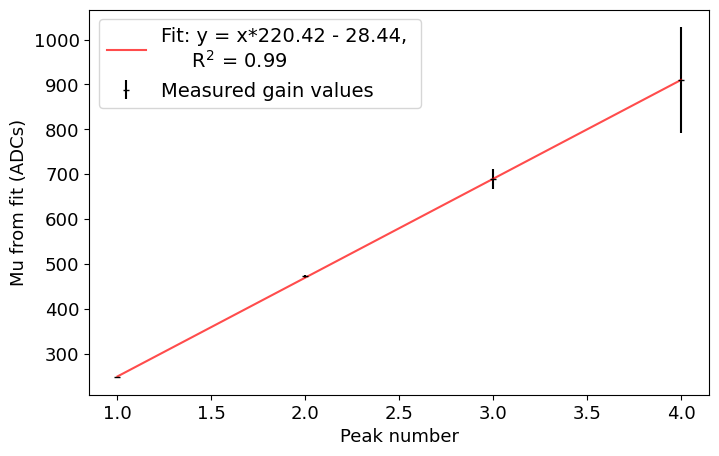


Date 07_06_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



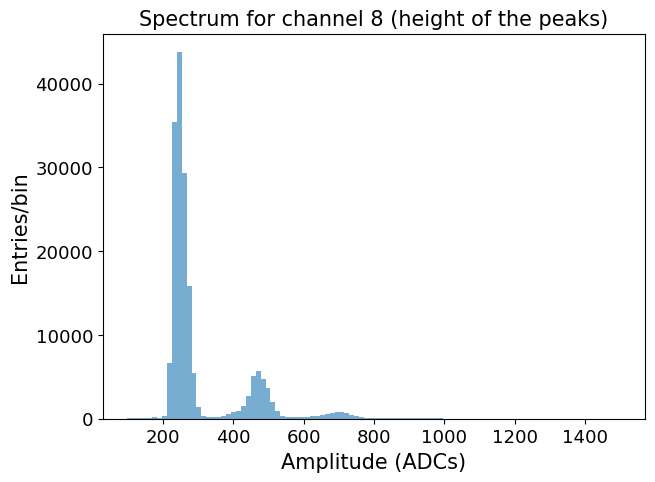

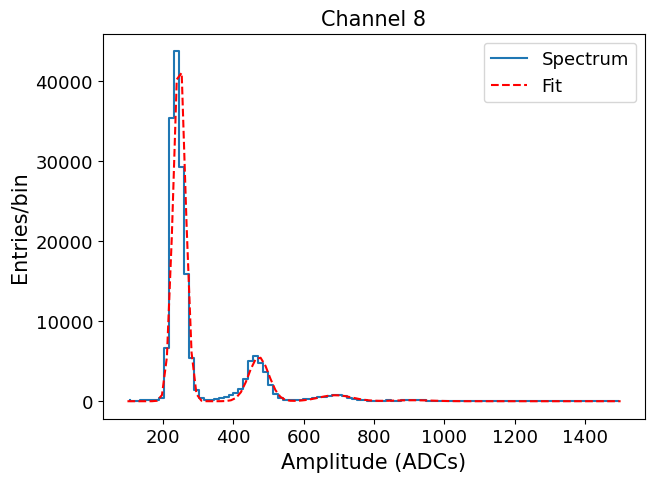

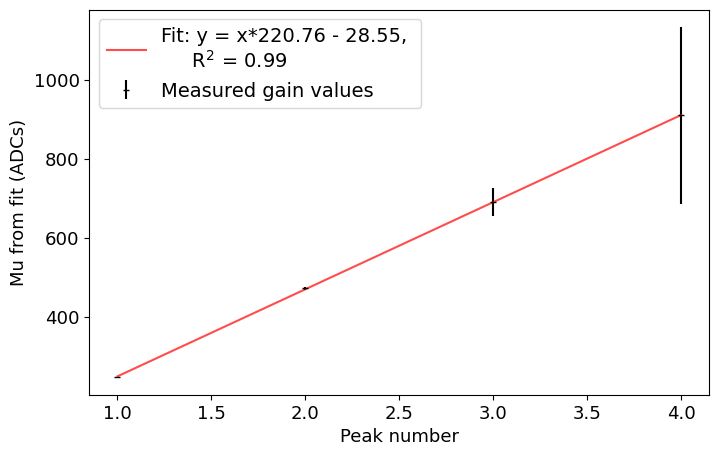


Date 07_07_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



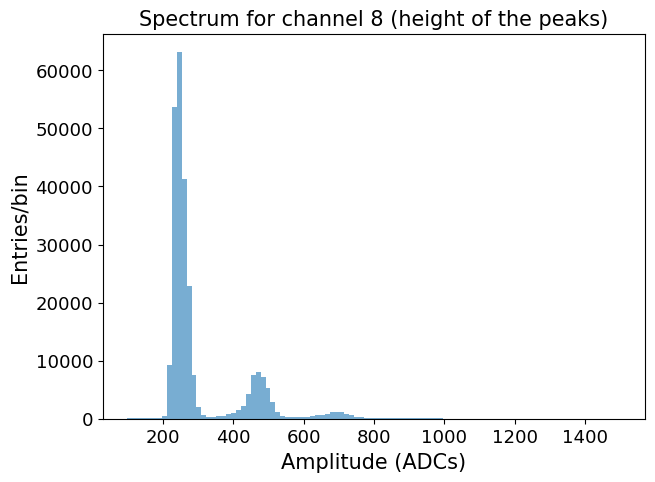

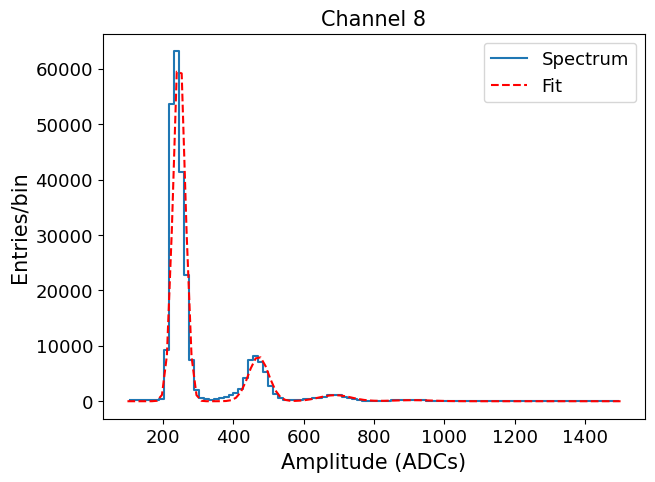

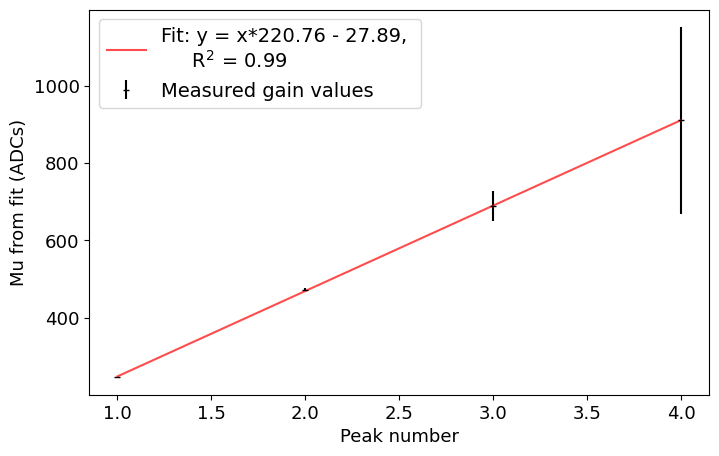


Date 07_08_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



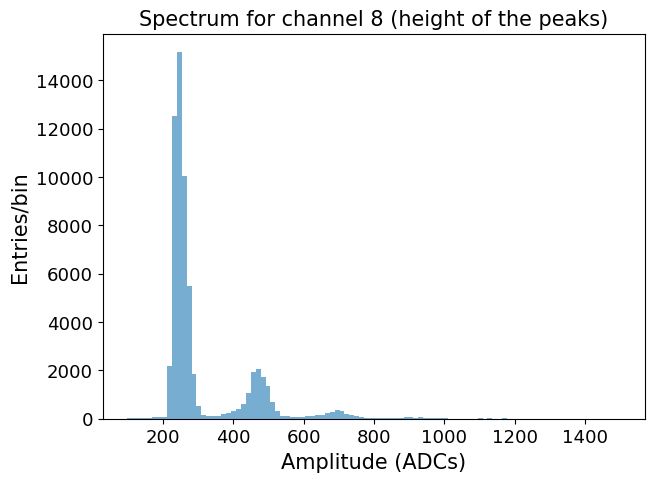

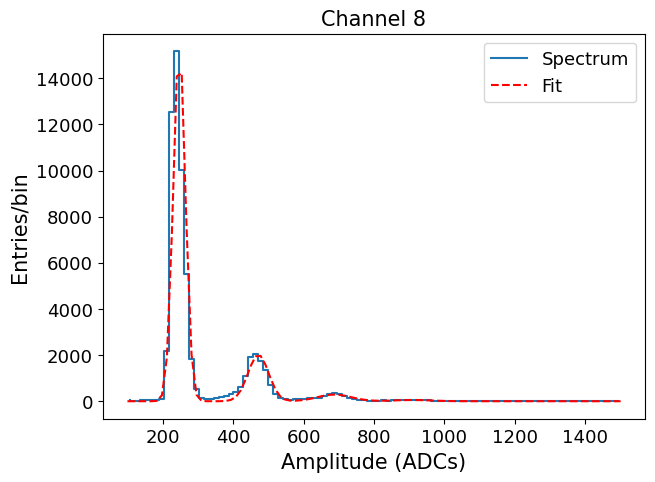

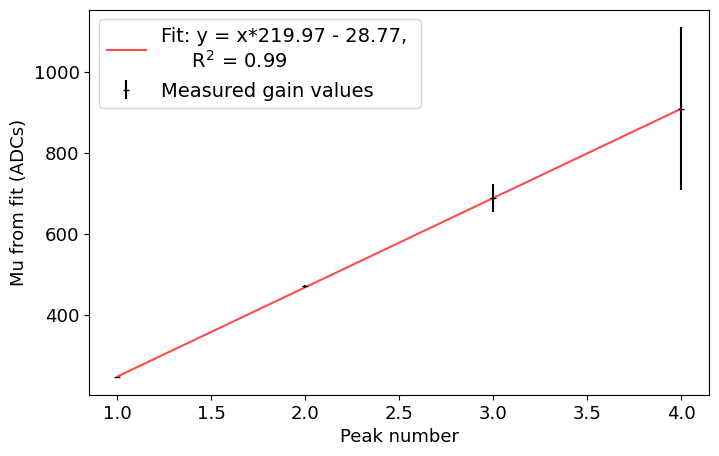


Date 07_10_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



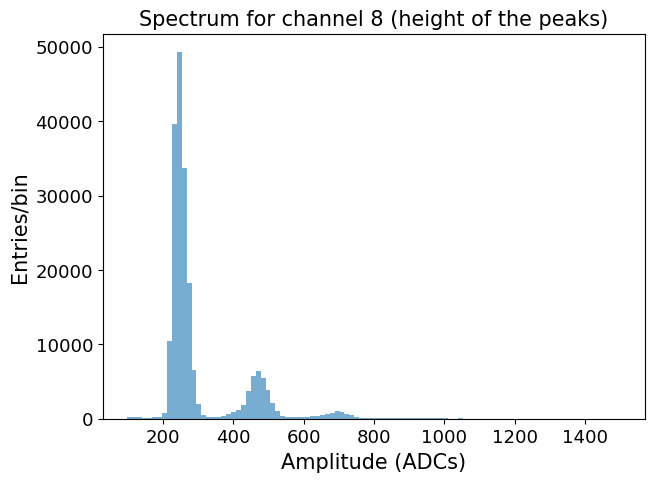

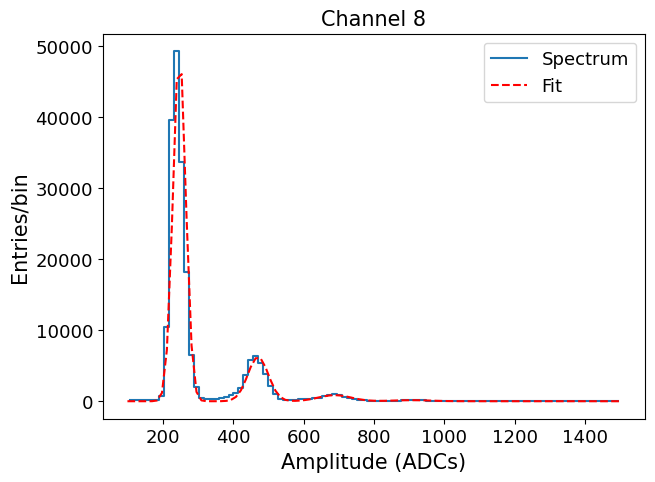

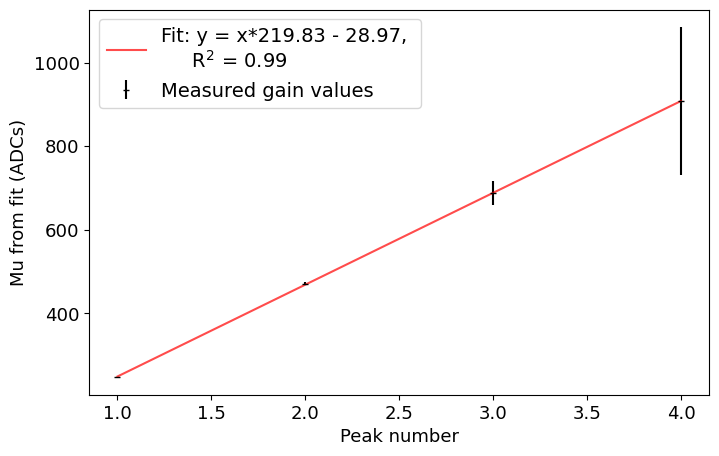


Date 07_11_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



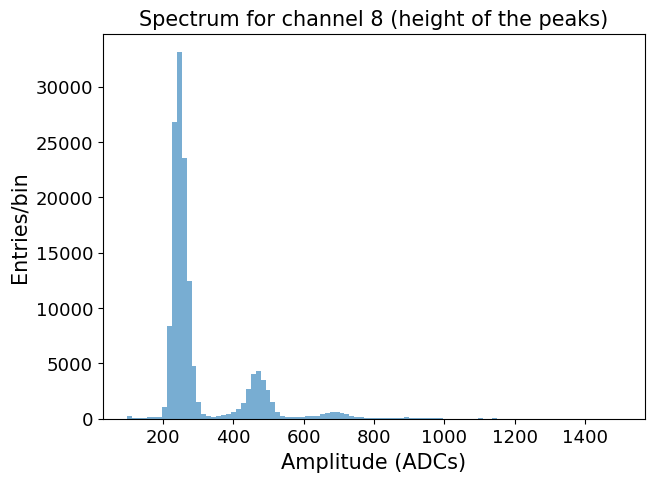

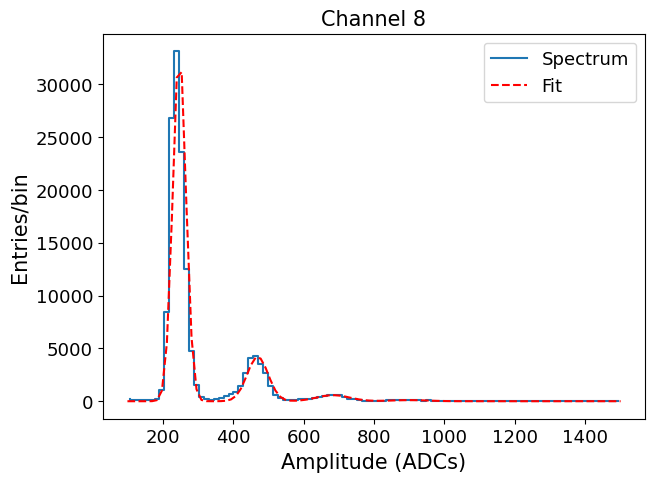

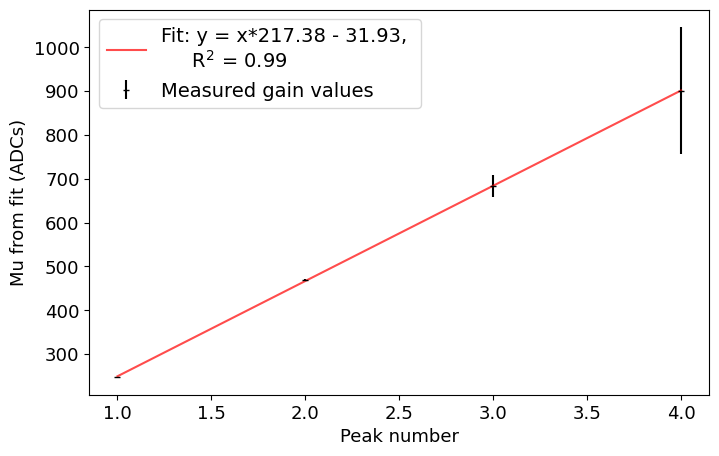

In [23]:
channel     = 8
gain_chann8 = []
for sel_date in peak_height_all_channels_dict.keys():
    if sel_date == '05_22_2023': continue
    initial_guess  = [300000, 250, 10, 100000, 470, 15, 20000, 690, 15, 10000, 910, 15]
    try:
        print()
        print(f'Date {sel_date}')
        print()
        gain, ch_means = extract_gain_and_mean(peak_height_all_channels_dict[sel_date][channel],
                                               channel       = channel,
                                               bins          = 100,
                                               prange        = (100, 1500),
                                               initial_guess = initial_guess)
        gain_chann8.append(gain)
    except:
        continue
gain_chann8 = np.array(gain_chann8)

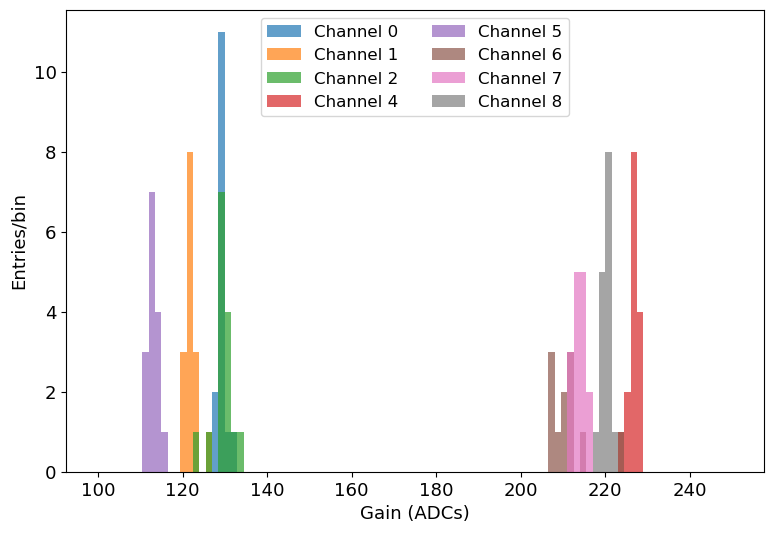

In [24]:
plt.hist(gain_chann0, bins=100, range=(100, 250), alpha=0.7, label='Channel 0')
plt.hist(gain_chann1, bins=100, range=(100, 250), alpha=0.7, label='Channel 1')
plt.hist(gain_chann2, bins=100, range=(100, 250), alpha=0.7, label='Channel 2')
plt.hist(gain_chann4, bins=100, range=(100, 250), alpha=0.7, label='Channel 4')
plt.hist(gain_chann5, bins=100, range=(100, 250), alpha=0.7, label='Channel 5')
plt.hist(gain_chann6, bins=100, range=(100, 250), alpha=0.7, label='Channel 6')
plt.hist(gain_chann7, bins=100, range=(100, 250), alpha=0.7, label='Channel 7')
plt.hist(gain_chann8, bins=100, range=(100, 250), alpha=0.7, label='Channel 8')
plt.xlabel('Gain (ADCs)')
plt.ylabel('Entries/bin')
plt.legend(loc='upper center', ncol=2, fontsize=12)
plt.show()

In [25]:
mean_gains = [np.mean(g) for g in [gain_chann0, gain_chann1, gain_chann2, [0, 0],
                                   gain_chann4, gain_chann5, gain_chann6, gain_chann7, gain_chann8]]

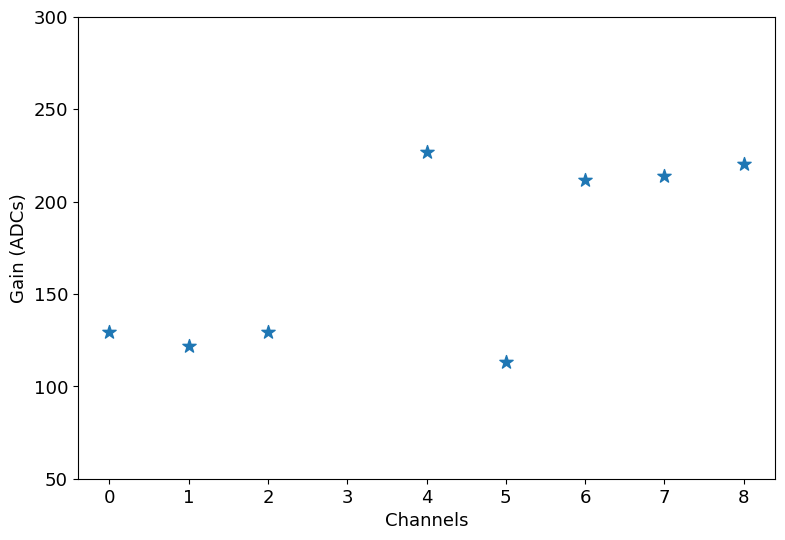

In [26]:
plt.scatter(range(9), mean_gains, marker='*', s=100)
plt.ylim(50, 300)
plt.xlabel('Channels')
plt.ylabel('Gain (ADCs)')
plt.show()

In [27]:
mean_gains

[129.41552032428905,
 122.03760048284494,
 129.6458079049449,
 0.0,
 226.7970338696043,
 112.98055916100253,
 211.3816201095271,
 213.92840770110635,
 220.09921689236677]

#### Bad channels. Join channels with close peaks

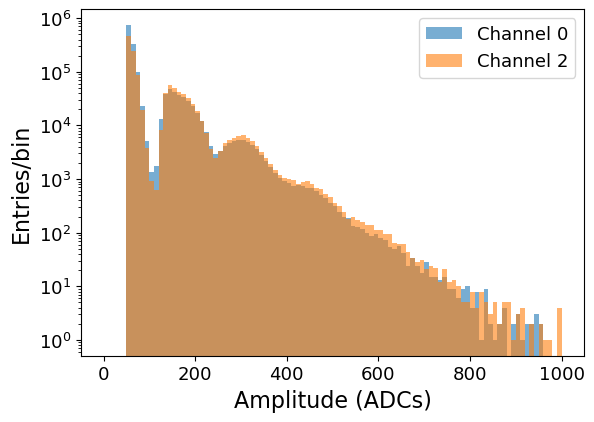

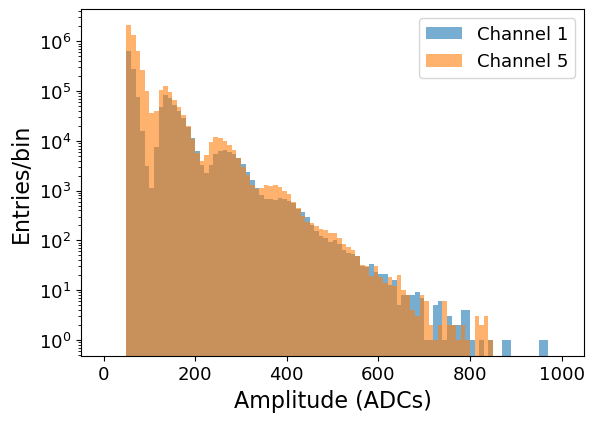

In [28]:
select_date = '05_30_2023'

plt.figure(figsize=(6.5, 4.5))
plt.hist(peak_height_all_channels_dict[select_date][0], bins=100, range=(0,1000), log=True, label=f'Channel 0', alpha=0.6)
plt.hist(peak_height_all_channels_dict[select_date][2], bins=100, range=(0,1000), log=True, label=f'Channel 2', alpha=0.6)
plt.xlabel('Amplitude (ADCs)', fontsize=16)
plt.ylabel('Entries/bin',      fontsize=16)
plt.legend()
plt.show()

plt.figure(figsize=(6.5, 4.5))
plt.hist(peak_height_all_channels_dict[select_date][1], bins=100, range=(0,1000), log=True, label=f'Channel 1', alpha=0.6)
plt.hist(peak_height_all_channels_dict[select_date][5], bins=100, range=(0,1000), log=True, label=f'Channel 5', alpha=0.6)
plt.xlabel('Amplitude (ADCs)', fontsize=16)
plt.ylabel('Entries/bin',      fontsize=16)
plt.legend()
plt.show()

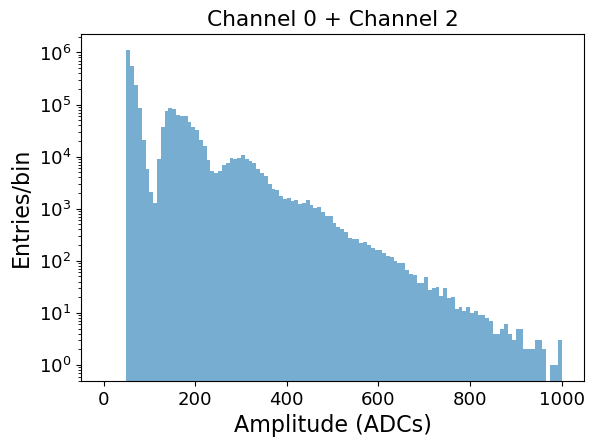

In [29]:
select_date = '05_30_2023'
channel0_data = peak_height_all_channels_dict[select_date][0]
channel2_data = peak_height_all_channels_dict[select_date][2]

plt.figure(figsize=(6.5, 4.5))
plt.hist(np.concatenate((channel0_data, channel2_data)), bins=120, range=(0,1000), log=True, alpha=0.6)
plt.title('Channel 0 + Channel 2')
plt.xlabel('Amplitude (ADCs)', fontsize=16)
plt.ylabel('Entries/bin',      fontsize=16)
plt.show()

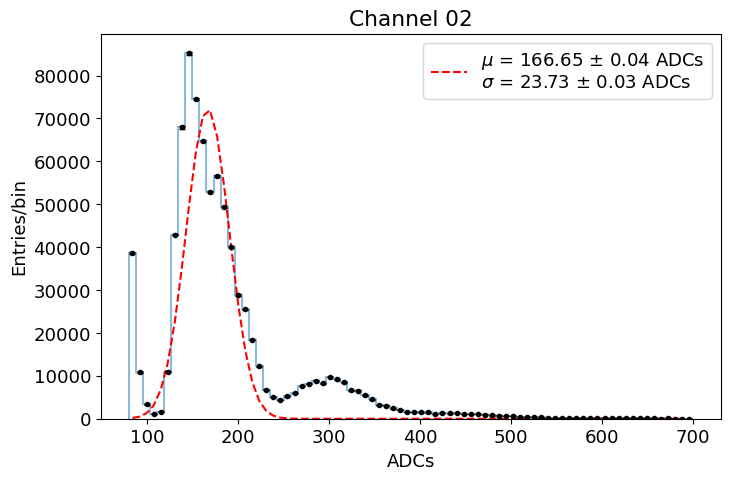

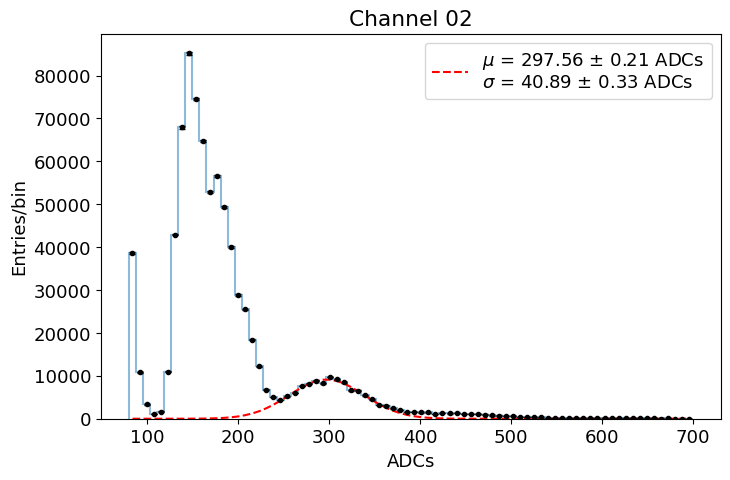

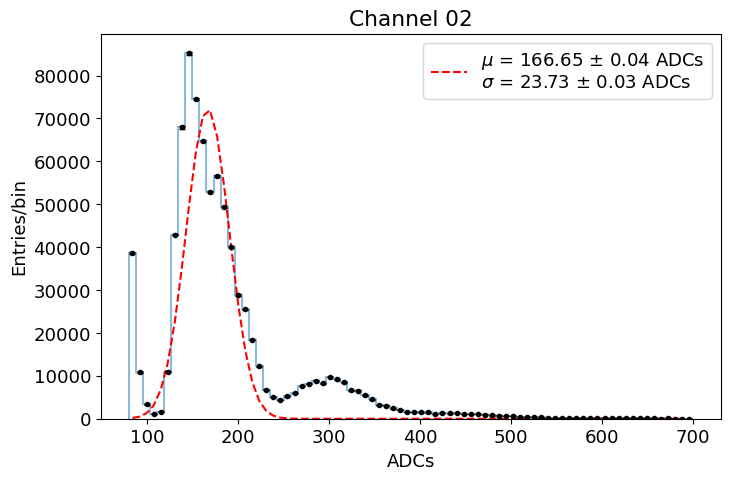

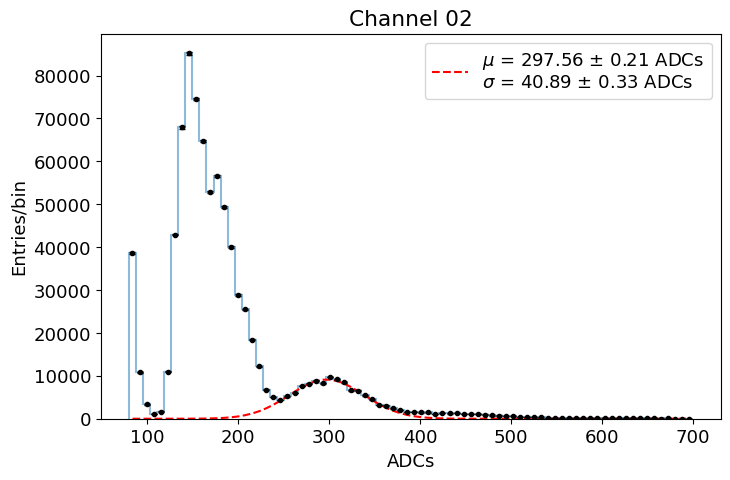

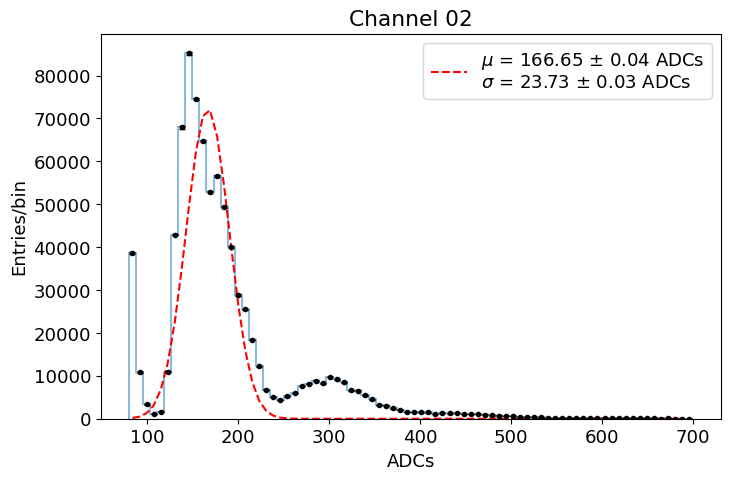

...

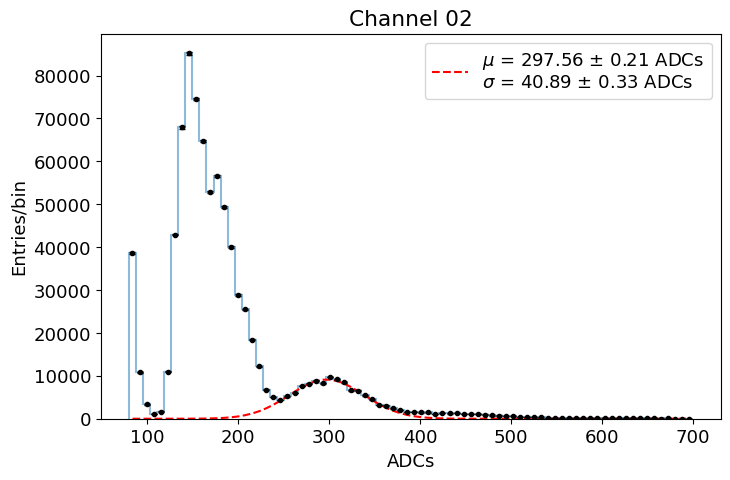

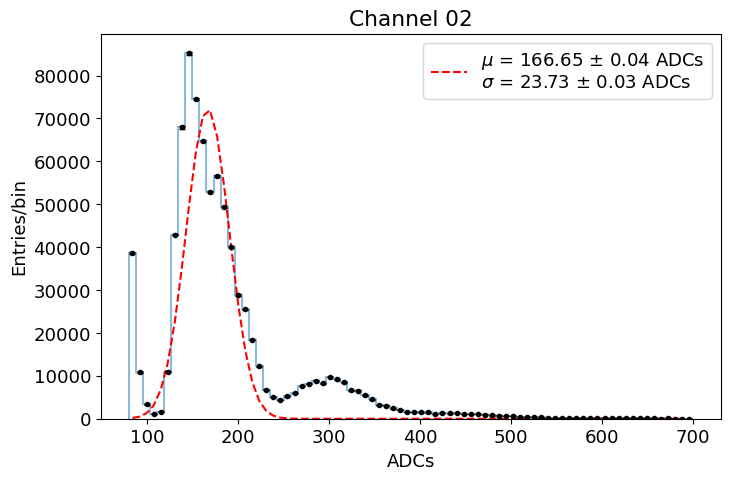

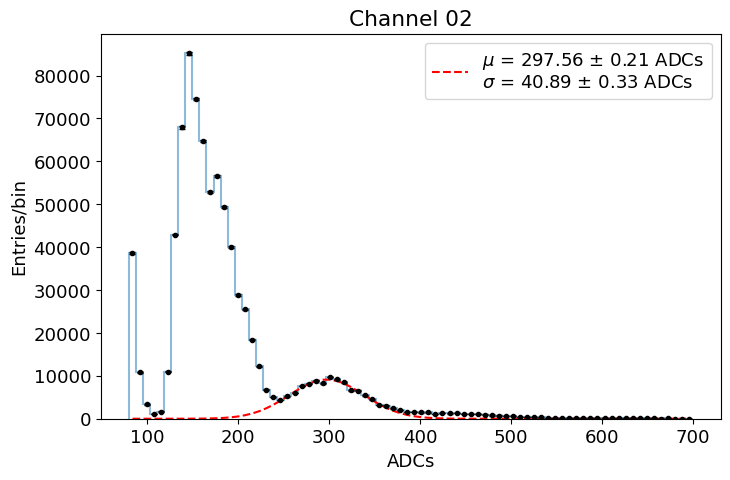

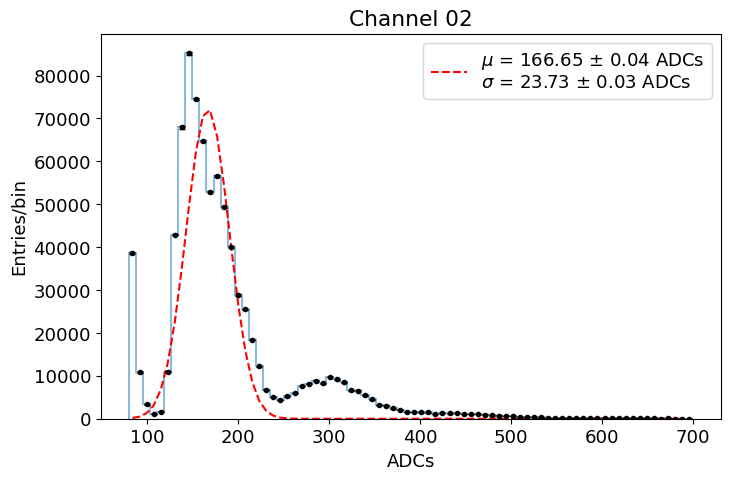

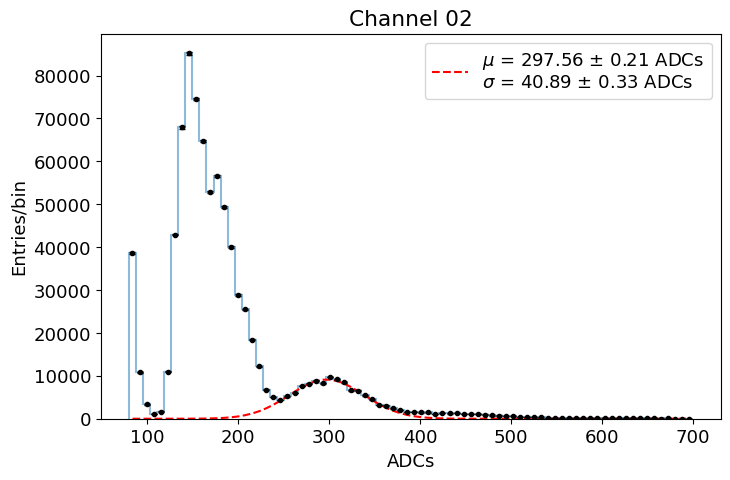

[130.90571966 130.90571966 130.90571966 130.90571966 130.90571966
 130.90571966 130.90571966 130.90571966 130.90571966 130.90571966
 130.90571966 130.90571966 130.90571966 130.90571966 130.90571966]


In [30]:
channel      = '02'
gain_chann02 = []
for sel_date in peak_height_all_channels_dict.keys():
    if sel_date == '05_22_2023': continue
    channel0_data = peak_height_all_channels_dict[select_date][0]
    channel2_data = peak_height_all_channels_dict[select_date][2]
    vals1 = fitf.gaussian_fit_IC(np.concatenate((channel0_data, channel2_data)), bins=80, prange=(80, 700), ampl=10000, mean=170, sigma=20, frange=(110, 220), title=f'Channel {channel}', print_chi2=False)
    vals2 = fitf.gaussian_fit_IC(np.concatenate((channel0_data, channel2_data)), bins=80, prange=(80, 700), ampl=10000, mean=300, sigma=20, frange=(250, 350), title=f'Channel {channel}', print_chi2=False)
    gain_chann02.append(vals2[0] - vals1[0])
gain_chann02 = np.array(gain_chann02)
print(gain_chann02)

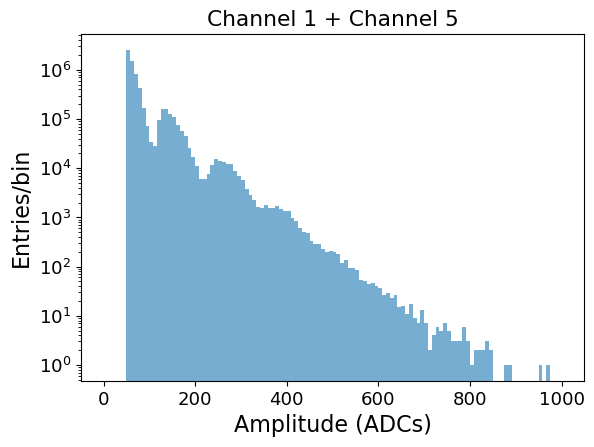

In [31]:
select_date = '05_30_2023'
channel1_data = peak_height_all_channels_dict[select_date][1]
channel5_data = peak_height_all_channels_dict[select_date][5]

plt.figure(figsize=(6.5, 4.5))
plt.hist(np.concatenate((channel1_data, channel5_data)), bins=120, range=(0,1000), log=True, alpha=0.6)
plt.title('Channel 1 + Channel 5')
plt.xlabel('Amplitude (ADCs)', fontsize=16)
plt.ylabel('Entries/bin',      fontsize=16)
plt.show()

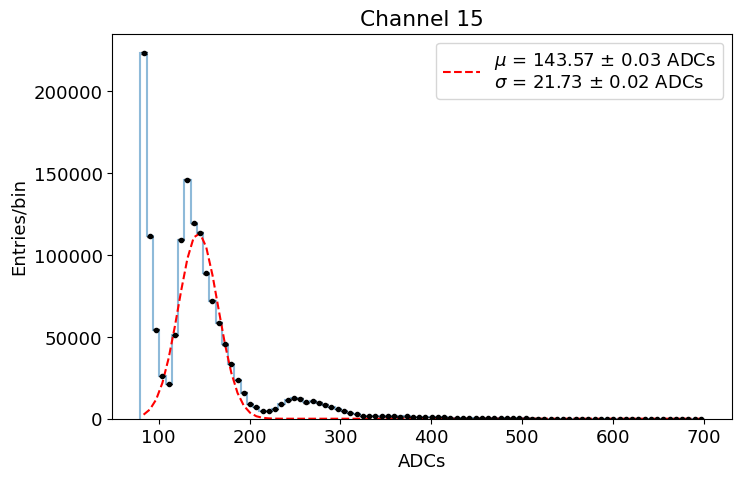

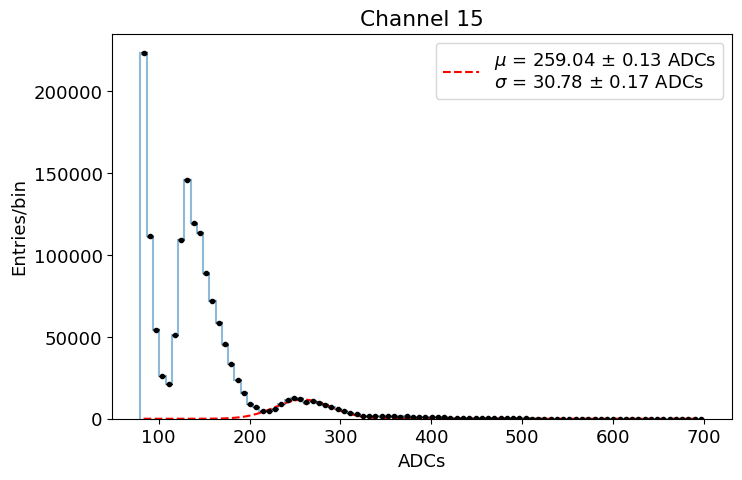

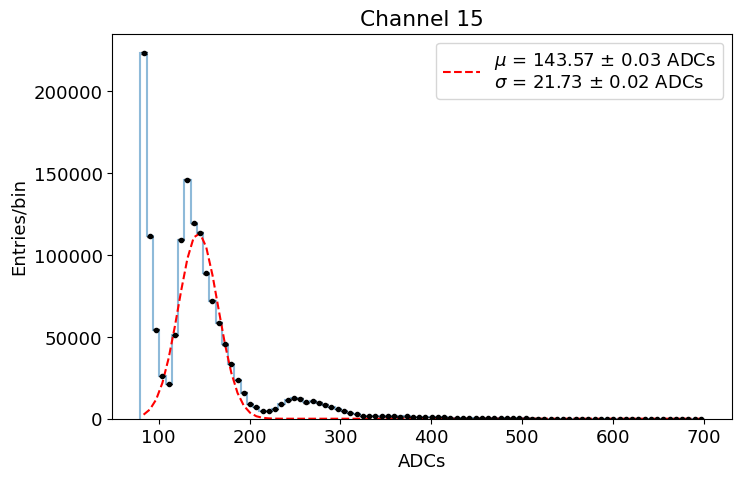

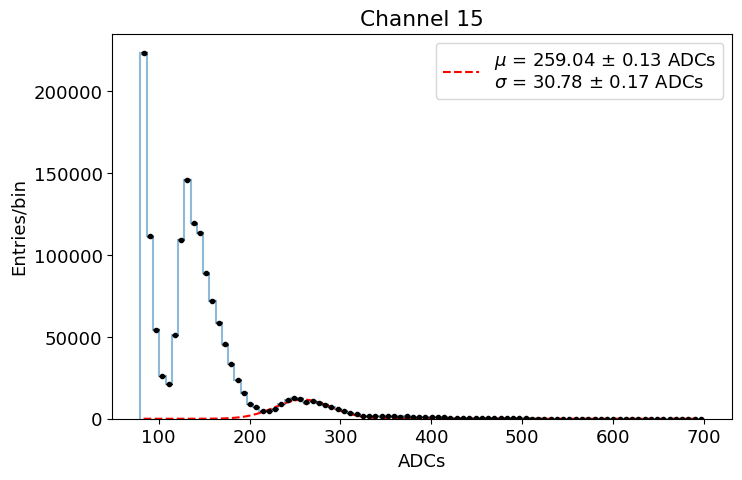

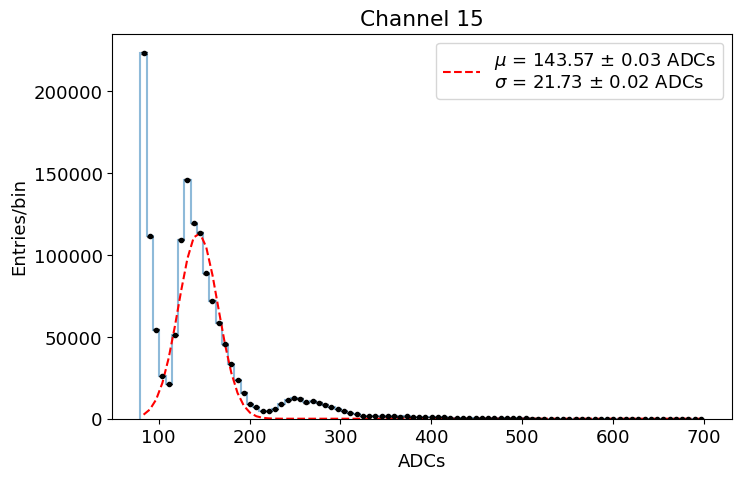

...

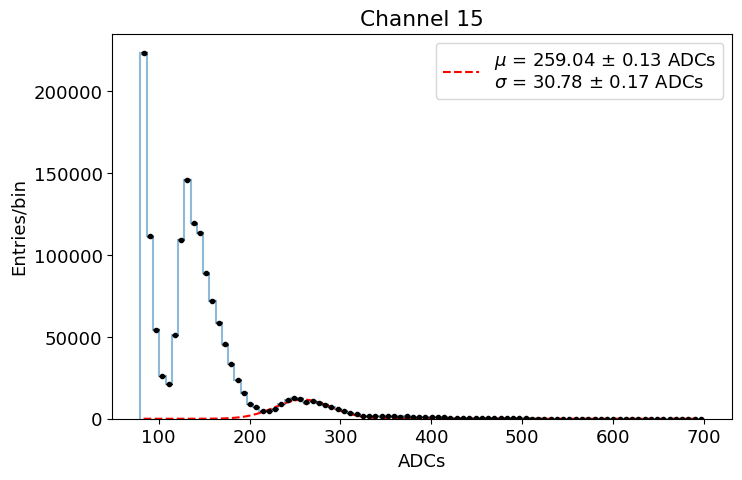

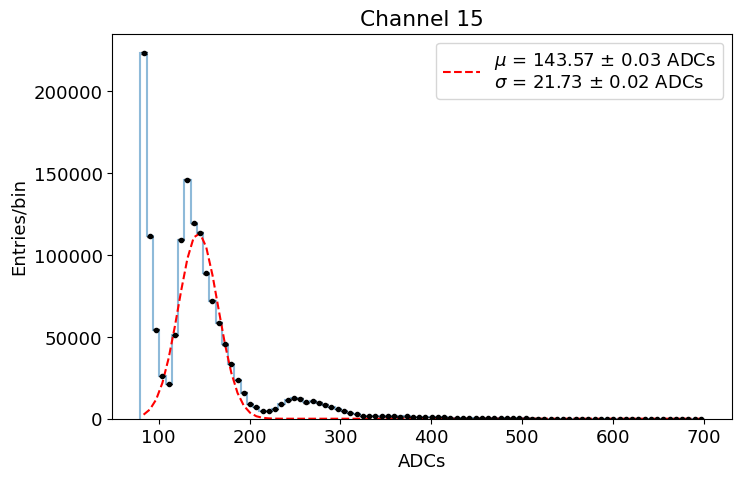

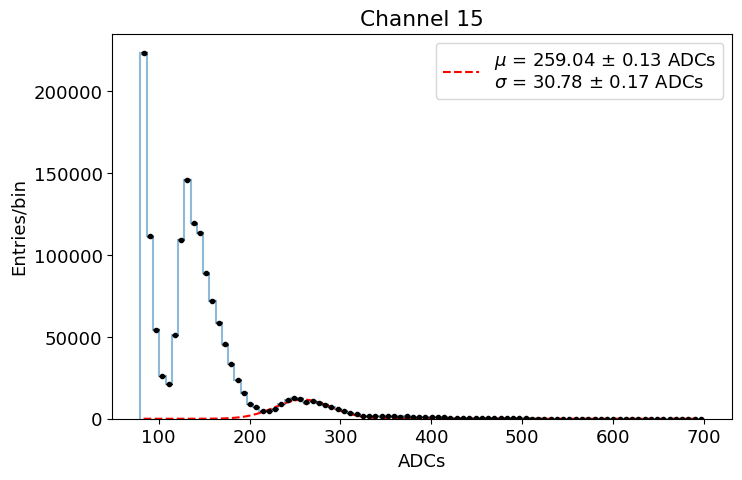

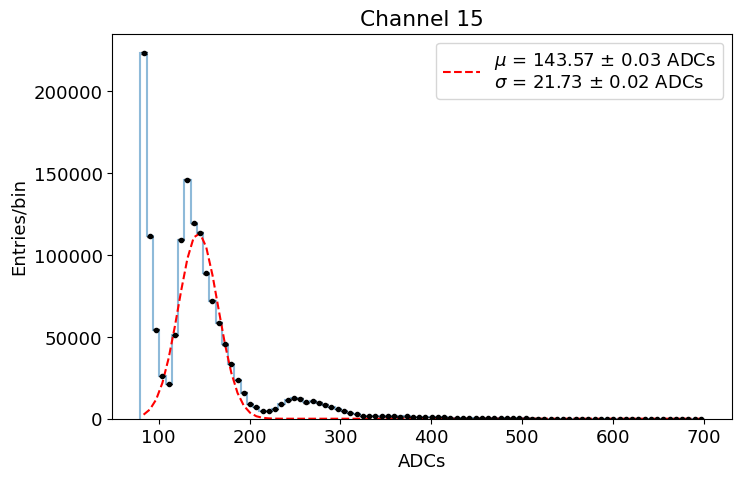

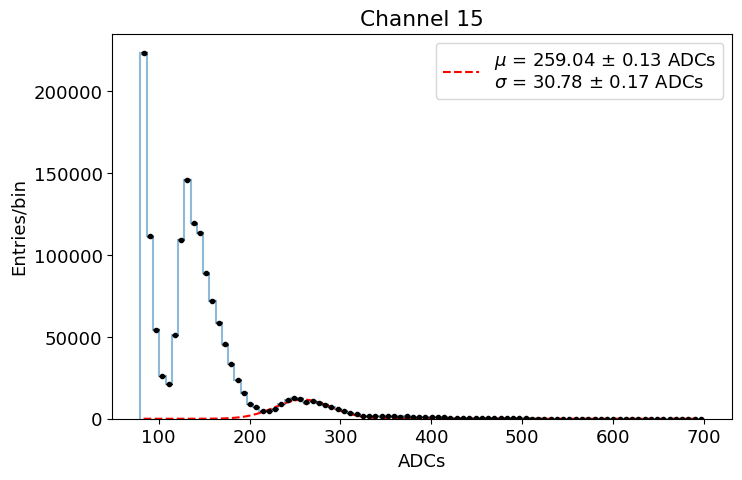

[115.46514276 115.46514276 115.46514276 115.46514276 115.46514276
 115.46514276 115.46514276 115.46514276 115.46514276 115.46514276
 115.46514276 115.46514276 115.46514276 115.46514276 115.46514276]


In [32]:
channel     = '15'
gain_chann15 = []
for sel_date in peak_height_all_channels_dict.keys():
    if sel_date == '05_22_2023': continue
    channel1_data = peak_height_all_channels_dict[select_date][1]
    channel5_data = peak_height_all_channels_dict[select_date][5]
    vals1 = fitf.gaussian_fit_IC(np.concatenate((channel1_data, channel5_data)), bins=90, prange=(80, 700), ampl=10000, mean=150, sigma=20, frange=(100, 200), title=f'Channel {channel}', print_chi2=False)
    vals2 = fitf.gaussian_fit_IC(np.concatenate((channel1_data, channel5_data)), bins=90, prange=(80, 700), ampl=10000, mean=240, sigma=20, frange=(210, 300), title=f'Channel {channel}', print_chi2=False)
    gain_chann15.append(vals2[0] - vals1[0])
gain_chann15 = np.array(gain_chann15)
print(gain_chann15)

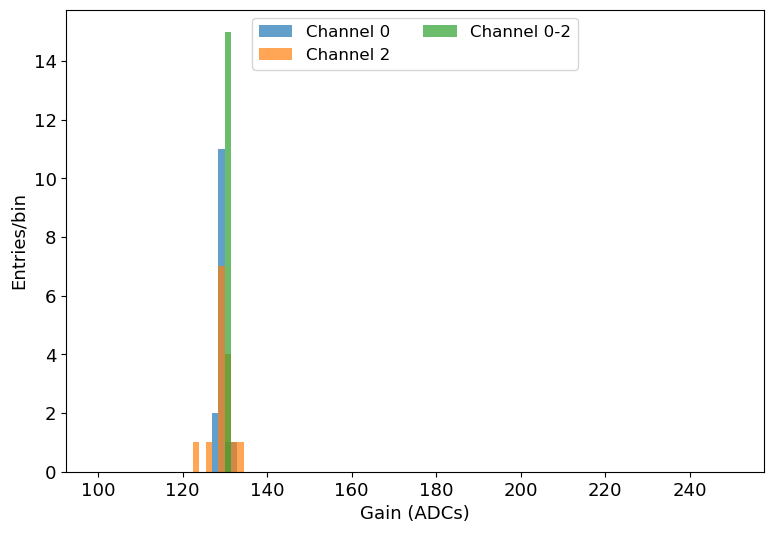

In [33]:
plt.hist(gain_chann0,  bins=100, range=(100, 250), alpha=0.7, label='Channel 0')
plt.hist(gain_chann2,  bins=100, range=(100, 250), alpha=0.7, label='Channel 2')
plt.hist(gain_chann02, bins=100, range=(100, 250), alpha=0.7, label='Channel 0-2')
plt.xlabel('Gain (ADCs)')
plt.ylabel('Entries/bin')
plt.legend(loc='upper center', ncol=2, fontsize=12)
plt.show()

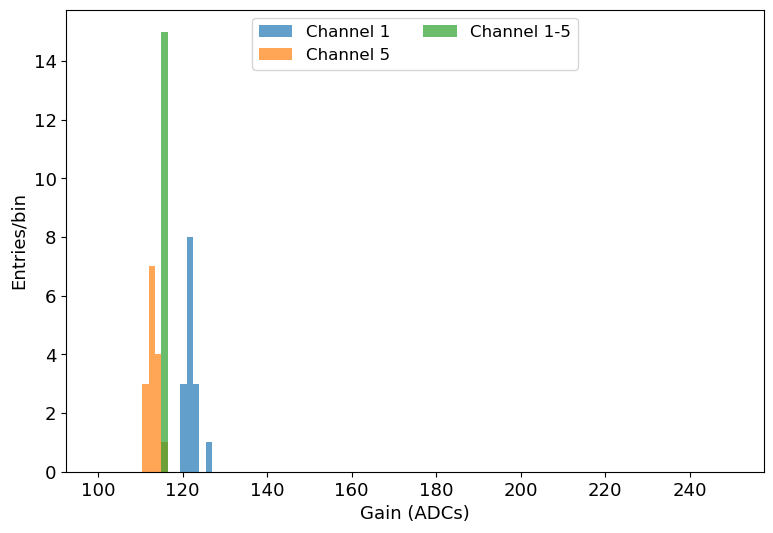

In [34]:
plt.hist(gain_chann1,  bins=100, range=(100, 250), alpha=0.7, label='Channel 1')
plt.hist(gain_chann5,  bins=100, range=(100, 250), alpha=0.7, label='Channel 5')
plt.hist(gain_chann15, bins=100, range=(100, 250), alpha=0.7, label='Channel 1-5')
plt.xlabel('Gain (ADCs)')
plt.ylabel('Entries/bin')
plt.legend(loc='upper center', ncol=2, fontsize=12)
plt.show()

### Calibration using the integral from each peak:

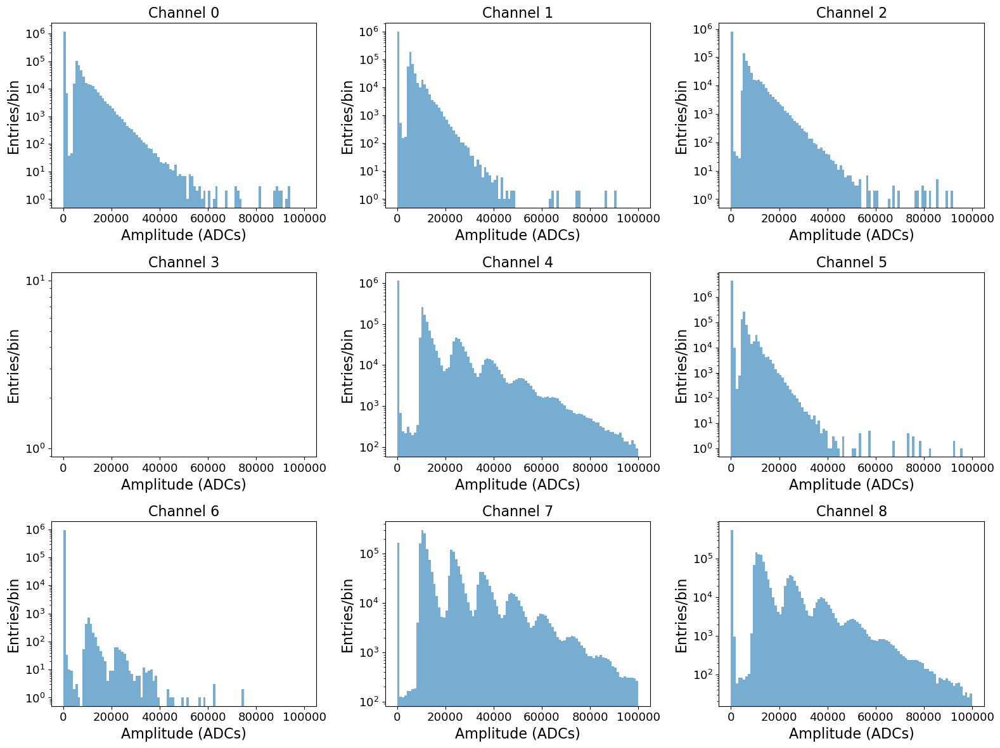

In [35]:
select_date = '05_30_2023'

fig, axs = plt.subplots(3, 3, figsize=(16, 12))
for k in range(9):
    i = int(k/3)
    j = k%3
    axs[i][j].hist(peak_area_all_channels_dict[select_date][k], bins=100, range=(0,100000), log=True, label=f'{select_date}', alpha=0.6)
    axs[i][j].set_xlabel('Amplitude (ADCs)', fontsize=16)
    axs[i][j].set_ylabel('Entries/bin',      fontsize=16)
    axs[i][j].set_title(f"Channel {k}",      fontsize=16)
    #axs[i][j].legend(fontsize=15)
plt.tight_layout()
plt.show()

### Look at channel 0 for example:

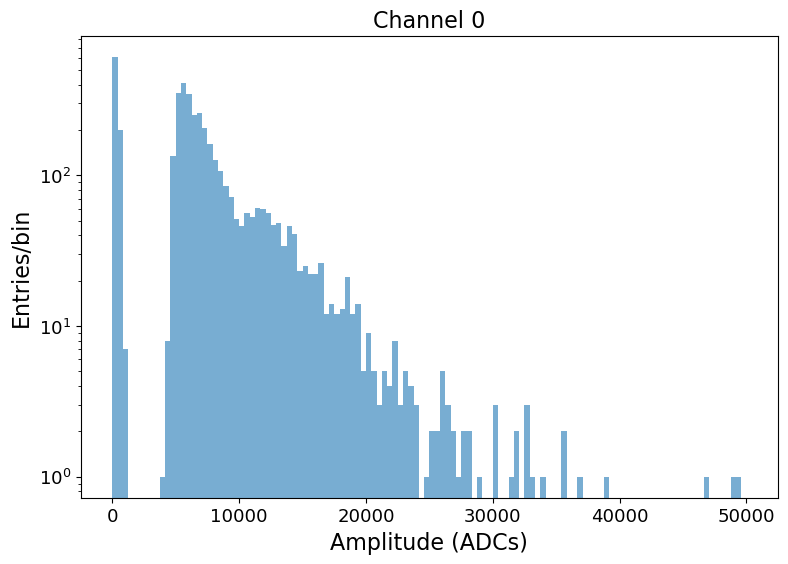

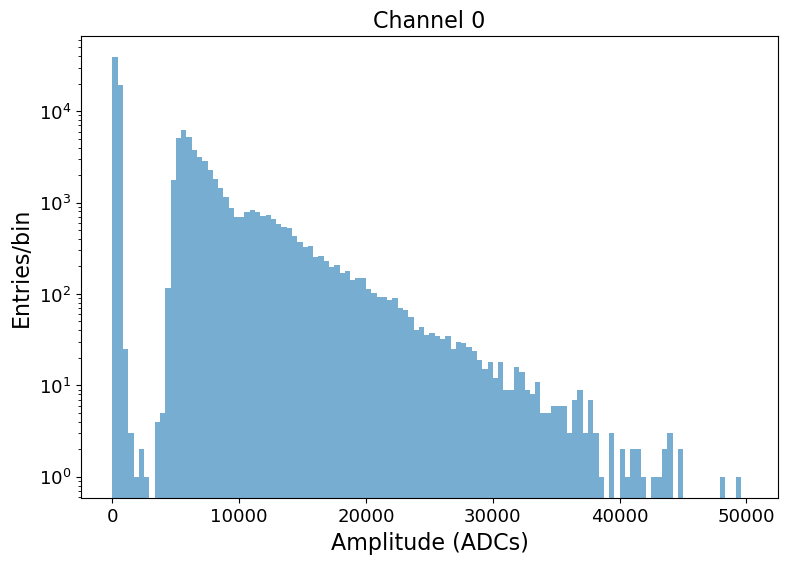

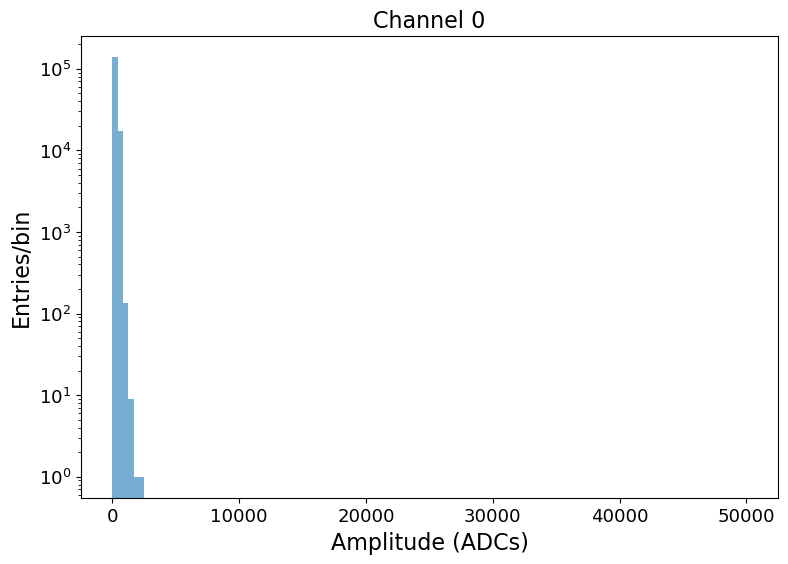

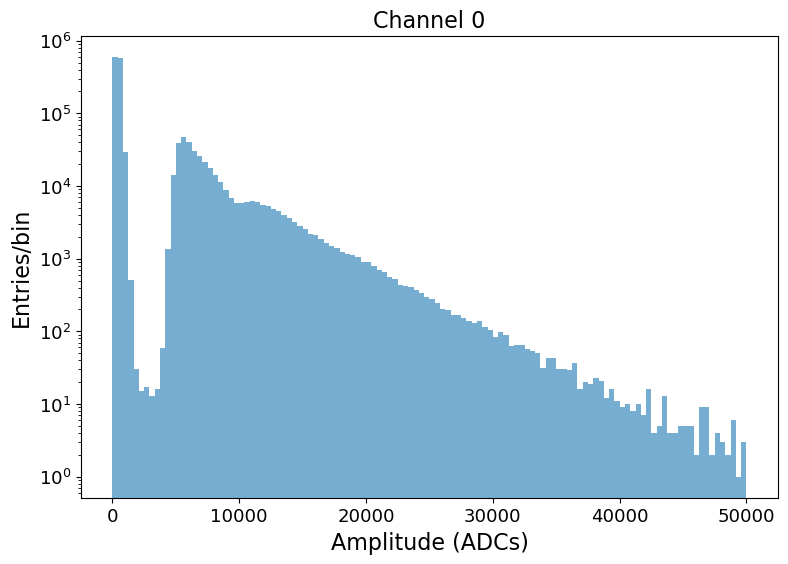

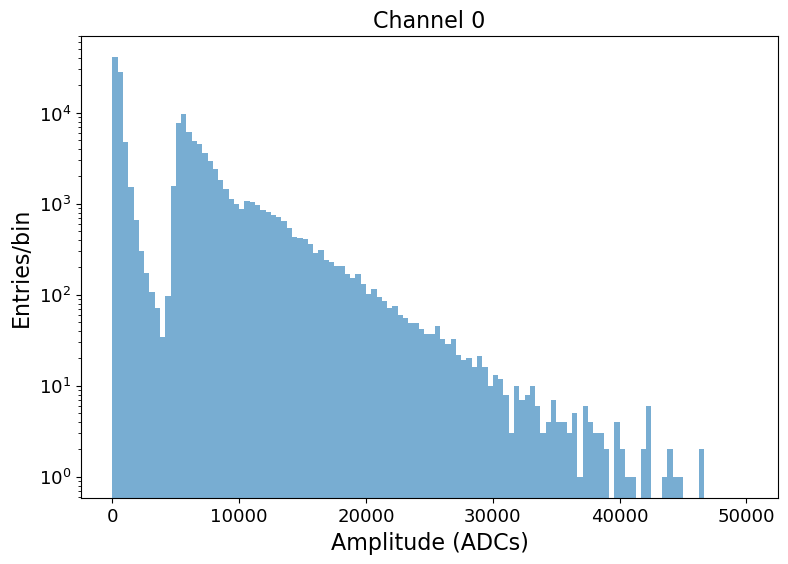

...

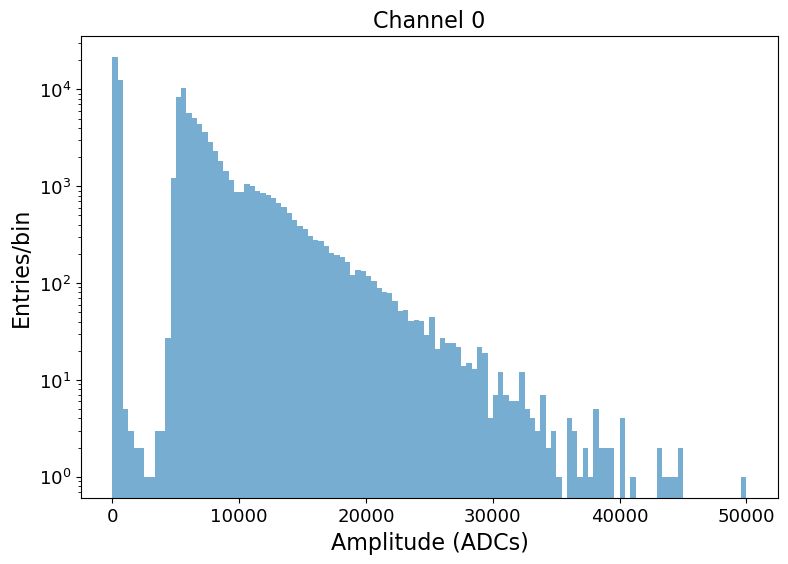

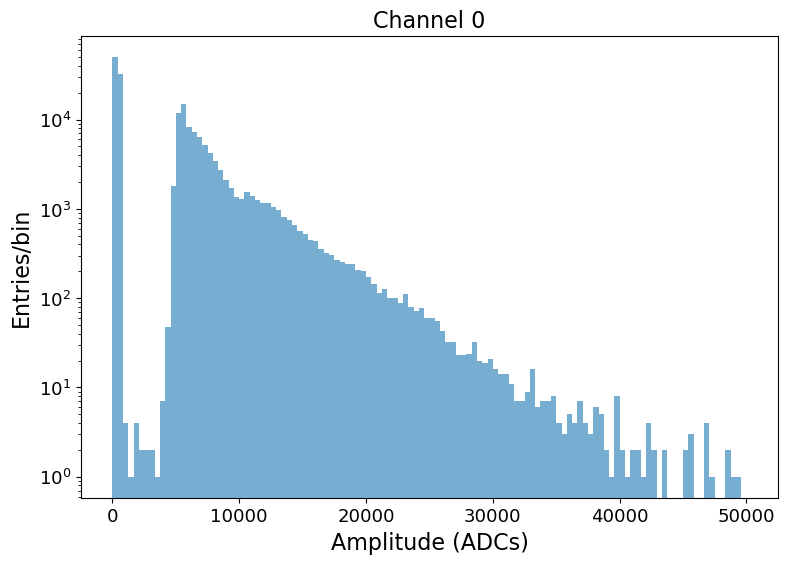

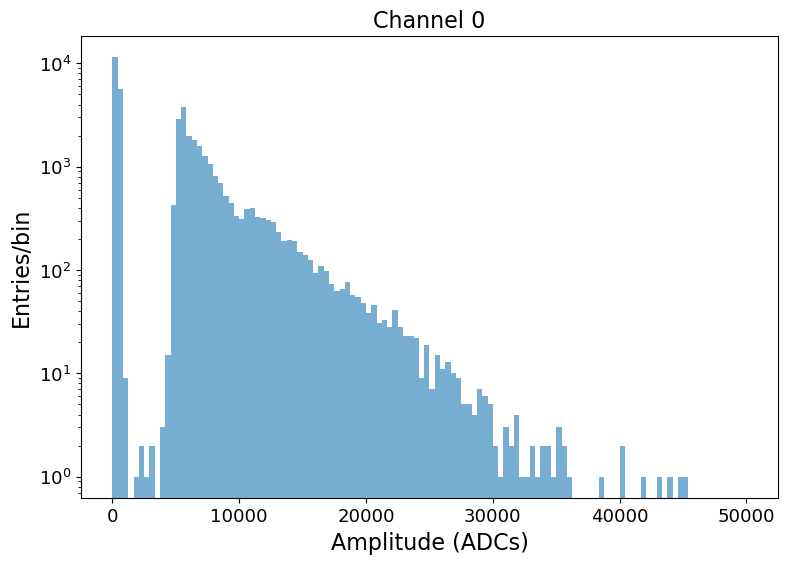

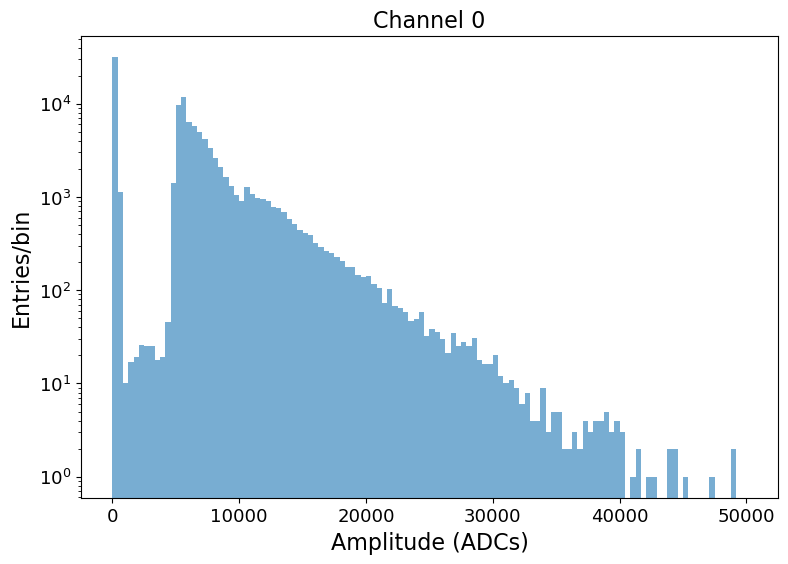

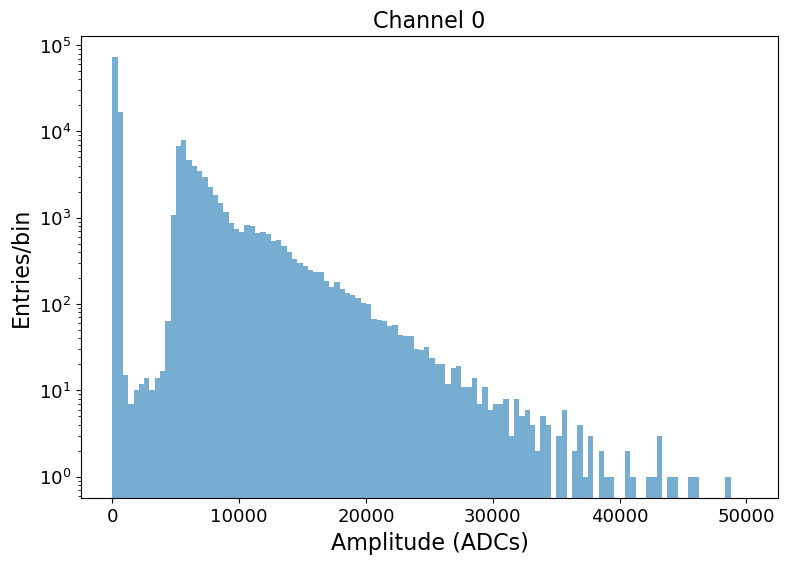

In [36]:
channel = 0

for sel_date in peak_height_all_channels_dict.keys():
    plt.hist(peak_area_all_channels_dict[sel_date][channel], bins=120, range=(0,50000), log=True, label=f'{sel_date}', alpha=0.6)
    plt.xlabel('Amplitude (ADCs)', fontsize=16)
    plt.ylabel('Entries/bin',      fontsize=16)
    plt.title(f"Channel {channel}",      fontsize=16)
    plt.show()

#### This channel cannot be calibrated.


Date 04_16_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



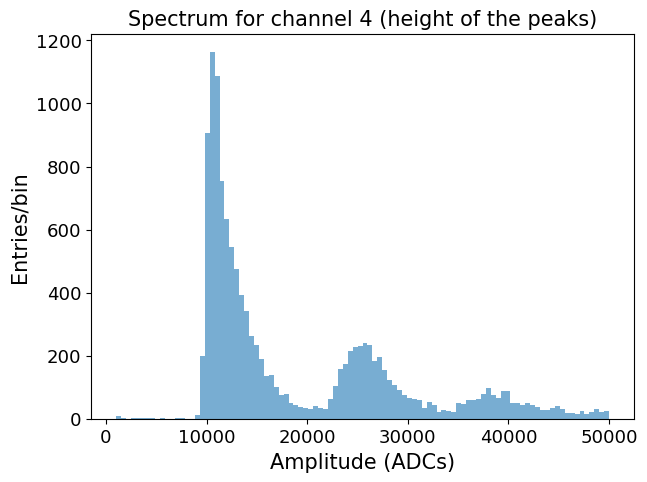

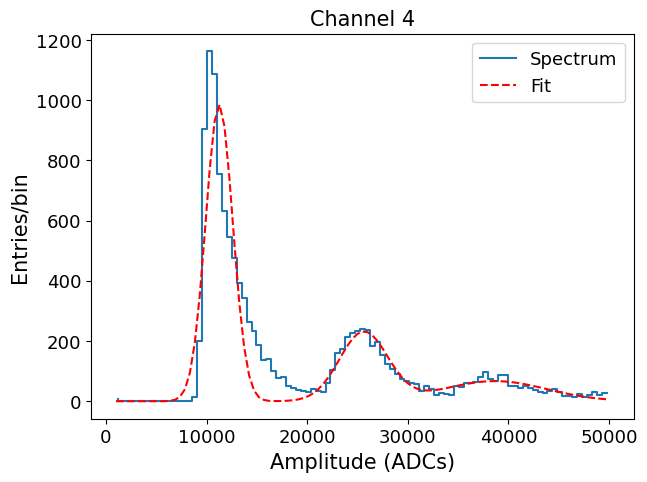

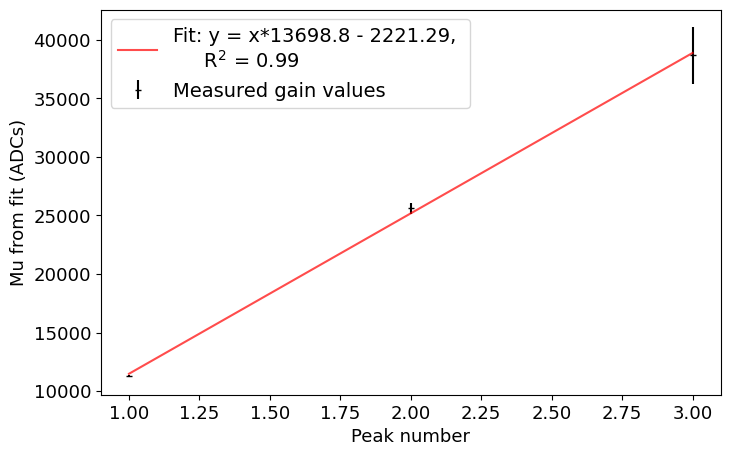


Date 05_08_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



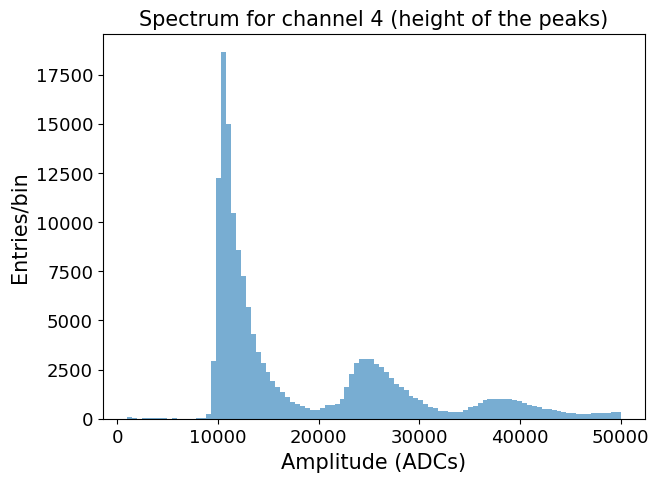

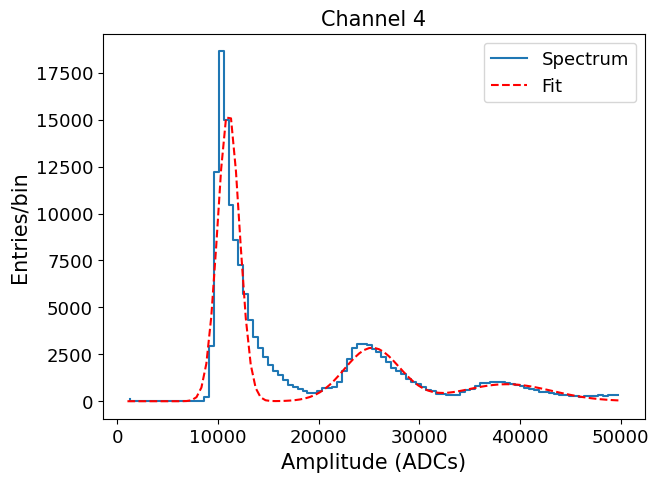

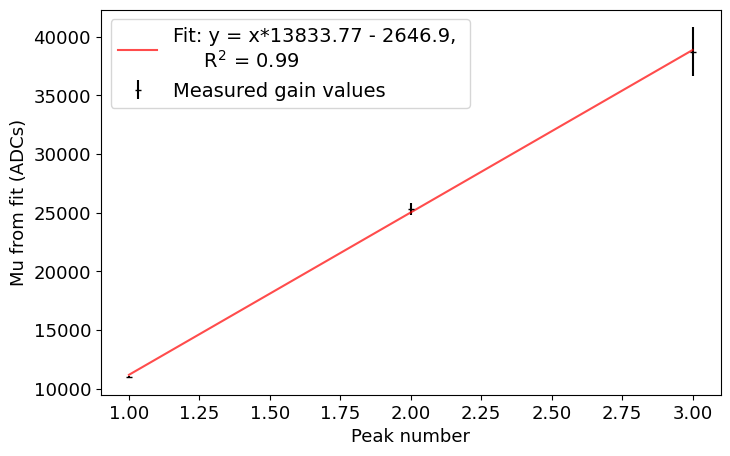


Date 05_30_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



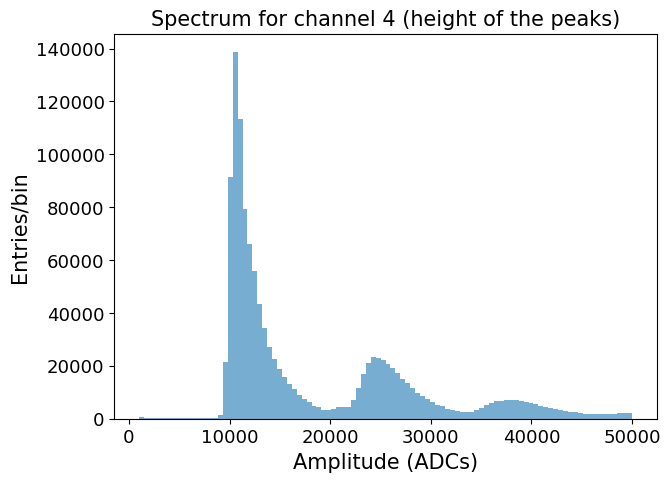

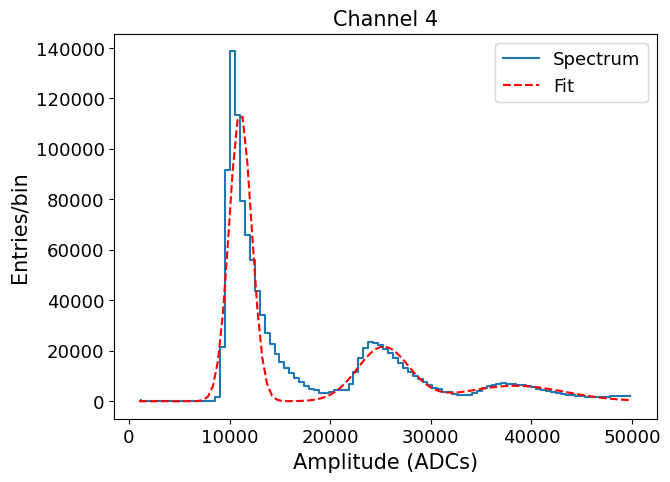

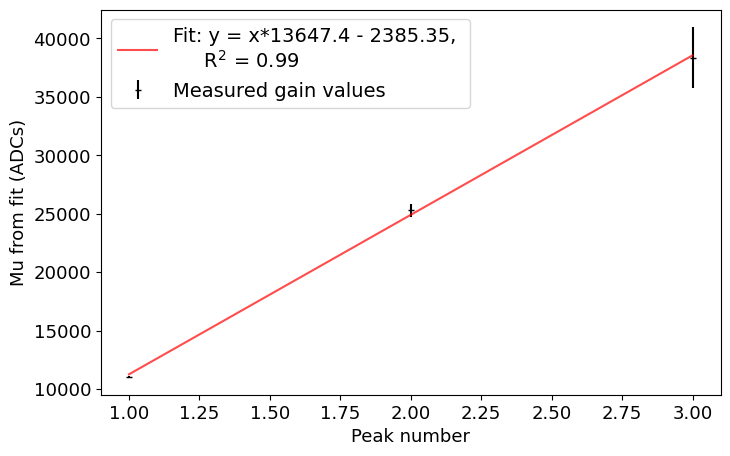


Date 06_01_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



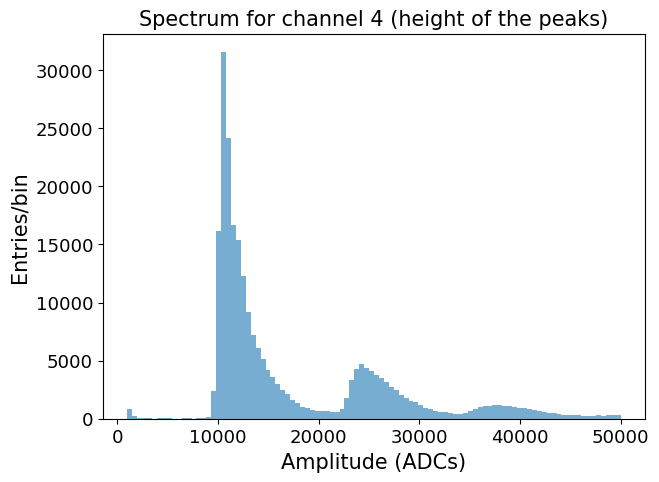

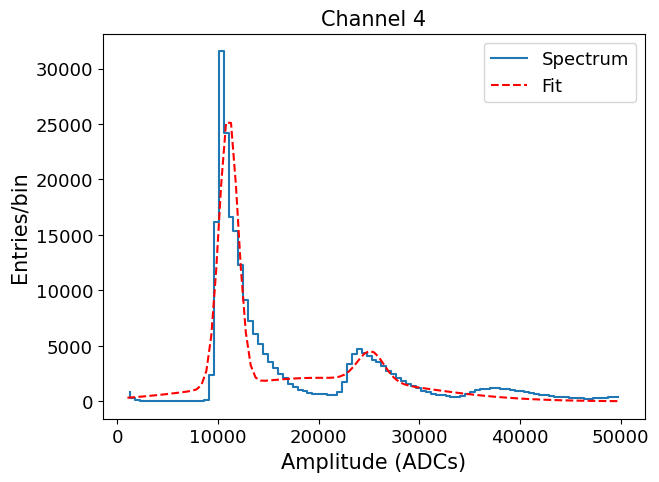

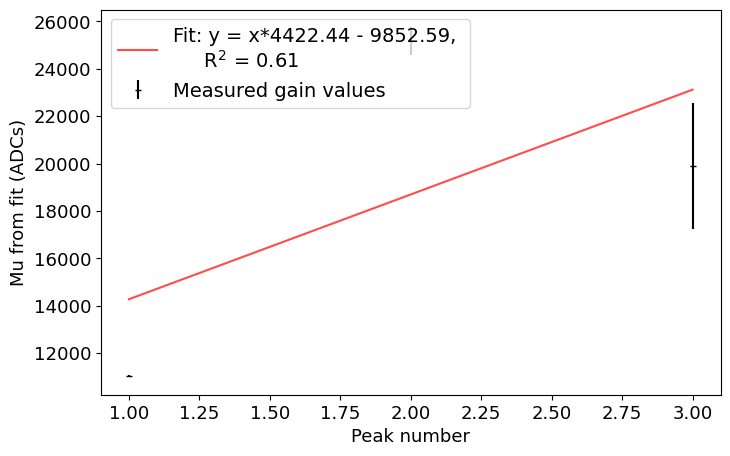


Date 06_02_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



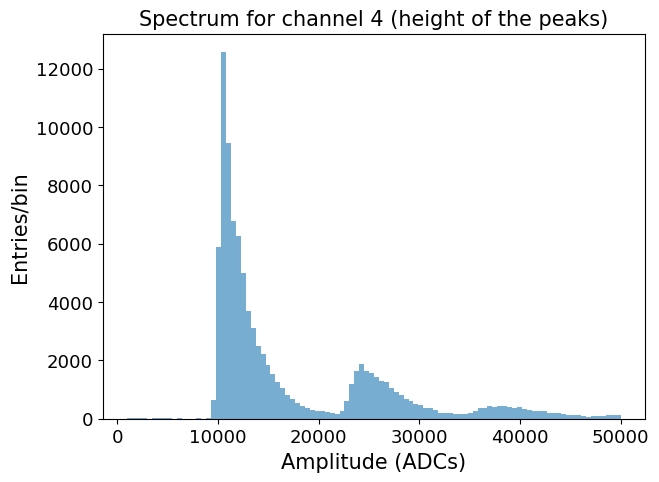

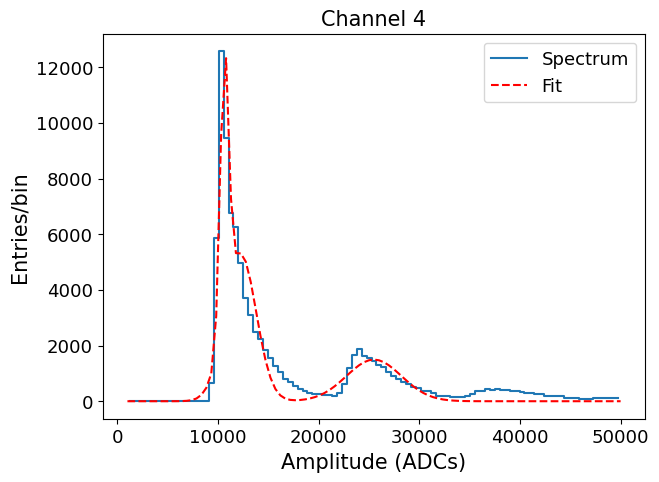

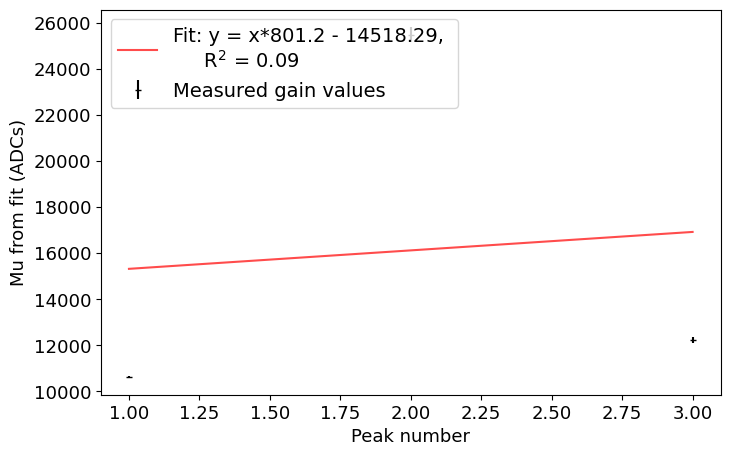


Date 06_19_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



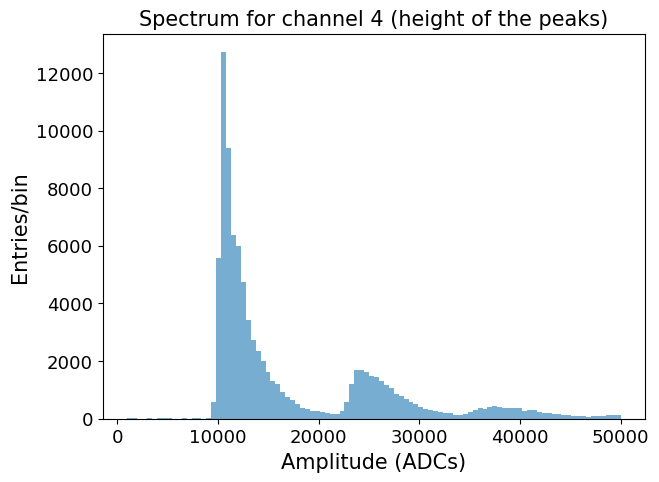

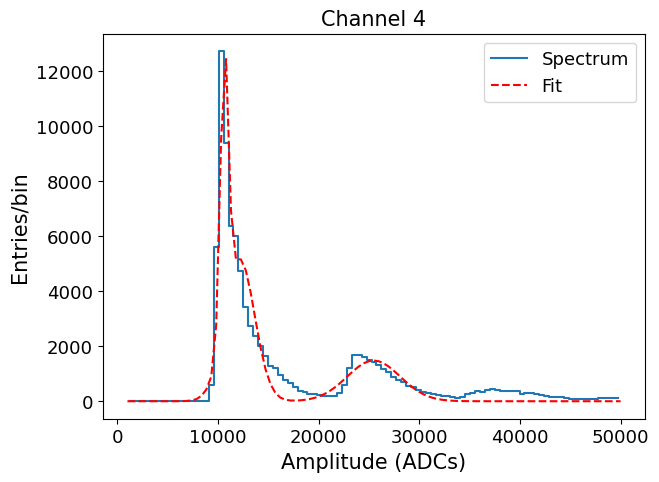

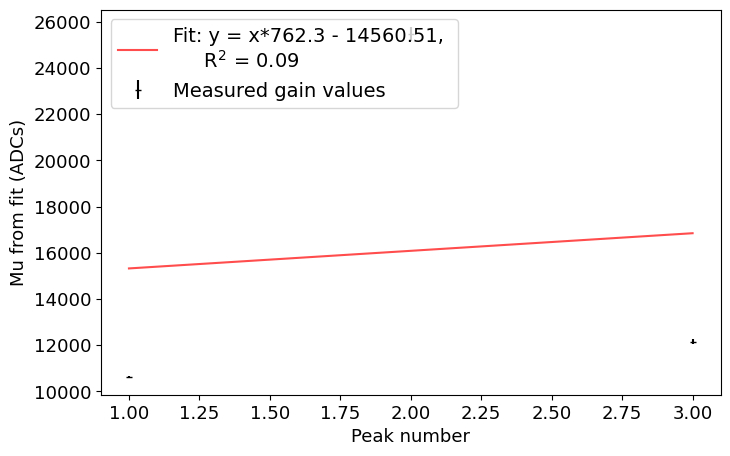


Date 06_20_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



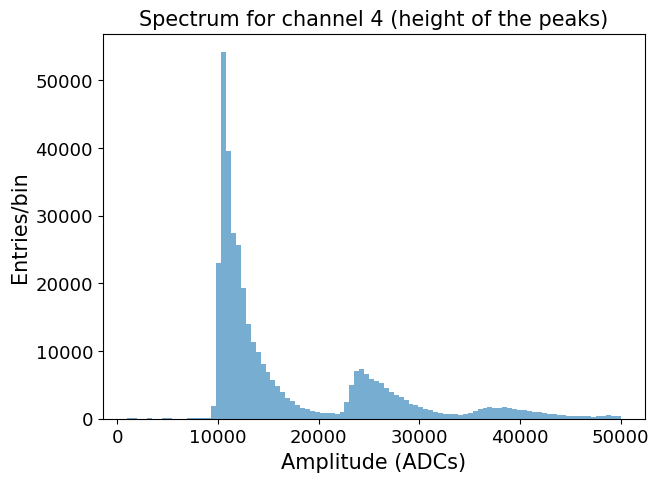

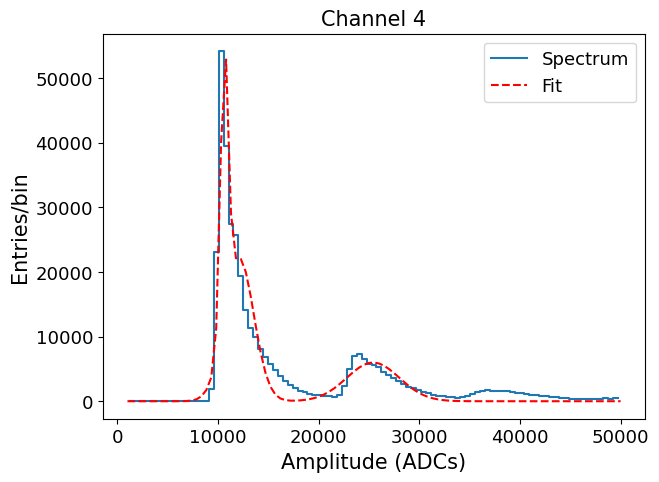

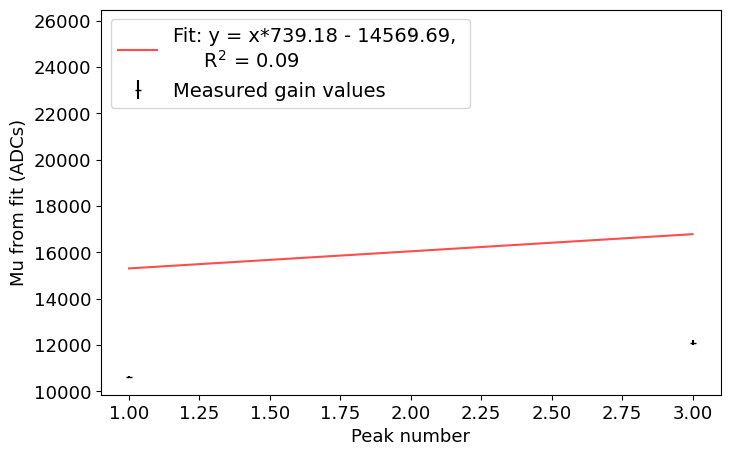


Date 06_21_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



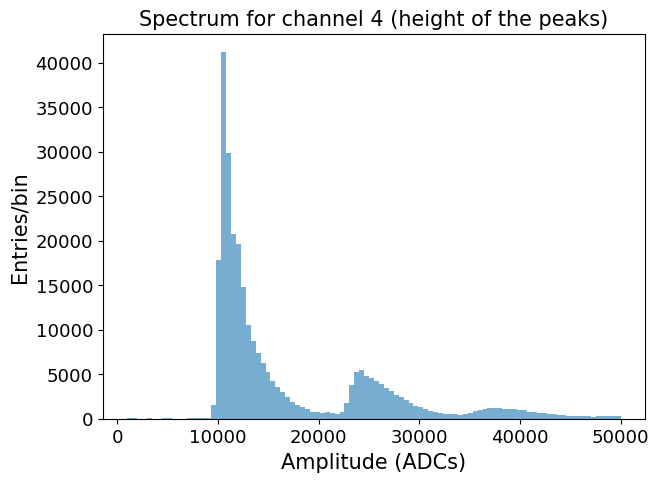

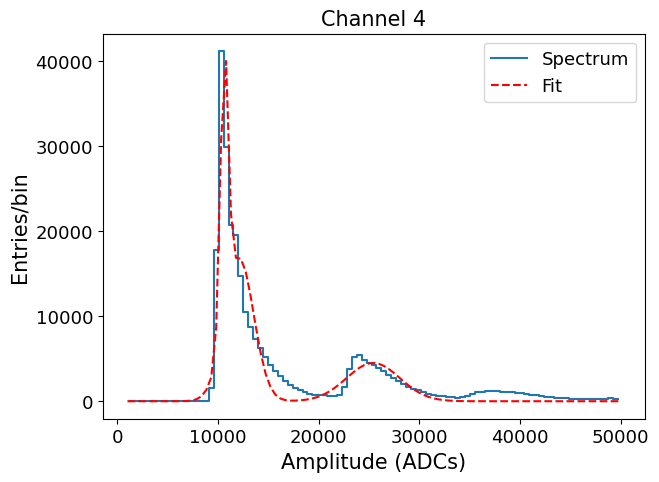

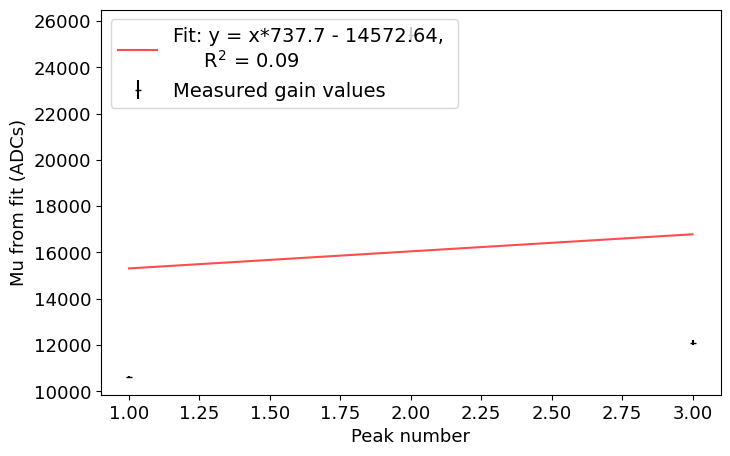


Date 06_24_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



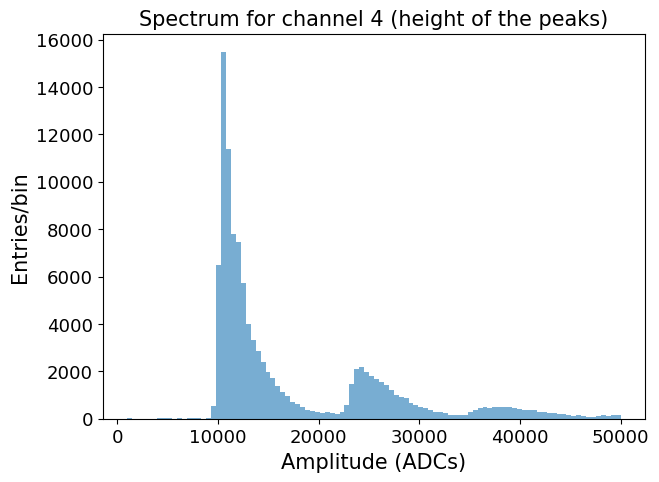

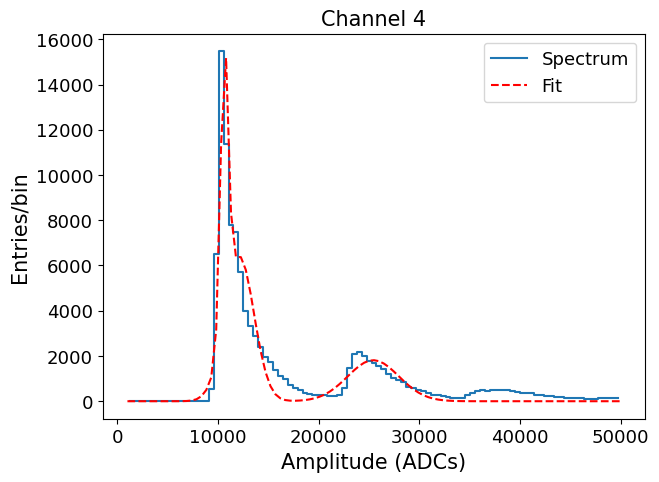

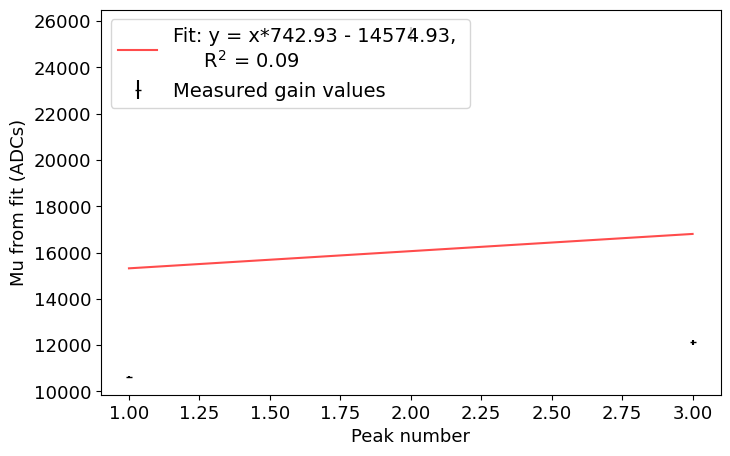


Date 07_05_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



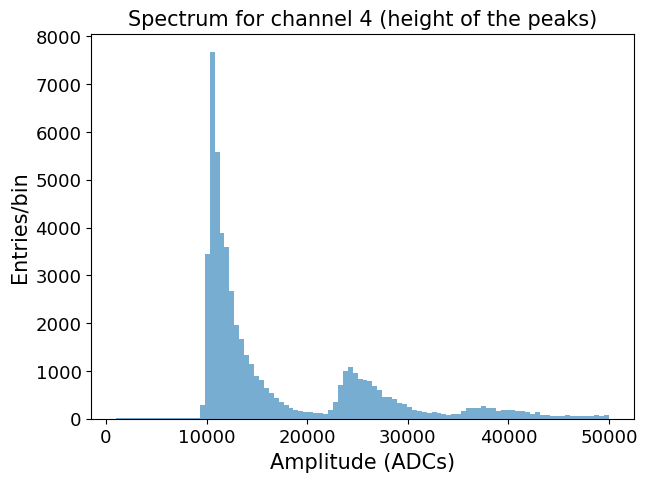

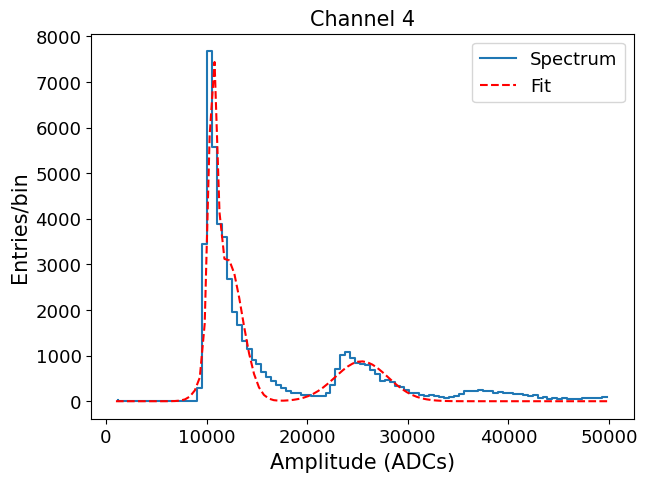

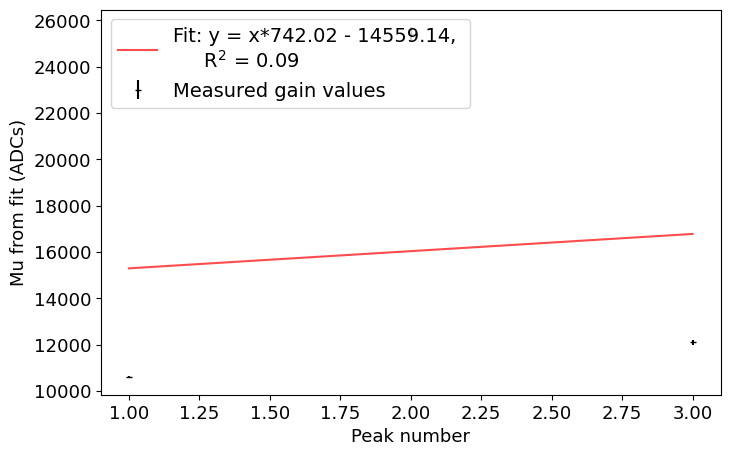


Date 07_06_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



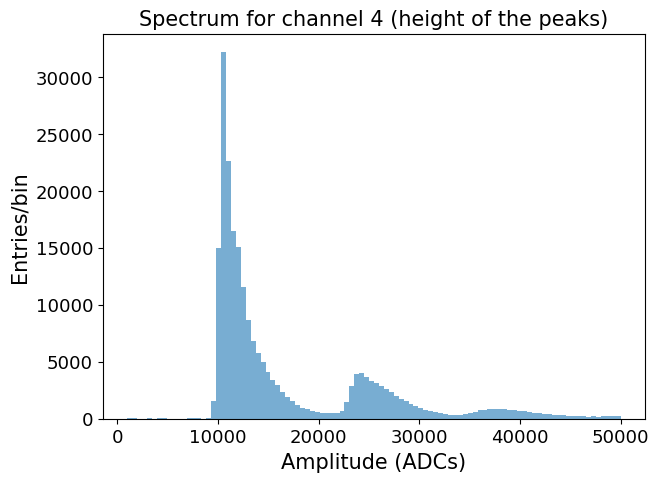

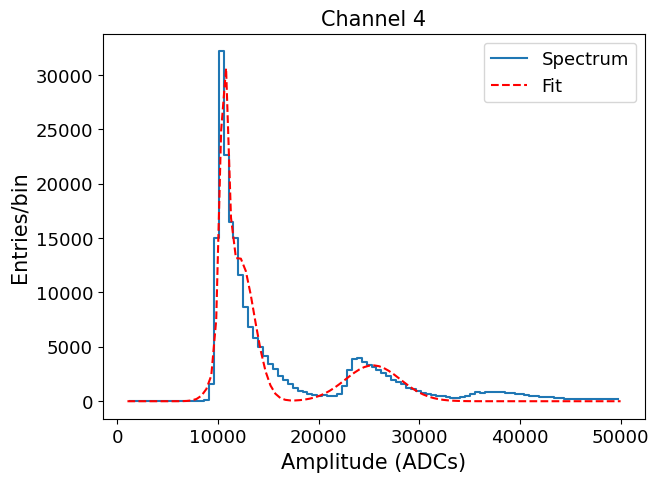

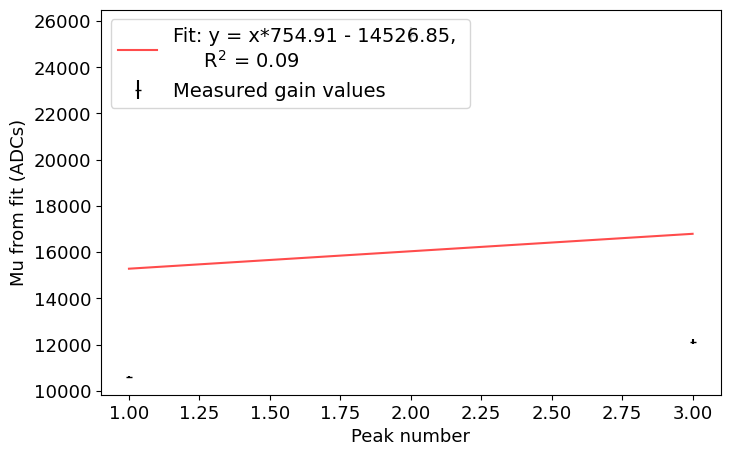


Date 07_07_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



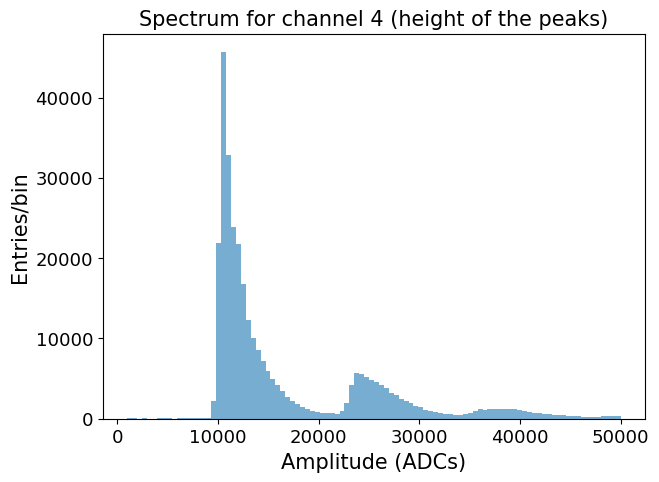

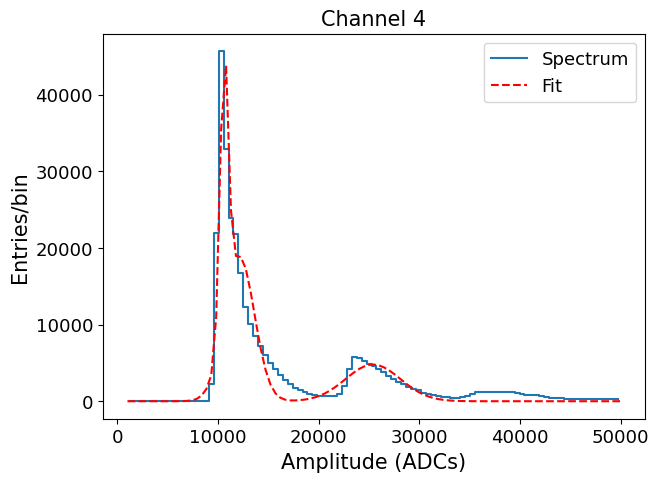

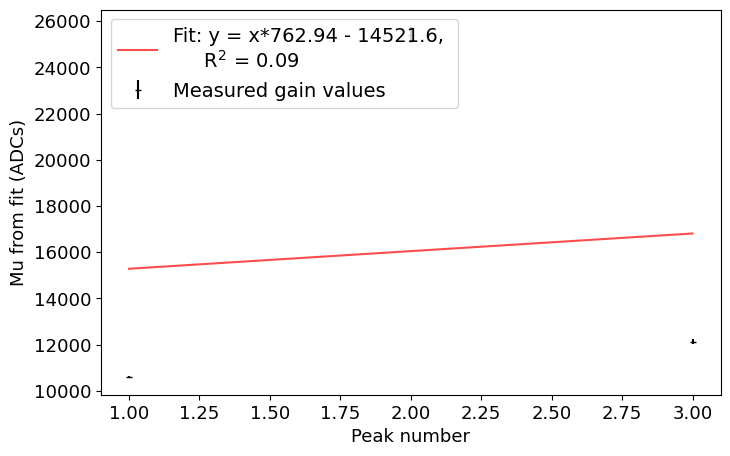


Date 07_08_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



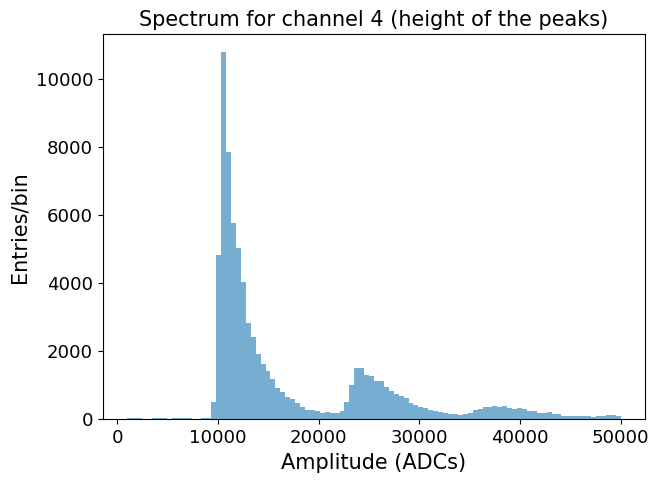

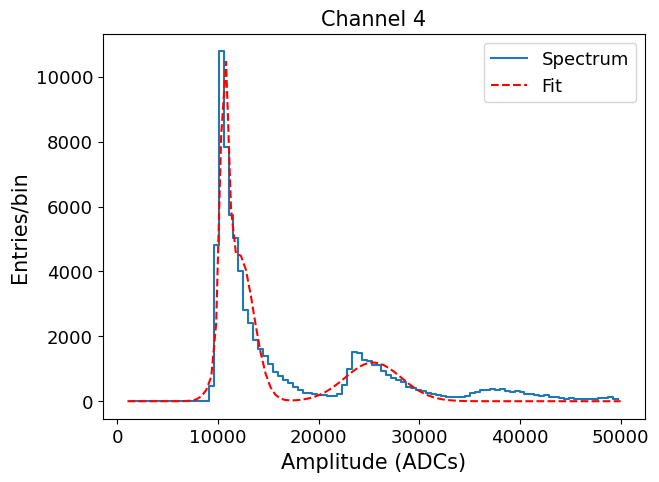

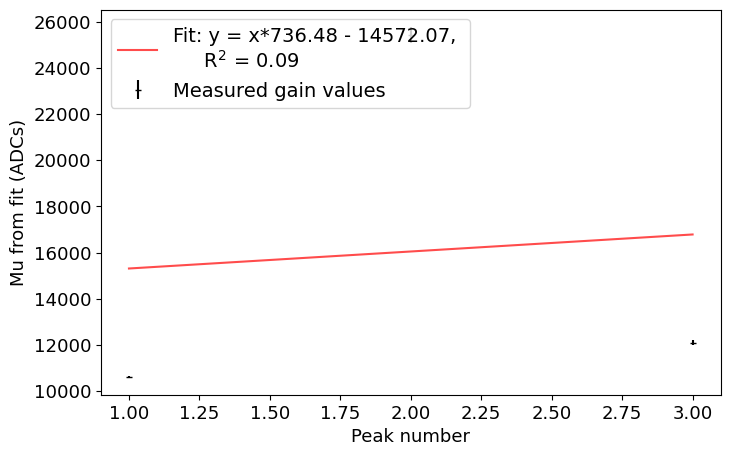


Date 07_10_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



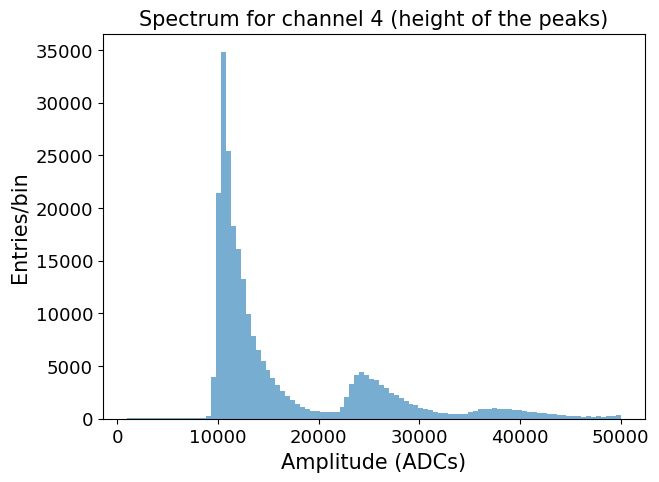

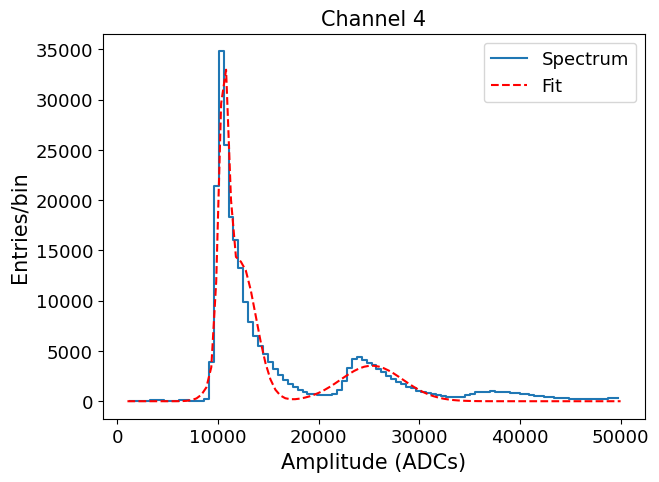

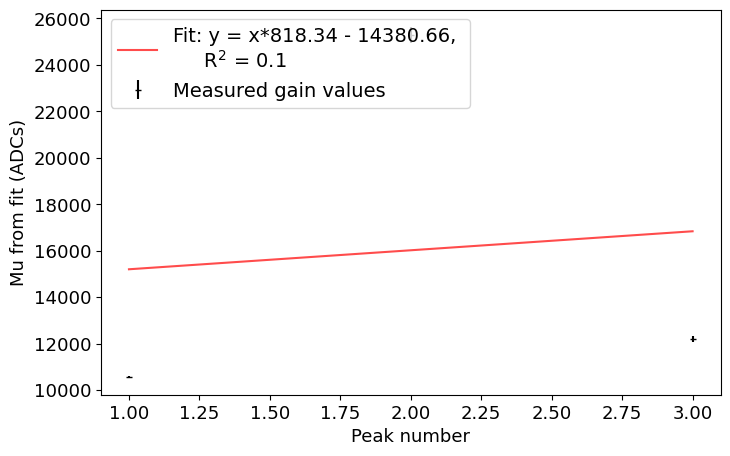


Date 07_11_2023


------------------------------------------------------------------------------------------
-------    Channel 4    ---------------------------------------------------------
------------------------------------------------------------------------------------------



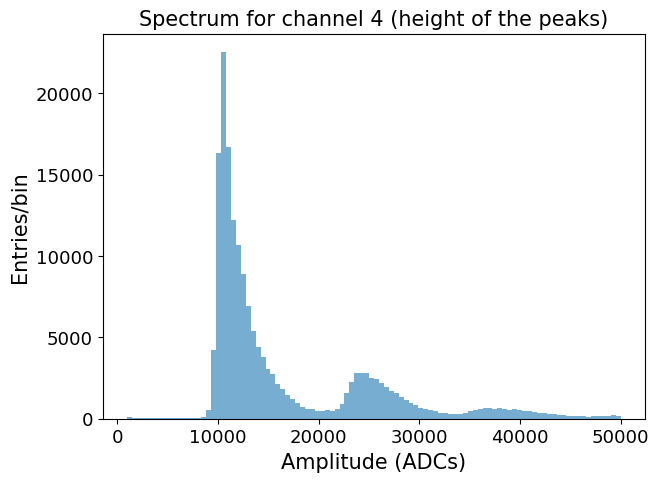

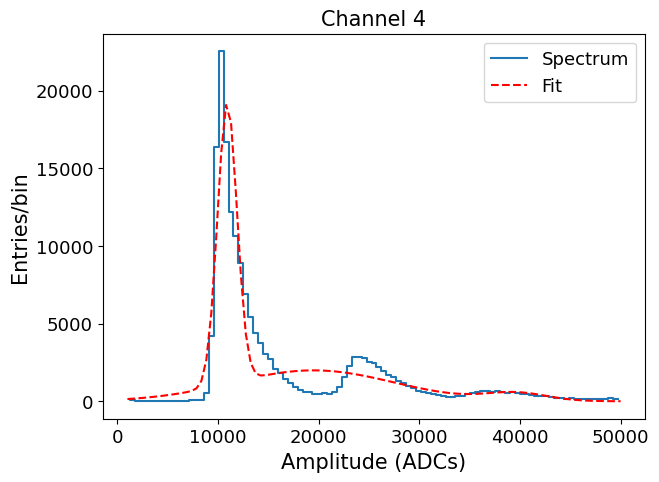

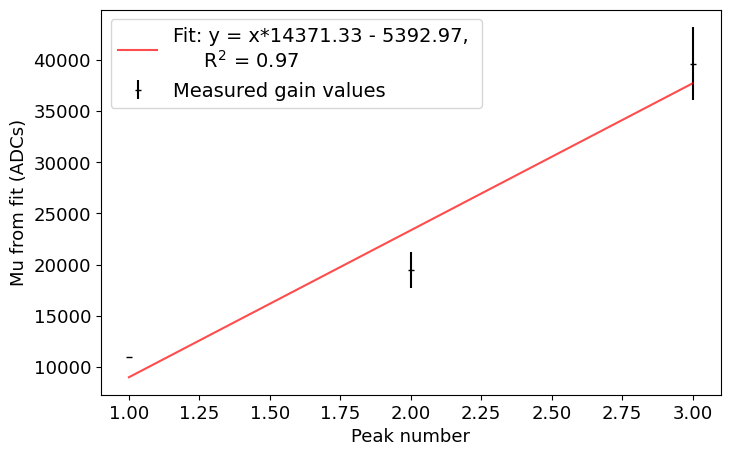

In [37]:
channel         = 4
gain_int_chann4 = []
for i, sel_date in enumerate(peak_area_all_channels_dict.keys()):
    #if i>1: break
    if sel_date == '05_22_2023': continue
    initial_guess  = [300000, 12000, 2000, 100000, 25000, 2000, 20000, 38000, 2000]
    try:
        print()
        print(f'Date {sel_date}')
        print()
        gain, ch_means = extract_gain_and_mean(peak_area_all_channels_dict[sel_date][channel],
                                               channel       = channel,
                                               bins          = 100,
                                               prange        = (1000, 50000),
                                               initial_guess = initial_guess)
        gain_int_chann4.append(gain)
    except:
        continue

gain_int_chann4 = np.array(gain_int_chann4)


Date 04_16_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



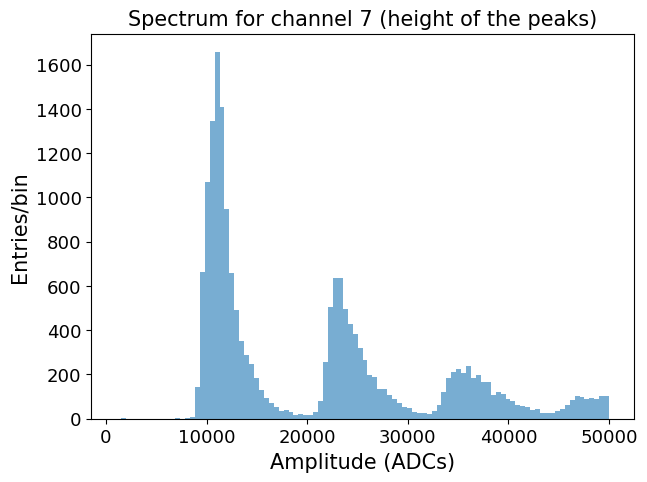

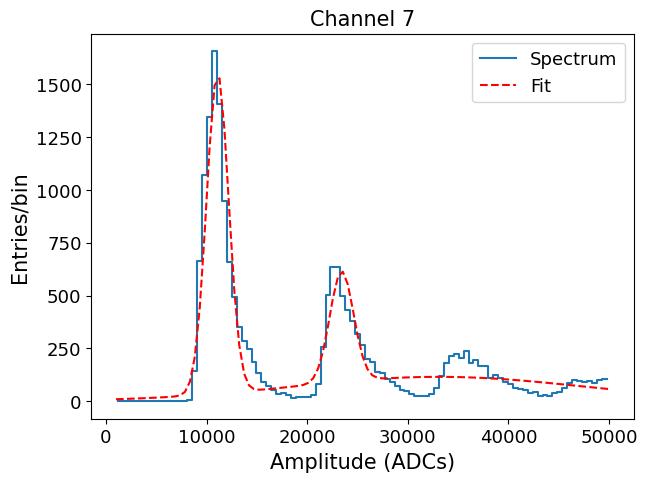

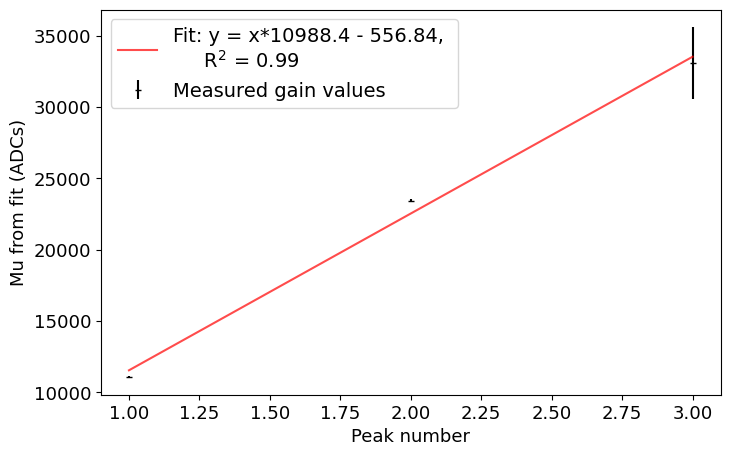


Date 05_08_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



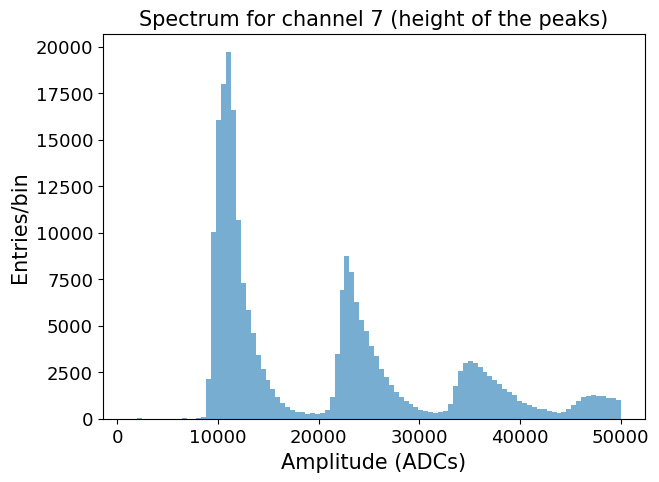

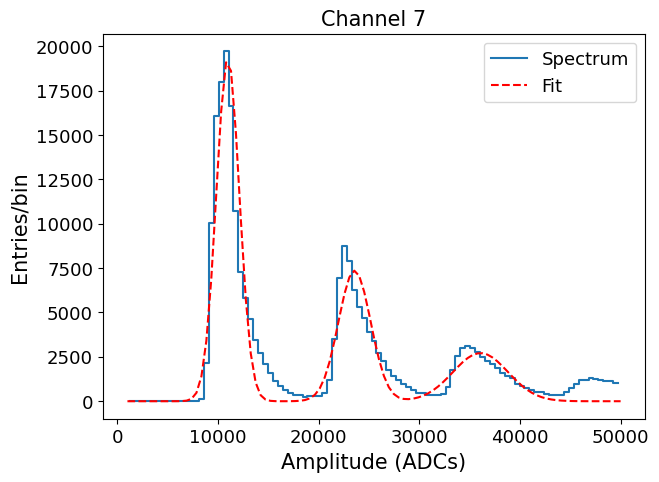

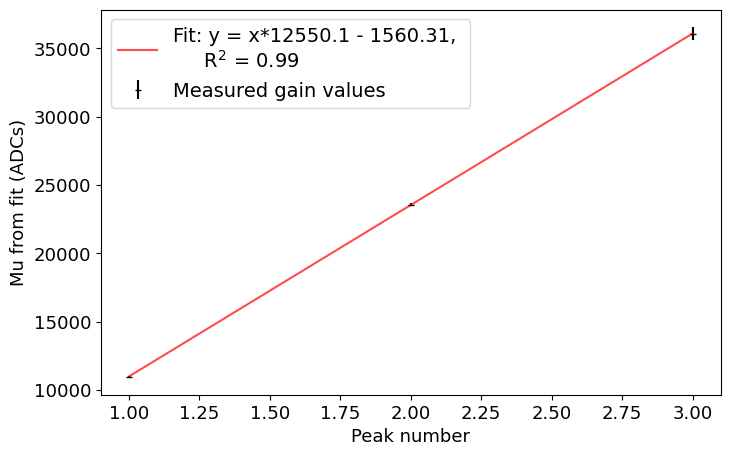


Date 05_30_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



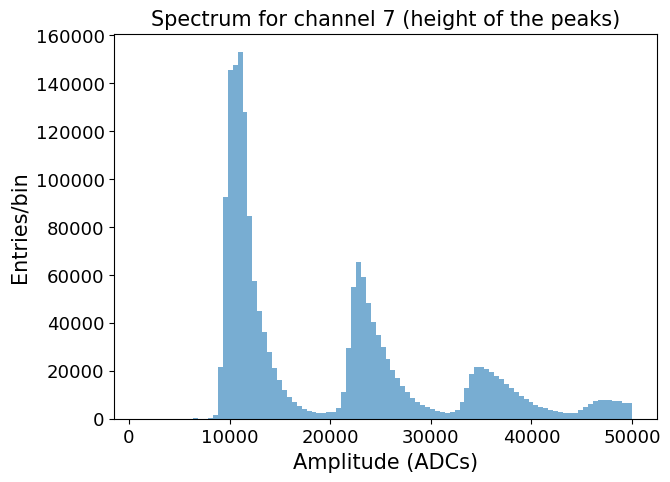

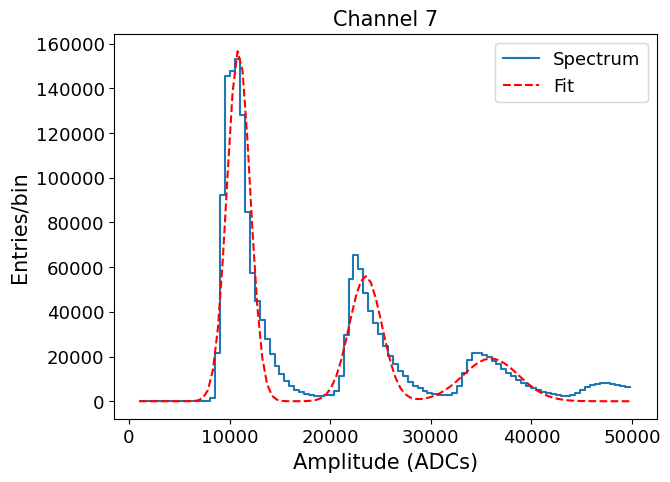

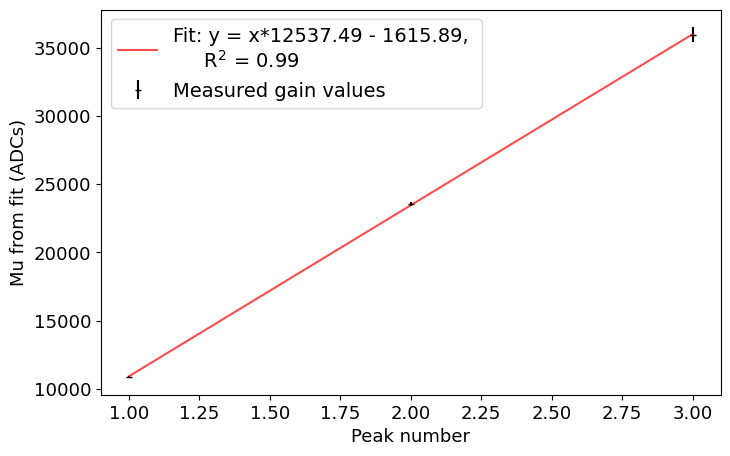


Date 06_01_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



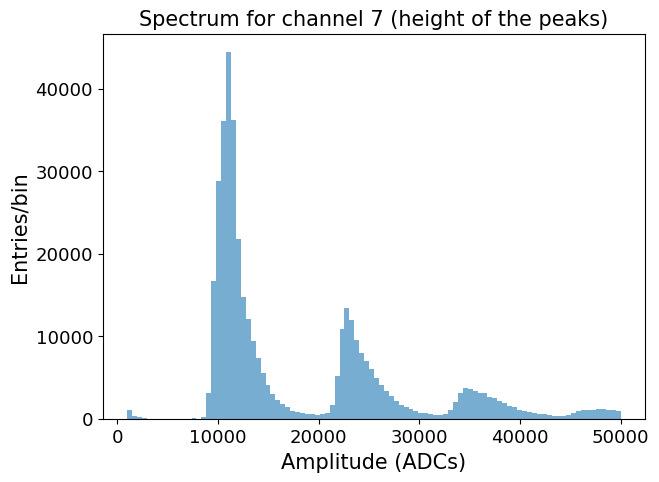

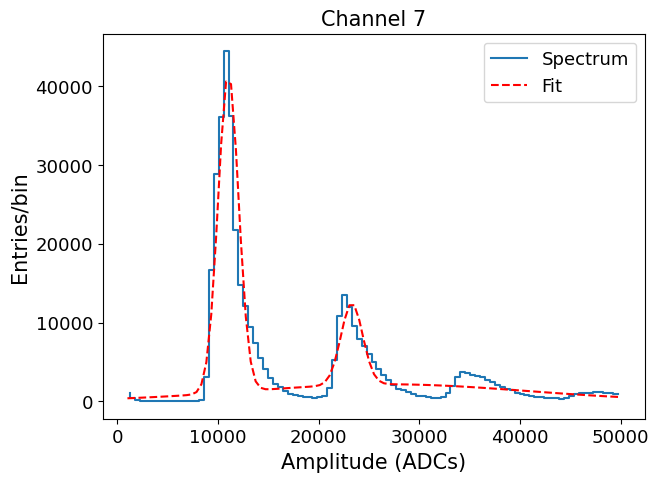

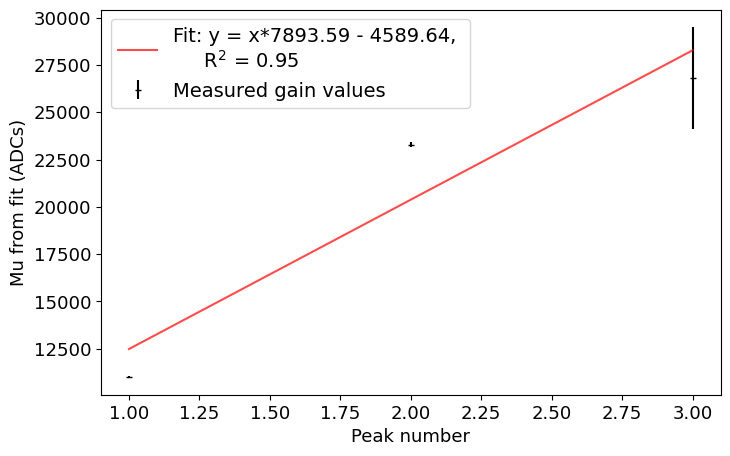


Date 06_02_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



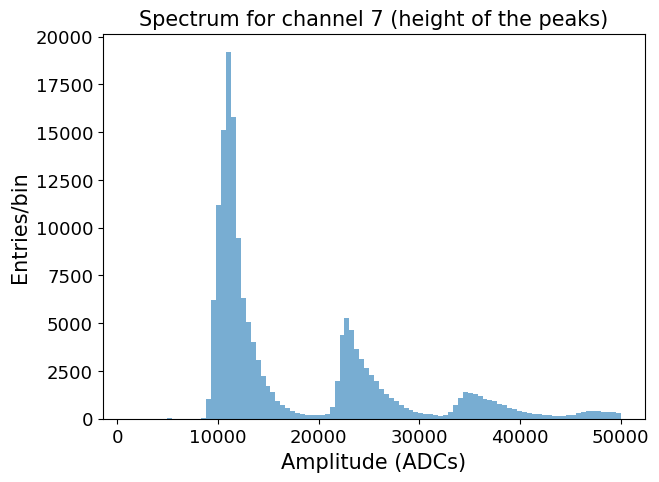

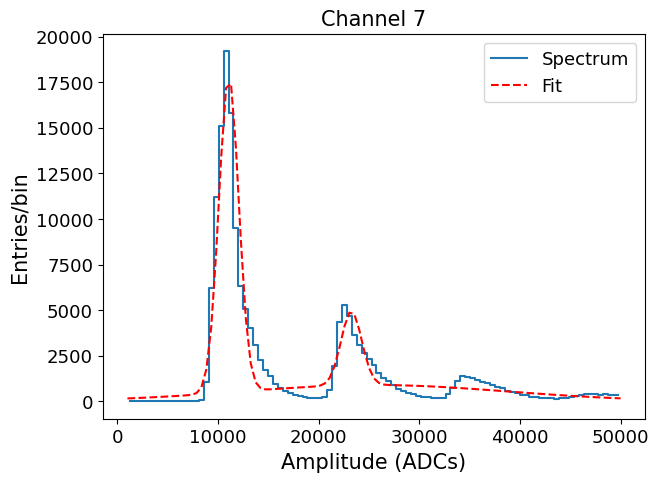

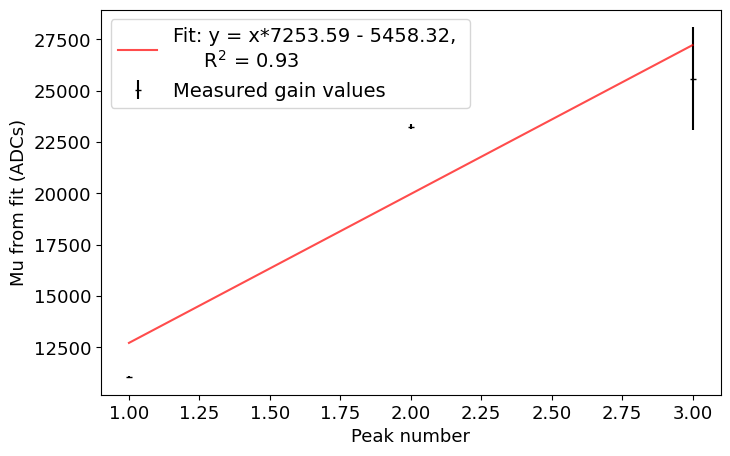


Date 06_19_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



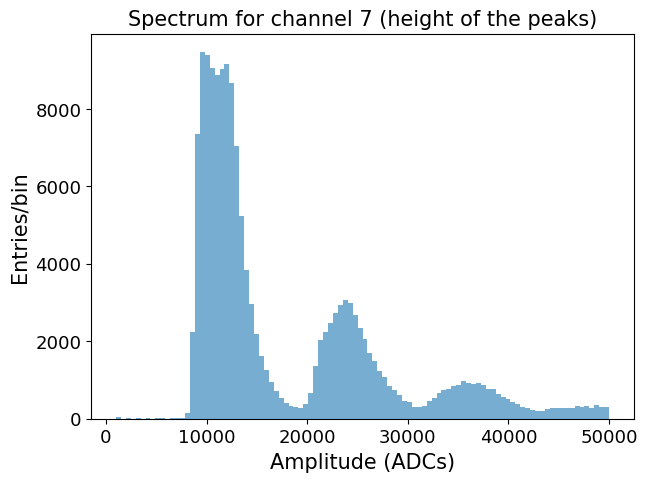

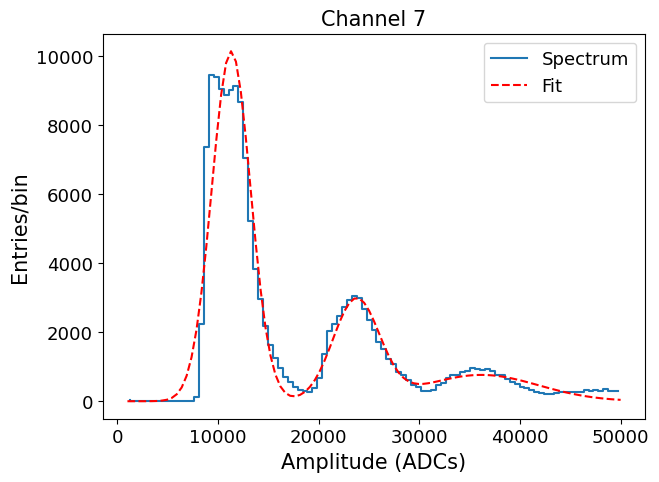

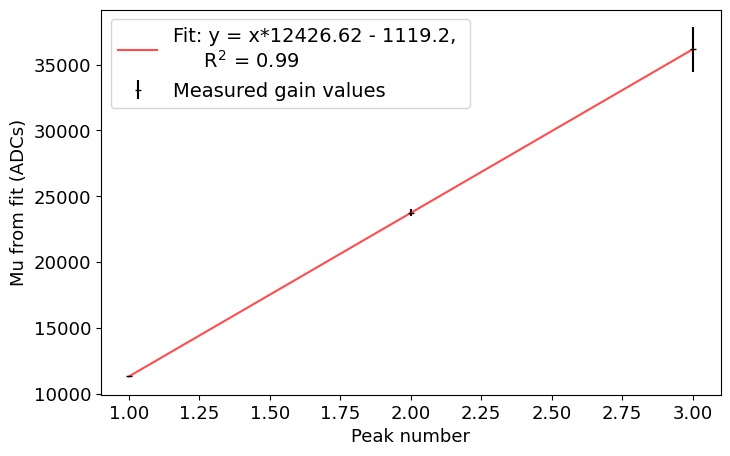


Date 06_20_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



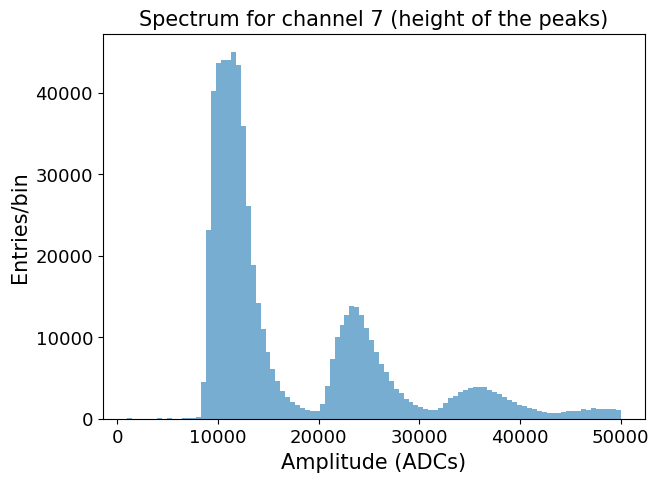

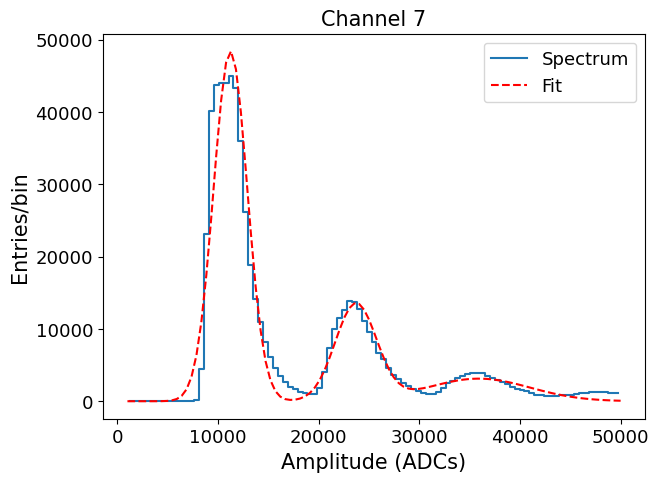

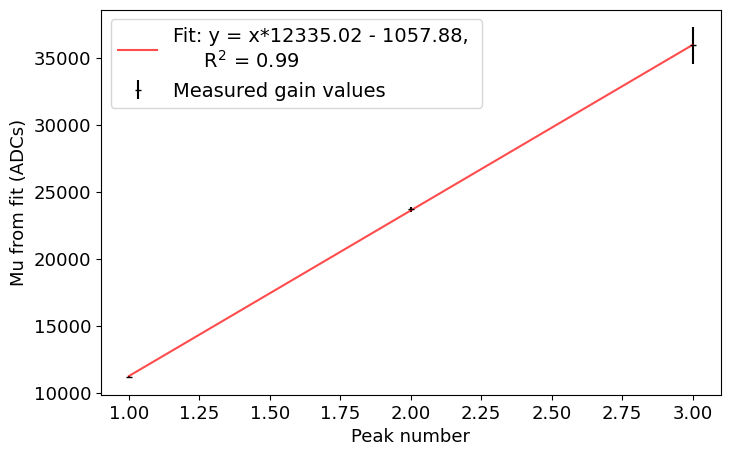


Date 06_21_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



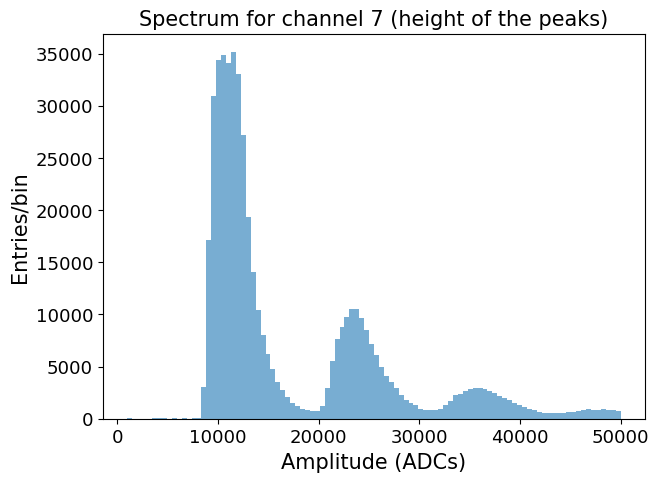

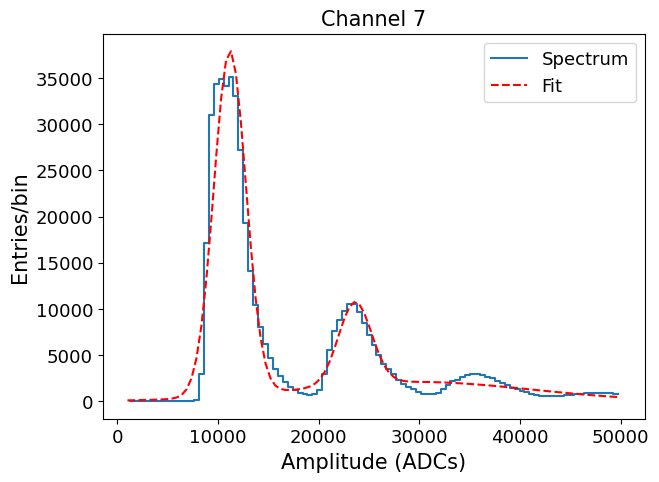

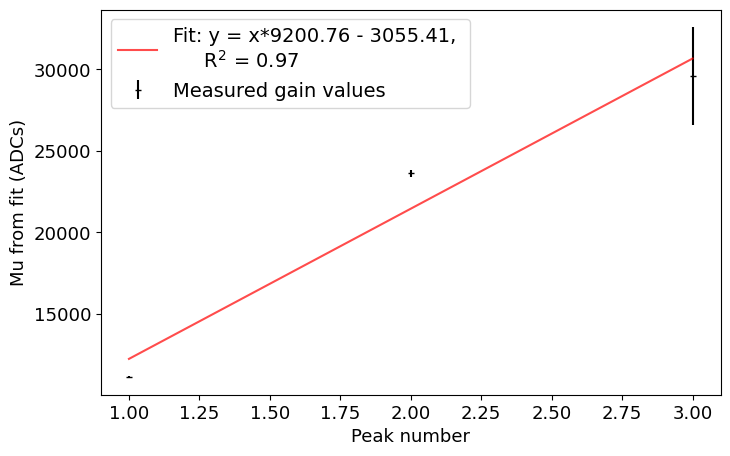


Date 06_24_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



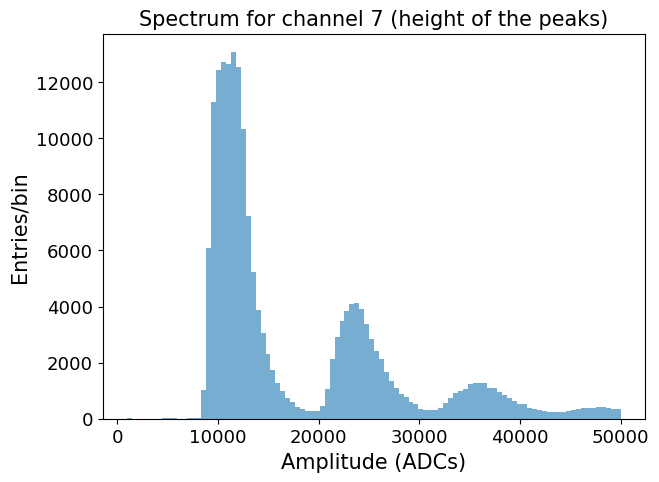

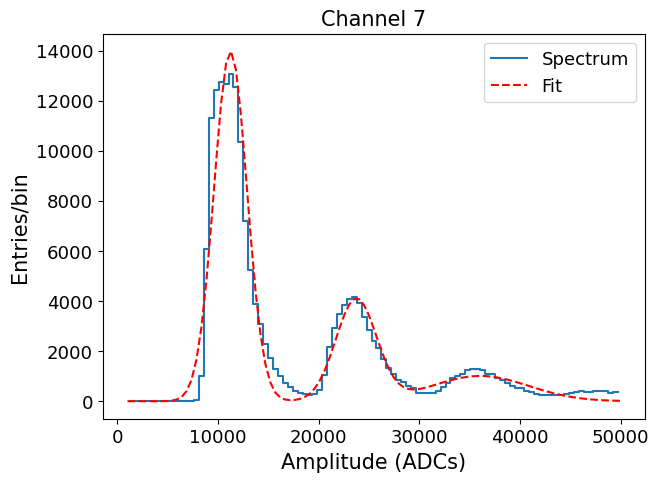

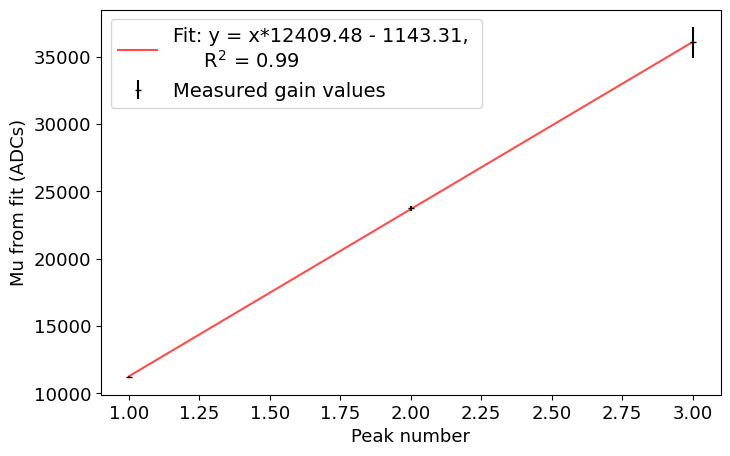


Date 07_05_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



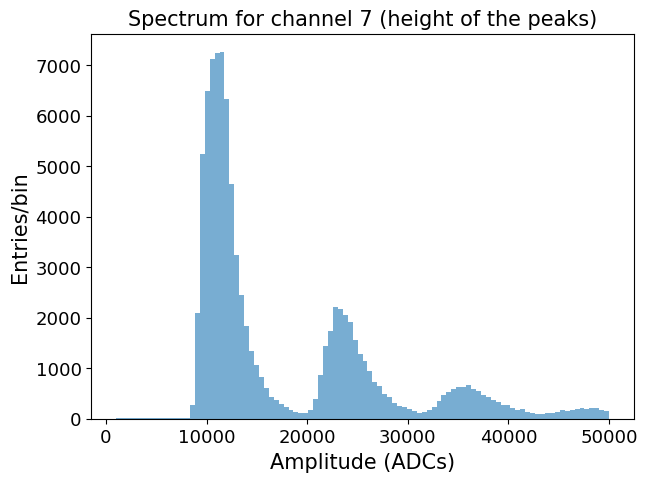

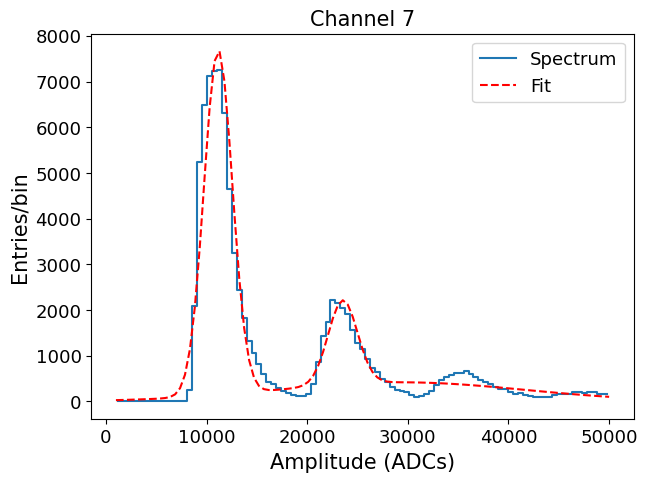

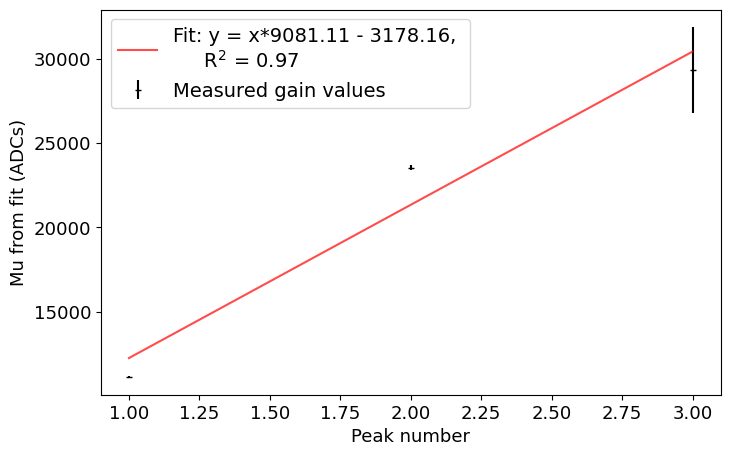


Date 07_06_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



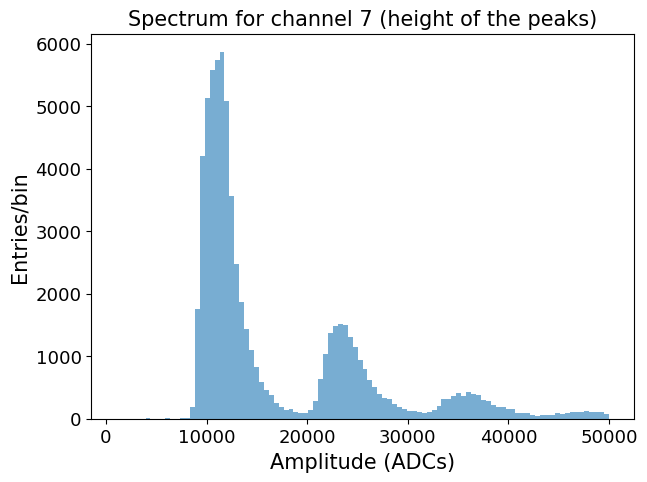

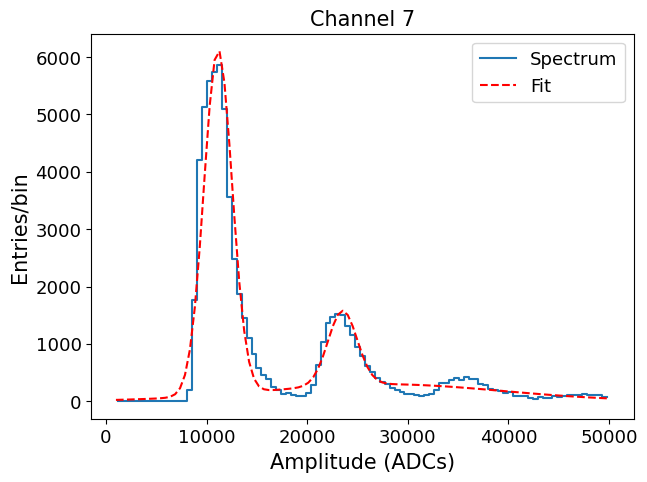

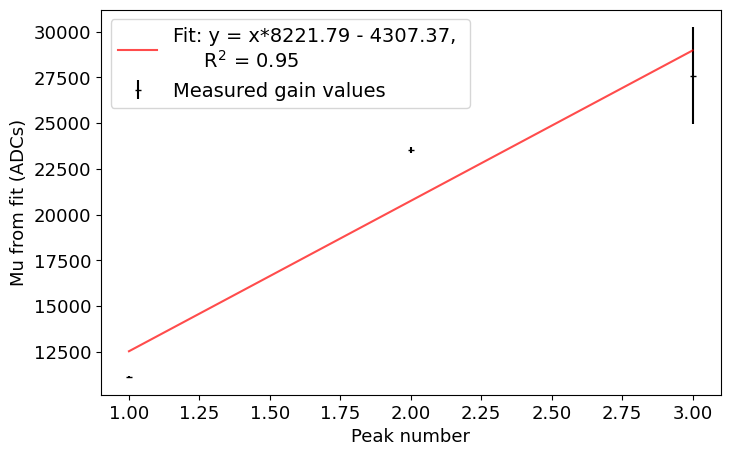


Date 07_07_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



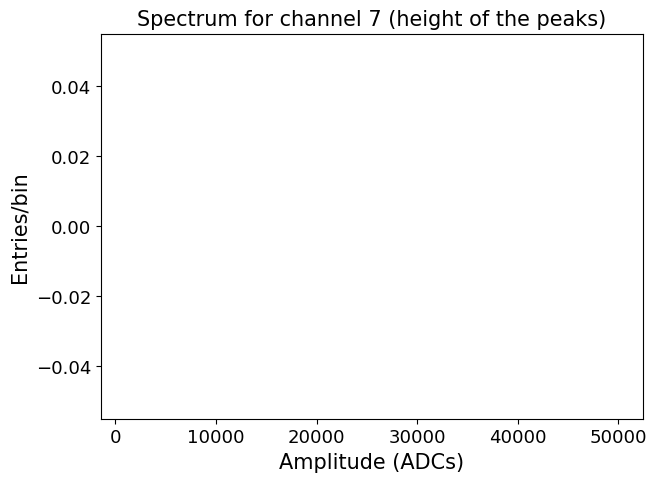

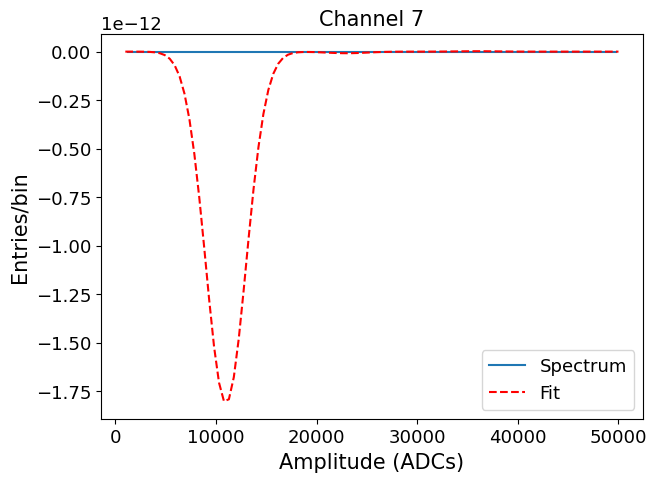

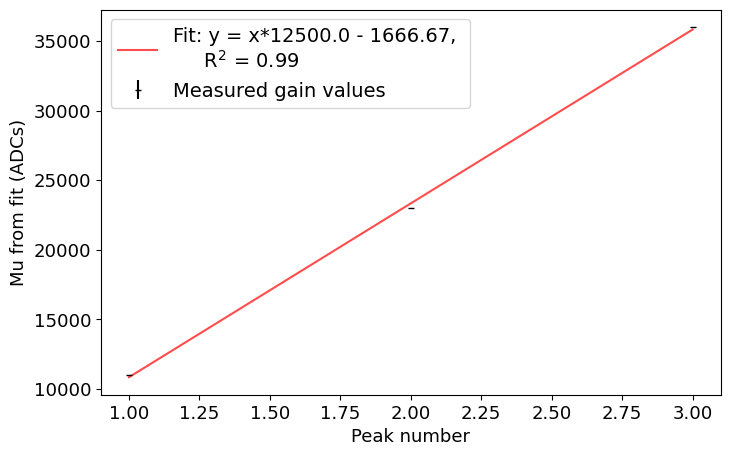


Date 07_08_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



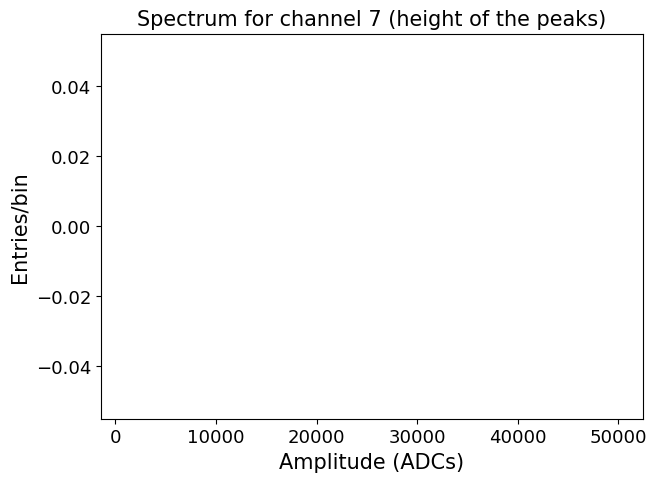

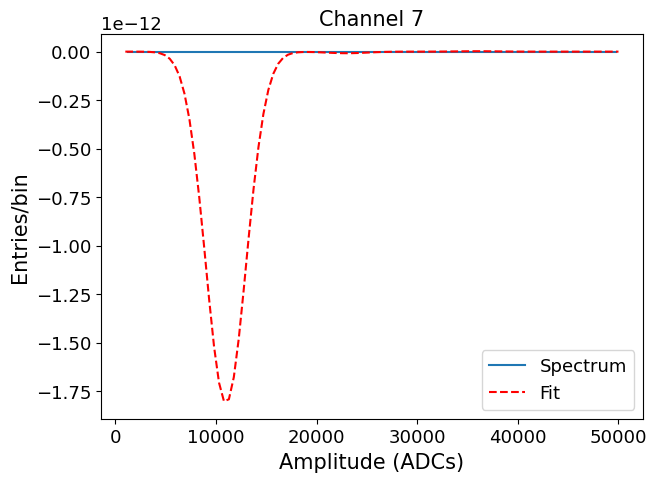

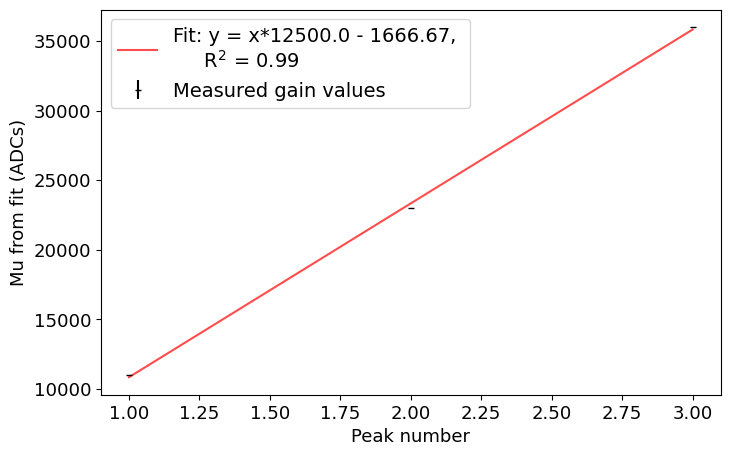


Date 07_10_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



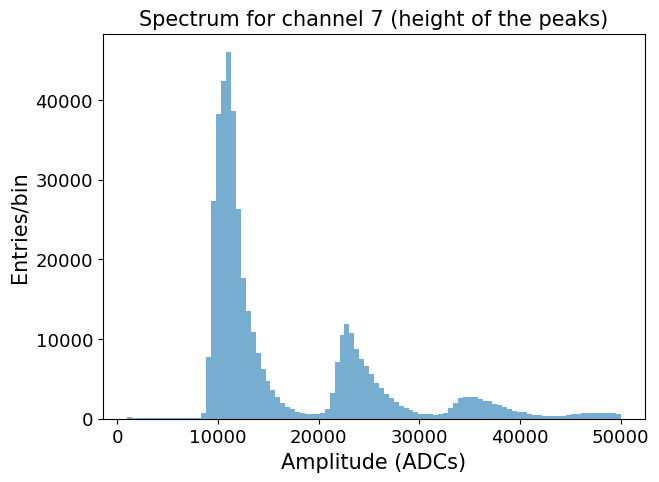

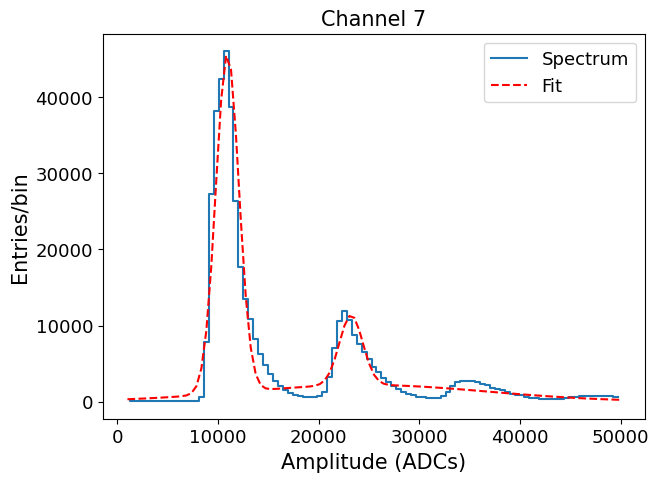

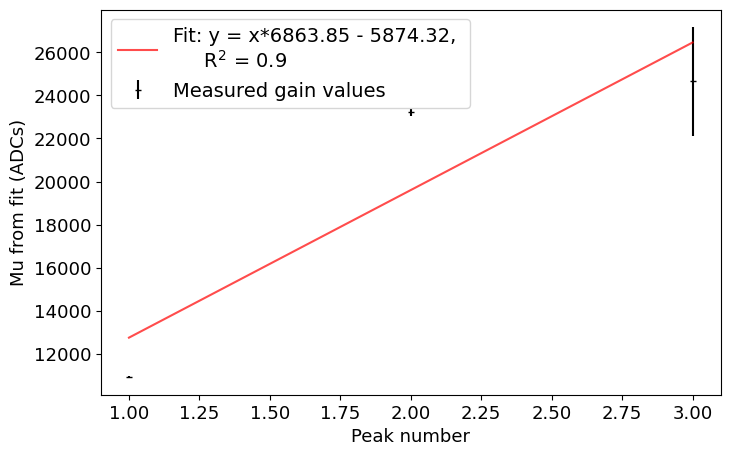


Date 07_11_2023


------------------------------------------------------------------------------------------
-------    Channel 7    ---------------------------------------------------------
------------------------------------------------------------------------------------------



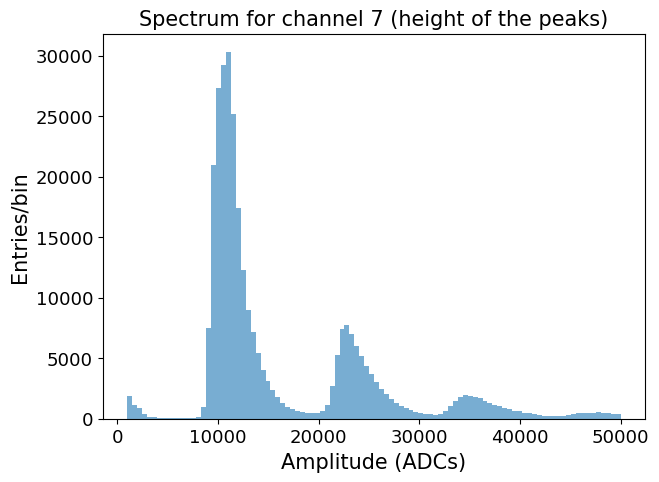

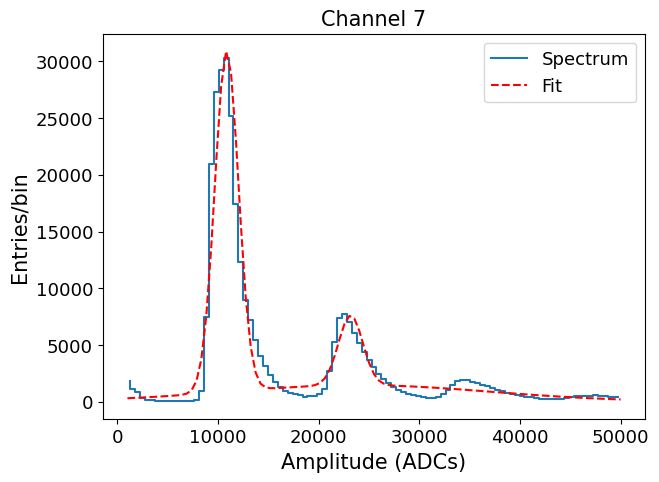

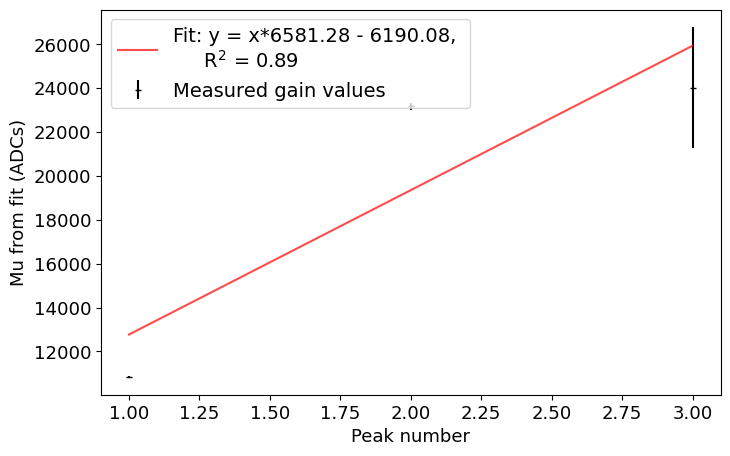

In [38]:
channel         = 7
gain_int_chann7 = []
for i, sel_date in enumerate(peak_area_all_channels_dict.keys()):
    #if i>1: break
    if sel_date == '05_22_2023': continue
    initial_guess  = [300000, 11000, 2000, 100000, 23000, 2000, 20000, 36000, 2000]
    try:
        print()
        print(f'Date {sel_date}')
        print()
        gain, ch_means = extract_gain_and_mean(peak_area_all_channels_dict[sel_date][channel],
                                               channel       = channel,
                                               bins          = 100,
                                               prange        = (1000, 50000),
                                               initial_guess = initial_guess)
        gain_int_chann7.append(gain)
    except:
        continue

gain_int_chann7 = np.array(gain_int_chann7)


Date 04_16_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



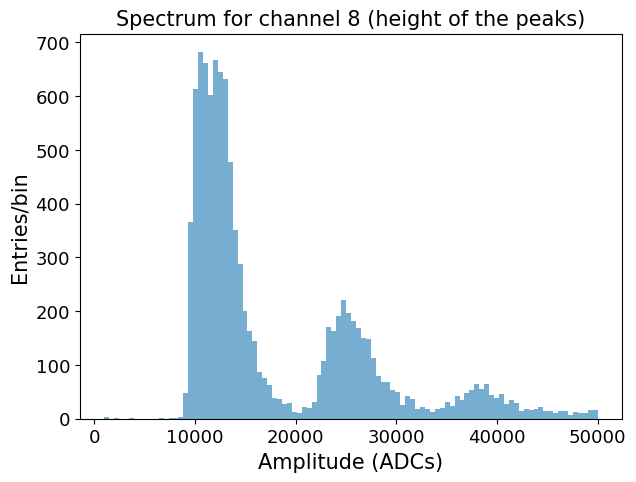

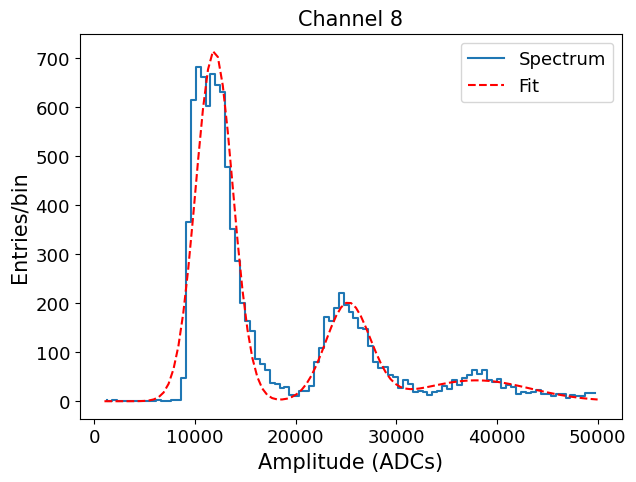

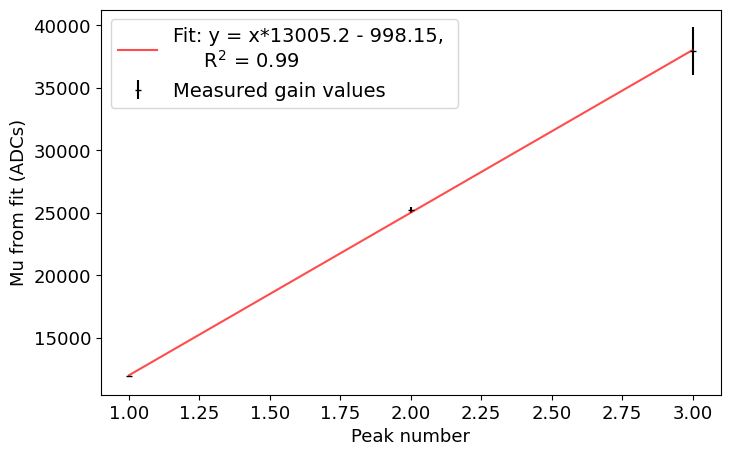


Date 05_08_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



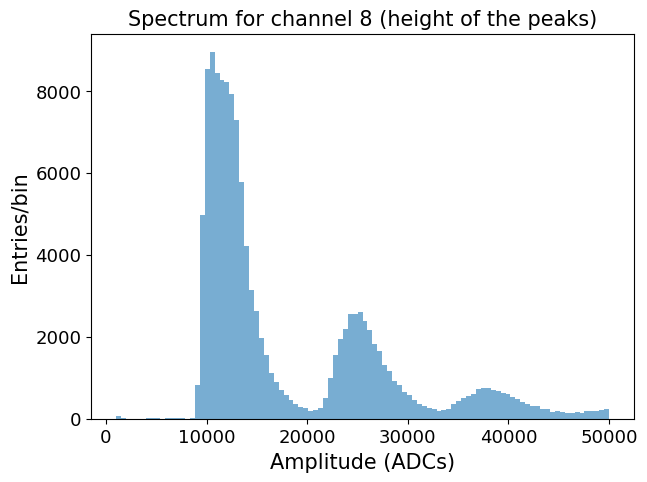

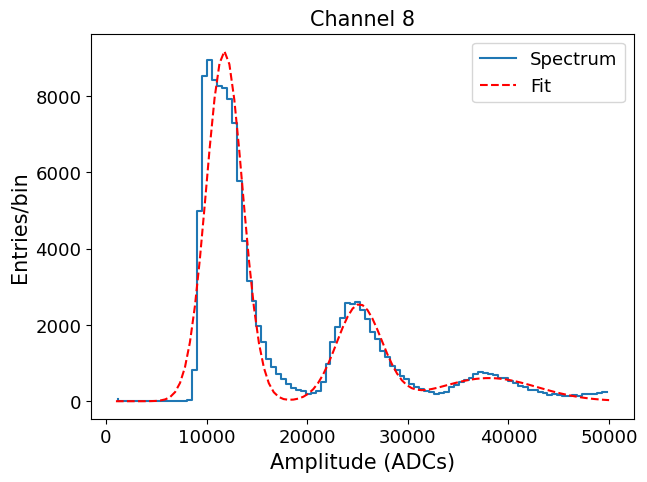

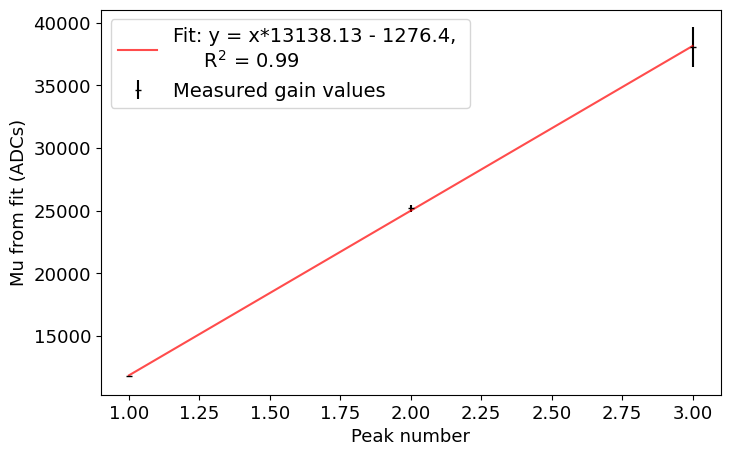


Date 05_30_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



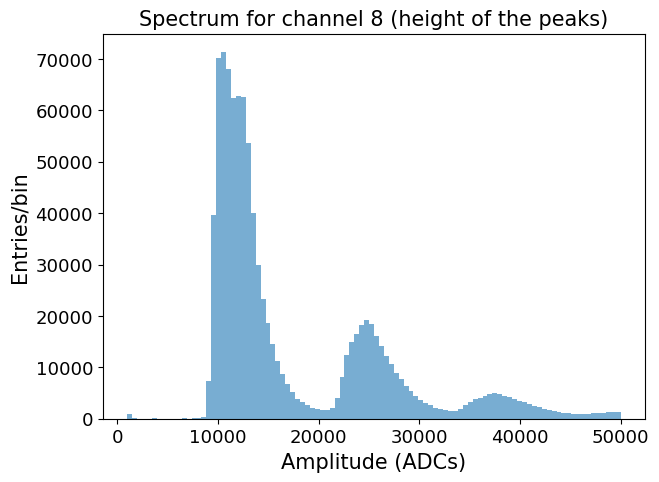

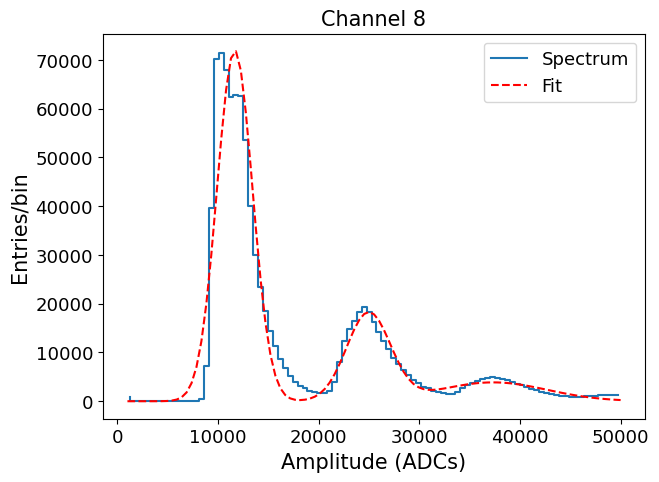

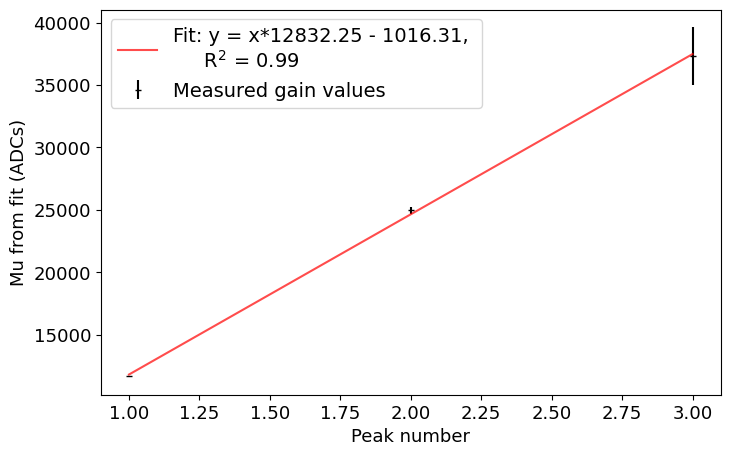


Date 06_01_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



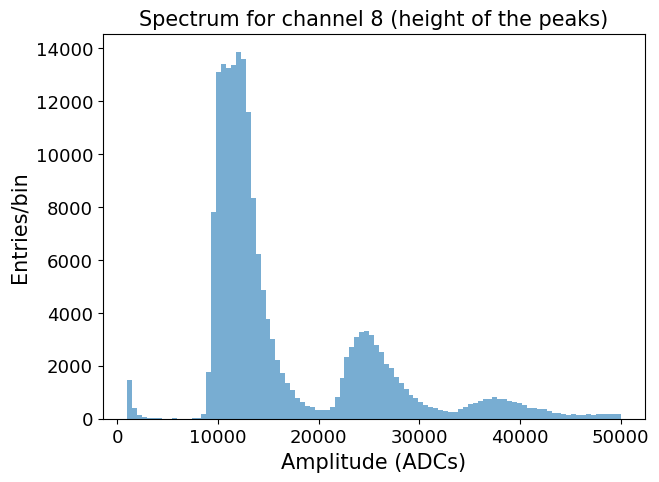

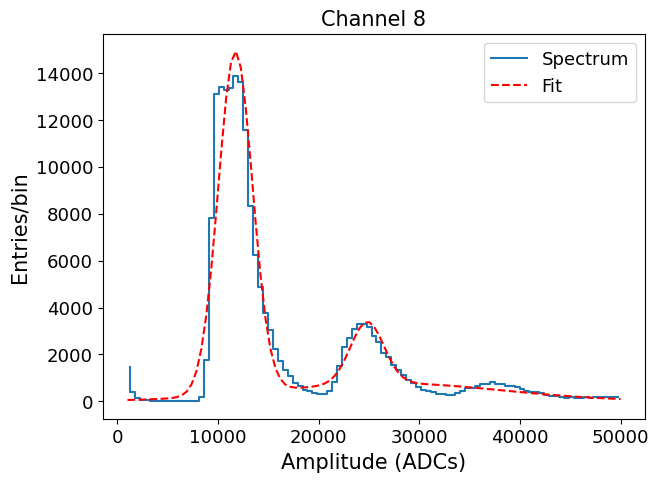

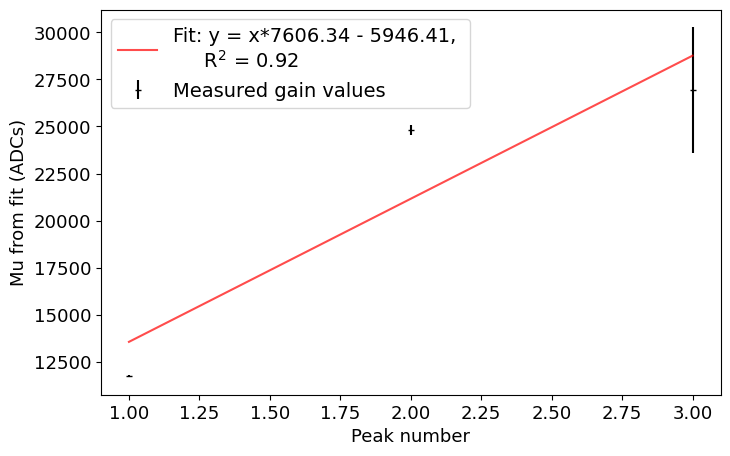


Date 06_02_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



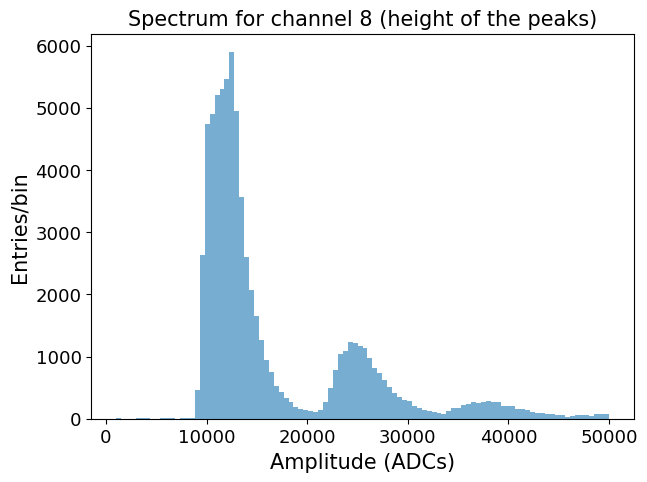

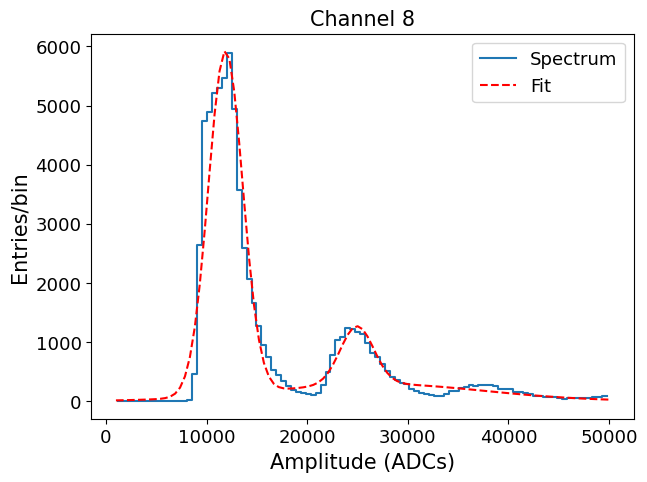

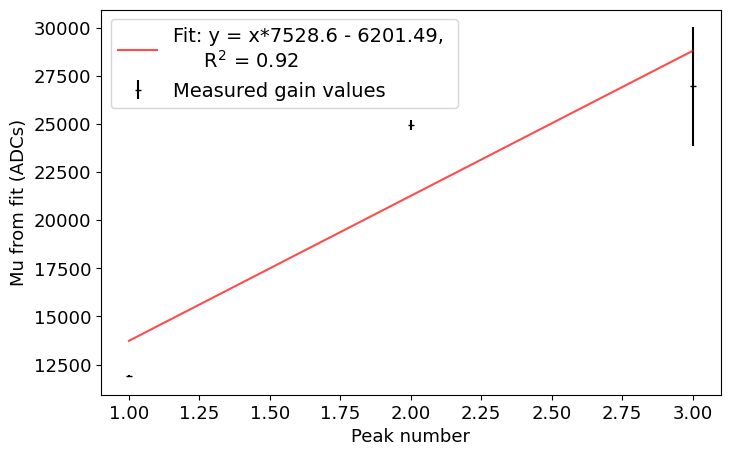


Date 06_19_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



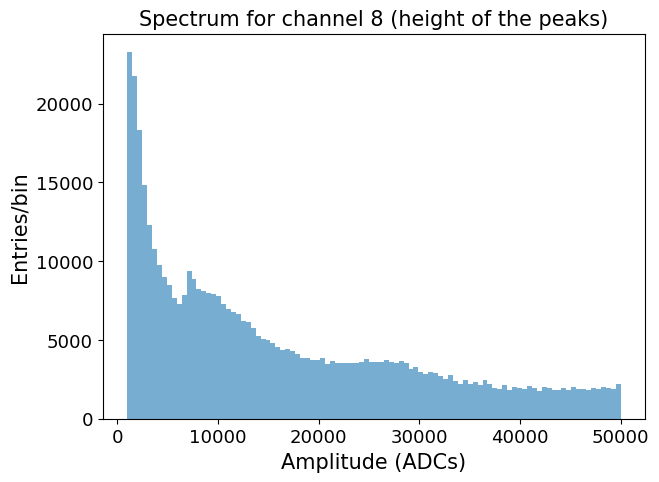


Date 06_20_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



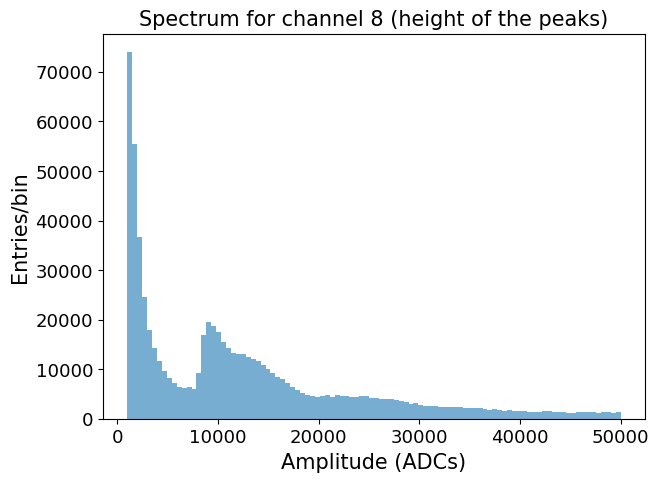

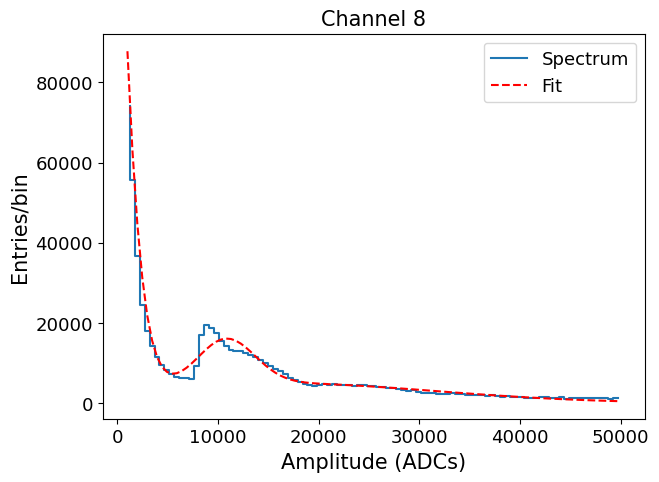

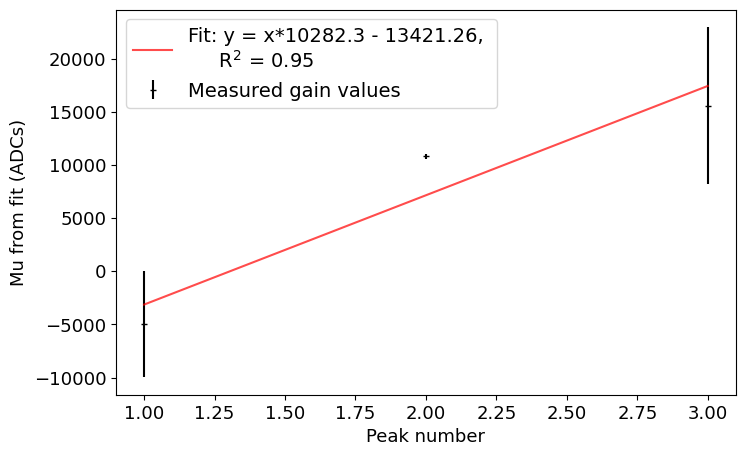


Date 06_21_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



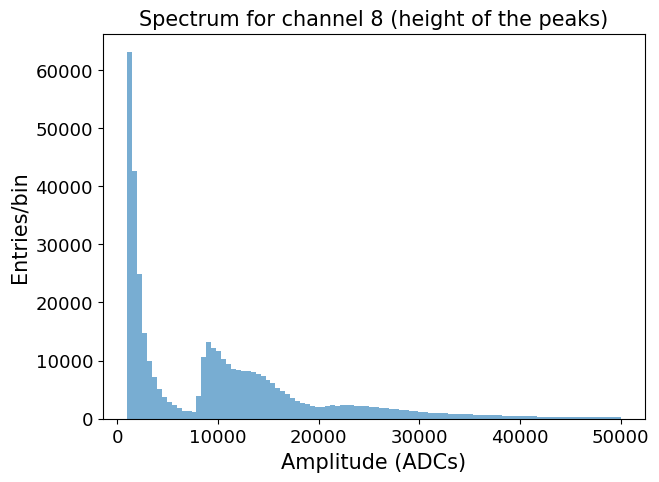

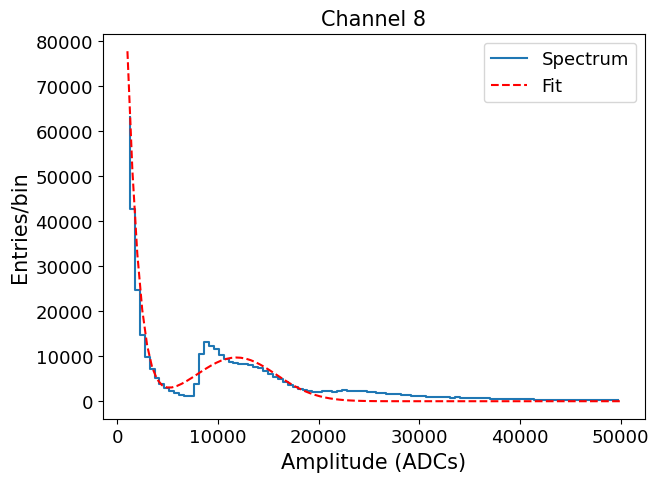

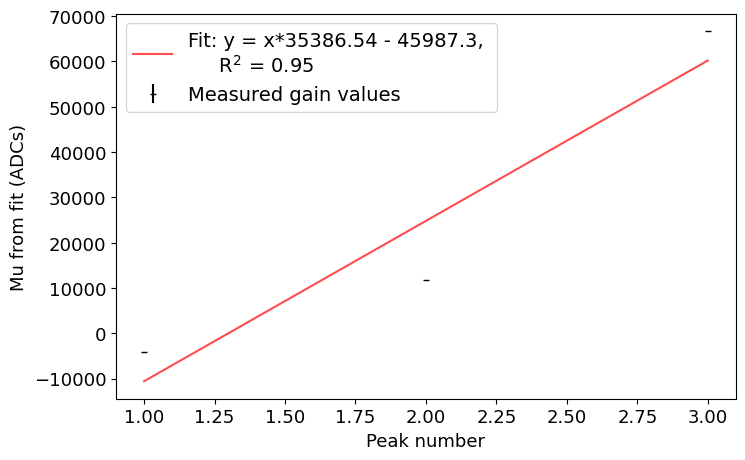


Date 06_24_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



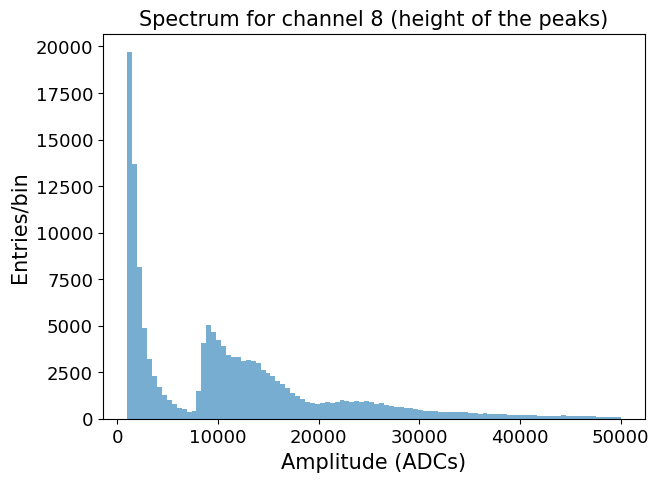


Date 07_05_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



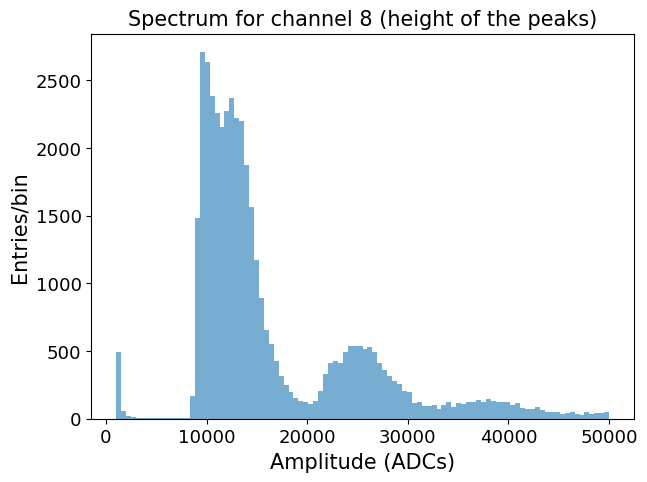

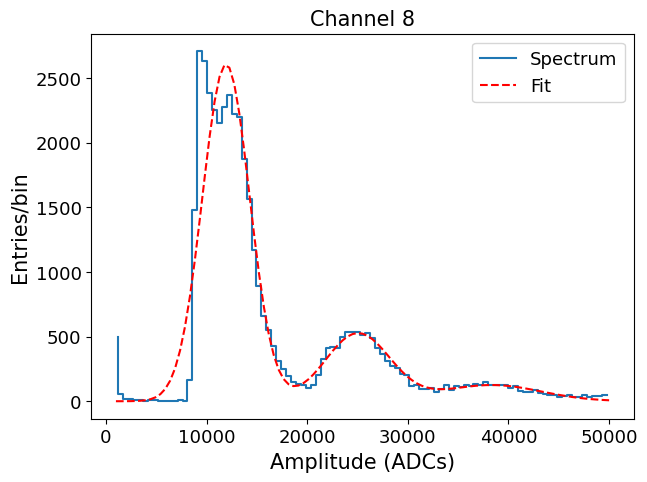

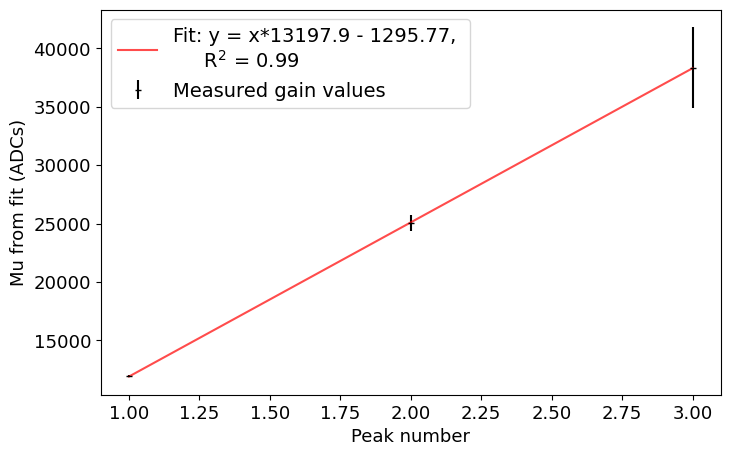


Date 07_06_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



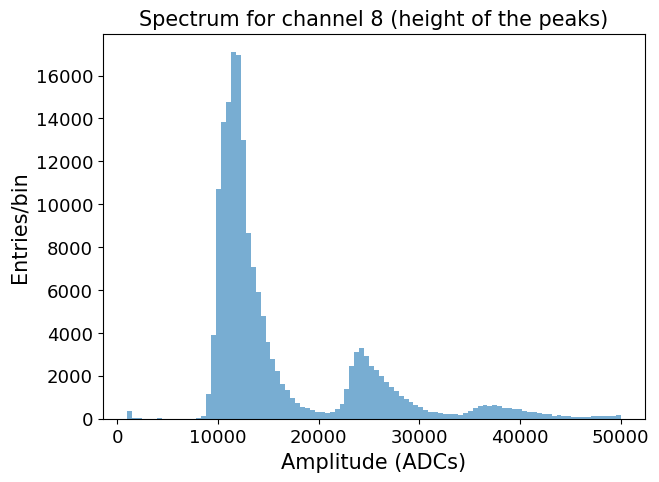

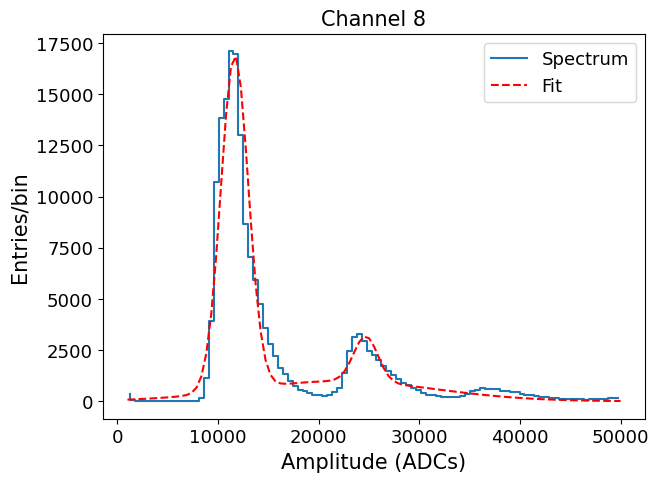

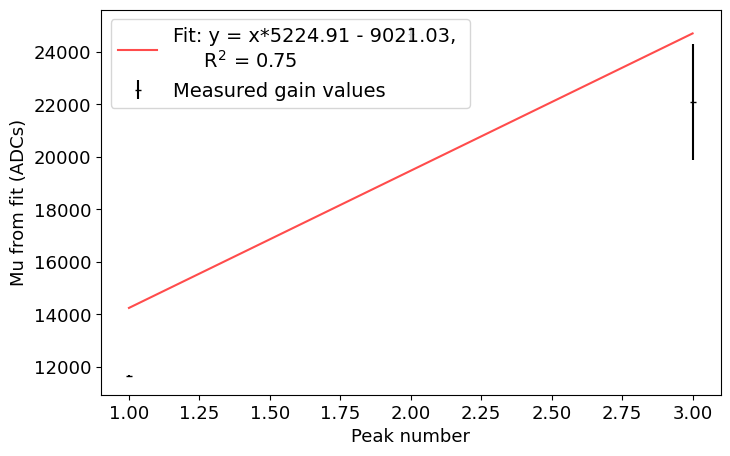


Date 07_07_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



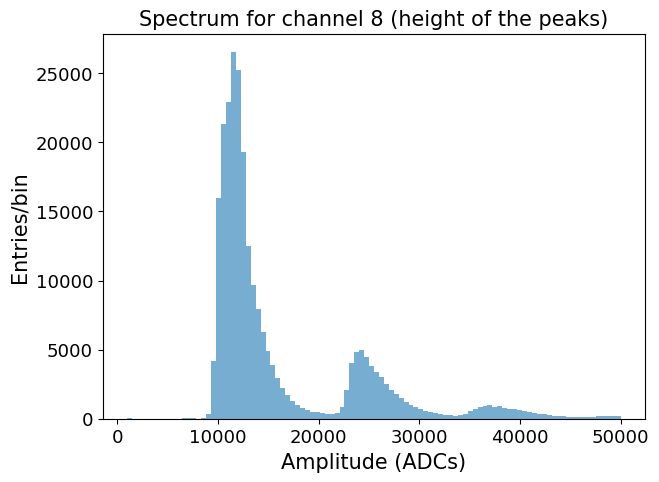

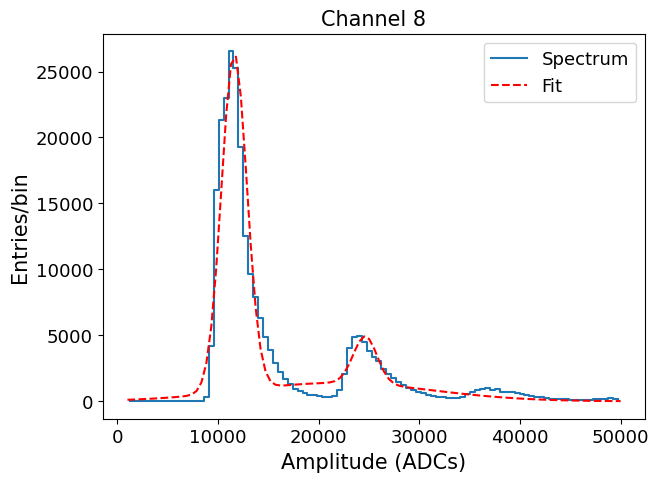

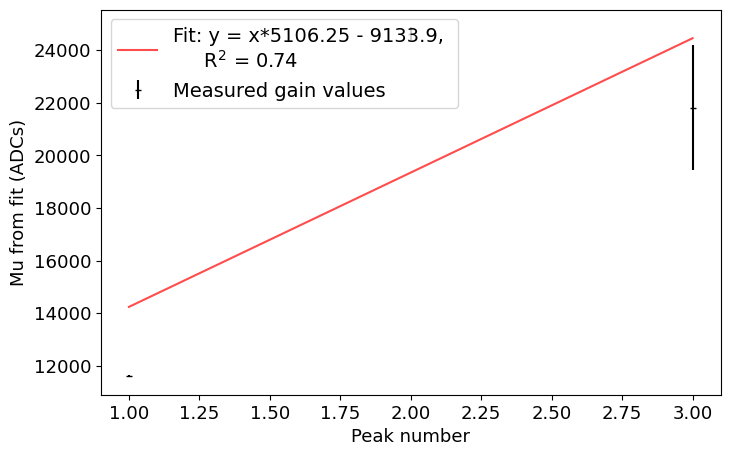


Date 07_08_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



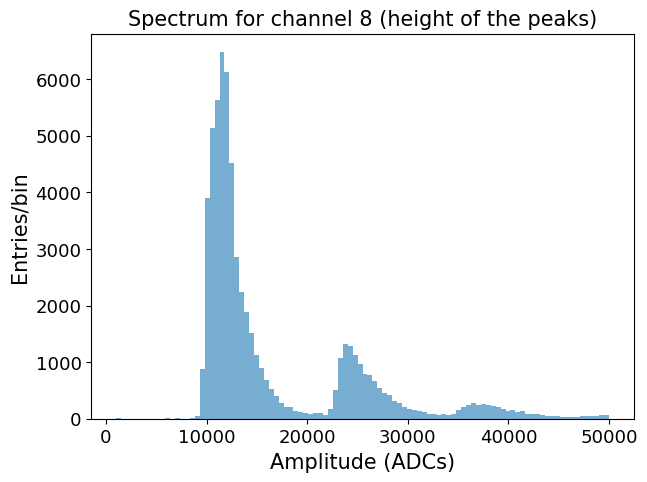

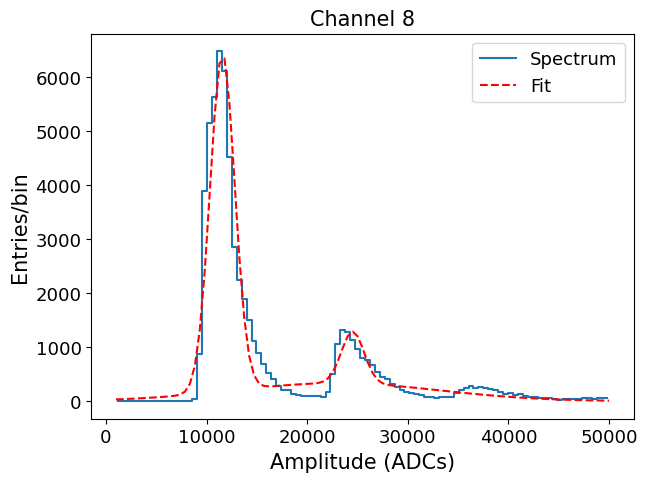

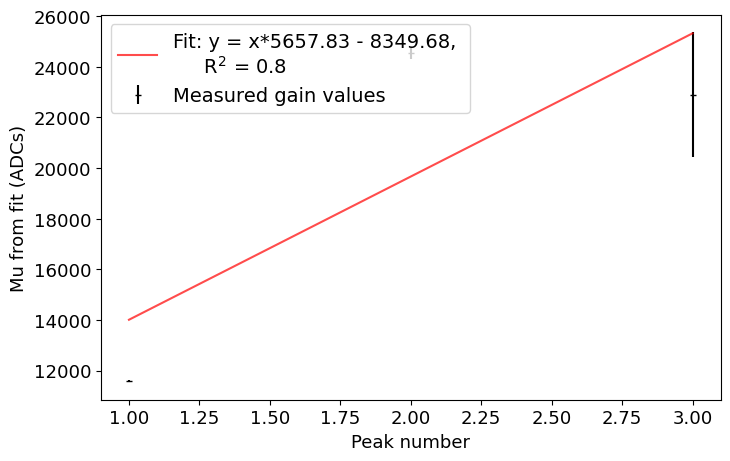


Date 07_10_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



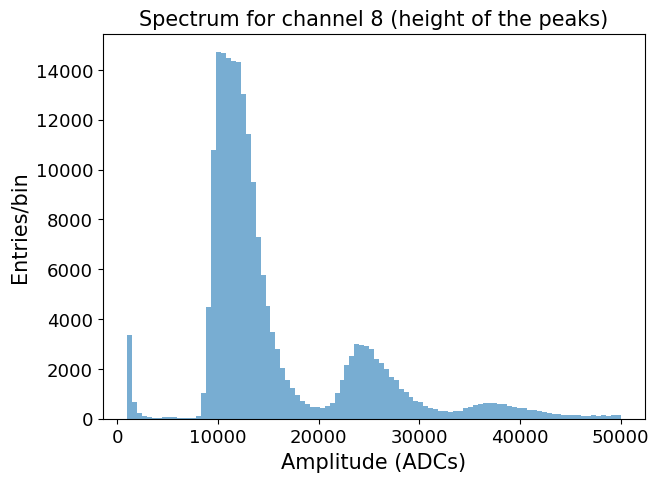

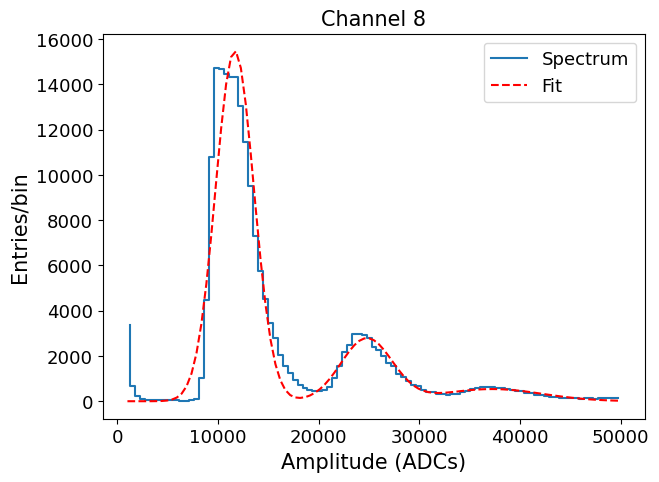

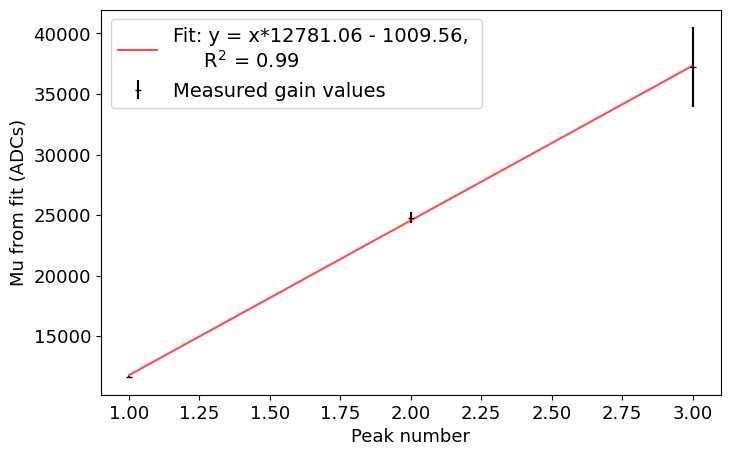


Date 07_11_2023


------------------------------------------------------------------------------------------
-------    Channel 8    ---------------------------------------------------------
------------------------------------------------------------------------------------------



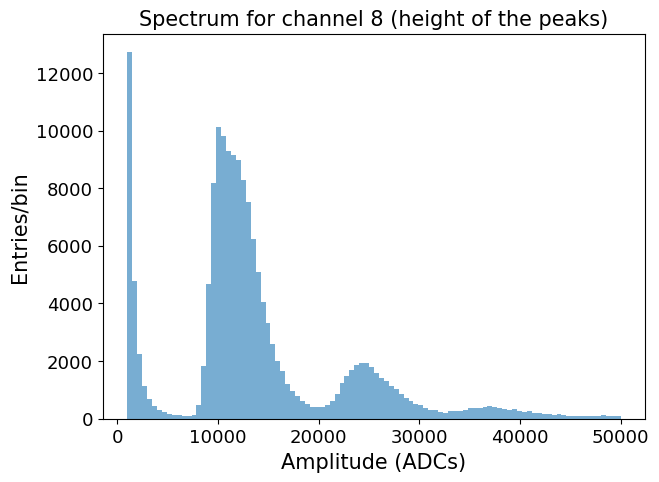

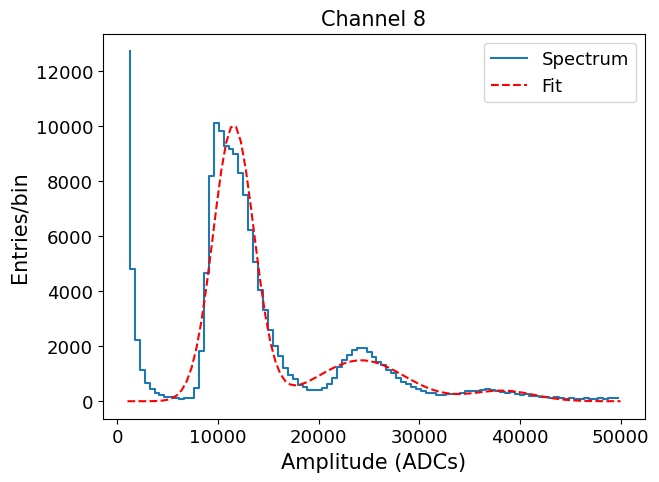

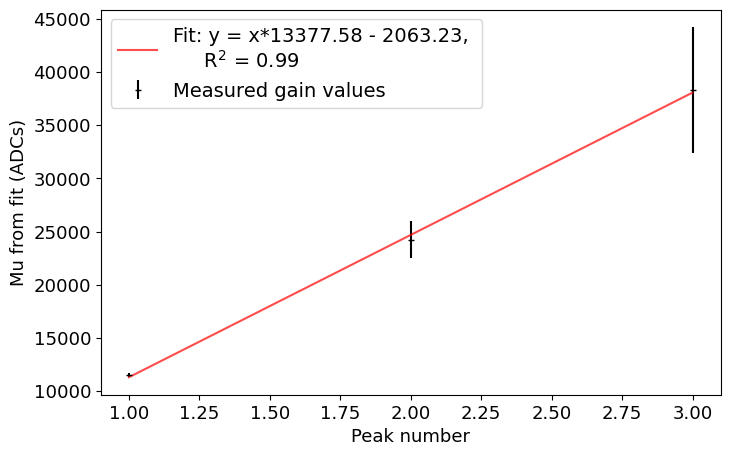

In [39]:
channel         = 8
gain_int_chann8 = []
for i, sel_date in enumerate(peak_area_all_channels_dict.keys()):
    #if i>1: break
    if sel_date == '05_22_2023': continue
    initial_guess  = [300000, 12000, 2000, 100000, 25000, 2000, 20000, 38000, 2000]
    try:
        print()
        print(f'Date {sel_date}')
        print()
        gain, ch_means = extract_gain_and_mean(peak_area_all_channels_dict[sel_date][channel],
                                               channel       = channel,
                                               bins          = 100,
                                               prange        = (1000, 50000),
                                               initial_guess = initial_guess)
        gain_int_chann8.append(gain)
    except:
        continue

gain_int_chann8 = np.array(gain_int_chann8)

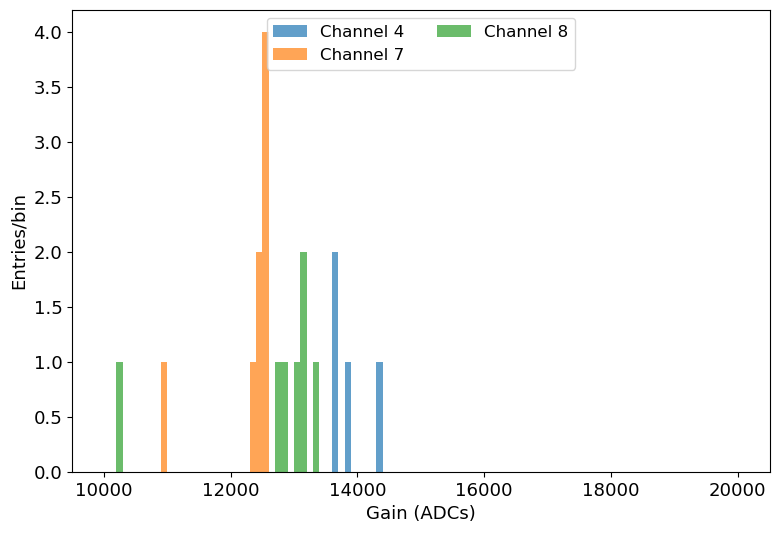

In [40]:
plt.hist(gain_int_chann4,  bins=100, range=(10000, 20000), alpha=0.7, label='Channel 4')
plt.hist(gain_int_chann7,  bins=100, range=(10000, 20000), alpha=0.7, label='Channel 7')
plt.hist(gain_int_chann8,  bins=100, range=(10000, 20000), alpha=0.7, label='Channel 8')
plt.xlabel('Gain (ADCs)')
plt.ylabel('Entries/bin')
plt.legend(loc='upper center', ncol=2, fontsize=12)
plt.show()